In [466]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import matplotlib
from sklearn.linear_model import LinearRegression
from datetime import date, timedelta
from scipy.optimize import leastsq
#from sklearn.linear_model import LinearRegression
from matplotlib.dates import DateFormatter
from scipy.stats import chisquare

#from datetime import date, timedelta
yesterday = date.today() - timedelta(days=1)
d1 = yesterday.strftime("%Y-%m-%d")
countriesEU = ["Austria","Italy","Belgium","Latvia","Bulgaria","Lithuania",\
               "Croatia","Luxembourg","Cyprus","Malta","Czechia","Netherlands",\
               "Denmark","Poland","Estonia","Portugal","Finland","Romania","France",\
               "Slovakia","Germany","Slovenia","Greece","Spain","Hungary","Sweden","Ireland"]
#x = [ 8.08213515e+04,  2.21924344e-01, -7.12649833e-01]
d0 = date(2020, 3, 29)
d2 = date.today()
deltaT = d2 - d0
print(deltaT.days)
dT = deltaT.days

%matplotlib inline
expPopWorld = 2.67152730e+06
def moving_average(a, n=3) :
    ret = np.cumsum(a, dtype=float)
    ret[n:] = ret[n:] - ret[:-n]
    return ret[n - 1:] / n

def linreg(dfLT,population):
    
    dfLT['date'] = pd.to_datetime(dfLT['date'])
    yy = np.log(dfLT['cases'].values*10000./population)
    xx = np.array(range(dfLT['cases'].size)).reshape((-1, 1))
    model1 = LinearRegression().fit(xx, yy)
    r_sq1 = model1.score(xx, yy)
    return model1, r_sq1, dfLT

def plotpred(dfLT1, population, dateStart, dateEnd, filename, model1, country,level):
    
    #fig, ax = plt.subplots(figsize=(12, 12))
    plt.plot(dfLT1['date'].values,dfLT1['cases']*10000./population)
    date_form = DateFormatter("%m-%d")
    ax = plt.axes()
    ax.xaxis.set_major_formatter(date_form)
    ix1 = pd.date_range(dateStart, dateEnd, freq='D')
    ss1 = pd.DataFrame({'date': ix1},index=range(len(ix1)))
    y_pred1 = np.exp(model1.intercept_ + model1.coef_ * range(len(ix1)))
    ax.plot(ss1['date'].values,y_pred1)
    plt.xticks(rotation=90)
    plt.title(country)
    plt.ylabel('Tolat COVID-19 cases per 10000')
    ax.fill_between(ss1['date'].values, 1,level, facecolor='red', alpha=0.3)
    ax.fill_between(ss1['date'].values, yc,1, facecolor='m', alpha=0.3)
    ax.fill_between(ss1['date'].values, 1e-3,yc, facecolor='y', alpha=0.3)
    plt.xlabel('Date')
    #plt.yscale('log')
    plt.yscale('log')
    plt.grid()
    plt.savefig(filename)
    plt.show()
    ss1a = pd.DataFrame({'cases': (y_pred1*population/10000).astype(int)},index=range(len(y_pred1)))
    ss1t = pd.concat([ss1,ss1a], axis=1)
    return ss1t

def forecast(Cntr,dfSP,date,period, shift=1.,addpred=False,xcoef=[1.,1.,1.],cases='cases',pMAPE=True):
    Cntr1 = Cntr
    waveform_1 = dfSP[cases].values*shift
    t = np.arange(-8,len(waveform_1)-8)
    fig, ((ax3, ax2), (ax5, ax4)) = plt.subplots(2, 2,figsize=(8,8), sharex=False, sharey=False)
    #ax1.plot(t, waveform_1) 
    #ax1.set_yscale("log")
    #ax1.set_xlabel('t, days')
    #ax1.set_ylabel('total infected')
    #ax1.grid()
    #plt.show()
    def model(t, coeffs):
        #coeffsUS=[1.33362427e+05, 3.63186065e-01, 1.59695379e+01]
        return  coeffs[0]/(1 + np.exp( - coeffs[1] * (t - coeffs[2])))#+coeffs[0]*.25/(1 + np.exp( - coeffs[1] * (t - 3.5*coeffs[2])))
    if Cntr=='USA':
        Cntr1='United States'
    expPop = dfp[dfp['Country (or dependency)']==Cntr1].Population.tolist()[0]*expPopWorld/np.sum(dfp['Population'].values)
    x0 = np.array([expPop, 0.23,    6.31714688 ], dtype=float)
    def residuals(coeffs, y, t):
        return y - model(t, coeffs)
    def residualsR(coeffs, y, t):
        return 1 - y/model(t, coeffs)
    
    x, flag = leastsq(residuals, x0, args=(waveform_1, t))
    x_1, flag_1 = leastsq(residuals, x0, args=(waveform_1[:-3], t[:-3]))
    #period = +17+14
    tt = np.arange(-8,len(waveform_1)-8+period)
    if addpred==True:
        allmodel = model(tt, x) + model(tt, [xcoef[0]*x[0],xcoef[1]*x[1],xcoef[2]*x[2]])
        allmodel_1 = model(tt, x_1) + model(tt, [xcoef[0]*x_1[0],xcoef[1]*x_1[1],xcoef[2]*x_1[2]])
    else:
        allmodel = model(tt, x)
        allmodel_1 = model(tt, x_1) 
    ax2.plot(t, waveform_1, tt, allmodel, tt, allmodel_1) 
    ax2.plot(t[-1],waveform_1[-1],'ro') 
    diffStd0 = np.std(1-waveform_1/model(tt[:len(waveform_1)], x))
    #chisqtot = chisquare(waveform_1, f_exp=model(tt[:len(waveform_1)], x),ddof=0)
    #chisqdiff = chisquare(np.diff(waveform_1), f_exp=np.diff(model(tt[:len(waveform_1)], x)),ddof=0)
    ax2.fill_between(tt, allmodel*(1-diffStd0), allmodel*(1+diffStd0), alpha=0.2)
    ax2.fill_between(tt, allmodel*(1-diffStd0), allmodel*(1+2*diffStd0), alpha=0.2)
    ax2.fill_between(tt, allmodel*(1-diffStd0), allmodel*(1+3*diffStd0), alpha=0.2)
    ax2.legend(['COVID-19 %s'%(Cntr), 'logistic','-3days'],loc='upper left') 
    ax2.set_xlabel('t, days')
    ax2.set_ylabel('Total %s'%(cases))
    ax2.yaxis.tick_right()
    ax2.ticklabel_format(style='sci', axis='y', scilimits=(0,0))
    #ax2.set_yscale('log')
    plt.yscale("linear")
    #ax2.set_ylim([0,max(allmodel+6*diffStd0*np.ones(len(tt)))*1.2])
    ax2.grid()
    ax3.plot(t[:-1], np.diff(waveform_1),tt[:-1], np.diff(allmodel))
    ax3.plot(t[-1], np.diff(waveform_1)[-1],'ro')
    diffStd = np.std(1-np.diff(waveform_1)/np.diff(model(tt[:len(waveform_1)], x)))
    #print(diffStd)
    ax3.fill_between(tt[:-1], np.diff(allmodel)*(1-diffStd), np.diff(allmodel)*(1+diffStd), alpha=0.2)
    ax3.fill_between(tt[:-1], np.diff(allmodel)*(1-2*diffStd), np.diff(allmodel)*(1+2*diffStd), alpha=0.2)
    ax3.fill_between(tt[:-1], np.diff(allmodel)*(1-2*diffStd), np.diff(allmodel)*(1+3*diffStd), alpha=0.2)
    ax3.set_ylim([0,1.1*max(max(np.diff(waveform_1)),max(np.diff(allmodel)*(1+3*diffStd)))])
    ax3.grid()
    ax3.legend([r'$\Delta$ %s'%(Cntr), 'model']) 
    ax3.set_xlabel('t, days')
    ax3.set_ylabel(r'$\Delta$ of %s dayly'%(cases))
    ax3.ticklabel_format(style='sci', axis='y', scilimits=(0,0))
    #if Cntr in ['South Korea','China','USA','United Kingdom']:
    waveform_A = dfSP['active'].values*shift
    z = np.diff(moving_average(waveform_A, n=3))/np.diff(moving_average(waveform_1, n=3))
    ax4.plot(t[:-3],z)
    #ax4.axhline(y=2.2587741081036339/2, color='r')
    ax4.fill_between(t[:-1], 0.8078285535018691, 1.,color='r',alpha=0.2)
    #ax4.set_yscale("log")
    ax4.set_xlabel('t, days')
    if cases=='death':
        ax4.set_ylabel('1/S(t)')
    ax4.set_ylabel('S(t)')
    ax4.yaxis.tick_right()
    ax4.grid()
    xt,yt,x_pred12t,y_pred12t,output = trendS(dfSP)
    ax5.plot(xt,yt,label=Cntr1)
    ax5.plot(range(x_pred12t),y_pred12t,label='%s tr'%(Cntr1))
    ax5.set_xlabel('t, days')
    ax5.set_ylabel('G(t)')
    ax5.legend()
    ax5.grid()
    plt.savefig("pictures/covid%s%s%d.png"%(cases,Cntr,int(xcoef[0]*100)),dpi=300)
    plt.show()
    print(Cntr,'data at: %s'%(date))
    if pMAPE:
        print('+3 day model MAPE:', abs(allmodel[len(t+2)]-allmodel_1[len(t+2)])/allmodel_1[len(t+2)])
    print('model: logistic')
    print('coeffs: ',x)
    if addpred:
        print("scenario coeffs: ",xcoef)
    print('rational stdev: ',np.std(residualsR(x, waveform_1, t)))
    #print('chisq %s: (%s%e,%s%e)'%(cases,'statistic=',chisqtot[0],'p-value=',chisqtot[1]))
    #print('chisq cases delta: (%s,%e,%s,%e)'%('statistic=',chisqdiff[0],'p-value=',chisqdiff[1]))
    print('forecast at the end of period: +%d days'%(period))
    if cases=='cases':
        print('\t deltaDay%s: '%(cases),int(allmodel[-1]-allmodel[-2]))  
    print('\t total %s: '%(cases),int(allmodel[-1]),'±',int(allmodel[-1]*diffStd0)) 
    if Cntr=='South Korea':
        Cntr='S. Korea'
    if Cntr=='United Kingdom':
        Cntr='UK'
    deathV = int(allmodel[-1]*dfTT[dfTT.Country=='%s'%(Cntr)][0].values[0])
    if cases=='cases':
        print('\t total death: ', deathV,'±',int(deathV*diffStd0*3))
    print(output)
    return x

def forecast2(Cntr,dfSP,date,period, coeffs2,shift=1.,addpred=False,xcoef=[1.,1.,1.],vL=10,cases='cases'):
    Cntr1 = Cntr
    waveform_1 = dfSP[cases].values*shift
    t = np.arange(-8,len(waveform_1)-8)
    fig, ((ax3, ax2), (ax5, ax4)) = plt.subplots(2, 2,figsize=(8,8), sharex=False, sharey=False)
    #ax1.plot(t, waveform_1) 
    #plt.yscale("log")
    #ax1.set_xlabel('t, days')
    #ax1.set_ylabel('total infected')
    #ax1.grid()
    #plt.show()
    def model(t, coeffs):
        coeffsUS=coeffs2#[1.33362427e+05, 3.63186065e-01, 1.59695379e+01]
        return  coeffs[0]/(1 + np.exp( - coeffs[1] * (t - coeffs[2])))+coeffsUS[0]/(1 + np.exp( - coeffsUS[1] * (t - coeffsUS[2])))
    def model0(t, coeffs):
        #coeffsUS=coeffs#[1.33362427e+05, 3.63186065e-01, 1.59695379e+01]
        return  coeffs[0]/(1 + np.exp( - coeffs[1] * (t - coeffs[2])))
    if Cntr=='USA':
        Cntr1='United States'
    expPop = dfp[dfp['Country (or dependency)']==Cntr1].Population.tolist()[0]*expPopWorld/np.sum(dfp['Population'].values)
    x0 = np.array([expPop, 0.23,    6.31714688 ], dtype=float)
    def residuals(coeffs, y, t):
        return y - model(t, coeffs)
    def residualsR(coeffs, y, t):
        return 1 - y/model(t, coeffs)
    #from scipy.optimize import leastsq
    x, flag = leastsq(residuals, x0, args=(waveform_1, t))
    x_1, flag_1 = leastsq(residuals, x0, args=(waveform_1[:-3], t[:-3]))
    #period = +17+14
    tt = np.arange(-8,len(waveform_1)-8+period)
    if addpred==True:
        allmodel = model(tt, x) + model0(tt, [xcoef[0]*x[0],xcoef[1]*x[1],xcoef[2]*x[2]])#-coeffs2[0]/(1 + np.exp( - coeffs2[1] * (tt - coeffs2[2])))
        allmodel_1 = model(tt, x_1) + model0(tt, [xcoef[0]*x_1[0],xcoef[1]*x_1[1],xcoef[2]*x_1[2]])
    else:
        allmodel = model(tt, x)
        allmodel_1 = model(tt, x_1)
    ax2.plot(t, waveform_1, tt, allmodel,tt, allmodel_1)
    ax2.plot(t[-1],waveform_1[-1],'ro') 
    diffStd0 = np.std(1-waveform_1/model(tt[:len(waveform_1)], x))
    #chisqtot = chisquare(waveform_1, f_exp=model(tt[:len(waveform_1)], x),ddof=1)
    #chisqdiff = chisquare(np.diff(waveform_1), f_exp=np.diff(model(tt[:len(waveform_1)], x)),ddof=1)
    ax2.fill_between(tt, allmodel*(1-diffStd0), allmodel*(1+diffStd0), alpha=0.2)
    ax2.fill_between(tt, allmodel*(1-diffStd0), allmodel*(1+2*diffStd0), alpha=0.2)
    ax2.fill_between(tt, allmodel*(1-diffStd0), allmodel*(1+3*diffStd0), alpha=0.2)
    ax2.legend(['COVID-19 %s'%(Cntr), 'bi-logistic','-3days'],loc='upper left') 
    ax2.set_xlabel('t, days')
    ax2.set_ylabel('Total %s'%(cases))
    ax2.yaxis.tick_right()
    ax2.ticklabel_format(style='sci', axis='y', scilimits=(0,0))
    #ax2.set_ylim([0,max(allmodel*(1+diffStd0)*1.2])
    #ax2.set_yscale('log')
    plt.yscale("linear")
    ax2.grid()
    ax3.plot(t[:-1], np.diff(waveform_1),tt[:-1], np.diff(allmodel))
    ax3.plot(t[-1], np.diff(waveform_1)[-1],'ro')
    diffStd = np.std(1-np.diff(waveform_1)/np.diff(model(tt[:len(waveform_1)], x)))
    ax3.fill_between(tt[:-1], np.diff(allmodel)*(1-diffStd), np.diff(allmodel)*(1+diffStd), alpha=0.2)
    ax3.fill_between(tt[:-1], np.diff(allmodel)*(1-2*diffStd), np.diff(allmodel)*(1+2*diffStd), alpha=0.2)
    ax3.fill_between(tt[:-1], np.diff(allmodel)*(1-2*diffStd), np.diff(allmodel)*(1+3*diffStd), alpha=0.2)
    ax3.set_ylim([0,1.1*max(max(np.diff(waveform_1)),max(np.diff(allmodel)*(1+3*diffStd)))])
    #ax3.set_yscale("log")
    #ax3.set_xscale("log")
    ax3.legend([r'$\Delta$ %s'%(Cntr), 'model']) 
    ax3.grid()
    ax3.set_xlabel('t, days')
    ax3.set_ylabel(r'$\Delta$ of %s dayly'%(cases))
    ax3.ticklabel_format(style='sci', axis='y', scilimits=(0,0))
    #if Cntr in ['South Korea','China','USA','United Kingdom','World']:
    waveform_A = dfSP['active'].values*shift
    z = np.diff(moving_average(waveform_A, n=3))/np.diff(moving_average(waveform_1, n=3))
    ax4.plot(t[:-3],z)
    #ax4.axhline(y=2.2587741081036339/2, color='r')
    ax4.fill_between(t[:-1], 0.8078285535018691, 1.,color='r',alpha=0.2)
    #ax4.set_yscale("log")
    if cases=='death':
        ax4.set_ylabel('1/S(t)')
    ax4.set_ylabel('S(t)')
    ax4.set_xlabel('t, days')
    ax4.yaxis.tick_right()
    ax4.grid()
    xt,yt,x_pred12t,y_pred12t,output = trendS(dfSP,vL)
    xt0,yt0,x_pred12t0,y_pred12t0,output0 = trendS0(dfSP,vL)
    ax5.plot(xt,yt,label=Cntr1)
    ax5.plot(range(x_pred12t),y_pred12t,label='%s tr'%(Cntr1))
    ax5.plot(range(x_pred12t0),y_pred12t0,label='%s tr0'%(Cntr1))
    ax5.axvline(vL, color="red", linestyle="--")
    ax5.set_xlabel('t, days')
    ax5.set_ylabel('G(t)')
    ax5.legend()
    ax5.grid()
    plt.savefig("pictures/covid%s%s%d.png"%(cases,Cntr,int(xcoef[0]*100)),dpi=300)
    plt.show()
    print(Cntr,'data at: %s'%(date))
    print('+3 day model MAPE:', abs(allmodel[len(t+2)]-allmodel_1[len(t+2)])/allmodel_1[len(t+2)])
    print('model: bi-logistic')
    print('coeffs: ',x,coeffs2)
    if addpred:
        print("scenario coeffs: ",xcoef)
    print('rational stdev: ',np.std(residualsR(x, waveform_1, t)))
    #print('chisq %s: (%s%e,%s%e)'%(cases,'statistic=',chisqtot[0],'p-value=',chisqtot[1]))
    #print('chisq cases delta: (%s,%e,%s,%e)'%('statistic=',chisqdiff[0],'p-value=',chisqdiff[1]))
    print('forecast at the end of period: +%d days'%(period))
    print('\t deltaDay%s: '%(cases),int(allmodel[-1]-allmodel[-2]))  
    print('\t total %s: '%(cases),int(allmodel[-1]),'±',int(allmodel[-1]*diffStd0))
    if Cntr=='South Korea':
        Cntr='S. Korea'
    if Cntr=='United Kingdom':
        Cntr='UK'
    deathV = int(allmodel[-1]*dfTT[dfTT.Country=='%s'%(Cntr)][0].values[0])
    if cases=='cases':
        print('\t total death: ', deathV,'±',int(deathV*diffStd0*3))
    print ("bi-logistic approximation splitting point: %d"%(vL))
    print(output0)
    print(output)
    return x

def forecast3(Cntr,dfSP,date,period, coeffs2, shift=1.,addpred=False,xcoef=[1.,1.,1.],vL=[0,3],cases='cases'):
    Cntr1 = Cntr
    waveform_1 = dfSP[cases].values*shift
    t = np.arange(-8,len(waveform_1)-8)
    fig, ((ax3, ax2), (ax5, ax4)) = plt.subplots(2, 2,figsize=(8,8), sharex=False, sharey=False)
    #ax1.plot(t, waveform_1) 
    #plt.yscale("log")
    #ax1.set_xlabel('t, days')
    #ax1.set_ylabel('total infected')
    #ax1.grid()
    #plt.show()
    def model(t, coeffs):
        coeffsUS=coeffs2#[1.33362427e+05, 3.63186065e-01, 1.59695379e+01]
        return  coeffs[0]/(1 + np.exp( - coeffs[1] * (t - coeffs[2])))+coeffsUS[0]/(1 + np.exp( - coeffsUS[1] * (t - coeffsUS[2])))+coeffsUS[3]/(1 + np.exp( - coeffsUS[4] * (t - coeffsUS[5])))
    def model0(t, coeffs):
        #coeffsUS=coeffs#[1.33362427e+05, 3.63186065e-01, 1.59695379e+01]
        return  coeffs[0]/(1 + np.exp( - coeffs[1] * (t - coeffs[2])))
    if Cntr=='USA':
        Cntr1='United States'
    expPop = dfp[dfp['Country (or dependency)']==Cntr1].Population.tolist()[0]*expPopWorld/np.sum(dfp['Population'].values)
    x0 = np.array([expPop, 0.23,    6.31714688 ], dtype=float)
    def residuals(coeffs, y, t):
        return y - model(t, coeffs)
    def residualsR(coeffs, y, t):
        return 1 - y/model(t, coeffs)
    #from scipy.optimize import leastsq
    x, flag = leastsq(residuals, x0, args=(waveform_1, t))
    x_1, flag_1 = leastsq(residuals, x0, args=(waveform_1[:-3], t[:-3]))
    #period = +17+14
    tt = np.arange(-8,len(waveform_1)-8+period)
    if addpred==True:
        allmodel = model(tt, x) + model0(tt, [xcoef[0]*x[0],xcoef[1]*x[1],xcoef[2]*x[2]])
        allmodel_1 = model(tt, x_1) + model0(tt, [xcoef[0]*x_1[0],xcoef[1]*x_1[1],xcoef[2]*x_1[2]])
    else:
        allmodel = model(tt, x)
        allmodel_1 = model(tt, x_1)
    ax2.plot(t, waveform_1, tt, allmodel, tt, allmodel_1)
    ax2.plot(t[-1],waveform_1[-1],'ro') 
    diffStd0 = np.std(1-waveform_1/model(tt[:len(waveform_1)], x))
    #chisqtot = chisquare(waveform_1, f_exp=model(tt[:len(waveform_1)], x),ddof=2)
    #chisqdiff = chisquare(np.diff(waveform_1), f_exp=np.diff(model(tt[:len(waveform_1)], x)),ddof=2)
    ax2.fill_between(tt, allmodel*(1-diffStd0), allmodel*(1+diffStd0), alpha=0.2)
    ax2.fill_between(tt, allmodel*(1-diffStd0), allmodel*(1+2*diffStd0), alpha=0.2)
    ax2.fill_between(tt, allmodel*(1-diffStd0), allmodel*(1+3*diffStd0), alpha=0.2)
    ax2.legend(['COVID-19 %s'%(Cntr), 'tri-logistic','-3days'],loc='upper left') 
    ax2.set_xlabel('t, days')
    ax2.set_ylabel('Total %s'%(cases))
    ax2.yaxis.tick_right()
    ax2.ticklabel_format(style='sci', axis='y', scilimits=(0,0))
    #ax2.set_ylim([0,max(allmodel+6*diffStd0*np.ones(len(tt)))*1.2])
    #ax2.set_yscale('log')
    plt.yscale("linear")
    ax2.grid()
    ax3.plot(t[:-1], np.diff(waveform_1), tt[:-1], np.diff(allmodel))
    ax3.plot(t[-1], np.diff(waveform_1)[-1],'ro')
    diffStd = np.std(1-np.diff(waveform_1)/np.diff(model(tt[:len(waveform_1)], x)))
    ax3.fill_between(tt[:-1], np.diff(allmodel)*(1-diffStd), np.diff(allmodel)*(1+diffStd), alpha=0.2)
    ax3.fill_between(tt[:-1], np.diff(allmodel)*(1-2*diffStd), np.diff(allmodel)*(1+2*diffStd), alpha=0.2)
    ax3.fill_between(tt[:-1], np.diff(allmodel)*(1-2*diffStd), np.diff(allmodel)*(1+3*diffStd), alpha=0.2)
    ax3.set_ylim([0,1.1*max(max(np.diff(waveform_1)),max(np.diff(allmodel)*(1+3*diffStd)))])
    ax3.grid()
    ax3.legend([r'$\Delta$ %s'%(Cntr), 'model']) 
    #ax3.set_ylim([0,max(np.diff(allmodel)+3*diffStd*np.ones(len(tt)-1))*1.2])
    ax3.set_xlabel('t, days')
    ax3.set_ylabel(r'$\Delta$ of %s dayly'%(cases))
    ax3.ticklabel_format(style='sci', axis='y', scilimits=(0,0))
    #if Cntr in ['South Korea','China','USA','United Kingdom']:
    waveform_A = dfSP['active'].values*shift
    z = np.diff(moving_average(waveform_A, n=3))/np.diff(moving_average(waveform_1, n=3))
    ax4.plot(t[:-3],z)
    #ax4.axhline(y=2.2587741081036339/2, color='r')
    ax4.fill_between(t[:-1], 0.8078285535018691, 1.,color='r',alpha=0.2)
    #ax4.set_yscale("log")
    if cases=='death':
        ax4.set_ylabel('1/S(t)')
    ax4.set_ylabel('S(t)')
    ax4.yaxis.tick_right()
    ax4.grid()
    xt,yt,x_pred12t,y_pred12t,output = trendS(dfSP,vL[1])
    xt0,yt0,x_pred12t0,y_pred12t0,output0 = trendS0(dfSP,vL[0])
    xt1,yt1,x_pred12t1,y_pred12t1,output1 = trendS1(dfSP,vL)
    ax5.plot(xt,yt,label=Cntr1)
    ax5.plot(range(x_pred12t0),y_pred12t0,label='%s tr0'%(Cntr1))
    ax5.plot(range(x_pred12t1),y_pred12t1,label='%s tr1'%(Cntr1))
    ax5.plot(range(x_pred12t),y_pred12t,label='%s tr'%(Cntr1))
    ax5.axvline(vL[0], color="red", linestyle="--")
    ax5.axvline(vL[1], color="red", linestyle="--")
    ax5.set_xlabel('t days')
    ax5.set_ylabel('G(t)')
    ax5.legend()
    ax5.grid()
    plt.savefig("pictures/covid%s%s%d.png"%(cases,Cntr,int(xcoef[0]*100)),dpi=300)
    plt.show()
    print(Cntr,'data at: %s'%(date))
    print('+3 day model MAPE:', abs(allmodel[len(t+2)]-allmodel_1[len(t+2)])/allmodel_1[len(t+2)])
    print('model: tri-logistic')
    print('coeffs: ',x,coeffs2)
    if addpred:
        print("scenario coeffs: ",xcoef)
    print('forecast rational stdev: ',np.std(residualsR(x, waveform_1, t)))
    #print('chisq %s: (%s%e,%s%e)'%(cases,'statistic=',chisqtot[0],'p-value=',chisqtot[1]))
    #print('chisq cases delta: (%s,%e,%s,%e)'%('statistic=',chisqdiff[0],'p-value=',chisqdiff[1]))
    print('forecast at the end of period: +%d days'%(period))
    print('\t deltaDay%s: '%(cases),int(allmodel[-1]-allmodel[-2]))  
    print('\t total %s: '%(cases),int(allmodel[-1]),'±',int(allmodel[-1]*diffStd0))
    if Cntr=='South Korea':
        Cntr='S. Korea'
    if Cntr=='United Kingdom':
        Cntr='UK'
    deathV = int(allmodel[-1]*dfTT[dfTT.Country=='%s'%(Cntr)][0].values[0])
    if cases=='cases':
        print('\t total death: ', deathV,'±',int(deathV*diffStd0*3))
    print ("tri-logistic approximation splitting points: %d,%d"%(vL[0],vL[1]))
    print(output0)
    print(output1)
    print(output)
    
    return x

def trend3(dfLV,dfLT1,dfES,lLV,lLT,lES,pLV,pLT,pES):
    #dfLV = pd.read_csv("~/Desktop/coronaLV.csv",",")
    y = np.log(np.diff(dfLV["cases"].values)[:]/dfLV["cases"].values[1:]**2)
    x = np.array(range(len(dfLV["cases"].values)-1)).reshape((-1, 1))
    print (x.size,y.size)
    model = LinearRegression().fit(x, y)
    r_sq = model.score(x, y)
    print('coefficient of determination:', r_sq)
    print('intercept:', model.intercept_)
    print('slope:', model.coef_)
    plt.plot(x,y,label=lLV)
    y_pred12 = model.intercept_ + model.coef_ * range(len(x)+pLV) 
    plt.plot(range(len(x)+pLV),y_pred12,label='%s tr'%(lLV))

    #dfLT1 = pd.read_csv("~/Desktop/coronaLT1.csv",",")
    y = np.log(np.diff(dfLT1["cases"].values)[:]/dfLT1["cases"].values[1:]**2)
    x = np.array(range(len(dfLT1["cases"].values)-1)).reshape((-1, 1))
    print (x.size,y.size)
    model = LinearRegression().fit(x, y)
    r_sq = model.score(x, y)
    print('coefficient of determination:', r_sq)
    print('intercept:', model.intercept_)
    print('slope:', model.coef_)
    plt.plot(x,y,label=lLT)
    y_pred12 = model.intercept_ + model.coef_ * range(len(x)+pLT) 
    plt.plot(range(len(x)+pLT),y_pred12,label='%s tr'%(lLT))

    y = np.log(np.diff(dfES["cases"].values)[:]/dfES["cases"].values[1:]**2)
    x = np.array(range(len(dfES["cases"].values)-1)).reshape((-1, 1))
    print (x.size,y.size)
    model = LinearRegression().fit(x, y)
    r_sq = model.score(x, y)
    print('coefficient of determination:', r_sq)
    print('intercept:', model.intercept_)
    print('slope:', model.coef_)
    plt.plot(x,y,label=lES)
    y_pred12 = model.intercept_ + model.coef_ * range(len(x)+pES) 
    plt.plot(range(len(x)+pES),y_pred12,label='%s tr'%(lES))
    plt.xlabel('t, days')
    plt.ylabel('G(t)')
    plt.grid()
    plt.legend()
    plt.savefig("pictures/logdifflogcorna%s%s%s.png"%(lLV,lLT,lES))
    plt.show()
    
def trend(dfLV,lLV,pLV):
    #dfLV = pd.read_csv("~/Desktop/coronaLV.csv",",")
    y = np.log(np.diff(dfLV["cases"].values)[:]/dfLV["cases"].values[1:]**2)
    x = np.array(range(len(dfLV["cases"].values)-1)).reshape((-1, 1))
    print (x.size,y.size)
    model = LinearRegression().fit(x, y)
    r_sq = model.score(x, y)
    print('coefficient of determination:', r_sq)
    print('intercept:', model.intercept_)
    print('slope:', model.coef_)
    plt.plot(x,y,label=lLV)
    y_pred12 = model.intercept_ + model.coef_ * range(len(x)+pLV) 
    plt.plot(range(len(x)+pLV),y_pred12,label='%s tr'%(lLV))

    plt.xlabel('t [days]')
    plt.ylabel('G(t)')
    plt.grid()
    plt.legend()
    plt.savefig("pictures/logdifflogcorna%s.png"%(lLV))
    plt.show()

def trendS(dfLV,vL=0,pLV=5):
    #dfLV = pd.read_csv("~/Desktop/coronaLV.csv",",")
    y = np.log(np.diff(dfLV["cases"].values)[:]/dfLV["cases"].values[1:]**2)
    x = np.array(range(len(dfLV["cases"].values)-1)).reshape((-1, 1))
    #print (x.size,y.size)
    model = LinearRegression().fit(x[vL:], y[vL:])
    r_sq = model.score(x[vL:], y[vL:])
    output = 'trend coefficient of determination: %f\n intercept: %f\n slope: %f'%(r_sq, model.intercept_,model.coef_)
    #plt.plot(x,y,label=lLV)
    y_pred12 = model.intercept_ + model.coef_ * range(len(x)+pLV) 
    #plt.plot(range(len(x)+pLV),y_pred12,label='%s tr'%(lLV))

    #plt.xlabel('t [days]')
    #plt.ylabel('G(t)')
    #plt.grid()
    #plt.legend()
    #plt.savefig("logdifflogcorna%s.png"%(lLV))
    #plt.show()
    return x,y,len(x)+pLV,y_pred12, output

def trendS0(dfLV,vL=0,pLV=5):
    #dfLV = pd.read_csv("~/Desktop/coronaLV.csv",",")
    y = np.log(np.diff(dfLV["cases"].values)[:]/dfLV["cases"].values[1:]**2)
    x = np.array(range(len(dfLV["cases"].values)-1)).reshape((-1, 1))
    #print (x.size,y.size)
    model = LinearRegression().fit(x[:vL], y[:vL])
    r_sq = model.score(x[:vL], y[:vL])
    output = 'trend0 coefficient of determination: %f\n intercept: %f\n slope: %f'%(r_sq, model.intercept_,model.coef_)
    #plt.plot(x,y,label=lLV)
    y_pred12 = model.intercept_ + model.coef_ * range(len(x[:vL])+pLV) 
    #plt.plot(range(len(x)+pLV),y_pred12,label='%s tr'%(lLV))

    #plt.xlabel('t [days]')
    #plt.ylabel('G(t)')
    #plt.grid()
    #plt.legend()
    #plt.savefig("logdifflogcorna%s.png"%(lLV))
    #plt.show()
    return x,y,len(x[:vL])+pLV,y_pred12, output

def trendS1(dfLV,vL=[0,3],pLV=5):
    #dfLV = pd.read_csv("~/Desktop/coronaLV.csv",",")
    y = np.log(np.diff(dfLV["cases"].values)[:]/dfLV["cases"].values[1:]**2)
    x = np.array(range(len(dfLV["cases"].values)-1)).reshape((-1, 1))
    #print (x.size,y.size)
    model = LinearRegression().fit(x[vL[0]:vL[1]], y[vL[0]:vL[1]])
    r_sq = model.score(x[vL[0]:vL[1]], y[vL[0]:vL[1]])
    output = 'trend1 coefficient of determination: %f\n intercept: %f\n slope: %f'%(r_sq, model.intercept_,model.coef_)
    #plt.plot(x,y,label=lLV)
    y_pred12 = model.intercept_ + model.coef_ * range(len(x)+pLV) 
    #plt.plot(range(len(x)+pLV),y_pred12,label='%s tr'%(lLV))

    #plt.xlabel('t [days]')
    #plt.ylabel('G(t)')
    #plt.grid()
    #plt.legend()
    #plt.savefig("logdifflogcorna%s.png"%(lLV))
    #plt.show()
    return x,y,len(x)+pLV,y_pred12, output
    
def forecastR(Cntr,dfSP,date,period, shift=1.,addpred=False,xcoef=[1.,1.,1.,1.]):
    Cntr1 = Cntr
    waveform_1 = dfSP['cases'].values*shift
    t = np.arange(-8,len(waveform_1)-8)
    fig, ((ax3, ax2), (ax5, ax4)) = plt.subplots(2, 2,figsize=(8,8), sharex=False, sharey=False)
    #ax1.plot(t, waveform_1) 
    #ax1.set_yscale("log")
    #ax1.set_xlabel('t, days')
    #ax1.set_ylabel('total infected')
    #ax1.grid()
    #plt.show()
    def model(t, coeffs):
        #coeffsUS=[1.33362427e+05, 3.63186065e-01, 1.59695379e+01]
        return  coeffs[0]/(1 + np.exp( - coeffs[3]*coeffs[1] * (t - coeffs[2])))**(1./coeffs[3])#+coeffsUS[0]/(1 + np.exp( - coeffsUS[1] * (t - coeffsUS[2])))
    if Cntr=='USA':
        Cntr1='United States'
    expPop = dfp[dfp['Country (or dependency)']==Cntr1].Population.tolist()[0]*expPopWorld/np.sum(dfp['Population'].values)
    x0 = np.array([expPop, 0.23,    6.31714688, 0.9 ], dtype=float)
    def residuals(coeffs, y, t):
        return y - model(t, coeffs)
    #from scipy.optimize import leastsq
    x, flag = leastsq(residuals, x0, args=(waveform_1, t))
    #period = +17+14
    tt = np.arange(-8,len(waveform_1)-8+period)
    if addpred==True:
        allmodel = model(tt, x) + model(tt, [xcoef[0]*x[0],xcoef[1]*x[1],xcoef[2]*x[2],xcoef[3]*x[3]])
    else:
        allmodel = model(tt, x)
    ax2.plot(t, waveform_1, tt, allmodel) 
    ax2.plot(t[-1],waveform_1[-1],'ro') 
    diffStd0 = np.std(1-waveform_1/model(tt[:len(waveform_1)], x))
    ax2.fill_between(tt, allmodel*(1-diffStd0), allmodel*(1+diffStd0), alpha=0.2)
    ax2.legend(['COVID-19 %s'%(Cntr), 'model'],loc='lower right') 
    ax2.set_xlabel('t, days')
    #ax2.set_ylim([0,max(allmodel+6*diffStd0*np.ones(len(tt)))*1.2])
    #ax2.set_yscale('log')
    plt.yscale("linear")
    ax2.grid()
    ax3.plot(t[:-1], np.diff(waveform_1),tt[:-1], np.diff(allmodel))
    ax3.plot(t[-1], np.diff(waveform_1)[-1],'ro')
    diffStd = np.std(1-np.diff(waveform_1)/np.diff(model(tt[:len(waveform_1)], x)))
    #print(diffStd)
    ax3.fill_between(tt[:-1], np.diff(allmodel)*(1-diffStd), np.diff(allmodel)*(1+diffStd), alpha=0.2)
    ax3.grid()
    ax3.legend([r'$\Delta$ %s'%(Cntr), 'model']) 
    ax3.set_ylim([0,max(np.diff(allmodel)*(1+3*diffStd))])
    ax3.set_xlabel('t, days')
    ax3.set_ylabel(r'$\Delta$ of invected dayly')
    #if Cntr in ['South Korea','China','USA','United Kingdom']:
    waveform_A = dfSP['active'].values*shift
    z = np.diff(moving_average(waveform_A, n=3))/np.diff(moving_average(waveform_1, n=3))
    ax4.plot(t[:-3],z)
    #ax4.axhline(y=2.2587741081036339/2, color='r')
    ax4.fill_between(t[:-1], 0.8078285535018691, 1.,color='r',alpha=0.2)
    #ax4.set_yscale("log")
    ax4.grid()
    xt,yt,x_pred12t,y_pred12t, output = trendS(dfSP)
    ax5.plot(xt,yt,label=Cntr1)
    ax5.plot(range(x_pred12t),y_pred12t,label='%s tr'%(Cntr1))
    ax5.set_xlabel('t, days')
    ax5.set_ylabel('G(t)')
    ax5.grid()
    plt.savefig("pictures/covid%s%d_R.png"%(Cntr,int(xcoef[0]*100)))
    plt.show()
    print(Cntr,'data at: %s'%(date))
    print('data correction for delay:', shift)
    print('model: Richards')
    print('coeffs: ',x)
    print("scenario coeffs: ",xcoef)
    print('forecast stdev: ',np.std(residuals(x, waveform_1, t)))
    print('forecast at the end of period: +%d days'%(period))
    print('\t deltaDayInfected: ',int(allmodel[-1]-allmodel[-2]))  
    print('\t total infected: ',int(allmodel[-1])) 
    if Cntr=='South Korea':
        Cntr='S. Korea'
    if Cntr=='United Kingdom':
        Cntr='UK'
    deathV = int(allmodel[-1]*dfTT[dfTT.Country=='%s'%(Cntr)][0].values[0])
    print('\t total death: ', deathV,'±',int(deathV*diffStd0))
    print (output)
    return x

def forecast2R(Cntr,dfSP,date,period, coeffs2, shift=1.,addpred=False,xcoef=[1.,1.,1.,1.]):
    Cntr1 = Cntr
    waveform_1 = dfSP['cases'].values*shift
    t = np.arange(-8,len(waveform_1)-8)
    fig, ((ax3, ax2), (ax5, ax4)) = plt.subplots(2, 2,figsize=(8,8), sharex=False, sharey=False)
    #ax1.plot(t, waveform_1) 
    #plt.yscale("log")
    #ax1.set_xlabel('t, days')
    #ax1.set_ylabel('total infected')
    #ax1.grid()
    #plt.show()
    def model(t, coeffs):
        coeffsUS=coeffs2#[1.33362427e+05, 3.63186065e-01, 1.59695379e+01]
        return  coeffs[0]/(1 + np.exp( - coeffs[3] * coeffs[1] * (t - coeffs[2])))**(1./coeffs[3])+coeffsUS[0]/(1 + np.exp( - coeffsUS[3] *coeffsUS[1] * (t - coeffsUS[2])))**(1./coeffsUS[3])
    if Cntr=='USA':
        Cntr1='United States'
    expPop = dfp[dfp['Country (or dependency)']==Cntr1].Population.tolist()[0]*expPopWorld/np.sum(dfp['Population'].values)
    x0 = np.array([expPop, 0.23,    6.31714688, 0.9 ], dtype=float)
    def residuals(coeffs, y, t):
        return y - model(t, coeffs)
    #from scipy.optimize import leastsq
    x, flag = leastsq(residuals, x0, args=(waveform_1, t))
    #period = +17+14
    tt = np.arange(-8,len(waveform_1)-8+period)
    if addpred==True:
        allmodel = model(tt, x) + model(tt, [xcoef[0]*x[0],xcoef[1]*x[1],xcoef[2]*x[2],xcoef[3]*x[3]])-coeffs2[0]/(1 + np.exp( - coeffs2[3] *coeffs2[1] * (tt - coeffs2[2])))**(1./coeffs2[3])
    else:
        allmodel = model(tt, x)
    ax2.plot(t, waveform_1, tt, allmodel)
    ax2.plot(t[-1],waveform_1[-1],'ro') 
    diffStd0 = np.std(1-waveform_1/model(tt[:len(waveform_1)], x))
    ax2.fill_between(tt, allmodel*(1-diffStd0), allmodel*(1+diffStd0), alpha=0.2)
    ax2.legend(['COVID-19 %s'%(Cntr), 'model'],loc='lower right') 
    ax2.set_xlabel('t, days')
    #ax2.set_ylim([0,max(allmodel+6*diffStd0*np.ones(len(tt)))*1.2])
    #ax2.set_yscale('log')
    plt.yscale("linear")
    ax2.grid()
    ax3.plot(t[:-1], np.diff(waveform_1),tt[:-1], np.diff(allmodel))
    ax3.plot(t[-1], np.diff(waveform_1)[-1],'ro')
    diffStd = np.std(1-np.diff(waveform_1)/np.diff(model(tt[:len(waveform_1)], x)))
    ax3.fill_between(tt[:-1], np.diff(allmodel)*(1-diffStd), np.diff(allmodel)*(1+diffStd), alpha=0.2)
    ax3.set_ylim([0,max(np.diff(allmodel)*(1+3*diffStd))])
    #ax3.set_yscale("log")
    #ax3.set_xscale("log")
    ax3.grid()
    ax3.legend([r'$\Delta$ %s'%(Cntr), 'model']) 
    #ax3.set_ylim([0,max(np.diff(allmodel)+3*diffStd*np.ones(len(tt)-1))*1.2])
    ax3.set_xlabel('t, days')
    ax3.set_ylabel(r'$\Delta$ of invected dayly')
    #if Cntr in ['South Korea','China','USA','United Kingdom','World']:
    waveform_A = dfSP['active'].values*shift
    z = np.diff(moving_average(waveform_A, n=3))/np.diff(moving_average(waveform_1, n=3))
    ax4.plot(t[:-3],z)
    #ax4.axhline(y=2.2587741081036339/2, color='r')
    ax4.fill_between(t[:-1], 0.8078285535018691, 1.,color='r',alpha=0.2)
    #ax4.set_yscale("log")
    ax4.grid()
    xt,yt,x_pred12t,y_pred12t,output = trendS(dfSP)
    ax5.plot(xt,yt,label=Cntr1)
    ax5.plot(range(x_pred12t),y_pred12t,label='%s tr'%(Cntr1))
    ax5.set_xlabel('t, days')
    ax5.set_ylabel('G(t)')
    ax5.grid()
    plt.savefig("pictures/covid%s%d_R.png"%(Cntr,int(xcoef[0]*100)))
    plt.show()
    print(Cntr,'data at: %s'%(date))
    print('data correction for delay:', shift)
    print('model: bi-Richards')
    print('coeffs: ',x,coeffs2)
    print("scenario coeffs: ",xcoef)
    print('forecast stdev: ',np.std(residuals(x, waveform_1, t)))
    print('forecast at the end of period: +%d days'%(period))
    print('\t deltaDayInfected: ',int(allmodel[-1]-allmodel[-2]))  
    print('\t total infected: ',int(allmodel[-1]))
    if Cntr=='South Korea':
        Cntr='S. Korea'
    if Cntr=='United Kingdom':
        Cntr='UK'
    deathV = int(allmodel[-1]*dfTT[dfTT.Country=='%s'%(Cntr)][0].values[0])
    print('\t total death: ', deathV,'±',int(deathV*diffStd0))
    print(output)
    return x

def forecast3R(Cntr,dfSP,date,period, coeffs2, shift=1.,addpred=False,xcoef=[1.,1.,1.]):
    Cntr1 = Cntr
    waveform_1 = dfSP['cases'].values*shift
    t = np.arange(-8,len(waveform_1)-8)
    fig, ((ax3, ax2), (ax5, ax4)) = plt.subplots(2, 2,figsize=(8,8), sharex=False, sharey=False)
    #ax1.plot(t, waveform_1) 
    #plt.yscale("log")
    #ax1.set_xlabel('t, days')
    #ax1.set_ylabel('total infected')
    #ax1.grid()
    #plt.show()
    def model(t, coeffs):
        coeffsUS=coeffs2#[1.33362427e+05, 3.63186065e-01, 1.59695379e+01]
        return  coeffs[0]/(1 + np.exp( - coeffs[3] * coeffs[1] * (t - coeffs[2])))**(1./coeffs[3])+coeffsUS[0]/(1 + np.exp( - coeffsUS[3] * coeffsUS[1] * (t - coeffsUS[2])))**(1./coeffsUS[3])+coeffsUS[4]/(1 + np.exp( - coeffsUS[7] * coeffsUS[5] * (t - coeffsUS[6])))**(1./coeffsUS[7])
    if Cntr=='USA':
        Cntr1='United States'
    expPop = dfp[dfp['Country (or dependency)']==Cntr1].Population.tolist()[0]*expPopWorld/np.sum(dfp['Population'].values)
    x0 = np.array([expPop, 0.23,    6.31714688, 0.9 ], dtype=float)
    def residuals(coeffs, y, t):
        return y - model(t, coeffs)
    #from scipy.optimize import leastsq
    x, flag = leastsq(residuals, x0, args=(waveform_1, t))
    #period = +17+14
    tt = np.arange(-8,len(waveform_1)-8+period)
    if addpred==True:
        allmodel = model(tt, x) + model(tt, [xcoef[0]*x[0],xcoef[1]*x[1],xcoef[2]*x[2]])
    else:
        allmodel = model(tt, x)
    ax2.plot(t, waveform_1, tt, allmodel)
    ax2.plot(t[-1],waveform_1[-1],'ro') 
    diffStd0 = np.std(waveform_1-model(tt[:len(waveform_1)], x))
    ax2.fill_between(tt, allmodel-6*diffStd0*np.ones(len(tt)),allmodel+6*diffStd0*np.ones(len(tt)), alpha=0.2)
    ax2.legend(['COVID-19 %s'%(Cntr), 'model']) 
    ax2.set_xlabel('t, days')
    ax2.set_ylim([0,max(allmodel+6*diffStd0*np.ones(len(tt)))*1.2])
    #ax2.set_yscale('log')
    plt.yscale("linear")
    ax2.grid()
    ax3.plot(t[:-1], np.diff(waveform_1), tt[:-1], np.diff(allmodel))
    ax3.plot(t[-1], np.diff(waveform_1)[-1],'ro')
    diffStd = np.std(np.diff(waveform_1)-np.diff(model(tt[:len(waveform_1)], x)))
    ax3.fill_between(tt[:-1], np.diff(allmodel)-3*diffStd*np.ones(len(tt)-1), np.diff(allmodel)+3*diffStd*np.ones(len(tt)-1), alpha=0.2)
    ax3.grid()
    ax3.legend([r'$\Delta$ %s'%(Cntr), 'model']) 
    ax3.set_ylim([0,max(np.diff(allmodel)+3*diffStd*np.ones(len(tt)-1))*1.2])
    ax3.set_xlabel('t, days')
    ax3.set_ylabel(r'$\Delta$ of invected dayly')
    #if Cntr in ['South Korea','China','USA','United Kingdom']:
    waveform_A = dfSP['active'].values*shift
    z = np.diff(moving_average(waveform_A, n=3))/np.diff(moving_average(waveform_1, n=3))
    ax4.plot(t[:-3],z)
    #ax4.axhline(y=2.2587741081036339/2, color='r')
    ax4.fill_between(t[:-1], 0.8078285535018691, 1.,color='r',alpha=0.2)
    #ax4.set_yscale("log")
    ax4.grid()
    xt,yt,x_pred12t,y_pred12t,output = trendS(dfSP)
    ax5.plot(xt,yt,label=Cntr1)
    ax5.plot(range(x_pred12t),y_pred12t,label='%s tr'%(Cntr1))
    ax5.set_xlabel('t [days]')
    ax5.set_ylabel('G(t)')
    ax5.grid()
    plt.savefig("pictures/covid%s_R.png"%(Cntr))
    plt.show()
    print(Cntr,'data at: %s'%(date))
    print('data correction for delay:', shift)
    rint('model: tri-Richards')
    print('coeffs: ',x,coeffs2)
    print("scenario coeffs: ",xcoef)
    print('forecast stdev: ',np.std(residuals(x, waveform_1, t)))
    print('forecast at the end of period: +%d days'%(period))
    print('\t deltaDayInfected: ',int(allmodel[-1]-allmodel[-2]))  
    print('\t total infected: ',int(allmodel[-1]))
    if Cntr=='South Korea':
        Cntr='S. Korea'
    if Cntr=='United Kingdom':
        Cntr='UK'
    print('\t total death: ', int(allmodel[-1]*dfTT[dfTT.Country=='%s'%(Cntr)][0].values[0]))
    print(output)
    return x

def get_cases(df,threshold):    
    dfA = df[df[['Country','TotCasesper1Mpop']].TotCasesper1Mpop>=threshold]
    #y = df[df['Country','TotCasesper1Mpop'].TotCasesper1Mpop>=56.]
    dfA = dfA.sort_values(by=['TotCasesper1Mpop'], ascending=False)
    country = dfA['Country']
    #country = country.tolist()
    cases = dfA['TotCasesper1Mpop']/100
    #case = cases.tolist()
    return country, cases

def stat_picture(country, cases, high=35, picname="pictures/coronage0.png"):
# Import the necessary packages and modules


    # Prepare the data
    #x = dfA['Country']
    fig = plt.figure( figsize=(6, high))
    fig.subplots_adjust(bottom=0.2, left=0.1)
    # Plot the data
    y_pos = cases
    #barh(y_pos, performance, xerr=error, align='center')
    plt.barh(country,y_pos)
    #plt.xticks(rotation=90)
    plt.xlabel('COVID-19 cases per 10000')
    # Add a legend
    plt.legend()
    ax = plt.axes() 
    x = range(len(country))
    ax.fill_betweenx(x, 1,1000, facecolor='red', alpha=0.3)
    yc = 0.56
    ax.fill_betweenx(x, yc,1, facecolor='m', alpha=0.3)
    ax.fill_betweenx(x, 1e-4,yc, facecolor='y', alpha=0.3)
    plt.vlines(yc, 0, len(country)-1, colors='g', linestyles='solid')
    #plt.ylim([1e-2,60])
    ax.xaxis.grid() # horizontal lines
    #ax.xaxis.grid() # vertical lines

    ax.set_yticks(range(len(country)))
    ax.set_yticklabels(country)
    #ax.invert_yaxis()
    plt.xscale("log")
    # Show the plot

    plt.savefig(picname, bbox_inches='tight')
    plt.show()
    
def read_df(dfRM,lRM):
    dfRM = pd.read_csv("data/corona%s.csv"%(lRM),",")
    dfRM['date'] = pd.to_datetime(dfRM['date'])
    print("%s\n"%(lRM),dfRM.tail())
    return dfRM

37


In [453]:
from sklearn.linear_model import Ridge
from sklearn.preprocessing import PolynomialFeatures
from sklearn.pipeline import make_pipeline

def forecastRR(Cntr,dfSP,date,period, shift=1.,addpred=False,xcoef=[1.,1.,1.],cases='cases'):
    Cntr1 = Cntr
    waveform_1 = dfSP[cases].values*shift
    t = np.arange(-8,len(waveform_1)-8)
    fig, ((ax3, ax2), (ax5, ax4)) = plt.subplots(2, 2,figsize=(8,8), sharex=False, sharey=False)
    #ax1.plot(t, waveform_1) 
    #ax1.set_yscale("log")
    #ax1.set_xlabel('t, days')
    #ax1.set_ylabel('total infected')
    #ax1.grid()
    #plt.show()
    def model(t, coeffs):
        #coeffsUS=[1.33362427e+05, 3.63186065e-01, 1.59695379e+01]
        return  coeffs[0]/(1 + np.exp( - coeffs[3]*coeffs[1] * (t - coeffs[2])))**(1./coeffs[3])#+coeffsUS[0]/(1 + np.exp( - coeffsUS[1] * (t - coeffsUS[2])))
    if Cntr=='USA':
        Cntr1='United States'
    if Cntr=="UAE":
        Cntr1='United Arab Emirates'
    expPop = dfp[dfp['Country (or dependency)']==Cntr1].Population.tolist()[0]*expPopWorld/np.sum(dfp['Population'].values)
    x0 = np.array([expPop, 0.23,    6.31714688, 0.9 ], dtype=float)
    def residuals(coeffs, y, t):
        return y - model(t, coeffs)
    def residualsR(coeffs, y, t):
        return 1 - y/model(t, coeffs)
    
    x, flag = leastsq(residuals, x0, args=(waveform_1, t))
    x_1, flag_1 = leastsq(residuals, x0, args=(waveform_1[:-3], t[:-3]))
    #period = +17+14
    tt = np.arange(-8,len(waveform_1)-8+period)
    if addpred==True:
        allmodel = model(tt, x) + model(tt, [xcoef[0]*x[0],xcoef[1]*x[1],xcoef[2]*x[2],xcoef[3]*x[3]])
        allmodel_1 = model(tt, x_1) + model(tt, [xcoef[0]*x_1[0],xcoef[1]*x_1[1],xcoef[2]*x_1[2],xcoef[3]*x_1[3]])
    else:
        allmodel = model(tt, x)
        allmodel_1 = model(tt, x_1) 
    ax2.plot(t, waveform_1, tt, allmodel, tt, allmodel_1) 
    ax2.plot(t[-1],waveform_1[-1],'ro') 
    diffStd0 = np.std(1-waveform_1/model(tt[:len(waveform_1)], x))
    #chisqtot = chisquare(waveform_1, f_exp=model(tt[:len(waveform_1)], x),ddof=0)
    #chisqdiff = chisquare(np.diff(waveform_1), f_exp=np.diff(model(tt[:len(waveform_1)], x)),ddof=0)
    ax2.fill_between(tt, allmodel*(1-diffStd0), allmodel*(1+diffStd0), alpha=0.2)
    ax2.fill_between(tt, allmodel*(1-diffStd0), allmodel*(1+2*diffStd0), alpha=0.2)
    ax2.fill_between(tt, allmodel*(1-diffStd0), allmodel*(1+3*diffStd0), alpha=0.2)
    ax2.legend(['COVID-19 %s'%(Cntr), 'Richards','-3days'],loc='upper left') 
    ax2.set_xlabel('t, days')
    ax2.set_ylabel('Total %s'%(cases))
    ax2.yaxis.tick_right()
    ax2.ticklabel_format(style='sci', axis='y', scilimits=(0,0))
    #ax2.set_yscale('log')
    plt.yscale("linear")
    #ax2.set_ylim([0,max(allmodel+6*diffStd0*np.ones(len(tt)))*1.2])
    ax2.grid()
    ax3.plot(t[:-1], np.diff(waveform_1),tt[:-1], np.diff(allmodel))
    ax3.plot(t[-1], np.diff(waveform_1)[-1],'ro')
    diffStd = np.std(1-np.diff(waveform_1)/np.diff(model(tt[:len(waveform_1)], x)))
    #print(diffStd)
    ax3.fill_between(tt[:-1], np.diff(allmodel)*(1-diffStd), np.diff(allmodel)*(1+diffStd), alpha=0.2)
    ax3.fill_between(tt[:-1], np.diff(allmodel)*(1-2*diffStd), np.diff(allmodel)*(1+2*diffStd), alpha=0.2)
    ax3.fill_between(tt[:-1], np.diff(allmodel)*(1-2*diffStd), np.diff(allmodel)*(1+3*diffStd), alpha=0.2)
    ax3.set_ylim([0,1.1*max(max(np.diff(waveform_1)),max(np.diff(allmodel)*(1+3*diffStd)))])
    ax3.grid()
    ax3.legend([r'$\Delta$ %s'%(Cntr), 'model']) 
    ax3.set_xlabel('t, days')
    ax3.set_ylabel(r'$\Delta$ of %s dayly'%(cases))
    ax3.ticklabel_format(style='sci', axis='y', scilimits=(0,0))
    #if Cntr in ['South Korea','China','USA','United Kingdom']:
    waveform_A = dfSP['active'].values*shift
    z = np.diff(moving_average(waveform_A, n=3))/np.diff(moving_average(waveform_1, n=3))
    ax4.plot(t[:-3],z)
    #ax4.axhline(y=2.2587741081036339/2, color='r')
    ax4.fill_between(t[:-1], 0.8078285535018691, 1.,color='r',alpha=0.2)
    #ax4.set_yscale("log")
    ax4.set_xlabel('t, days')
    if cases=='death':
        ax4.set_ylabel('1/S(t)')
    ax4.set_ylabel('S(t)')
    ax4.yaxis.tick_right()
    ax4.grid()
    xt,yt,x_pred12t,y_pred12t,output = trendSS(dfSP,nu=x[3])
    ax5.plot(xt,yt,label=Cntr1)
    ax5.plot(range(x_pred12t),y_pred12t,label='%s tr'%(Cntr1))
    ax5.set_xlabel('t, days')
    ax5.set_ylabel('G(t)')
    ax5.legend()
    ax5.grid()
    plt.savefig("pictures/covid%s%s%d_R.png"%(cases,Cntr.replace(" ", "_"),int(xcoef[0]*100)),dpi=300)
    plt.show()
    ff = open("_includes/covid%s%s%d_R.txt"%(cases,Cntr.replace(" ", "_"),int(xcoef[0]*100)),'w')
    prnStr = '%s data at: %s'%(Cntr,date) 
    print(prnStr)
    ff.write(prnStr+'<br />\n')
    prnStr = '+3 day model MAPE: %f'%(abs(allmodel[len(t+2)]-allmodel_1[len(t+2)])/allmodel_1[len(t+2)]) 
    print(prnStr)
    ff.write(prnStr+'<br />\n')
    prnStr = 'model: Richards' 
    print(prnStr)
    ff.write(prnStr+'<br />\n')
    prnStr = 'coeffs: %s'%(x) 
    print(prnStr)
    ff.write(prnStr+'<br />\n')
    if addpred:
        prnStr = "S.Korea scenario coeffs: %s"%(xcoef) 
        print(prnStr)
        ff.write(prnStr+'<br />\n')
    prnStr = 'rational stdev: %f'%(np.std(residualsR(x, waveform_1, t))) 
    print(prnStr)
    ff.write(prnStr+'<br />\n')
    #print('chisq %s: (%s%e,%s%e)'%(cases,'statistic=',chisqtot[0],'p-value=',chisqtot[1]))
    #print('chisq cases delta: (%s,%e,%s,%e)'%('statistic=',chisqdiff[0],'p-value=',chisqdiff[1]))
    prnStr = 'forecast at the end of period: +%d days'%(period) 
    print(prnStr)
    ff.write(prnStr+'<br />\n')
    if cases=='cases':
        prnStr = '\t deltaDay%s: %d'%(cases,int(allmodel[-1]-allmodel[-2])) 
        print(prnStr)  
        ff.write(prnStr+'<br />\n')
    prnStr = '\t total %s: %d %s %d'%(cases,int(allmodel[-1]),'±',int(allmodel[-1]*diffStd0))
    print(prnStr) 
    ff.write(prnStr+'<br />\n')
    if Cntr=='South Korea':
        Cntr='S. Korea'
    if Cntr=='United Kingdom':
        Cntr='UK'
    
    deathV = int(allmodel[-1]*dfTT[dfTT.Country=='%s'%(Cntr)][0].values[0])
    if cases=='cases':
        prnStr = '\t total death: %d %s %d'%(deathV,'±',int(deathV*diffStd0*3))
        print(prnStr)
        ff.write(prnStr+'<br />\n')
    print(output)
    ff.write(output.replace("\n", " <br />\n")+'<br />')
    ff.close()
    return x

def forecastRRR(Cntr,dfSP,date,period, shift=1.,addpred=False,xcoef=[1.,1.,1.,1.],cases='cases'):
    Cntr1 = Cntr
    waveform_1 = dfSP[cases].values*shift
    t = np.arange(-8,len(waveform_1)-8)
    fig, ((ax3, ax2), (ax5, ax4)) = plt.subplots(2, 2,figsize=(8,8), sharex=False, sharey=False)
    #ax1.plot(t, waveform_1) 
    #ax1.set_yscale("log")
    #ax1.set_xlabel('t, days')
    #ax1.set_ylabel('total infected')
    #ax1.grid()
    #plt.show()
    sign = lambda a: a/abs(a)
    def model(t, coeffs):
        #coeffsUS=[1.33362427e+05, 3.63186065e-01, 1.59695379e+01]
        return  coeffs[0]/(1 + np.exp( - coeffs[1] * ((t- coeffs[2])*(t- coeffs[3]) )))#+coeffsUS[0]/(1 + np.exp( - coeffsUS[1] * (t - coeffsUS[2])))
    if Cntr=='USA':
        Cntr1='United States'
    if Cntr=="UAE":
        Cntr1='United Arab Emirates'
    expPop = dfp[dfp['Country (or dependency)']==Cntr1].Population.tolist()[0]*expPopWorld/np.sum(dfp['Population'].values)
    x0 = np.array([expPop, 0.23,    6.31714688, -0.0001 ], dtype=float)
    def residuals(coeffs, y, t):
        return y - model(t, coeffs)
    def residualsR(coeffs, y, t):
        return 1 - y/model(t, coeffs)
    
    x, flag = leastsq(residuals, x0, args=(waveform_1, t))
    x_1, flag_1 = leastsq(residuals, x0, args=(waveform_1[:-3], t[:-3]))
    #period = +17+14
    tt = np.arange(-8,len(waveform_1)-8+period)
    if addpred==True:
        allmodel = model(tt, x) + model(tt, [xcoef[0]*x[0],xcoef[1]*x[1],xcoef[2]*x[2],xcoef[3]*x[3]])
        allmodel_1 = model(tt, x_1) + model(tt, [xcoef[0]*x_1[0],xcoef[1]*x_1[1],xcoef[2]*x_1[2],xcoef[3]*x_1[3]])
    else:
        allmodel = model(tt, x)
        allmodel_1 = model(tt, x_1) 
    ax2.plot(t, waveform_1, tt, allmodel, tt, allmodel_1) 
    ax2.plot(t[-1],waveform_1[-1],'ro') 
    diffStd0 = np.std(1-waveform_1/model(tt[:len(waveform_1)], x))
    #chisqtot = chisquare(waveform_1, f_exp=model(tt[:len(waveform_1)], x),ddof=0)
    #chisqdiff = chisquare(np.diff(waveform_1), f_exp=np.diff(model(tt[:len(waveform_1)], x)),ddof=0)
    ax2.fill_between(tt, allmodel*(1-diffStd0), allmodel*(1+diffStd0), alpha=0.2)
    ax2.fill_between(tt, allmodel*(1-diffStd0), allmodel*(1+2*diffStd0), alpha=0.2)
    ax2.fill_between(tt, allmodel*(1-diffStd0), allmodel*(1+3*diffStd0), alpha=0.2)
    ax2.legend(['%s'%(Cntr), 'logisticQ','-3days'],loc='upper left') 
    ax2.set_xlabel('t, days')
    ax2.set_ylabel('Total %s'%(cases))
    ax2.yaxis.tick_right()
    ax2.ticklabel_format(style='sci', axis='y', scilimits=(0,0))
    #ax2.set_yscale('log')
    plt.yscale("linear")
    #ax2.set_ylim([0,max(allmodel+6*diffStd0*np.ones(len(tt)))*1.2])
    ax2.grid()
    ax3.plot(t[:-1], np.diff(waveform_1),tt[:-1], np.diff(allmodel))
    ax3.plot(t[-1], np.diff(waveform_1)[-1],'ro')
    diffStd = np.std(1-np.diff(waveform_1)/np.diff(model(tt[:len(waveform_1)], x)))
    #print(diffStd)
    ax3.fill_between(tt[:-1], np.diff(allmodel)*(1-diffStd), np.diff(allmodel)*(1+diffStd), alpha=0.2)
    ax3.fill_between(tt[:-1], np.diff(allmodel)*(1-2*diffStd), np.diff(allmodel)*(1+2*diffStd), alpha=0.2)
    ax3.fill_between(tt[:-1], np.diff(allmodel)*(1-2*diffStd), np.diff(allmodel)*(1+3*diffStd), alpha=0.2)
    ax3.set_ylim([0,1.1*max(max(np.diff(waveform_1)),max(np.diff(allmodel)*(1+3*diffStd)))])
    ax3.grid()
    ax3.legend([r'$\Delta$ %s'%(Cntr), 'model']) 
    ax3.set_xlabel('t, days')
    ax3.set_ylabel(r'$\Delta$ of %s dayly'%(cases))
    ax3.ticklabel_format(style='sci', axis='y', scilimits=(0,0))
    #if Cntr in ['South Korea','China','USA','United Kingdom']:
    waveform_A = dfSP['active'].values*shift
    z = np.diff(moving_average(waveform_A, n=3))/np.diff(moving_average(waveform_1, n=3))
    ax4.plot(t[:-3],z)
    #ax4.axhline(y=2.2587741081036339/2, color='r')
    ax4.fill_between(t[:-1], 0.8078285535018691, 1.,color='r',alpha=0.2)
    #ax4.set_yscale("log")
    ax4.set_xlabel('t, days')
    if cases=='death':
        ax4.set_ylabel('1/S(t)')
    ax4.set_ylabel('S(t)')
    ax4.yaxis.tick_right()
    ax4.grid()
    xt,yt,x_pred12t,y_pred12t,output = trendSQ(dfSP)
    ax5.plot(xt,yt,label=Cntr1)
    ax5.plot(range(x_pred12t),y_pred12t,label='%s tr'%(Cntr1))
    ax5.set_xlabel('t, days')
    ax5.set_ylabel('G(t)')
    ax5.legend()
    ax5.grid()
    plt.savefig("pictures/covid%s%s%d_Q.png"%(cases,Cntr.replace(" ", "_"),int(xcoef[0]*100)),dpi=300)
    plt.show()
    ff = open("_includes/covid%s%s%d_Q.txt"%(cases,Cntr.replace(" ", "_"),int(xcoef[0]*100)),'w')
    prnStr = '%s data at: %s'%(Cntr,date) 
    print(prnStr)
    ff.write(prnStr+'<br />\n')
    prnStr = '+3 day model MAPE: %f'%(abs(allmodel[len(t+2)]-allmodel_1[len(t+2)])/allmodel_1[len(t+2)]) 
    print(prnStr)
    ff.write(prnStr+'<br />\n')
    prnStr = 'model: logisticQ' 
    print(prnStr)
    ff.write(prnStr+'<br />\n')
    prnStr = 'coeffs: %s'%(x) 
    print(prnStr)
    ff.write(prnStr+'<br />\n')
    if addpred:
        prnStr = "S.Korea scenario coeffs: %s"%(xcoef) 
        print(prnStr)
        ff.write(prnStr+'<br />\n')
    prnStr = 'rational stdev: %f'%(np.std(residualsR(x, waveform_1, t))) 
    print(prnStr)
    ff.write(prnStr+'<br />\n')
    #print('chisq %s: (%s%e,%s%e)'%(cases,'statistic=',chisqtot[0],'p-value=',chisqtot[1]))
    #print('chisq cases delta: (%s,%e,%s,%e)'%('statistic=',chisqdiff[0],'p-value=',chisqdiff[1]))
    prnStr = 'forecast at the end of period: +%d days'%(period) 
    print(prnStr)
    ff.write(prnStr+'<br />\n')
    if cases=='cases':
        prnStr = '\t deltaDay%s: %d'%(cases,int(allmodel[-1]-allmodel[-2])) 
        print(prnStr)  
        ff.write(prnStr+'<br />\n')
    prnStr = '\t total %s: %d %s %d'%(cases,int(allmodel[-1]),'±',int(allmodel[-1]*diffStd0))
    print(prnStr) 
    ff.write(prnStr+'<br />\n')
    if Cntr=='South Korea':
        Cntr='S. Korea'
    if Cntr=='United Kingdom':
        Cntr='UK'
    
    deathV = int(allmodel[-1]*dfTT[dfTT.Country=='%s'%(Cntr)][0].values[0])
    if cases=='cases':
        prnStr = '\t total death: %d %s %d'%(deathV,'±',int(deathV*diffStd0*3))
        print(prnStr)
        ff.write(prnStr+'<br />\n')
    print(output)
    ff.write(output.replace("\n", " <br />\n")+'<br />')
    ff.close()
    return x

def forecast2RRR(Cntr,dfSP,date,period, coeffs2,shift=1.,addpred=False,xcoef=[1.,1.,1.,1.],vL=10,cases='cases'):
    Cntr1 = Cntr
    waveform_1 = dfSP[cases].values*shift
    t = np.arange(-8,len(waveform_1)-8)
    fig, ((ax3, ax2), (ax5, ax4)) = plt.subplots(2, 2,figsize=(8,8), sharex=False, sharey=False)
    #ax1.plot(t, waveform_1) 
    #plt.yscale("log")
    #ax1.set_xlabel('t, days')
    #ax1.set_ylabel('total infected')
    #ax1.grid()
    #plt.show()
    sign = lambda a: a/abs(a)
    def model(t, coeffs):
        coeffsUS=coeffs2#[1.33362427e+05, 3.63186065e-01, 1.59695379e+01]
        return  coeffs[0]/(1 + np.exp( - coeffs[1] * ((t- coeffs[2])*(t- coeffs[3]))))+coeffsUS[0]/(1 + np.exp( - coeffsUS[1] * ((t- coeffsUS[2])*(t- coeffsUS[3]))))
    def model0(t, coeffs):
        #coeffsUS=coeffs#[1.33362427e+05, 3.63186065e-01, 1.59695379e+01]
        return  coeffs[0]/(1 + np.exp( - coeffs[1] * ((t- coeffs[2])*(t- coeffs[3]))))
    if Cntr=='USA':
        Cntr1='United States'
    expPop = dfp[dfp['Country (or dependency)']==Cntr1].Population.tolist()[0]*expPopWorld/np.sum(dfp['Population'].values)
    x0 = np.array([expPop, 0.23,    24.31714688, 0.00530186**2 ], dtype=float)
    def residuals(coeffs, y, t):
        return y - model(t, coeffs)
    def residualsR(coeffs, y, t):
        return 1 - y/model(t, coeffs)
    #from scipy.optimize import leastsq
    x, flag = leastsq(residuals, x0, args=(waveform_1, t))
    x_1, flag_1 = leastsq(residuals, x0, args=(waveform_1[:-3], t[:-3]))
    #period = +17+14
    tt = np.arange(-8,len(waveform_1)-8+period)
    if addpred==True:
        allmodel = model(tt, x) + model0(tt, [xcoef[0]*x[0],xcoef[1]*x[1],xcoef[2]*x[2],xcoef[3]*x[3]])#-coeffs2[0]/(1 + np.exp( - coeffs2[1] * (tt - coeffs2[2])))
        allmodel_1 = model(tt, x_1) + model0(tt, [xcoef[0]*x_1[0],xcoef[1]*x_1[1],xcoef[2]*x_1[2],xcoef[3]*x_1[3]])
    else:
        allmodel = model(tt, x)
        allmodel_1 = model(tt, x_1)
    ax2.plot(t, waveform_1, tt, allmodel,tt, allmodel_1)
    ax2.plot(t[-1],waveform_1[-1],'ro') 
    diffStd0 = np.std(1-waveform_1/model(tt[:len(waveform_1)], x))
    #chisqtot = chisquare(waveform_1, f_exp=model(tt[:len(waveform_1)], x),ddof=1)
    #chisqdiff = chisquare(np.diff(waveform_1), f_exp=np.diff(model(tt[:len(waveform_1)], x)),ddof=1)
    ax2.fill_between(tt, allmodel*(1-diffStd0), allmodel*(1+diffStd0), alpha=0.2)
    ax2.fill_between(tt, allmodel*(1-diffStd0), allmodel*(1+2*diffStd0), alpha=0.2)
    ax2.fill_between(tt, allmodel*(1-diffStd0), allmodel*(1+3*diffStd0), alpha=0.2)
    ax2.legend(['%s'%(Cntr), 'bi-logisticQ','-3days'],loc='upper left') 
    ax2.set_xlabel('t, days')
    ax2.set_ylabel('Total %s'%(cases))
    ax2.yaxis.tick_right()
    ax2.ticklabel_format(style='sci', axis='y', scilimits=(0,0))
    #ax2.set_ylim([0,max(allmodel*(1+diffStd0)*1.2])
    #ax2.set_yscale('log')
    plt.yscale("linear")
    ax2.grid()
    ax3.plot(t[:-1], np.diff(waveform_1),tt[:-1], np.diff(allmodel))
    ax3.plot(t[-1], np.diff(waveform_1)[-1],'ro')
    diffStd = np.std(1-np.diff(waveform_1)/np.diff(model(tt[:len(waveform_1)], x)))
    ax3.fill_between(tt[:-1], np.diff(allmodel)*(1-diffStd), np.diff(allmodel)*(1+diffStd), alpha=0.2)
    ax3.fill_between(tt[:-1], np.diff(allmodel)*(1-2*diffStd), np.diff(allmodel)*(1+2*diffStd), alpha=0.2)
    ax3.fill_between(tt[:-1], np.diff(allmodel)*(1-2*diffStd), np.diff(allmodel)*(1+3*diffStd), alpha=0.2)
    ax3.set_ylim([0,max(max(np.diff(waveform_1)),max(np.diff(allmodel)*(1+3*diffStd)))])
    #ax3.set_yscale("log")
    #ax3.set_xscale("log")
    ax3.legend([r'$\Delta$ %s'%(Cntr), 'model']) 
    ax3.grid()
    ax3.set_xlabel('t, days')
    ax3.set_ylabel(r'$\Delta$ of %s dayly'%(cases))
    ax3.ticklabel_format(style='sci', axis='y', scilimits=(0,0))
    #if Cntr in ['South Korea','China','USA','United Kingdom','World']:
    waveform_A = dfSP['active'].values*shift
    z = np.diff(moving_average(waveform_A, n=3))/np.diff(moving_average(waveform_1, n=3))
    ax4.plot(t[:-3],z)
    #ax4.axhline(y=2.2587741081036339/2, color='r')
    ax4.fill_between(t[:-1], 0.8078285535018691, 1.,color='r',alpha=0.2)
    #ax4.set_yscale("log")
    if cases=='death':
        ax4.set_ylabel('1/S(t)')
    ax4.set_ylabel('S(t)')
    ax4.set_xlabel('t, days')
    ax4.yaxis.tick_right()
    ax4.grid()
    xt,yt,x_pred12t,y_pred12t,output = trendSQ(dfSP,vL)
    xt0,yt0,x_pred12t0,y_pred12t0,output0 = trendSQ0(dfSP,vL)
    ax5.plot(xt,yt,label=Cntr1)
    ax5.plot(range(x_pred12t),y_pred12t,label='%s tr'%(Cntr1))
    ax5.plot(range(x_pred12t0),y_pred12t0,label='%s tr0'%(Cntr1))
    ax5.axvline(vL, color="red", linestyle="--")
    ax5.set_xlabel('t, days')
    ax5.set_ylabel('G(t)')
    ax5.legend()
    ax5.grid()
    plt.savefig("pictures/covid%s%s%d_Q.png"%(cases,Cntr.replace(" ", "_"),int(xcoef[0]*100)),dpi=300)
    plt.show()
    ff = open("_includes/covid%s%s%d_Q.txt"%(cases,Cntr.replace(" ", "_"),int(xcoef[0]*100)),'w')
    prnStr = '%s data at: %s'%(Cntr,date) 
    print(prnStr)
    ff.write(prnStr+'<br />\n')
    prnStr = '+3 day model MAPE: %f'%(abs(allmodel[len(t+2)]-allmodel_1[len(t+2)])/allmodel_1[len(t+2)]) 
    print(prnStr)
    ff.write(prnStr+'<br />\n')
    prnStr = 'model: bi-logisticQ' 
    print(prnStr)
    ff.write(prnStr+'<br />\n')
    prnStr = 'coeffs: %s'%(x) 
    print(prnStr)
    ff.write(prnStr+'<br />\n')
    if addpred:
        prnStr = "S.Korea scenario coeffs: %s"%(xcoef) 
        print(prnStr)
        ff.write(prnStr+'<br />\n')
    prnStr = 'rational stdev: %f'%(np.std(residualsR(x, waveform_1, t))) 
    print(prnStr)
    ff.write(prnStr+'<br />\n')
    #print('chisq %s: (%s%e,%s%e)'%(cases,'statistic=',chisqtot[0],'p-value=',chisqtot[1]))
    #print('chisq cases delta: (%s,%e,%s,%e)'%('statistic=',chisqdiff[0],'p-value=',chisqdiff[1]))
    prnStr = 'forecast at the end of period: +%d days'%(period) 
    print(prnStr)
    ff.write(prnStr+'<br />\n')
    if cases=='cases':
        prnStr = '\t deltaDay%s: %d'%(cases,int(allmodel[-1]-allmodel[-2])) 
        print(prnStr)  
        ff.write(prnStr+'<br />\n')
    prnStr = '\t total %s: %d %s %d'%(cases,int(allmodel[-1]),'±',int(allmodel[-1]*diffStd0))
    print(prnStr) 
    ff.write(prnStr+'<br />\n')
    if Cntr=='South Korea':
        Cntr='S. Korea'
    if Cntr=='United Kingdom':
        Cntr='UK'
    
    deathV = int(allmodel[-1]*dfTT[dfTT.Country=='%s'%(Cntr)][0].values[0])
    if cases=='cases':
        prnStr = '\t total death: %d %s %d'%(deathV,'±',int(deathV*diffStd0*3))
        print(prnStr)
        ff.write(prnStr+'<br />\n')
    prnStr = "bi-logisticQ approximation splitting point: %d"%(vL) 
    print (prnStr)
    ff.write(prnStr+'<br />\n')
    print(output0)
    ff.write(output0.replace("\n", " <br />\n")+'<br />')
    print(output)
    ff.write(output.replace("\n", " <br />\n")+'<br />')
    ff.close()
    return x

def forecast3RRR(Cntr,dfSP,date,period, coeffs2, shift=1.,addpred=False,xcoef=[1.,1.,1.,1],vL=[0,3],cases='cases'):
    Cntr1 = Cntr
    waveform_1 = dfSP[cases].values*shift
    t = np.arange(-8,len(waveform_1)-8)
    fig, ((ax3, ax2), (ax5, ax4)) = plt.subplots(2, 2,figsize=(8,8), sharex=False, sharey=False)
    #ax1.plot(t, waveform_1) 
    #plt.yscale("log")
    #ax1.set_xlabel('t, days')
    #ax1.set_ylabel('total infected')
    #ax1.grid()
    #plt.show()
    def model(t, coeffs):
        coeffsUS=coeffs2#[1.33362427e+05, 3.63186065e-01, 1.59695379e+01]
        return  coeffs[0]/(1 + np.exp( - coeffs[1] * (t - coeffs[2])* (t - coeffs[3])))+coeffsUS[0]/(1 + np.exp( - coeffsUS[1] * (t - coeffsUS[2])* (t - coeffsUS[3])))+coeffsUS[4]/(1 + np.exp( - coeffsUS[5] * (t - coeffsUS[6])* (t - coeffsUS[7])))
    def model0(t, coeffs):
        #coeffsUS=coeffs#[1.33362427e+05, 3.63186065e-01, 1.59695379e+01]
        return  coeffs[0]/(1 + np.exp( - coeffs[1] * (t - coeffs[2])* (t - coeffs[3])))
    if Cntr=='USA':
        Cntr1='United States'
    expPop = dfp[dfp['Country (or dependency)']==Cntr1].Population.tolist()[0]*expPopWorld/np.sum(dfp['Population'].values)
    x0 = np.array([expPop, 0.23,    6.31714688, 0.01 ], dtype=float)
    def residuals(coeffs, y, t):
        return y - model(t, coeffs)
    def residualsR(coeffs, y, t):
        return 1 - y/model(t, coeffs)
    #from scipy.optimize import leastsq
    x, flag = leastsq(residuals, x0, args=(waveform_1, t))
    x_1, flag_1 = leastsq(residuals, x0, args=(waveform_1[:-3], t[:-3]))
    #period = +17+14
    tt = np.arange(-8,len(waveform_1)-8+period)
    if addpred==True:
        allmodel = model(tt, x) + model0(tt, [xcoef[0]*x[0],xcoef[1]*x[1],xcoef[2]*x[2],xcoef[3]*x[3]])
        allmodel_1 = model(tt, x_1) + model0(tt, [xcoef[0]*x_1[0],xcoef[1]*x_1[1],xcoef[2]*x_1[2],xcoef[3]*x_1[3]])
    else:
        allmodel = model(tt, x)
        allmodel_1 = model(tt, x_1)
    ax2.plot(t, waveform_1, tt, allmodel, tt, allmodel_1)
    ax2.plot(t[-1],waveform_1[-1],'ro') 
    diffStd0 = np.std(1-waveform_1/model(tt[:len(waveform_1)], x))
    #chisqtot = chisquare(waveform_1, f_exp=model(tt[:len(waveform_1)], x),ddof=2)
    #chisqdiff = chisquare(np.diff(waveform_1), f_exp=np.diff(model(tt[:len(waveform_1)], x)),ddof=2)
    ax2.fill_between(tt, allmodel*(1-diffStd0), allmodel*(1+diffStd0), alpha=0.2)
    ax2.fill_between(tt, allmodel*(1-diffStd0), allmodel*(1+2*diffStd0), alpha=0.2)
    ax2.fill_between(tt, allmodel*(1-diffStd0), allmodel*(1+3*diffStd0), alpha=0.2)
    ax2.legend(['COVID-19 %s'%(Cntr), 'tri-logisticQ','-3days'],loc='upper left') 
    ax2.set_xlabel('t, days')
    ax2.set_ylabel('Total %s'%(cases))
    ax2.yaxis.tick_right()
    ax2.ticklabel_format(style='sci', axis='y', scilimits=(0,0))
    #ax2.set_ylim([0,max(allmodel+6*diffStd0*np.ones(len(tt)))*1.2])
    #ax2.set_yscale('log')
    plt.yscale("linear")
    ax2.grid()
    ax3.plot(t[:-1], np.diff(waveform_1), tt[:-1], np.diff(allmodel))
    ax3.plot(t[-1], np.diff(waveform_1)[-1],'ro')
    diffStd = np.std(1-np.diff(waveform_1)/np.diff(model(tt[:len(waveform_1)], x)))
    ax3.fill_between(tt[:-1], np.diff(allmodel)*(1-diffStd), np.diff(allmodel)*(1+diffStd), alpha=0.2)
    ax3.fill_between(tt[:-1], np.diff(allmodel)*(1-2*diffStd), np.diff(allmodel)*(1+2*diffStd), alpha=0.2)
    ax3.fill_between(tt[:-1], np.diff(allmodel)*(1-2*diffStd), np.diff(allmodel)*(1+3*diffStd), alpha=0.2)
    ax3.set_ylim([0,1.1*max(max(np.diff(waveform_1)),max(np.diff(allmodel)*(1+3*diffStd)))])
    ax3.grid()
    ax3.legend([r'$\Delta$ %s'%(Cntr), 'model']) 
    #ax3.set_ylim([0,max(np.diff(allmodel)+3*diffStd*np.ones(len(tt)-1))*1.2])
    ax3.set_xlabel('t, days')
    ax3.set_ylabel(r'$\Delta$ of %s dayly'%(cases))
    ax3.ticklabel_format(style='sci', axis='y', scilimits=(0,0))
    #if Cntr in ['South Korea','China','USA','United Kingdom']:
    waveform_A = dfSP['active'].values*shift
    z = np.diff(moving_average(waveform_A, n=3))/np.diff(moving_average(waveform_1, n=3))
    ax4.plot(t[:-3],z)
    #ax4.axhline(y=2.2587741081036339/2, color='r')
    ax4.fill_between(t[:-1], 0.8078285535018691, 1.,color='r',alpha=0.2)
    #ax4.set_yscale("log")
    if cases=='death':
        ax4.set_ylabel('1/S(t)')
    ax4.set_ylabel('S(t)')
    ax4.yaxis.tick_right()
    ax4.grid()
    xt,yt,x_pred12t,y_pred12t,output = trendSQ(dfSP,vL[1])
    xt0,yt0,x_pred12t0,y_pred12t0,output0 = trendSQ0(dfSP,vL[0])
    xt1,yt1,x_pred12t1,y_pred12t1,output1 = trendSQ1(dfSP,vL)
    ax5.plot(xt,yt,label=Cntr1)
    ax5.plot(range(x_pred12t0),y_pred12t0,label='%s tr0'%(Cntr1))
    ax5.plot(range(x_pred12t1),y_pred12t1,label='%s tr1'%(Cntr1))
    ax5.plot(range(x_pred12t),y_pred12t,label='%s tr'%(Cntr1))
    ax5.axvline(vL[0], color="red", linestyle="--")
    ax5.axvline(vL[1], color="red", linestyle="--")
    ax5.set_xlabel('t days')
    ax5.set_ylabel('G(t)')
    ax5.legend()
    ax5.grid()
    plt.savefig("pictures/covid%s%s%d_Q.png"%(cases,Cntr.replace(" ", "_"),int(xcoef[0]*100)),dpi=300)
    plt.show()
    ff = open("_includes/covid%s%s%d_Q.txt"%(cases,Cntr.replace(" ", "_"),int(xcoef[0]*100)),'w')
    prnStr = '%s data at: %s'%(Cntr,date) 
    print(prnStr)
    ff.write(prnStr+'<br />\n')
    prnStr = '+3 day model MAPE: %f'%(abs(allmodel[len(t+2)]-allmodel_1[len(t+2)])/allmodel_1[len(t+2)]) 
    print(prnStr)
    ff.write(prnStr+'<br />\n')
    prnStr = 'model: bi-logisticQ' 
    print(prnStr)
    ff.write(prnStr+'<br />\n')
    prnStr = 'coeffs: %s'%(x) 
    print(prnStr)
    ff.write(prnStr+'<br />\n')
    if addpred:
        prnStr = "S.Korea scenario coeffs: %s"%(xcoef) 
        print(prnStr)
        ff.write(prnStr+'<br />\n')
    prnStr = 'rational stdev: %f'%(np.std(residualsR(x, waveform_1, t))) 
    print(prnStr)
    ff.write(prnStr+'<br />\n')
    #print('chisq %s: (%s%e,%s%e)'%(cases,'statistic=',chisqtot[0],'p-value=',chisqtot[1]))
    #print('chisq cases delta: (%s,%e,%s,%e)'%('statistic=',chisqdiff[0],'p-value=',chisqdiff[1]))
    prnStr = 'forecast at the end of period: +%d days'%(period) 
    print(prnStr)
    ff.write(prnStr+'<br />\n')
    if cases=='cases':
        prnStr = '\t deltaDay%s: %d'%(cases,int(allmodel[-1]-allmodel[-2])) 
        print(prnStr)  
        ff.write(prnStr+'<br />\n')
    prnStr = '\t total %s: %d %s %d'%(cases,int(allmodel[-1]),'±',int(allmodel[-1]*diffStd0))
    print(prnStr) 
    ff.write(prnStr+'<br />\n')
    if Cntr=='South Korea':
        Cntr='S. Korea'
    if Cntr=='United Kingdom':
        Cntr='UK'
    
    deathV = int(allmodel[-1]*dfTT[dfTT.Country=='%s'%(Cntr)][0].values[0])
    if cases=='cases':
        prnStr = '\t total death: %d %s %d'%(deathV,'±',int(deathV*diffStd0*3))
        print(prnStr)
        ff.write(prnStr+'<br />\n')
    prnStr = "tri-logisticQ approximation splitting points: %d,%d"%(vL[0],vL[1])
    print (prnStr)
    ff.write(prnStr+'<br />\n')
    print(output0)
    ff.write(output0.replace("\n", " <br />\n")+'<br />')
    print(output1)
    ff.write(output1.replace("\n", " <br />\n")+'<br />')
    print(output)
    ff.write(output.replace("\n", " <br />\n")+'<br />')
    ff.close()
    return x

def trendSQ(dfLV,vL=0,pLV=5):
    #dfLV = pd.read_csv("~/Desktop/coronaLV.csv",",")
    y = np.log(np.diff(dfLV["cases"].values)[:]/dfLV["cases"].values[1:]**2)
    x = np.array(range(len(dfLV["cases"].values)-1)).reshape((-1, 1))
    #print (x.size,y.size)
    #model = LinearRegression().fit(x[vL:], y[vL:])
    degree = 2
    model = make_pipeline(PolynomialFeatures(degree), Ridge())
    model.fit(x[vL:], y[vL:]) 
    x_plot =  np.linspace(0, len(x)+pLV-1, len(x)+pLV)
    X_plot = x_plot[:, np.newaxis]
    y_pred12 = model.predict(X_plot)
    r_sq = model.score(x[vL:], y[vL:])
    output = 'trend coefficient of determination: %f\n intercept_: %s\n coeffs_: %s'%(r_sq, model.steps[1][1].intercept_,model.steps[1][1].coef_)
    #plt.plot(x,y,label=lLV)
    #y_pred12 = model.intercept_ + model.coef_ * range(len(x)+pLV) 
    #plt.plot(range(len(x)+pLV),y_pred12,label='%s tr'%(lLV))

    #plt.xlabel('t [days]')
    #plt.ylabel('G(t)')
    #plt.grid()
    #plt.legend()
    #plt.savefig("logdifflogcorna%s.png"%(lLV))
    #plt.show()
    return x,y,len(x)+pLV,y_pred12, output

def trendSQ0(dfLV,vL=0,pLV=5):
    #dfLV = pd.read_csv("~/Desktop/coronaLV.csv",",")
    y = np.log(np.diff(dfLV["cases"].values)[:]/dfLV["cases"].values[1:]**2)
    x = np.array(range(len(dfLV["cases"].values)-1)).reshape((-1, 1))
    #print (x.size,y.size)
    #model = LinearRegression().fit(x[vL:], y[vL:])
    degree = 2
    model = make_pipeline(PolynomialFeatures(degree), Ridge())
    model.fit(x[:vL], y[:vL]) 
    x_plot =  np.linspace(0, len(x)+pLV-1, len(x)+pLV)
    X_plot = x_plot[:vL, np.newaxis]
    y_pred12 = model.predict(X_plot)
    r_sq = model.score(x[:vL], y[:vL])
    output = 'trend coefficient of determination: %f\n intercept_: %s\n coeffs_: %s'%(r_sq, model.steps[1][1].intercept_,model.steps[1][1].coef_)
    #plt.plot(range(len(x)+pLV),y_pred12,label='%s tr'%(lLV))

    #plt.xlabel('t [days]')
    #plt.ylabel('G(t)')
    #plt.grid()
    #plt.legend()
    #plt.savefig("logdifflogcorna%s.png"%(lLV))
    #plt.show()
    return x,y,len(x[:vL]),y_pred12, output

def trendSQ1(dfLV,vL=[0,3],pLV=5):
    #dfLV = pd.read_csv("~/Desktop/coronaLV.csv",",")
    y = np.log(np.diff(dfLV["cases"].values)[:]/dfLV["cases"].values[1:]**2)
    x = np.array(range(len(dfLV["cases"].values)-1)).reshape((-1, 1))
    #print (x.size,y.size)
    #model = LinearRegression().fit(x[vL[0]:vL[1]], y[vL[0]:vL[1]])
    degree = 2
    model = make_pipeline(PolynomialFeatures(degree), Ridge())
    model.fit(x[vL[0]:vL[1]], y[vL[0]:vL[1]]) 
    x_plot =  np.linspace(0, len(x)+pLV-1, len(x)+pLV)
    X_plot = x_plot[:vL[1], np.newaxis]
    y_pred12 = model.predict(X_plot)
    r_sq = model.score(x[vL[0]:vL[1]], y[vL[0]:vL[1]])
    output = 'trend1 coefficient of determination: %f\n intercept_: %s\n coeffs_: %s'%(r_sq, model.steps[1][1].intercept_,model.steps[1][1].coef_)
    #plt.plot(x,y,label=lLV)
    #y_pred12 = model.intercept_ + model.coef_ * range(len(x)+pLV) 
    #plt.plot(range(len(x)+pLV),y_pred12,label='%s tr'%(lLV))

    #plt.xlabel('t [days]')
    #plt.ylabel('G(t)')
    #plt.grid()
    #plt.legend()
    #plt.savefig("logdifflogcorna%s.png"%(lLV))
    #plt.show()
    return x,y,len(x[:vL[1]]),y_pred12, output

def trendSS(dfLV,vL=0,pLV=5,nu=1.):
    #dfLV = pd.read_csv("~/Desktop/coronaLV.csv",",")
    y = np.log(np.diff(dfLV["cases"].values)[:]/dfLV["cases"].values[1:]**(1.+nu))
    x = np.array(range(len(dfLV["cases"].values)-1)).reshape((-1, 1))
    #print (x.size,y.size)
    model = LinearRegression().fit(x[vL:], y[vL:])
    r_sq = model.score(x[vL:], y[vL:])
    output = 'trend coefficient of determination: %f\n intercept: %f\n slope: %f'%(r_sq, model.intercept_,model.coef_)
    #plt.plot(x,y,label=lLV)
    y_pred12 = model.intercept_ + model.coef_ * range(len(x)+pLV) 
    #plt.plot(range(len(x)+pLV),y_pred12,label='%s tr'%(lLV))

    #plt.xlabel('t [days]')
    #plt.ylabel('G(t)')
    #plt.grid()
    #plt.legend()
    #plt.savefig("logdifflogcorna%s.png"%(lLV))
    #plt.show()
    return x,y,len(x)+pLV,y_pred12, output

In [454]:
def forecastQR(Cntr,dfSP,date,period, shift=1.,addpred=False,xcoef=[1.,1.,1.,1.,1.],cases='cases'):
    Cntr1 = Cntr
    waveform_1 = dfSP[cases].values*shift
    t = np.arange(-8,len(waveform_1)-8)
    fig, ((ax3, ax2), (ax5, ax4)) = plt.subplots(2, 2,figsize=(8,8), sharex=False, sharey=False)
    #ax1.plot(t, waveform_1) 
    #ax1.set_yscale("log")
    #ax1.set_xlabel('t, days')
    #ax1.set_ylabel('total infected')
    #ax1.grid()
    #plt.show()
    sign = lambda a: a/abs(a)
    def model(t, coeffs):
        #coeffsUS=[1.33362427e+05, 3.63186065e-01, 1.59695379e+01]
        return  coeffs[0]/(1 + np.exp( - coeffs[1] * coeffs[4] * ((t- coeffs[2])*(t- coeffs[3]) )))**(1./coeffs[4])#+coeffsUS[0]/(1 + np.exp( - coeffsUS[1] * (t - coeffsUS[2])))
    if Cntr=='USA':
        Cntr1='United States'
    if Cntr=="UAE":
        Cntr1='United Arab Emirates'
    expPop = dfp[dfp['Country (or dependency)']==Cntr1].Population.tolist()[0]*expPopWorld/np.sum(dfp['Population'].values)
    x0 = np.array([expPop, 0.23,    6.31714688, -0.0001, 5.0e-2 ], dtype=float)
    def residuals(coeffs, y, t):
        return y - model(t, coeffs)
    def residualsR(coeffs, y, t):
        return 1 - y/model(t, coeffs)
    
    x, flag = leastsq(residuals, x0, args=(waveform_1, t))
    x_1, flag_1 = leastsq(residuals, x0, args=(waveform_1[:-3], t[:-3]))
    #period = +17+14
    tt = np.arange(-8,len(waveform_1)-8+period)
    if addpred==True:
        allmodel = model(tt, x) + model(tt, [xcoef[0]*x[0],xcoef[1]*x[1],xcoef[2]*x[2],xcoef[3]*x[3],xcoef[4]*x[4]])
        allmodel_1 = model(tt, x_1) + model(tt, [xcoef[0]*x_1[0],xcoef[1]*x_1[1],xcoef[2]*x_1[2],xcoef[3]*x_1[3],xcoef[4]*x_1[4]])
    else:
        allmodel = model(tt, x)
        allmodel_1 = model(tt, x_1) 
    ax2.plot(t, waveform_1, tt, allmodel, tt, allmodel_1) 
    ax2.plot(t[-1],waveform_1[-1],'ro') 
    diffStd0 = np.std(1-waveform_1/model(tt[:len(waveform_1)], x))
    #chisqtot = chisquare(waveform_1, f_exp=model(tt[:len(waveform_1)], x),ddof=0)
    #chisqdiff = chisquare(np.diff(waveform_1), f_exp=np.diff(model(tt[:len(waveform_1)], x)),ddof=0)
    ax2.fill_between(tt, allmodel*(1-diffStd0), allmodel*(1+diffStd0), alpha=0.2)
    ax2.fill_between(tt, allmodel*(1-diffStd0), allmodel*(1+2*diffStd0), alpha=0.2)
    ax2.fill_between(tt, allmodel*(1-diffStd0), allmodel*(1+3*diffStd0), alpha=0.2)
    ax2.legend(['%s'%(Cntr), 'logisticQR','-3days'],loc='upper left') 
    ax2.set_xlabel('t, days')
    ax2.set_ylabel('Total %s'%(cases))
    ax2.yaxis.tick_right()
    ax2.ticklabel_format(style='sci', axis='y', scilimits=(0,0))
    #ax2.set_yscale('log')
    plt.yscale("linear")
    #ax2.set_ylim([0,max(allmodel+6*diffStd0*np.ones(len(tt)))*1.2])
    ax2.grid()
    ax3.plot(t[:-1], np.diff(waveform_1),tt[:-1], np.diff(allmodel))
    ax3.plot(t[-1], np.diff(waveform_1)[-1],'ro')
    diffStd = np.std(1-np.diff(waveform_1)/np.diff(model(tt[:len(waveform_1)], x)))
    #print(diffStd)
    ax3.fill_between(tt[:-1], np.diff(allmodel)*(1-diffStd), np.diff(allmodel)*(1+diffStd), alpha=0.2)
    ax3.fill_between(tt[:-1], np.diff(allmodel)*(1-2*diffStd), np.diff(allmodel)*(1+2*diffStd), alpha=0.2)
    ax3.fill_between(tt[:-1], np.diff(allmodel)*(1-2*diffStd), np.diff(allmodel)*(1+3*diffStd), alpha=0.2)
    ax3.set_ylim([0,1.1*max(max(np.diff(waveform_1)),max(np.diff(allmodel)*(1+3*diffStd)))])
    ax3.grid()
    ax3.legend([r'$\Delta$ %s'%(Cntr), 'model']) 
    ax3.set_xlabel('t, days')
    ax3.set_ylabel(r'$\Delta$ of %s dayly'%(cases))
    ax3.ticklabel_format(style='sci', axis='y', scilimits=(0,0))
    #if Cntr in ['South Korea','China','USA','United Kingdom']:
    waveform_A = dfSP['active'].values*shift
    z = np.diff(moving_average(waveform_A, n=3))/np.diff(moving_average(waveform_1, n=3))
    ax4.plot(t[:-3],z)
    #ax4.axhline(y=2.2587741081036339/2, color='r')
    ax4.fill_between(t[:-1], 0.8078285535018691, 1.,color='r',alpha=0.2)
    #ax4.set_yscale("log")
    ax4.set_xlabel('t, days')
    if cases=='death':
        ax4.set_ylabel('1/S(t)')
    ax4.set_ylabel('S(t)')
    ax4.yaxis.tick_right()
    ax4.grid()
    xt,yt,x_pred12t,y_pred12t,output = trendSQ(dfSP)
    ax5.plot(xt,yt,label=Cntr1)
    ax5.plot(range(x_pred12t),y_pred12t,label='%s tr'%(Cntr1))
    ax5.set_xlabel('t, days')
    ax5.set_ylabel('G(t)')
    ax5.legend()
    ax5.grid()
    plt.savefig("pictures/covid%s%s%d_QR.png"%(cases,Cntr.replace(" ", "_"),int(xcoef[0]*100)),dpi=300)
    plt.show()
    print(Cntr,'data at: %s'%(date))
    print('+3 day model MAPE:', abs(allmodel[len(t+2)]-allmodel_1[len(t+2)])/allmodel_1[len(t+2)])
    print('model: logisticQR')
    print('coeffs: ',x)
    if addpred:
        print("scenario coeffs: ",xcoef)
    print('rational stdev: ',np.std(residualsR(x, waveform_1, t)))
    #print('chisq %s: (%s%e,%s%e)'%(cases,'statistic=',chisqtot[0],'p-value=',chisqtot[1]))
    #print('chisq cases delta: (%s,%e,%s,%e)'%('statistic=',chisqdiff[0],'p-value=',chisqdiff[1]))
    print('forecast at the end of period: +%d days'%(period))
    if cases=='cases':
        print('\t deltaDay%s: '%(cases),int(allmodel[-1]-allmodel[-2]))  
    print('\t total %s: '%(cases),int(allmodel[-1]),'±',int(allmodel[-1]*diffStd0)) 
    if Cntr=='South Korea':
        Cntr='S. Korea'
    if Cntr=='United Kingdom':
        Cntr='UK'
    deathV = int(allmodel[-1]*dfTT[dfTT.Country=='%s'%(Cntr)][0].values[0])
    if cases=='cases':
        print('\t total death: ', deathV,'±',int(deathV*diffStd0*3))
    print(output)
    return x


In [455]:
dfp = pd.read_csv("data/population.csv",",")
#dfp[dfp['Country (or dependency)']=='China'].Population.tolist()[0]
dfp.head()

,Country (or dependency),Population,Yearly Change,Net Change,Density (P/Km²),Land Area (Km²),Migrants (net),Fert. Rate,Med. Age,Urban Pop %,World Share
0,World,7774108745,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
1,European Union,445250514,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
2,China,1439323776,0.39 %,5540090.0,153.0,9388211.0,-348399.0,1.7,38,61 %,18.47 %
3,India,1380004385,0.99 %,13586631.0,464.0,2973190.0,-532687.0,2.2,28,35 %,17.70 %
4,United States,331002651,0.59 %,1937734.0,36.0,9147420.0,954806.0,1.8,38,83 %,4.25 %


In [456]:
popEU = sum(dfp[dfp["Country (or dependency)"].isin(countriesEU) ].Population)

In [457]:
#df = pd.read_csv("~/Desktop/coronaAllT.csv","\t")
df = pd.read_csv("data/coronaAll_%s.csv"%(d1),",")
dfAll = df#pd.read_csv("~/Desktop/coronaAll_2020-03-28.csv",",")

In [458]:
df.head()

,ActiveCases,Continent,Country,Deathsper1Mpop,NewCases,NewDeaths,Serious_Critical,Testsper1Mpop,TotalCases,TotalDeaths,TotalRecovered,TotalTests,TotCasesper1Mpop
0,1009038,North America,North America,NaN,1873.0,123.0,17297.0,NaN,1320910,76897.0,234975.0,NaN,NaN
1,770442,Europe,Europe,NaN,30.0,12.0,16949.0,NaN,1469941,142155.0,557344.0,NaN,NaN
2,247938,Asia,Asia,NaN,600.0,13.0,5290.0,NaN,573439,20091.0,305410.0,NaN,NaN
3,135039,South America,South America,NaN,460.0,30.0,9938.0,NaN,224734,11298.0,78397.0,NaN,NaN
4,30002,Africa,Africa,NaN,6.0,NaN,129.0,NaN,48081,1848.0,16231.0,NaN,NaN


In [459]:
df.tail()

,ActiveCases,Continent,Country,Deathsper1Mpop,NewCases,NewDeaths,Serious_Critical,Testsper1Mpop,TotalCases,TotalDeaths,TotalRecovered,TotalTests,TotCasesper1Mpop
224,135039,South America,Total:,NaN,460.0,30.0,9938.0,NaN,224734,11298.0,78397.0,NaN,NaN
225,30002,Africa,Total:,NaN,6.0,NaN,129.0,NaN,48081,1848.0,16231.0,NaN,NaN
226,1039,Australia/Oceania,Total:,NaN,21.0,1.0,30.0,NaN,8435,116.0,7280.0,NaN,NaN
227,61,NaN,Total:,NaN,NaN,NaN,4.0,NaN,721,15.0,645.0,NaN,NaN
228,435371,Europe,European Union,244.761087,30.0,12.0,12318.0,25788.522728,1044364,108980.0,499763.0,11482353.0,2345.564951


In [460]:
dfAll.head()

,ActiveCases,Continent,Country,Deathsper1Mpop,NewCases,NewDeaths,Serious_Critical,Testsper1Mpop,TotalCases,TotalDeaths,TotalRecovered,TotalTests,TotCasesper1Mpop
0,1009038,North America,North America,NaN,1873.0,123.0,17297.0,NaN,1320910,76897.0,234975.0,NaN,NaN
1,770442,Europe,Europe,NaN,30.0,12.0,16949.0,NaN,1469941,142155.0,557344.0,NaN,NaN
2,247938,Asia,Asia,NaN,600.0,13.0,5290.0,NaN,573439,20091.0,305410.0,NaN,NaN
3,135039,South America,South America,NaN,460.0,30.0,9938.0,NaN,224734,11298.0,78397.0,NaN,NaN
4,30002,Africa,Africa,NaN,6.0,NaN,129.0,NaN,48081,1848.0,16231.0,NaN,NaN


In [461]:
dfAll.fillna(0, inplace=True)
dfAll[dfAll["Country"]=="Lithuania"]

,ActiveCases,Continent,Country,Deathsper1Mpop,NewCases,NewDeaths,Serious_Critical,Testsper1Mpop,TotalCases,TotalDeaths,TotalRecovered,TotalTests,TotCasesper1Mpop
89,735,Europe,Lithuania,17.0,0.0,0.0,17.0,52907.0,1419,46.0,638.0,144029.0,521.0


No handles with labels found to put in legend.
/usr/local/lib/python3.5/dist-packages/matplotlib/cbook/deprecation.py:107: MatplotlibDeprecationWarning: Adding an axes using the same arguments as a previous axes currently reuses the earlier instance.  In a future version, a new instance will always be created and returned.  Meanwhile, this warning can be suppressed, and the future behavior ensured, by passing a unique label to each axes instance.
  warnings.warn(message, mplDeprecation, stacklevel=1)


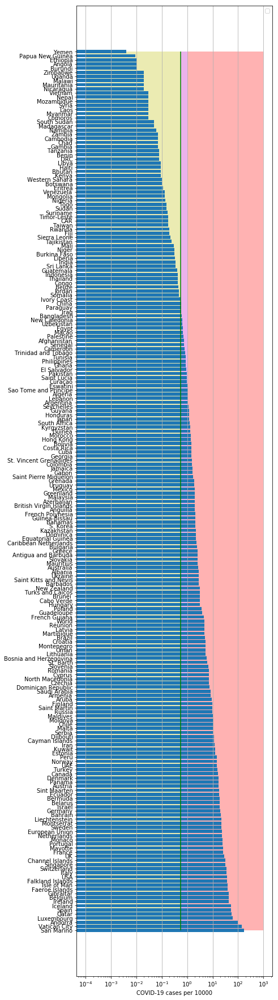

In [462]:
country, cases = get_cases(df,0.01)
country.values, cases.values
stat_picture(country.values, cases.values, high=35, picname="pictures/coronage0.png")

No handles with labels found to put in legend.
/usr/local/lib/python3.5/dist-packages/matplotlib/cbook/deprecation.py:107: MatplotlibDeprecationWarning: Adding an axes using the same arguments as a previous axes currently reuses the earlier instance.  In a future version, a new instance will always be created and returned.  Meanwhile, this warning can be suppressed, and the future behavior ensured, by passing a unique label to each axes instance.
  warnings.warn(message, mplDeprecation, stacklevel=1)


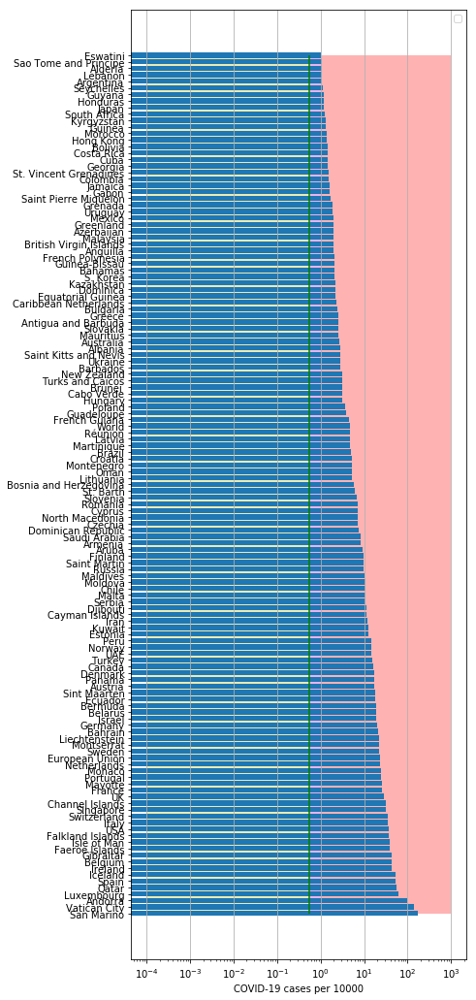

In [463]:
country, cases = get_cases(df,100.0)
stat_picture(country.values, cases.values, high=20, picname="pictures/coronage1.png")

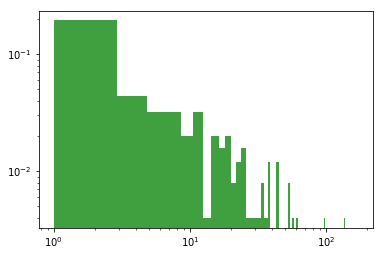

In [464]:
n, bins, patches = plt.hist(cases, 90, density=True,facecolor='g', alpha=0.75)
plt.yscale("log")
plt.xscale("log")

In [467]:
dfSP = read_df(pd.DataFrame(),"SP")
dfGB = read_df(pd.DataFrame(),"GB")
dfIT = read_df(pd.DataFrame(),"IT")
dfLT = read_df(pd.DataFrame(),"LT")
dfUkr = read_df(pd.DataFrame(),"Ukr")
dfUS = read_df(pd.DataFrame(),"US")
dfCN = read_df(pd.DataFrame(),"CN")
dfFR = read_df(pd.DataFrame(),"FR")
dfKR = read_df(pd.DataFrame(),"KR")
dfW = read_df(pd.DataFrame(),"World")
dfDK = read_df(pd.DataFrame(),"DK")
dfNG = read_df(pd.DataFrame(),"NG")
dfGR = read_df(pd.DataFrame(),"GR")
dfES = read_df(pd.DataFrame(),"ES")
dfSW = read_df(pd.DataFrame(),"SW")
dfPL = read_df(pd.DataFrame(),"PL")
dfIS = read_df(pd.DataFrame(),"IS")
dfUR = read_df(pd.DataFrame(),"Ukr")
dfSZ = read_df(pd.DataFrame(),"SZ")
dfIN = read_df(pd.DataFrame(),"IN")
#dfKRA = read_df(pd.DataFrame(),"KRA")
dfRS = read_df(pd.DataFrame(),"RS")
dfJP = read_df(pd.DataFrame(),"JP")
dfNL = read_df(pd.DataFrame(),"NL")
dfAT = read_df(pd.DataFrame(),"AT")
dfBG = read_df(pd.DataFrame(),"BG")
dfSG = read_df(pd.DataFrame(),"SG")
dfLV = read_df(pd.DataFrame(),"LV")
dfCA = read_df(pd.DataFrame(),"CA")
dfPT = read_df(pd.DataFrame(),"PT")
dfTR = read_df(pd.DataFrame(),"TR")
dfBZ = read_df(pd.DataFrame(),"BZ")
dfAS = read_df(pd.DataFrame(),"AS")
dfML = read_df(pd.DataFrame(),"ML")
dfZL = read_df(pd.DataFrame(),"ZL")
dfBR = read_df(pd.DataFrame(),"BR")
dfIR = read_df(pd.DataFrame(),"IR")
dfCL = read_df(pd.DataFrame(),"CL")
dfCH = read_df(pd.DataFrame(),"CH")
dfRM = read_df(pd.DataFrame(),"RM")
dfFI = read_df(pd.DataFrame(),"FI")
dfID = read_df(pd.DataFrame(),"ID")
dfED = read_df(pd.DataFrame(),"ED")
dfPH = read_df(pd.DataFrame(),"PH")
#dfPK = read_df(pd.DataFrame(),"PK")
dfLX = read_df(pd.DataFrame(),"LX")
dfTH = read_df(pd.DataFrame(),"TH")
dfIE = read_df(pd.DataFrame(),"IE")
dfMX = read_df(pd.DataFrame(),"MX")
dfPM = read_df(pd.DataFrame(),"PM")
dfPU = read_df(pd.DataFrame(),"PU")
dfSB = read_df(pd.DataFrame(),"SB")
dfAG = read_df(pd.DataFrame(),"AG")
dfCT = read_df(pd.DataFrame(),"CT")
dfEG = read_df(pd.DataFrame(),"EG")
dfSV = read_df(pd.DataFrame(),"SV")
dfMR = read_df(pd.DataFrame(),"MR")
dfIQ = read_df(pd.DataFrame(),"IQ")
dfIC = read_df(pd.DataFrame(),"IC")
dfQR = read_df(pd.DataFrame(),"QR")
dfCB = read_df(pd.DataFrame(),"CB")
dfBL = read_df(pd.DataFrame(),"BL")
dfAG = read_df(pd.DataFrame(),"AR")
dfEU = read_df(pd.DataFrame(),"EU")
dfMT = read_df(pd.DataFrame(),"MT")
dfCP = read_df(pd.DataFrame(),"CP")

SP
          date   cases  active    death
65 2020-04-30  239639   77112  24543.0
66 2020-05-01  242988   75714  24824.0
67 2020-05-02  245567   74234  25100.0
68 2020-05-03  247122   73300  25264.0
69 2020-05-04  248301   71240  25428.0
GB
          date   cases  active    death
64 2020-04-30  171253  144138  26771.0
65 2020-05-01  177454  149600  27510.0
66 2020-05-02  182260  153785  28131.0
67 2020-05-03  186599  157809  28446.0
68 2020-05-04  190584  161506  28734.0
IT
          date   cases  active    death
67 2020-04-30  205463  101551  27967.0
68 2020-05-01  207428  100943  28236.0
69 2020-05-02  209328  100704  28710.0
70 2020-05-03  210717  100179  28884.0
71 2020-05-04  211938   99980  29079.0
LT
          date  cases  active  death   tests
52 2020-04-30   1399     760   45.0  132768
53 2020-05-01   1406     728   45.0  138270
54 2020-05-02   1410     727   46.0  141678
55 2020-05-03   1419     735   46.1  144029
56 2020-05-04   1423     678   46.0  149106
Ukr
          date

IE
          date  cases  active  death
52 2020-04-30  10118  7804.0  792.0
53 2020-05-01  10551  8160.0  800.0
54 2020-05-02  10843  8347.0  831.0
55 2020-05-03  11192  8471.0  845.0
56 2020-05-04  11587  8769.0  864.0
MX
          date  cases  active   death
53 2020-04-30  19224  5942.0  1859.0
54 2020-05-01  20739  6390.0  1972.0
55 2020-05-02  22088  6580.0  2061.0
56 2020-05-03  23471  7870.0  2154.0
57 2020-05-04  24905  6696.0  2271.0
PM
          date  cases  active  death
51 2020-04-30   6532  5768.0  188.0
52 2020-05-01   6720  5906.0  192.0
53 2020-05-02   7090  6252.0  197.0
54 2020-05-03   7197  6356.0  200.0
55 2020-05-04   7387  6458.0  203.0
PU
          date  cases   active   death
54 2020-04-30  36976  25520.0  1051.0
55 2020-05-01  40459  28206.0  1124.0
56 2020-05-02  42534  28900.0  1200.0
57 2020-05-03  45928  31092.0  1286.0
58 2020-05-04  47372  31601.0  1344.0
SB
          date  cases  active  death
51 2020-04-30   9009  7487.0  179.0
52 2020-05-01   9205  7641

In [468]:
dfBL = dfBL.fillna(0)
dfRM = dfRM.fillna(0)
dfSV = dfSV.fillna(0)
dfCT = dfCT.fillna(0)
#dfAR = dfAR.fillna(0)
dfSB = dfSB.fillna(0)
dfCP = dfCP.fillna(0)
dfID = dfID.fillna(0)
dfAG = dfAG.fillna(0)
dfMX = dfMX.fillna(0)
dfPU = dfPU.fillna(0)
dfIQ = dfIQ.fillna(0)
dfIE = dfIE.fillna(0)
dfPH = dfPH.fillna(0)
dfTH = dfTH.fillna(0)
dfMR = dfMR.fillna(0)

In [469]:
from sklearn.linear_model import LinearRegression
populationSp = dfp[dfp['Country (or dependency)']=='Spain'].Population.tolist()[0]
y = np.log(dfSP['cases'].values*10000./populationSp)
x = np.array(range(dfSP['cases'].size)).reshape((-1, 1))
model = LinearRegression().fit(x, y)
r_sq = model.score(x, y)
print('coefficient of determination:', r_sq)
print('intercept:', model.intercept_)
print('slope:', model.coef_)


coefficient of determination: 0.7997526493941806
intercept: -2.9713763500028847
slope: [0.12934821]


/usr/local/lib/python3.5/dist-packages/matplotlib/cbook/deprecation.py:107: MatplotlibDeprecationWarning: Adding an axes using the same arguments as a previous axes currently reuses the earlier instance.  In a future version, a new instance will always be created and returned.  Meanwhile, this warning can be suppressed, and the future behavior ensured, by passing a unique label to each axes instance.
  warnings.warn(message, mplDeprecation, stacklevel=1)


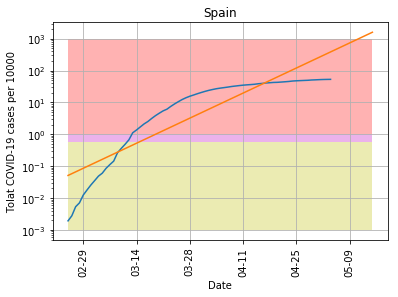

In [470]:
from matplotlib.dates import DateFormatter
#fig, ax = plt.subplots(figsize=(12, 12))
yc = 0.56
plt.plot(dfSP['date'].values,dfSP['cases']*10000./populationSp)
date_form = DateFormatter("%m-%d")
ax = plt.axes()
ax.xaxis.set_major_formatter(date_form)
ix = pd.date_range('2020-02-25', '2020-05-15', freq='D')
ss = pd.DataFrame({'date': ix})
y_pred = np.exp(model.intercept_ + model.coef_ * range(len(ix)))
ax.plot(ss['date'].values,y_pred)
plt.xticks(rotation=90)
plt.title('Spain')
plt.ylabel('Tolat COVID-19 cases per 10000')
ax.fill_between(ss['date'].values, 1,1000, facecolor='red', alpha=0.3)
ax.fill_between(ss['date'].values, yc,1, facecolor='m', alpha=0.3)
ax.fill_between(ss['date'].values, 1e-3,yc, facecolor='y', alpha=0.3)
plt.xlabel('Date')
plt.yscale('log')
plt.yscale('log')
plt.grid()
plt.savefig("pictures/coronaSP.png")
plt.show()

In [471]:
populationUK = dfp[dfp['Country (or dependency)']=='United Kingdom'].Population.tolist()[0]
model1, r_sql, dfGB1 = linreg(dfGB,populationUK)
print('coefficient of determination:', r_sql)
print('intercept:', model1.intercept_)
print('slope:', model1.coef_)

coefficient of determination: 0.9054245890502824
intercept: -4.510303974069146
slope: [0.13987061]


/usr/local/lib/python3.5/dist-packages/matplotlib/cbook/deprecation.py:107: MatplotlibDeprecationWarning: Adding an axes using the same arguments as a previous axes currently reuses the earlier instance.  In a future version, a new instance will always be created and returned.  Meanwhile, this warning can be suppressed, and the future behavior ensured, by passing a unique label to each axes instance.
  warnings.warn(message, mplDeprecation, stacklevel=1)


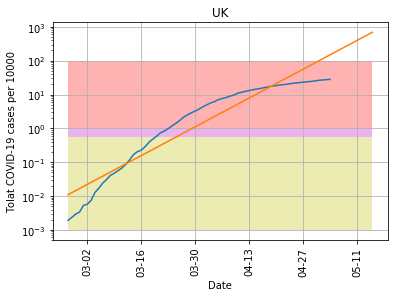

In [472]:
ss1t = plotpred(dfGB1,populationUK,'2020-02-26', '2020-05-15', "pictures/coronaGB.png", model1, 'UK',100)

In [473]:
populationIT = dfp[dfp['Country (or dependency)']=='Italy'].Population.tolist()[0]
coefIT = 4.0718751-0.3
yy1 = np.log(coefIT-np.log(dfIT['cases'].values*10000./populationIT))
xx1 = np.array(range(dfIT['cases'].size)).reshape((-1, 1))
model11 = LinearRegression().fit(xx1, yy1)
r_sq1 = model11.score(xx1, yy1)
print('coefficient of determination:', r_sq1)
print('intercept:', model11.intercept_)
print('slope:', model11.coef_)

coefficient of determination: 0.9941713981317399
intercept: 1.9347519627177603
slope: [-0.05157333]


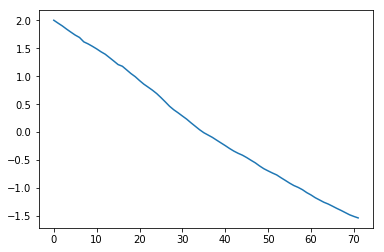

In [474]:
plt.plot(xx1,yy1)

/usr/local/lib/python3.5/dist-packages/matplotlib/cbook/deprecation.py:107: MatplotlibDeprecationWarning: Adding an axes using the same arguments as a previous axes currently reuses the earlier instance.  In a future version, a new instance will always be created and returned.  Meanwhile, this warning can be suppressed, and the future behavior ensured, by passing a unique label to each axes instance.
  warnings.warn(message, mplDeprecation, stacklevel=1)


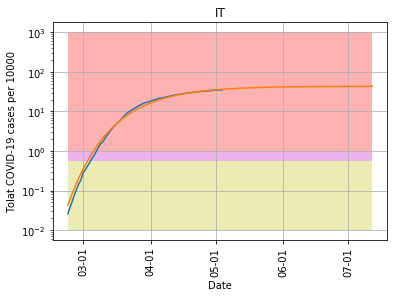

In [475]:
from matplotlib.dates import DateFormatter
#fig, ax = plt.subplots(figsize=(12, 12))
plt.plot(dfIT['date'].values,dfIT['cases']*10000./populationIT)
date_form = DateFormatter("%m-%d")
ax = plt.axes()
ax.xaxis.set_major_formatter(date_form)
ix11 = pd.date_range('2020-02-23', '2020-07-12', freq='D')
ss11 = pd.DataFrame({'date': ix11})
y_pred11 = np.exp(coefIT-np.exp(model11.intercept_ + model11.coef_ * range(len(ix11))))
ax.plot(ss11['date'].values,y_pred11)
plt.xticks(rotation=90)
plt.title('IT')
plt.ylabel('Tolat COVID-19 cases per 10000')
ax.fill_between(ss11['date'].values, 1,1000, facecolor='red', alpha=0.3)
ax.fill_between(ss11['date'].values, yc,1, facecolor='m', alpha=0.3)
ax.fill_between(ss11['date'].values, 1e-2,yc, facecolor='y', alpha=0.3)
plt.xlabel('Date')
plt.yscale('log')
#plt.yscale('log')
plt.grid()
plt.savefig("pictures/coronaIT.png")
plt.show()

In [476]:
cs=y_pred11[-1]/10000.*populationIT

In [477]:
cs

261448.61645283797

In [488]:
populationLT = dfp[dfp['Country (or dependency)']=='Lithuania'].Population.tolist()[0]
model1, r_sql, dfLT1 = linreg(dfLT[1:],populationLT)
print('coefficient of determination:', r_sql)
print('intercept:', model1.intercept_)
print('slope:', model1.coef_)

coefficient of determination: 0.7213536952664761
intercept: -2.5935845133819804
slope: [0.1010396]


/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy


/usr/local/lib/python3.5/dist-packages/matplotlib/cbook/deprecation.py:107: MatplotlibDeprecationWarning: Adding an axes using the same arguments as a previous axes currently reuses the earlier instance.  In a future version, a new instance will always be created and returned.  Meanwhile, this warning can be suppressed, and the future behavior ensured, by passing a unique label to each axes instance.
  warnings.warn(message, mplDeprecation, stacklevel=1)


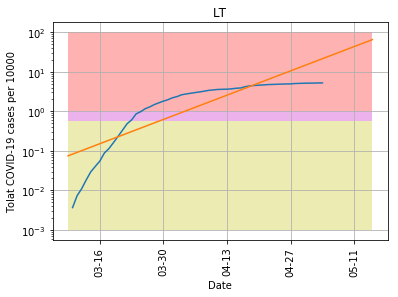

In [489]:
populationLT = dfp[dfp['Country (or dependency)']=='Lithuania'].Population.tolist()[0]
ss1t = plotpred(dfLT[1:],populationLT,'2020-03-09', '2020-05-15', "pictures/coronaLT.png", model1, 'LT',100)

In [490]:
populationUKr = dfp[dfp['Country (or dependency)']=='Ukraine'].Population.tolist()[0]
model11, r_sql, dfUkr1 = linreg(dfUkr, populationUKr)
print('coefficient of determination:', r_sq1)
print('intercept:', model11.intercept_)
print('slope:', model11.coef_)

coefficient of determination: 0.9941713981317399
intercept: -6.349552465124369
slope: [0.1600067]


/usr/local/lib/python3.5/dist-packages/matplotlib/cbook/deprecation.py:107: MatplotlibDeprecationWarning: Adding an axes using the same arguments as a previous axes currently reuses the earlier instance.  In a future version, a new instance will always be created and returned.  Meanwhile, this warning can be suppressed, and the future behavior ensured, by passing a unique label to each axes instance.
  warnings.warn(message, mplDeprecation, stacklevel=1)


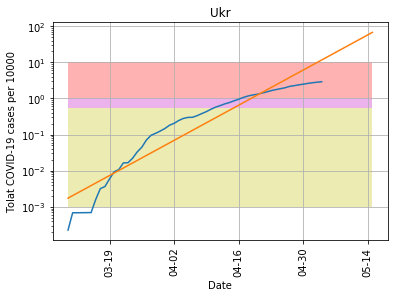

In [491]:
ss1t1 = plotpred(dfUkr1,populationUKr,'2020-03-10', '2020-05-15', "pictures/coronaUkr.png", model11, 'Ukr',10)

No handles with labels found to put in legend.
/usr/local/lib/python3.5/dist-packages/matplotlib/cbook/deprecation.py:107: MatplotlibDeprecationWarning: Adding an axes using the same arguments as a previous axes currently reuses the earlier instance.  In a future version, a new instance will always be created and returned.  Meanwhile, this warning can be suppressed, and the future behavior ensured, by passing a unique label to each axes instance.
  warnings.warn(message, mplDeprecation, stacklevel=1)


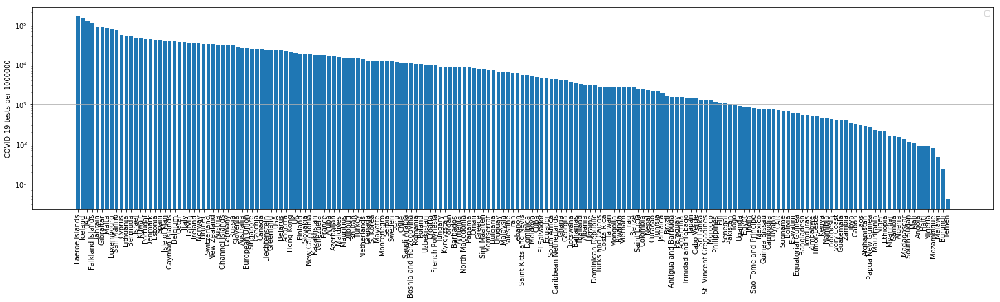

In [492]:
# Prepare the data
dfTs = dfAll
dfTs = dfTs.sort_values(by=['Testsper1Mpop'], ascending=False)
dfTs = dfTs[dfTs['Testsper1Mpop']>0]
x = dfTs['Country']
y = dfTs['Testsper1Mpop']
fig = plt.figure( figsize=(25, 6))
fig.subplots_adjust(bottom=0.2)
# Plot the data
plt.bar(x, y)

plt.xticks(rotation=90)
plt.ylabel('COVID-19 tests per 1000000')
# Add a legend
plt.legend()
ax = plt.axes() 
#ax.fill_between(x, 1,10, facecolor='red', alpha=0.3)
yc = 0.56
#ax.fill_between(x, yc,1, facecolor='m', alpha=0.3)
#ax.fill_between(x, 1e-4,yc, facecolor='y', alpha=0.3)
#plt.hlines(yc, 0, len(df)-1, colors='g', linestyles='solid')
#plt.ylim([1e-4,10])
ax.yaxis.grid() # horizontal lines
#ax.xaxis.grid() # vertical lines
plt.yscale("log")
# Show the plot
plt.savefig("pictures/coronaTests.png")
plt.show()

In [493]:
populationUS= dfp[dfp['Country (or dependency)']=='United States'].Population.tolist()[0]
model11, r_sql, dfUS1 = linreg(dfUS, populationUS)
print('coefficient of determination:', r_sq1)
print('intercept:', model11.intercept_)
print('slope:', model11.coef_)

coefficient of determination: 0.9941713981317399
intercept: -4.104922935985155
slope: [0.14877175]


/usr/local/lib/python3.5/dist-packages/matplotlib/cbook/deprecation.py:107: MatplotlibDeprecationWarning: Adding an axes using the same arguments as a previous axes currently reuses the earlier instance.  In a future version, a new instance will always be created and returned.  Meanwhile, this warning can be suppressed, and the future behavior ensured, by passing a unique label to each axes instance.
  warnings.warn(message, mplDeprecation, stacklevel=1)


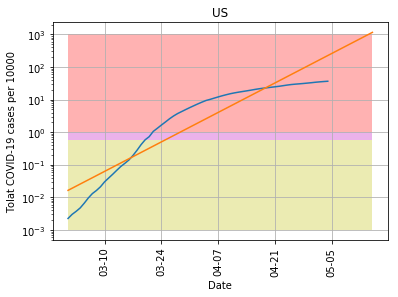

In [494]:
ss1t = plotpred(dfUS1,populationUS,'2020-03-01', '2020-05-15', "pictures/coronaUS.png", model11, 'US',1000)

In [495]:
dfAll[dfAll["Country"]=="Latvia"]
dfAll.fillna(0, inplace=True)

North America
            Country         0
228  European Union  0.104351


(0, 0.15)

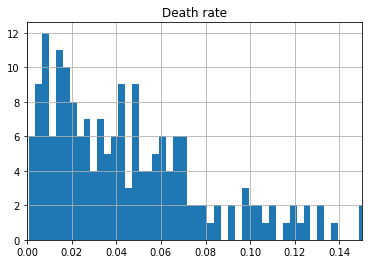

In [496]:
dfT1 = dfAll#[dfAll["Total Cases"]>0]
dfTT = pd.concat([dfT1["Country"],dfT1["TotalDeaths"]/dfT1["TotalCases"]], axis=1)
dfTT = dfTT[dfTT[0]>=0]
print(dfTT.Country[0])
print(dfTT[dfTT.Country=="European Union"])
dfTTh = dfTT.sort_values(by=[0], ascending=False)
hist = dfTTh[dfTTh[0]>0].hist(bins=9*12)
plt.title("Death rate")
plt.xlim([0,0.15])

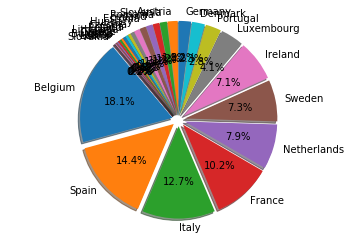

In [497]:
cLst = countriesEU
dfT1 = dfAll[dfAll['Country'].isin(cLst)]
#dfD1 = dfAll#[dfAll["Total Cases"]>0]
dfTT = pd.concat([dfT1["Country"],dfT1["Deathsper1Mpop"]], axis=1)
dfTT = dfTT[dfTT["Deathsper1Mpop"]>0]
#print(dfDD.Country[0])
#print(dfDD[dfDD.Country=="Latvia"])
dfTTh = dfTT.sort_values(by=["Deathsper1Mpop"], ascending=False)
dfTTh.rename(columns={0: "DeathRate"})
#hist = dfTTh.hist(bins=9*16)
#plt.yscale("log")
#plt.xscale("log")
#plt.xlim([0,200])
#plt.show()
#import matplotlib.pyplot as plt

labels = dfTTh.Country.tolist()#'apple', 'banana', 'cherry', 'durian', 'elderberries', 'figs', 'grapes'
sizes = dfTTh.Deathsper1Mpop.values#[32, 20, 15, 10, 10, 8, 5]

p = plt.pie(sizes, labels=labels, explode=(.07,)*len(sizes), autopct='%1.1f%%', startangle=130, shadow=True)
plt.axis('equal')

            
plt.show()

In [498]:
dfTTh.head()

,Country,Deathsper1Mpop
18,Belgium,684.0
8,Spain,544.0
9,Italy,481.0
11,France,386.0
21,Netherlands,297.0


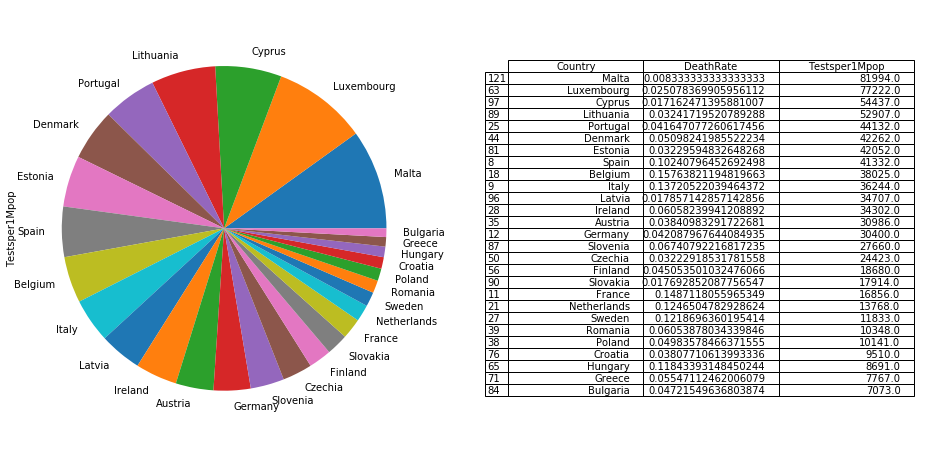

In [499]:
dfT1 = dfAll[dfAll['Country'].isin(cLst)]
dfTT = pd.concat([dfT1["Country"],dfT1["TotalDeaths"]/dfT1["TotalCases"],dfT1["Testsper1Mpop"]], axis=1)
dfTT = dfTT[dfTT[0]>=0]
#print(dfTT.Country[0])
#print(dfTT[dfTT.Country=="European Union"])
dfTTh = dfTT.sort_values(by=["Testsper1Mpop"], ascending=False)
dfTTh = dfTTh.rename(columns={0: "DeathRate"})
#import matplotlib.pyplot as plt
from pandas.plotting import table
plt.figure(figsize=(16,8))
# plot chart
ax1 = plt.subplot(121, aspect='equal')
dfTTh.plot.pie(y=["Testsper1Mpop"],ax=ax1,labels=dfTTh['Country'],legend = False)
ax2 = plt.subplot(122)
plt.axis('off')
tbl = table(ax2, dfTTh, loc='center')
tbl.auto_set_font_size(False)
#tbl.set_fontsize(14)
plt.savefig("pictures/DeathRate2.png")
plt.show()

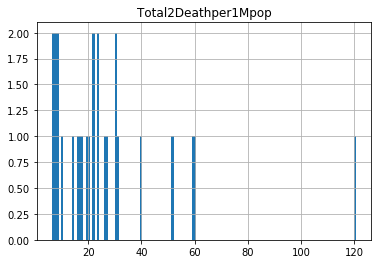

In [500]:
dfD1 = dfAll[dfAll['Country'].isin(cLst)]#[dfAll["Total Cases"]>0]
dfDD = pd.concat([dfD1["Country"],dfD1["TotCasesper1Mpop"],dfD1["Deathsper1Mpop"]], axis=1)
dfDD2 = pd.concat([dfD1["Country"],dfD1["TotCasesper1Mpop"]/dfD1["Testsper1Mpop"]], axis=1)
dfDD = dfDD[dfDD["Deathsper1Mpop"]>0]
#print(dfDD.Country[0])
#print(dfDD[dfDD.Country=="Latvia"])
dfDD1 = pd.concat([dfDD["Country"],dfDD["TotCasesper1Mpop"]/dfDD["Deathsper1Mpop"]], axis=1)
dfDDh = dfDD1.sort_values(by=[0], ascending=False)
dfDDh=dfDDh.rename(columns={0:"Total2Deathper1Mpop"})
dfDDh2=dfDD2.rename(columns={0:"Cases2Testsper1Mpop"})
hist = dfDDh.hist(bins=9*15)
#plt.yscale("log")
#plt.xscale("log")
#plt.xlim([0,200])

In [501]:
dfDD.head()

,Country,TotCasesper1Mpop,Deathsper1Mpop
8,Spain,5311.0,544.0
9,Italy,3505.0,481.0
11,France,2596.0,386.0
12,Germany,1983.0,83.0
18,Belgium,4337.0,684.0


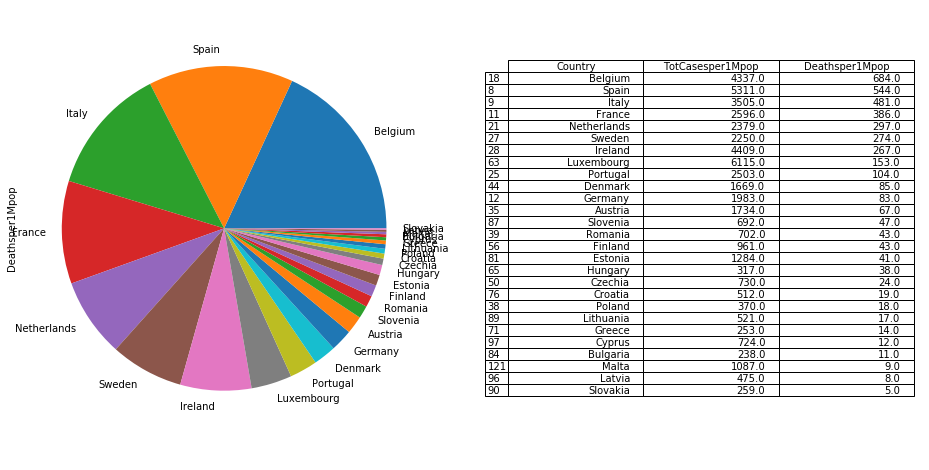

In [502]:
from pandas.plotting import table
plt.figure(figsize=(16,8))
# plot chart
ax1 = plt.subplot(121, aspect='equal')
dfDD = dfDD.sort_values(by=['Deathsper1Mpop'], ascending=False)
dfDD.plot.pie(y='Deathsper1Mpop',ax=ax1,labels=dfDD['Country'],legend = False)
ax2 = plt.subplot(122)
plt.axis('off')
tbl = table(ax2, dfDD, loc='center')
tbl.auto_set_font_size(False)
#tbl.set_fontsize(14)
plt.savefig("pictures/DeathRate1.png")
plt.show()

In [503]:
dfAll.head()

,ActiveCases,Continent,Country,Deathsper1Mpop,NewCases,NewDeaths,Serious_Critical,Testsper1Mpop,TotalCases,TotalDeaths,TotalRecovered,TotalTests,TotCasesper1Mpop
0,1009038,North America,North America,0.0,1873.0,123.0,17297.0,0.0,1320910,76897.0,234975.0,0.0,0.0
1,770442,Europe,Europe,0.0,30.0,12.0,16949.0,0.0,1469941,142155.0,557344.0,0.0,0.0
2,247938,Asia,Asia,0.0,600.0,13.0,5290.0,0.0,573439,20091.0,305410.0,0.0,0.0
3,135039,South America,South America,0.0,460.0,30.0,9938.0,0.0,224734,11298.0,78397.0,0.0,0.0
4,30002,Africa,Africa,0.0,6.0,0.0,129.0,0.0,48081,1848.0,16231.0,0.0,0.0


In [504]:
dfDDh2.head()

,Country,Cases2Testsper1Mpop
8,Spain,0.128496
9,Italy,0.096706
11,France,0.154010
12,Germany,0.065230
18,Belgium,0.114057


In [505]:
dfDDh2 = dfDDh2.sort_values(by=["Cases2Testsper1Mpop"], ascending=False)

In [506]:
print (dfDDh2[dfDDh2["Cases2Testsper1Mpop"]<1000].to_string(index=False))

     Country  Cases2Testsper1Mpop
      Sweden             0.190146
 Netherlands             0.172792
      France             0.154010
     Ireland             0.128535
       Spain             0.128496
     Belgium             0.114057
       Italy             0.096706
  Luxembourg             0.079187
     Romania             0.067839
     Germany             0.065230
    Portugal             0.056716
     Austria             0.055961
     Croatia             0.053838
     Finland             0.051445
     Denmark             0.039492
      Poland             0.036486
     Hungary             0.036475
    Bulgaria             0.033649
      Greece             0.032574
     Estonia             0.030534
     Czechia             0.029890
    Slovenia             0.025018
    Slovakia             0.014458
      Latvia             0.013686
      Cyprus             0.013300
       Malta             0.013257
   Lithuania             0.009847


In [507]:
dfT1 = dfAll
dfTT = pd.concat([dfT1["Country"],dfT1["TotalDeaths"]/dfT1["TotalCases"],dfT1["Testsper1Mpop"]], axis=1)
dfTT = dfTT[dfTT[0]>=0]
#print(dfTT.Country[0])
#print(dfTT[dfTT.Country=="European Union"])
dfTTh = dfTT.sort_values(by=[0], ascending=False)
dfTTh = dfTTh.rename(columns={0: "DeathRate"})
dfTT[dfTT[0]>=0.000001].sort_values(by=[0], ascending=True)
#dfTT[dfTT.Country=="France"]

,Country,0,Testsper1Mpop
34,Qatar,0.000741,37068.000000
31,Singapore,0.000959,24600.000000
93,Djibouti,0.001792,14395.000000
117,Maldives,0.001815,15405.000000
64,Bahrain,0.002264,87910.000000
127,Guinea-Bissau,0.002421,762.000000
94,Hong Kong,0.003842,20674.000000
70,Oman,0.004551,7923.000000
74,Uzbekistan,0.004568,9710.000000
80,Guinea,0.005263,0.000000


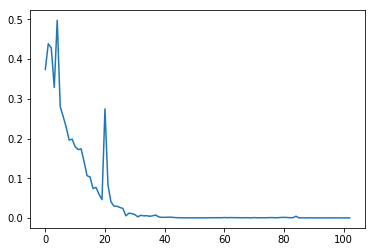

In [508]:
plt.plot(range(len(dfCN["cases"].values)-1),np.diff(np.log(dfCN["cases"].values)))

In [509]:
#np.diff(np.log(dfCN["cases"].values))

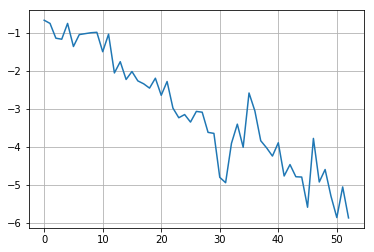

In [512]:
plt.plot(range(len(dfLT["cases"].values[3:])-1),np.log(np.diff(np.log(dfLT["cases"].values[3:]))))
plt.grid()

/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:3: RuntimeWarning: divide by zero encountered in log
  This is separate from the ipykernel package so we can avoid doing imports until


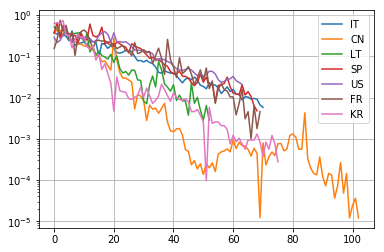

In [513]:
plt.plot(range(len(dfIT["cases"].values)-1),np.diff(np.log(dfIT["cases"].values))[:],label='IT')
plt.plot(range(len(dfCN["cases"].values)-1),np.diff(np.log(dfCN["cases"].values)),label='CN')
plt.plot(range(len(dfLT["cases"].values)-4),np.diff(np.log(dfLT["cases"].values))[3:],label='LT')
plt.plot(range(len(dfSP["cases"].values)-1),np.diff(np.log(dfSP["cases"].values)),label='SP')
plt.plot(range(len(dfUS["cases"].values)-1),np.diff(np.log(dfUS["cases"].values)),label='US')
plt.plot(range(len(dfFR["cases"].values)-10),np.diff(np.log(dfFR["cases"].values))[9:],label='FR')
plt.plot(range(len(dfKR["cases"].values)-4),np.diff(np.log(dfKR["cases"].values))[3:],label='KR')
plt.yscale('log')
plt.grid()
plt.legend()
plt.show()

64 64
coefficient of determination: 0.9371884363994932
intercept: -7.475283526428585
slope: [-0.19164946]


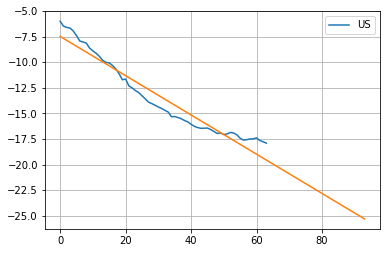

In [514]:
y = np.log(np.diff(dfUS["cases"].values)[:]/dfUS["cases"].values[1:]**2)
x = np.array(range(len(dfUS["cases"].values)-1)).reshape((-1, 1))
print (x.size,y.size)
model = LinearRegression().fit(x, y)
r_sq = model.score(x, y)
print('coefficient of determination:', r_sq)
print('intercept:', model.intercept_)
print('slope:', model.coef_)
plt.plot(x,y,label='US')
y_pred11 = model.intercept_ + model.coef_ * range(len(x)+30) 
plt.plot(range(len(x)+30),y_pred11)
plt.grid()
plt.legend()
plt.savefig("pictures/logdiffUS.png")
plt.show()

71 71
coefficient of determination: 0.9249860875839331
intercept: -8.803650920232796
slope: [-0.13741766]


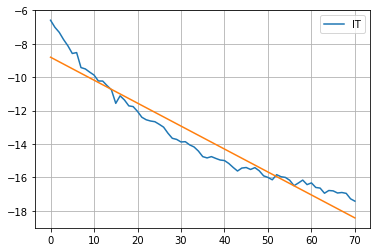

In [515]:
y = np.log(np.diff(dfIT["cases"].values)[:]/dfIT["cases"].values[1:]**2)
x = np.array(range(len(dfIT["cases"].values)-1)).reshape((-1, 1))
print (x.size,y.size)
model = LinearRegression().fit(x, y)
r_sq = model.score(x, y)
print('coefficient of determination:', r_sq)
print('intercept:', model.intercept_)
print('slope:', model.coef_)
plt.plot(x,y,label='IT')
y_pred12 = model.intercept_ + model.coef_ * range(len(x)) 
plt.plot(x,y_pred12)
plt.grid()
plt.legend()
plt.show()

In [516]:
#model11.coef_

In [517]:
#np.log(np.diff(dfLV["cases"].values)[:]/dfLV["cases"].values[1:]**2)

53 53
coefficient of determination: 0.9739939469883112
intercept: -14.404724891479386
slope: [-0.09500344]


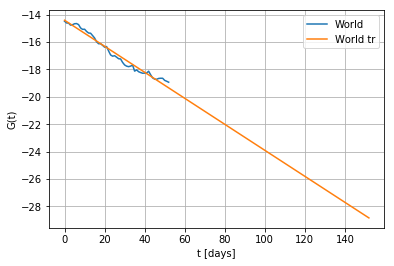

In [518]:
y = np.log(np.diff(dfW["cases"].values)[50:]/dfW["cases"].values[51:]**2)
x = np.array(range(len(dfW["cases"].values[50:])-1)).reshape((-1, 1))
print (x.size,y.size)
model = LinearRegression().fit(x, y)
r_sq = model.score(x, y)
print('coefficient of determination:', r_sq)
print('intercept:', model.intercept_)
print('slope:', model.coef_)
plt.plot(x,y,label='World')
y_pred11 = model.intercept_ + model.coef_ * range(len(x)+100)
plt.plot(range(len(x)+100),y_pred11,label='World tr')
plt.legend()
plt.xlabel('t [days]')
plt.ylabel('G(t)')
plt.grid()
plt.savefig("pictures/logdifflogcoronaW.png")

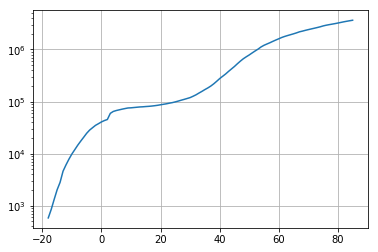

In [519]:
waveform_1 = dfW['cases'].values
waveform_A = dfW['active'].values
t = np.arange(-18,len(waveform_1)-18)
plt.plot(t, waveform_1) 
plt.yscale("log")
plt.grid()
plt.show()

In [520]:
dfW['cases'].values

array([    580,     845,    1317,    2015,    2800,    4581,    6058,
          7813,    9823,   11950,   14553,   17391,   20630,   24545,
         28266,   31439,   34876,   37552,   40553,   43099,   45134,
         59287,   64438,   67100,   69197,   71329,   73332,   75184,
         75700,   76677,   77673,   78651,   79205,   80087,   80828,
         81820,   83112,   84615,   86604,   88585,   90443,   93016,
         95314,   98425,  102050,  106099,  109991,  114381,  118948,
        126214,  134576,  145483,  156653,  169593,  182490,  198238,
        218822,  244933,  275597,  305036,  337489,  378860,  422629,
        471035,  531864,  596366,  663079,  723279,  784738,  858355,
        936237, 1016330, 1117928, 1203058, 1274578, 1347566, 1432869,
       1519195, 1605277, 1700004, 1780713, 1853505, 1925330, 2000065,
       2084633, 2183942, 2252370, 2332650, 2407467, 2482272, 2557917,
       2638909, 2725972, 2833697, 2921571, 2995209, 3065871, 3139009,
       3221029, 3308

/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


[ 5.11152792e+06  2.91241024e+00 -2.22024541e+01  1.62745046e-02]


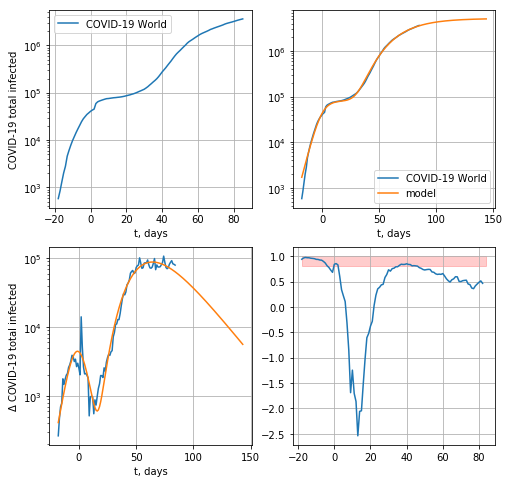

22512.51172397252


In [521]:
def model(t, coeffs):
    coeffsCN = [ 8.08213515e+04,  2.21924344e-01, -7.12649833e-01]
    #coeffsCN = [2.06174475e+06, 1.67277852e-01, 5.36255447e+01]
    return coeffs[0]/(1 + np.exp( - coeffs[3]*coeffs[1] * (t - coeffs[2])))**(1./coeffs[3]) + coeffsCN[0]/(1 + np.exp( - coeffsCN[1] * (t - coeffsCN[2])))

x0 = np.array([2.06174475e+06, 1.67277852e-01, 5.36255447e+01, 0.9 ], dtype=float)
#x0 = np.array([8.08757112e+04,  2.24114193e-01, -6.94900467e-01 ], dtype=float)
def residuals(coeffs, y, t):
    return y - model(t, coeffs)
from scipy.optimize import leastsq
x, flag = leastsq(residuals, x0, args=(waveform_1, t))
print(x)
tt = np.arange(-18,len(waveform_1)-18+59)
fig, ((ax3,ax1),(ax2,ax4)) = plt.subplots(2,2,figsize=(8,8), sharex=False, sharey=False)
ax3.plot(t, waveform_1) 
ax3.legend(['COVID-19 World']) 
ax3.set_xlabel('t, days')
ax3.set_yscale("log")
ax3.set_ylabel(r'COVID-19 total infected')
ax3.grid()
ax1.plot(t, waveform_1, tt, model(tt, x)) 
ax1.legend(['COVID-19 World', 'model']) 
ax1.set_xlabel('t, days')
ax1.set_yscale("log")
ax1.grid()
ax2.plot(t[:-1], np.diff(waveform_1),tt[:-1], np.diff(model(tt, x)))
ax2.set_ylabel(r'$\Delta$ COVID-19 total infected')
ax2.set_yscale("log")
ax2.grid()
ax2.set_xlabel('t, days')
z = np.diff(moving_average(waveform_A, n=3) )/np.diff(moving_average(waveform_1, n=3))
ax4.plot(t[:-3],z)
#ax4.axhline(y=2.2587741081036339/2, color='r')
ax4.fill_between(t[:-1], 0.8078285535018691, 1.,color='r',alpha=0.2)
#ax4.set_yscale("log")
ax4.grid()
plt.savefig("pictures/covidworld.png")

plt.show()
print(np.std(residuals(x, waveform_1, t)))
#expPopWorld = x[0]
expPopWorld = 2.67152730e+06

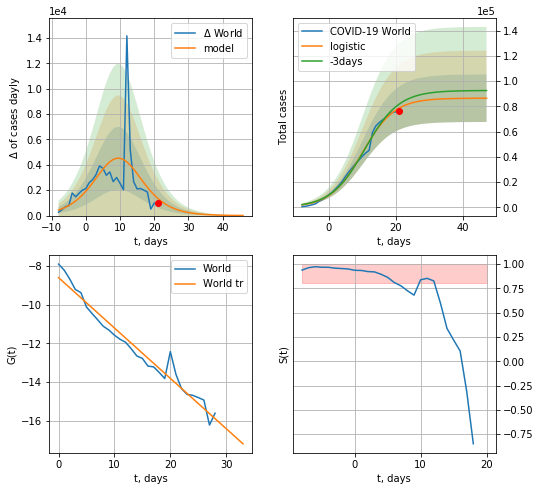

World data at: 2020-05-04
+3 day model MAPE: 0.04256770161128604
model: logistic
coeffs:  [8.64735804e+04 2.09600360e-01 9.98515269e+00]
rational stdev:  0.2178111789766563
forecast at the end of period: +26 days
	 deltaDaycases:  8
	 total cases:  86436 ± 18826
	 total death:  5983 ± 3909
trend coefficient of determination: 0.960820
 intercept: -8.598458
 slope: -0.260482


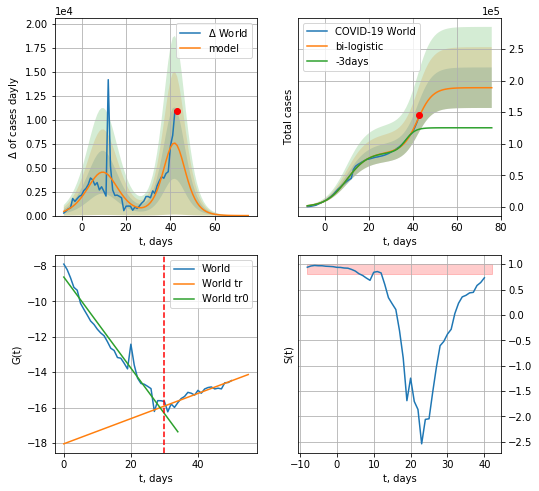

World data at: 2020-05-04
+3 day model MAPE: 0.2157297639626565
model: bi-logistic
coeffs:  [1.02227608e+05 2.95650820e-01 4.22366999e+01] [8.64735804e+04 2.09600360e-01 9.98515269e+00]
rational stdev:  0.16992860985061978
forecast at the end of period: +33 days
	 deltaDaycases:  1
	 total cases:  188696 ± 32064
	 total death:  13062 ± 6658
bi-logistic approximation splitting point: 30
trend0 coefficient of determination: 0.961986
 intercept: -8.630711
 slope: -0.257026
trend coefficient of determination: 0.868835
 intercept: -18.049568
 slope: 0.071157


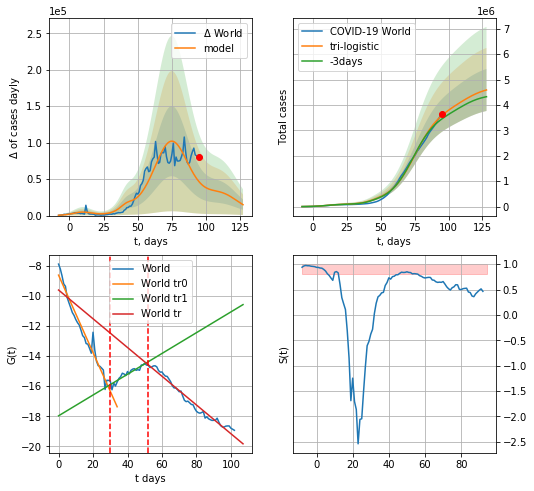

World data at: 2020-05-04
+3 day model MAPE: 0.040293620143388865
model: tri-logistic
coeffs:  [3.64157572e+06 1.10456207e-01 7.51135337e+01] [8.64735804e+04 2.09600360e-01 9.98515269e+00 1.02227608e+05
 2.95650820e-01 4.22366999e+01]
scenario coeffs:  [0.25, 1.0, 1.5]
forecast rational stdev:  0.1801700113395994
forecast at the end of period: +33 days
	 deltaDaycases:  14930
	 total cases:  4588698 ± 826745
	 total death:  317662 ± 171699
tri-logistic approximation splitting points: 30,52
trend0 coefficient of determination: 0.961986
 intercept: -8.630711
 slope: -0.257026
trend1 coefficient of determination: 0.872494
 intercept: -17.970431
 slope: 0.068998
trend coefficient of determination: 0.971328
 intercept: -9.618580
 slope: -0.095426


In [522]:
vL = 30
x = forecast("World",dfW[:vL],d1,7*9-dT,1.0,False)
xx = forecast2("World",dfW[:52],d1,7*10-dT,x,1.0,vL=vL)#,addpred=True,xcoef=[0.25,1.,1.5]
xx = np.concatenate((x, xx), axis=0)
xxx = forecast3("World",dfW,d1,7*10-dT, xx, shift=1.,addpred=True,xcoef=[.25,1.,1.5],vL=[vL,52])

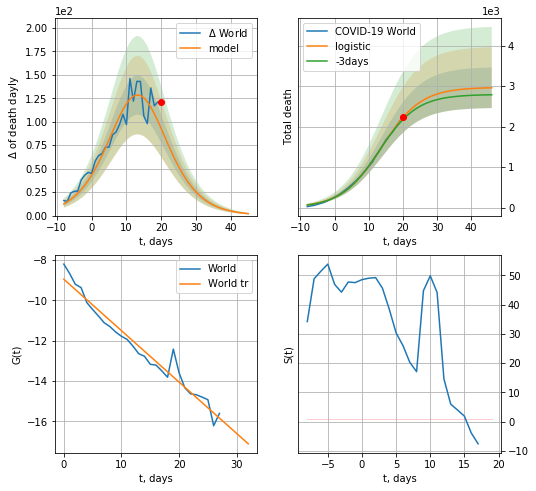

World data at: 2020-05-04
+3 day model MAPE: 0.027312192470115494
model: logistic
coeffs:  [2.96959017e+03 1.73350949e-01 1.36930068e+01]
rational stdev:  0.16928081921473714
forecast at the end of period: +26 days
	 total death:  2958 ± 500
trend coefficient of determination: 0.959176
 intercept: -8.958870
 slope: -0.254930


/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 800.
  warnings.warn(errors[info][0], RuntimeWarning)


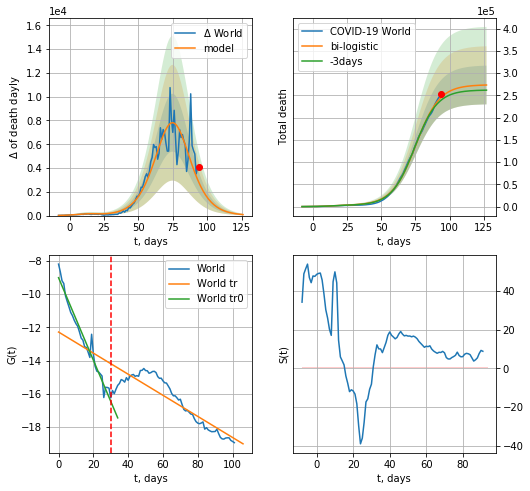

World data at: 2020-05-04
+3 day model MAPE: 0.02738808215861436
model: bi-logistic
coeffs:  [2.70826944e+05 1.15380705e-01 7.52715854e+01] [2.96959017e+03 1.73350949e-01 1.36930068e+01]
rational stdev:  0.15925336850308178
forecast at the end of period: +33 days
	 deltaDaydeath:  84
	 total death:  273105 ± 43492
bi-logistic approximation splitting point: 30
trend0 coefficient of determination: 0.960969
 intercept: -9.026339
 slope: -0.247583
trend coefficient of determination: 0.794209
 intercept: -12.288645
 slope: -0.063340


In [523]:
vL = 30
vL1=52
x = forecast("World",dfW[1:vL],d1,7*9-dT,1.0,False,cases='death')
xx = forecast2("World",dfW[1:],d1,7*10-dT,x,1.0,vL=vL,cases='death')#,addpred=True,xcoef=[0.25,1.,1.5]
#xx = np.concatenate((x, xx), axis=0)
#xxx = forecast3("World",dfW,d1,7*20-dT, xx, shift=1.,addpred=False,xcoef=[.25,1.,1.5],vL=[vL,vL1],cases='death')

In [524]:
#vL = 30
#x = forecast("World",dfW[:vL],d1,7*9-dT,1.0,False)
#xx = forecast2("World",dfW,d1,7*15-dT,x,1.0,addpred=True,xcoef=[3.,1.,1.7],vL=vL)
#trend(dfW,"W",10)

/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


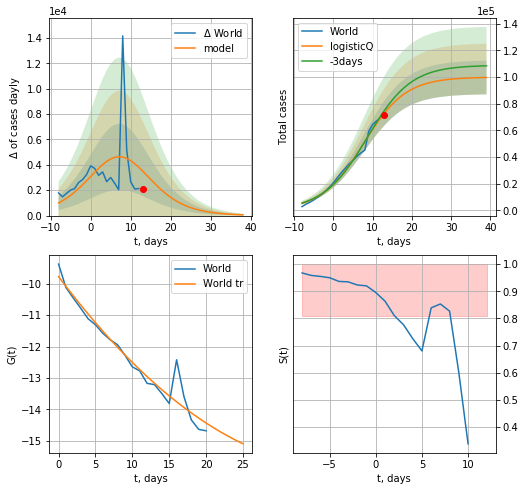

World data at: 2020-05-04
+3 day model MAPE: 0.031802
model: logisticQ
coeffs: [ 9.98643255e+04  1.79652646e-05  7.63889680e+00 -1.03375904e+04]
rational stdev: 0.126959
forecast at the end of period: +26 days
	 deltaDaycases: 58
	 total cases: 99576 ± 12642
	 total death: 6893 ± 2625
trend coefficient of determination: 0.944130
 intercept_: -9.771844228006898
 coeffs_: [ 0.         -0.31384117  0.00402719]


/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


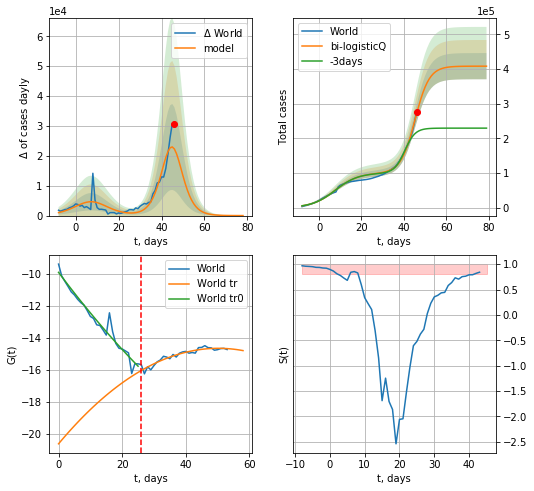

World data at: 2020-05-04
+3 day model MAPE: 0.322399
model: bi-logisticQ
coeffs: [ 3.08550720e+05  9.52088730e-05  4.52981129e+01 -3.08910430e+03]
rational stdev: 0.092561
forecast at the end of period: +33 days
	 deltaDaycases: 4
	 total cases: 408403 ± 37802
	 total death: 28272 ± 7850
bi-logisticQ approximation splitting point: 26
trend coefficient of determination: 0.957216
 intercept_: -9.890425229004336
 coeffs_: [ 0.         -0.26614025  0.00124975]
trend coefficient of determination: 0.900515
 intercept_: -20.622215746086294
 coeffs_: [ 0.          0.23801537 -0.00236922]


/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


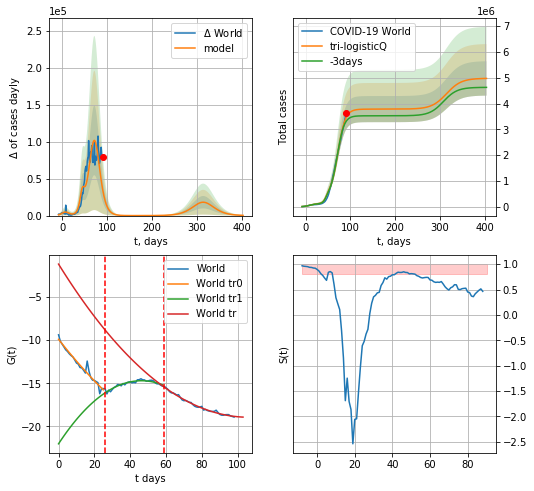

World data at: 2020-05-04
+3 day model MAPE: 0.046750
model: bi-logisticQ
coeffs: [ 3.37522788e+06  2.83487827e-06  7.21912096e+01 -4.25139404e+04]
S.Korea scenario coeffs: [0.35416971, 0.02606324, 4.35859408, 19.30413219]
rational stdev: 0.133916
forecast at the end of period: +313 days
	 deltaDaycases: 327
	 total cases: 4973780 ± 666067
	 total death: 344320 ± 138329
tri-logisticQ approximation splitting points: 26,59
trend coefficient of determination: 0.957216
 intercept_: -9.890425229004336
 coeffs_: [ 0.         -0.26614025  0.00124975]
trend1 coefficient of determination: 0.874764
 intercept_: -22.035447570025077
 coeffs_: [ 0.          0.31660897 -0.00341999]
trend coefficient of determination: 0.989732
 intercept_: -1.1621632162289828
 coeffs_: [ 0.         -0.33547046  0.00158198]


In [525]:
vL=30 - 4
vL1=59
koreaCoeffs = [  0.35416971,   0.02606324,   4.35859408,  19.30413219]
x = forecastRRR("World",dfW[4:vL],d1,7*9-dT,1.0,False)
xx = forecast2RRR("World",dfW[4:vL1],d1,7*10-dT,x,1.0,vL=vL)#,addpred=True,xcoef=[0.25,1.,1.5]
xx = np.concatenate((x, xx), axis=0)
xxx = forecast3RRR("World",dfW[4:],d1,7*50-dT, xx, shift=1.,addpred=True,xcoef=koreaCoeffs,vL=[vL,vL1])

In [526]:
#x = forecastR("World",dfW[:30],d1,7*9-dT,1.0)
#xx = forecast2R("World",dfW,d1,7*15-dT,x,1.0,addpred=True,xcoef=[0.25,1.,1.8,1])

/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


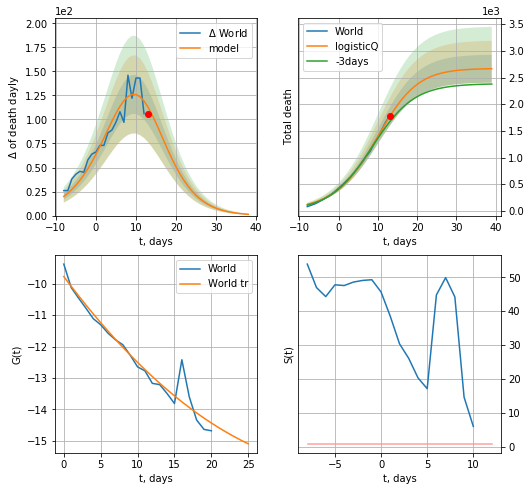

World data at: 2020-05-04
+3 day model MAPE: 0.067194
model: logisticQ
coeffs: [ 2.67019299e+03  8.28077677e-04  9.49653382e+00 -2.18469917e+02]
rational stdev: 0.098000
forecast at the end of period: +26 days
	 total death: 2665 ± 261
trend coefficient of determination: 0.944130
 intercept_: -9.771844228006898
 coeffs_: [ 0.         -0.31384117  0.00402719]


/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


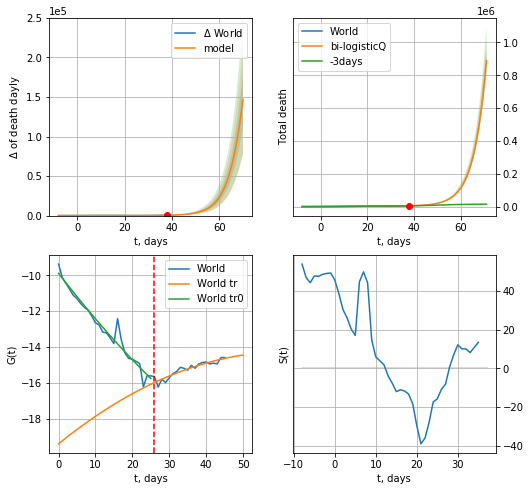

World data at: 2020-05-04
+3 day model MAPE: 0.105655
model: bi-logisticQ
coeffs: [ 6.42204134e+06  6.90051546e-04  7.95652837e+01 -2.38689793e+02]
rational stdev: 0.076590
forecast at the end of period: +33 days
	 total death: 890122 ± 68174
bi-logisticQ approximation splitting point: 26
trend coefficient of determination: 0.957216
 intercept_: -9.890425229004336
 coeffs_: [ 0.         -0.26614025  0.00124975]
trend coefficient of determination: 0.866834
 intercept_: -19.41123113056416
 coeffs_: [ 0.          0.16686573 -0.0013545 ]


/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:432: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


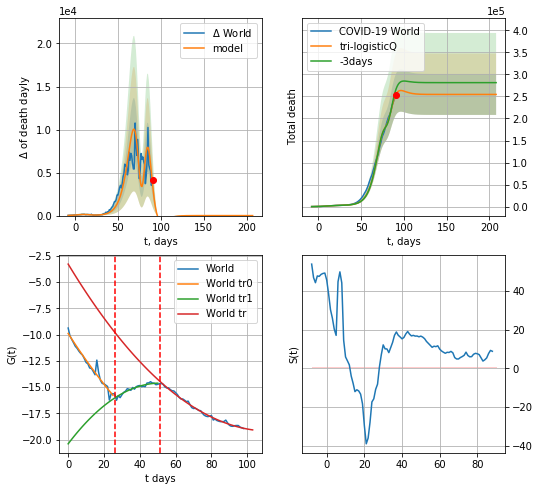

World data at: 2020-05-04
+3 day model MAPE: 0.050276
model: bi-logisticQ
coeffs: [-6.17008675e+06  4.05896684e-05  7.97257441e+01 -5.49334189e+03]
rational stdev: 0.182550
forecast at the end of period: +117 days
	 total death: 254624 ± 46481
tri-logisticQ approximation splitting points: 26,51
trend coefficient of determination: 0.957216
 intercept_: -9.890425229004336
 coeffs_: [ 0.         -0.26614025  0.00124975]
trend1 coefficient of determination: 0.890965
 intercept_: -20.382525077358043
 coeffs_: [ 0.          0.22422642 -0.00217733]
trend coefficient of determination: 0.992501
 intercept_: -3.2966609870114176
 coeffs_: [ 0.         -0.28157483  0.00124799]


In [527]:
vL=30 - 4
vL1=51
x = forecastRRR("World",dfW[4:vL],d1,7*9-dT,1.0,False,cases='death')
xx = forecast2RRR("World",dfW[4:vL1],d1,7*10-dT,x,1.0,vL=vL,cases='death')#,addpred=True,xcoef=[0.25,1.,1.5]
xx = np.concatenate((x, xx), axis=0)
xxx = forecast3RRR("World",dfW[4:],d1,7*22-dT, xx, shift=1.,addpred=False,xcoef=[.35,.5,4.,1.],vL=[vL,vL1],cases='death')

/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


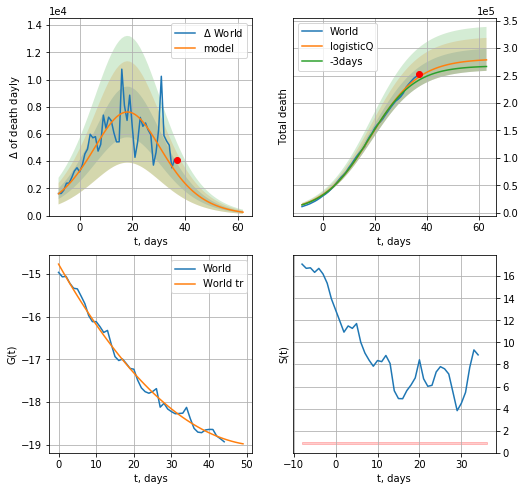

World data at: 2020-05-04
+3 day model MAPE: 0.025054
model: logisticQ
coeffs: [ 2.80713778e+05  1.50194353e-05  1.85857214e+01 -7.21016738e+03]
rational stdev: 0.071824
forecast at the end of period: +26 days
	 total death: 278537 ± 20005
trend coefficient of determination: 0.992150
 intercept_: -14.772825030565507
 coeffs_: [ 0.         -0.15593297  0.00143019]


In [528]:
x = forecastRRR("World",dfW[58:],d1,7*9-dT,1.0,False,cases='death')

In [529]:
#trend(dfSP,'SP',10)

In [531]:
#vL = len(dfSP[:])-16-dT
#x = forecast('Spain',dfSP[:vL],d1,30-dT,1.0)
#xx = forecast2('Spain',dfSP,d1,7*6-dT,x,1.0,addpred=True,xcoef=[3.,1.,1.8],vL=vL)

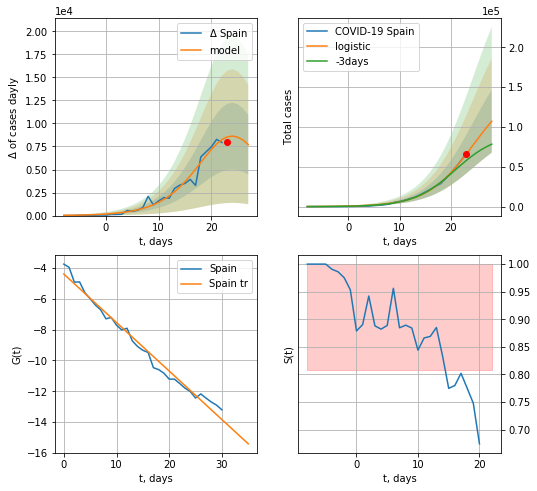

Spain data at: 2020-05-04
+3 day model MAPE: 0.17994225331219452
model: logistic
coeffs:  [1.55796358e+05 2.21769203e-01 2.44355993e+01]
rational stdev:  0.3682790859287634
forecast at the end of period: +5 days
	 deltaDaycases:  7707
	 total cases:  107177 ± 39471
	 total death:  10975 ± 12125
trend coefficient of determination: 0.981962
 intercept: -4.388643
 slope: -0.315050


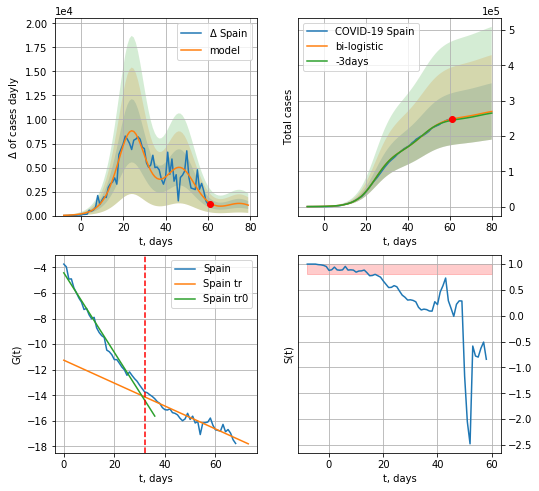

Spain data at: 2020-05-04
+3 day model MAPE: 0.014534352367618611
model: bi-logistic
coeffs:  [9.66887410e+04 1.98333747e-01 4.74014533e+01] [1.55796358e+05 2.21769203e-01 2.44355993e+01]
scenario coeffs:  [0.25, 1.0, 1.6]
rational stdev:  0.29632392687754544
forecast at the end of period: +19 days
	 deltaDaycases:  1086
	 total cases:  269138 ± 79752
	 total death:  27561 ± 24500
bi-logistic approximation splitting point: 32
trend0 coefficient of determination: 0.981698
 intercept: -4.427117
 slope: -0.311203
trend coefficient of determination: 0.893707
 intercept: -11.260906
 slope: -0.089590


In [532]:
vL = 32#len(dfSP[:])-7-dT
x = forecast('Spain',dfSP[:vL],d1,6*7-dT,1.0,cases='cases')
xx = forecast2('Spain',dfSP[:],d1,7*8-dT,x,1.0,addpred=True,xcoef=[.25,1.,1.6],vL=vL,cases='cases')

SP
          date   cases  active    death
65 2020-04-30  239639   77112  24543.0
66 2020-05-01  242988   75714  24824.0
67 2020-05-02  245567   74234  25100.0
68 2020-05-03  247122   73300  25264.0
69 2020-05-04  248301   71240  25428.0


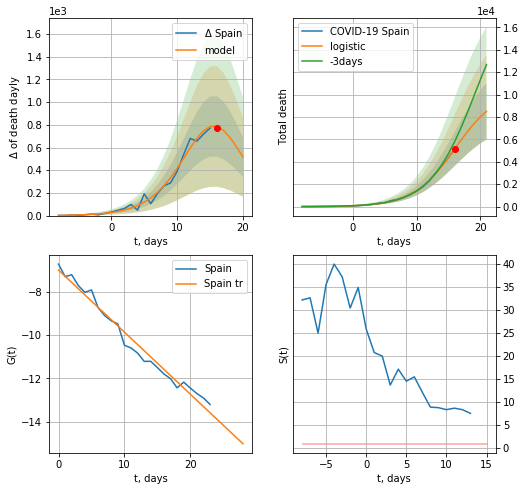

Spain data at: 2020-05-04
+3 day model MAPE: 0.15747030887395475
model: logistic
coeffs:  [1.03877331e+04 3.04619794e-01 1.60547713e+01]
rational stdev:  0.29538659014568974
forecast at the end of period: +5 days
	 total death:  8502 ± 2511
trend coefficient of determination: 0.976452
 intercept: -6.992078
 slope: -0.287044


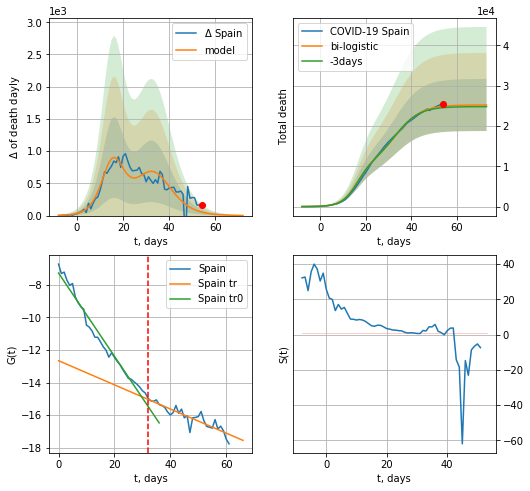

Spain data at: 2020-05-04
+3 day model MAPE: 0.014160616114989708
model: bi-logistic
coeffs:  [1.48171572e+04 1.80861989e-01 3.32780885e+01] [1.03877331e+04 3.04619794e-01 1.60547713e+01]
rational stdev:  0.25610098347821336
forecast at the end of period: +19 days
	 deltaDaydeath:  2
	 total death:  25193 ± 6452
bi-logistic approximation splitting point: 32
trend0 coefficient of determination: 0.975844
 intercept: -7.265510
 slope: -0.256124
trend coefficient of determination: 0.814926
 intercept: -12.657061
 slope: -0.074309


In [533]:
vL = 32#len(dfSP[:])-7-dT
dfSP = read_df(pd.DataFrame(),"SP")
x = forecast('Spain',dfSP[7:vL],d1,6*7-dT,1.0,cases='death')
xx = forecast2('Spain',dfSP[7:],d1,7*8-dT,x,1.0,addpred=False,xcoef=[.25,1.,1.8],vL=vL,cases='death')

/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:18: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:18: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


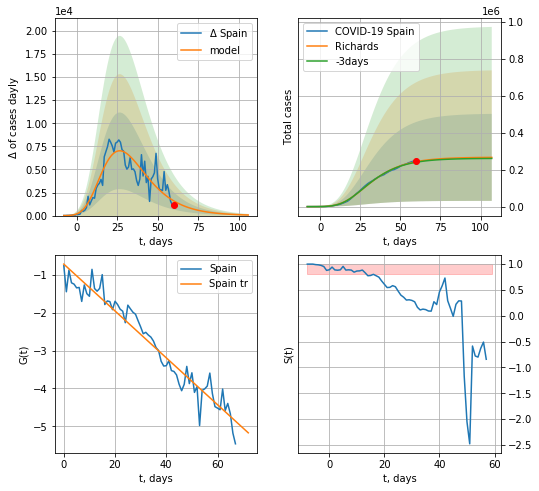

Spain data at: 2020-05-04
+3 day model MAPE: 0.013163
model: Richards
coeffs: [ 2.67424714e+05  8.05049047e+00 -3.87850900e+01  8.90657880e-03]
rational stdev: 0.883420
forecast at the end of period: +47 days
	 deltaDaycases: 64
	 total cases: 266559 ± 235484
	 total death: 27297 ± 72344
trend coefficient of determination: 0.939130
 intercept: -0.718436
 slope: -0.061833


In [534]:
x = forecastRR('Spain',dfSP[1:],d1,7*12-dT,1.0,addpred=False,xcoef=[.25,1.,3.,1])

/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:18: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:18: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)
/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:72: RuntimeWarning: divide by zero encountered in true_divide


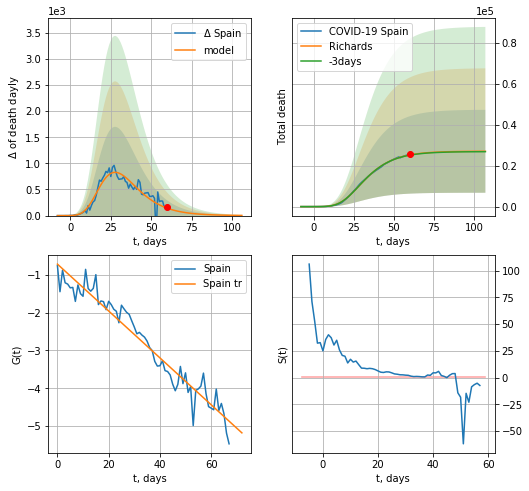

Spain data at: 2020-05-04
+3 day model MAPE: 0.004846
model: Richards
coeffs: [ 2.70099048e+04  8.92489123e+00 -2.76046956e+01  9.38808666e-03]
rational stdev: 0.749237
forecast at the end of period: +47 days
	 total death: 26973 ± 20209
trend coefficient of determination: 0.939317
 intercept: -0.721379
 slope: -0.061891


In [535]:
x = forecastRR('Spain',dfSP[1:],d1,7*12-dT,1.0,addpred=False,xcoef=[.25,1.,3.,1],cases='death')

/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:153: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


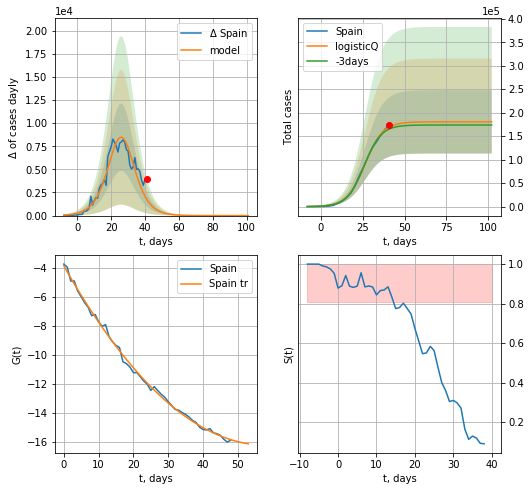

Spain data at: 2020-05-04
+3 day model MAPE: 0.028157
model: logisticQ
coeffs: [ 1.80489569e+05  4.90633148e-06  2.63952659e+01 -3.83458431e+04]
rational stdev: 0.373397
forecast at the end of period: +61 days
	 deltaDaycases: 0
	 total cases: 180489 ± 67394
	 total death: 18483 ± 20704
trend coefficient of determination: 0.997432
 intercept_: -3.859009253100683
 coeffs_: [ 0.         -0.42385579  0.00363487]


/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:288: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


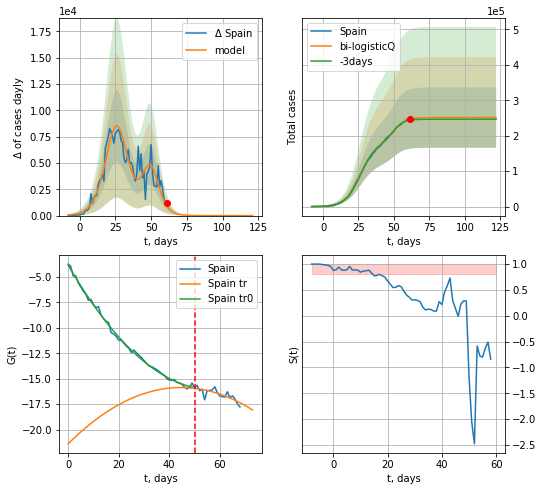

Spain data at: 2020-05-04
+3 day model MAPE: 0.014502
model: bi-logisticQ
coeffs: [ 7.07618559e+04  4.07398099e-06  4.99562471e+01 -6.17848298e+04]
rational stdev: 0.339384
forecast at the end of period: +61 days
	 deltaDaycases: 0
	 total cases: 251251 ± 85270
	 total death: 25730 ± 26197
bi-logisticQ approximation splitting point: 50
trend coefficient of determination: 0.997202
 intercept_: -3.834231460165485
 coeffs_: [ 0.         -0.42809872  0.00374483]
trend coefficient of determination: 0.637282
 intercept_: -21.391415780434357
 coeffs_: [ 0.          0.24714493 -0.00276252]


In [536]:
x = forecastRRR('Spain',dfSP[:50],d1,7*14-dT,1.0,addpred=False,xcoef=koreaCoeffs)#[.35,.5,3.,1])
xx = forecast2RRR('Spain',dfSP[:],d1,7*14-dT,x,1.0,addpred=False,xcoef=koreaCoeffs,vL=50)#[.35,.5,3.,1])

/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)
/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:207: RuntimeWarning: divide by zero encountered in true_divide


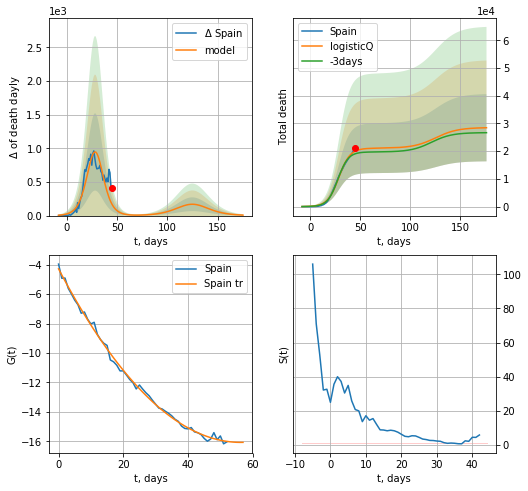

Spain data at: 2020-05-04
+3 day model MAPE: 0.052146
model: logisticQ
coeffs: [ 2.10785072e+04  2.45976331e-06  2.87220026e+01 -7.30294753e+04]
S.Korea scenario coeffs: [0.35416971, 0.02606324, 4.35859408, 19.30413219]
rational stdev: 0.426167
forecast at the end of period: +131 days
	 total death: 28469 ± 12132
trend coefficient of determination: 0.997093
 intercept_: -4.2745317106494545
 coeffs_: [ 0.         -0.41935329  0.00372528]


/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)
/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:344: RuntimeWarning: divide by zero encountered in true_divide


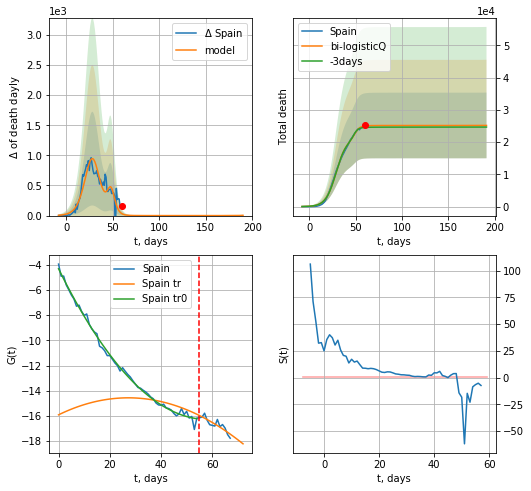

Spain data at: 2020-05-04
+3 day model MAPE: 0.019320
model: bi-logisticQ
coeffs: [ 4.07697305e+03  3.56768814e-06  4.87842261e+01 -1.03928665e+05]
S.Korea scenario coeffs: [0.35416971, 0.02606324, 4.35859408, 19.30413219]
rational stdev: 0.404447
forecast at the end of period: +131 days
	 total death: 25180 ± 10184
bi-logisticQ approximation splitting point: 55
trend coefficient of determination: 0.995977
 intercept_: -4.321307017900119
 coeffs_: [ 0.         -0.41196694  0.00354831]
trend coefficient of determination: 0.756710
 intercept_: -15.91511175711457
 coeffs_: [ 0.          0.09914866 -0.00182085]


In [537]:
x = forecastRRR('Spain',dfSP[1:55],d1,7*24-dT,1.0,addpred=True,xcoef=koreaCoeffs,cases='death')#[.35,.5,3.,1])
xx = forecast2RRR('Spain',dfSP[1:],d1,7*24-dT,x,1.0,addpred=True,xcoef=koreaCoeffs,cases='death',vL=55)

/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:15: RuntimeWarning: overflow encountered in exp
  from ipykernel import kernelapp as app
/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:15: RuntimeWarning: divide by zero encountered in true_divide
  from ipykernel import kernelapp as app
/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:15: RuntimeWarning: overflow encountered in power
  from ipykernel import kernelapp as app
/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1200.
  warnings.warn(errors[info][0], RuntimeWarning)


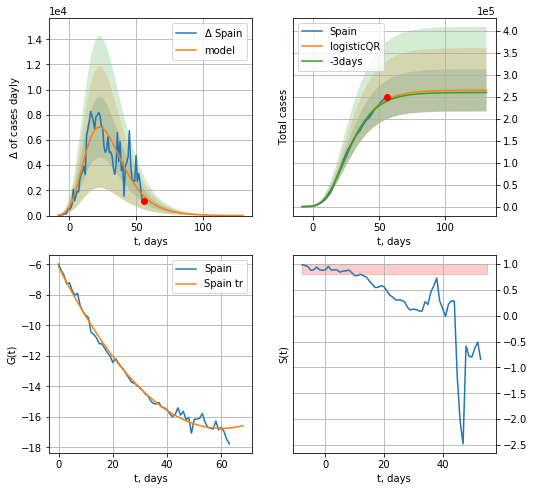

Spain data at: 2020-05-04
+3 day model MAPE: 0.01297497617936388
model: logisticQR
coeffs:  [ 2.64737659e+05  3.73292597e-02 -1.00841222e+03 -7.35892153e+01
  1.71451353e-03]
rational stdev:  0.1816028667569773
forecast at the end of period: +75 days
	 deltaDaycases:  4
	 total cases:  264686 ± 48067
	 total death:  27106 ± 14767
trend coefficient of determination: 0.990833
 intercept_: -6.163864784063284
 coeffs_: [ 0.         -0.35304333  0.00294008]


In [538]:
x = forecastQR('Spain',dfSP[5:],d1,7*16-dT,1.0,addpred=False,xcoef=koreaCoeffs)#[.35,.5,3.,1])

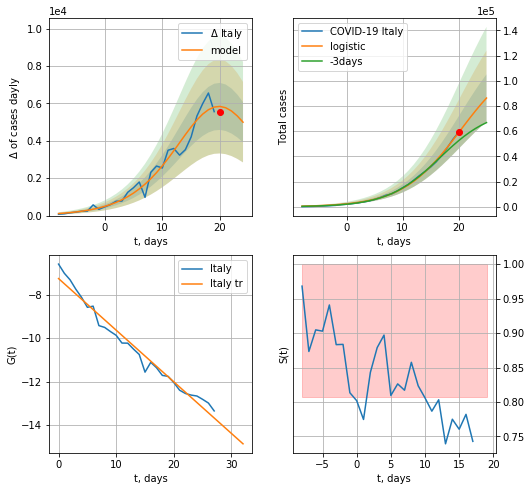

Italy data at: 2020-05-04
+3 day model MAPE: 0.1545703725042627
model: logistic
coeffs:  [1.21492367e+05 1.92504372e-01 2.03342758e+01]
rational stdev:  0.21800555140478417
forecast at the end of period: +5 days
	 deltaDaycases:  4997
	 total cases:  86329 ± 18820
	 total death:  11844 ± 7746
trend coefficient of determination: 0.973351
 intercept: -7.256152
 slope: -0.237823


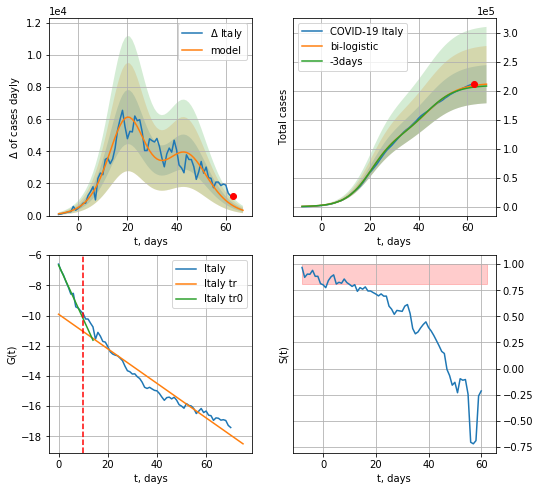

Italy data at: 2020-05-04
+3 day model MAPE: 0.01343556408659986
model: bi-logistic
coeffs:  [9.14198031e+04 1.62562660e-01 4.43232193e+01] [1.21492367e+05 1.92504372e-01 2.03342758e+01]
rational stdev:  0.1558694731232152
forecast at the end of period: +5 days
	 deltaDaycases:  331
	 total cases:  210992 ± 32887
	 total death:  28949 ± 13536
bi-logistic approximation splitting point: 10
trend0 coefficient of determination: 0.980956
 intercept: -6.650523
 slope: -0.355965
trend coefficient of determination: 0.940547
 intercept: -9.911870
 slope: -0.114506


In [539]:
x = forecast('Italy',dfIT[:-6-dT],d1,6*7-dT,1.0)
xx = forecast2('Italy',dfIT,d1,6*7-dT,x,1.0)

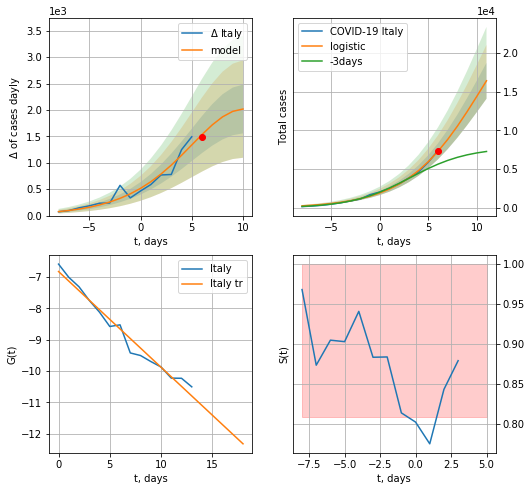

Italy data at: 2020-05-04
+3 day model MAPE: 0.4420796150765939
model: logistic
coeffs:  [3.15102860e+04 2.56561304e-01 1.06831560e+01]
rational stdev:  0.1413171221665118
forecast at the end of period: +5 days
	 deltaDaycases:  2017
	 total cases:  16395 ± 2316
	 total death:  2249 ± 953
trend coefficient of determination: 0.972659
 intercept: -6.827339
 slope: -0.305199


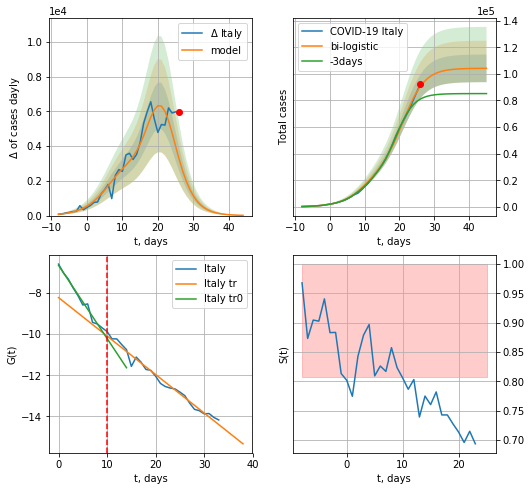

Italy data at: 2020-05-04
+3 day model MAPE: 0.1396868970300245
model: bi-logistic
coeffs:  [7.26693885e+04 3.23703466e-01 2.12981095e+01] [3.15102860e+04 2.56561304e-01 1.06831560e+01]
rational stdev:  0.09972560756251159
forecast at the end of period: +19 days
	 deltaDaycases:  14
	 total cases:  104141 ± 10385
	 total death:  14288 ± 4274
bi-logistic approximation splitting point: 10
trend0 coefficient of determination: 0.980956
 intercept: -6.650523
 slope: -0.355965
trend coefficient of determination: 0.981847
 intercept: -8.219306
 slope: -0.187258


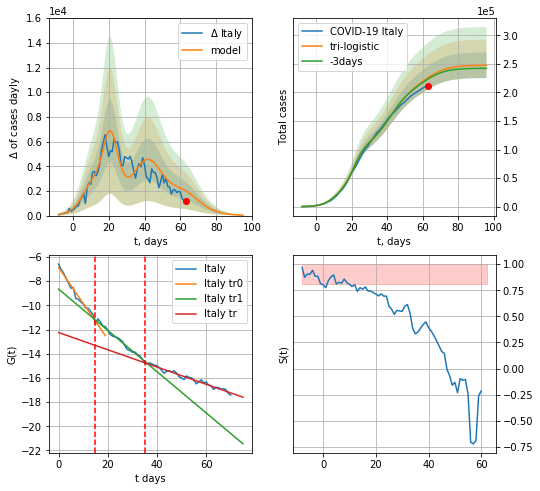

Italy data at: 2020-05-04
+3 day model MAPE: 0.010719436529396827
model: tri-logistic
coeffs:  [1.06472737e+05 1.63097927e-01 4.20441517e+01] [3.15102860e+04 2.56561304e-01 1.06831560e+01 7.26693885e+04
 3.23703466e-01 2.12981095e+01]
scenario coeffs:  [0.35, 1.0, 1.5]
forecast rational stdev:  0.09028326541972828
forecast at the end of period: +33 days
	 deltaDaycases:  33
	 total cases:  247729 ± 22365
	 total death:  33989 ± 9205
tri-logistic approximation splitting points: 15,35
trend0 coefficient of determination: 0.972874
 intercept: -6.864841
 slope: -0.296544
trend1 coefficient of determination: 0.978019
 intercept: -8.656402
 slope: -0.170599
trend coefficient of determination: 0.968231
 intercept: -12.248322
 slope: -0.071307


In [540]:
vL = 15#len(dfSP[:])-11-dT
vL1=35
x = forecast('Italy',dfIT[:vL],d1,6*7-dT,1.0)
xx = forecast2('Italy',dfIT[:vL1],d1,7*8-dT,x,1.0)#,addpred=True,xcoef=[.25,1.,1.8],vL=vL)
xx = np.concatenate((x, xx), axis=0)
xxx = forecast3("Italy",dfIT,d1,7*10-dT, xx, shift=1.,addpred=True,xcoef=[.35,1.,1.5],vL=[vL,vL1])

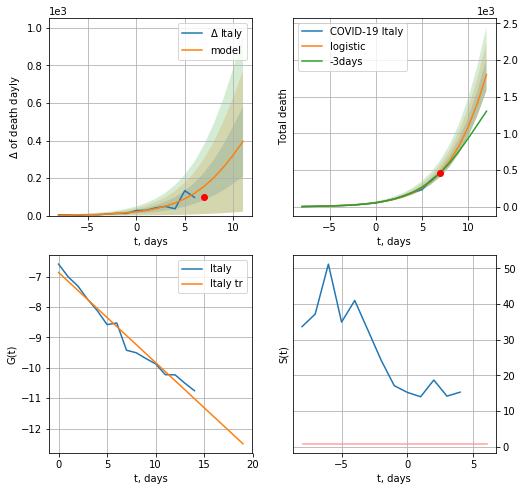

Italy data at: 2020-05-04
+3 day model MAPE: 0.04050471838994123
model: logistic
coeffs:  [8.02160580e+03 3.09188022e-01 1.60041165e+01]
rational stdev:  0.12009380059110428
forecast at the end of period: +5 days
	 total death:  1803 ± 216
trend coefficient of determination: 0.972874
 intercept: -6.864841
 slope: -0.296544


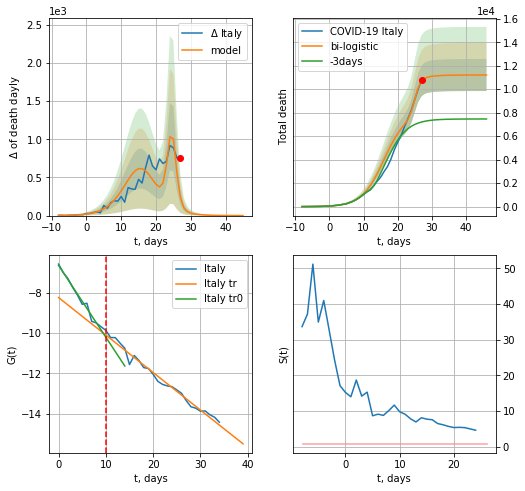

Italy data at: 2020-05-04
+3 day model MAPE: 0.5045455507817326
model: bi-logistic
coeffs:  [3.18991891e+03 1.24679374e+00 2.50159525e+01] [8.02160580e+03 3.09188022e-01 1.60041165e+01]
rational stdev:  0.12176249997037505
forecast at the end of period: +19 days
	 deltaDaydeath:  0
	 total death:  11210 ± 1365
bi-logistic approximation splitting point: 10
trend0 coefficient of determination: 0.980956
 intercept: -6.650523
 slope: -0.355965
trend coefficient of determination: 0.983136
 intercept: -8.246485
 slope: -0.185719


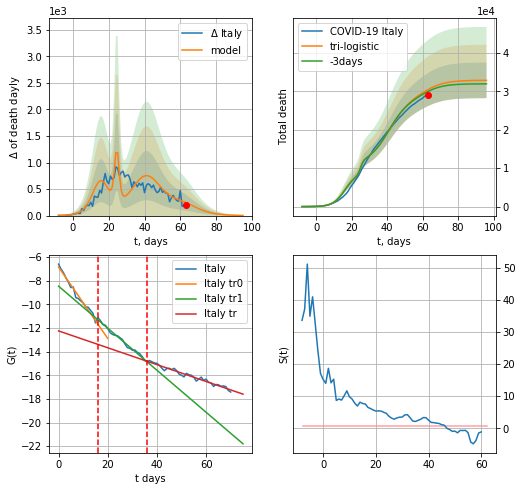

Italy data at: 2020-05-04
+3 day model MAPE: 0.016848206066697506
model: tri-logistic
coeffs:  [1.73408057e+04 1.68736628e-01 4.13416050e+01] [8.02160580e+03 3.09188022e-01 1.60041165e+01 3.18991891e+03
 1.24679374e+00 2.50159525e+01]
scenario coeffs:  [0.25, 1.0, 1.5]
forecast rational stdev:  0.1410775368018044
forecast at the end of period: +33 days
	 deltaDaydeath:  2
	 total death:  32871 ± 4637
tri-logistic approximation splitting points: 16,36
trend0 coefficient of determination: 0.976838
 intercept: -6.838821
 slope: -0.302120
trend1 coefficient of determination: 0.986419
 intercept: -8.458056
 slope: -0.177939
trend coefficient of determination: 0.965575
 intercept: -12.245430
 slope: -0.071357


In [541]:
vL = 16#len(dfSP[:])-11-dT
vL1=36
x = forecast('Italy',dfIT[:vL],d1,6*7-dT,1.0,cases='death')
xx = forecast2('Italy',dfIT[:vL1],d1,7*8-dT,x,1.0,cases='death')#,addpred=True,xcoef=[.25,1.,1.8],vL=vL)
xx = np.concatenate((x, xx), axis=0)
xxx = forecast3("Italy",dfIT,d1,7*10-dT, xx, shift=1.,addpred=True,xcoef=[.25,1.,1.5],vL=[vL,vL1],cases='death')

/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:18: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:18: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


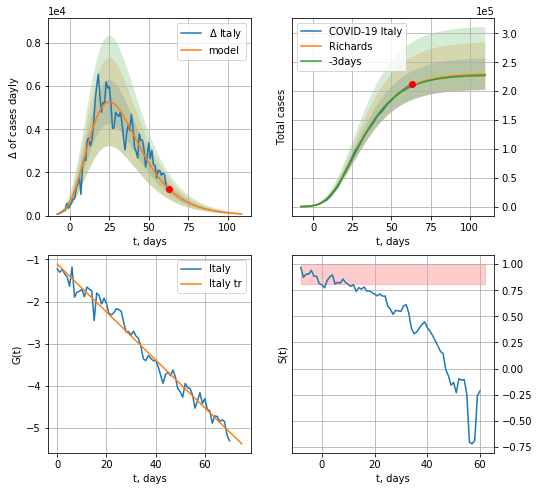

Italy data at: 2020-05-04
+3 day model MAPE: 0.005867
model: Richards
coeffs: [ 2.30566881e+05  5.16273542e+00 -4.52098028e+01  1.20957122e-02]
rational stdev: 0.118842
forecast at the end of period: +47 days
	 deltaDaycases: 75
	 total cases: 229392 ± 27261
	 total death: 31473 ± 11220
trend coefficient of determination: 0.977111
 intercept: -1.111168
 slope: -0.056898


/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:18: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:18: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


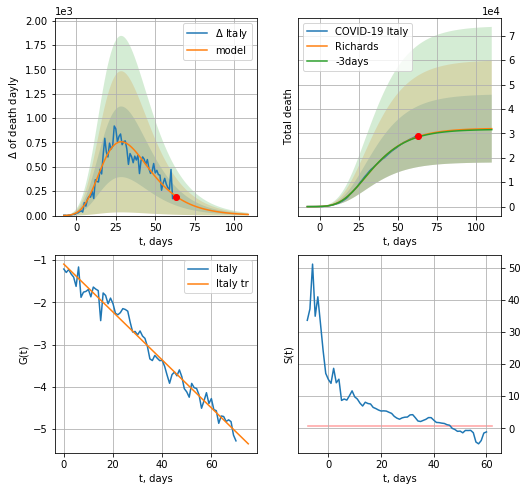

Italy data at: 2020-05-04
+3 day model MAPE: 0.007586
model: Richards
coeffs: [ 3.21052521e+04  6.50586941e+00 -4.26915689e+01  9.90477113e-03]
rational stdev: 0.435031
forecast at the end of period: +47 days
	 total death: 31932 ± 13891
trend coefficient of determination: 0.976866
 intercept: -1.094108
 slope: -0.056719


In [542]:
x = forecastRR('Italy',dfIT[:],d1,12*7-dT,1.0)
x = forecastRR('Italy',dfIT[:],d1,12*7-dT,1.0,cases='death')

/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:153: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


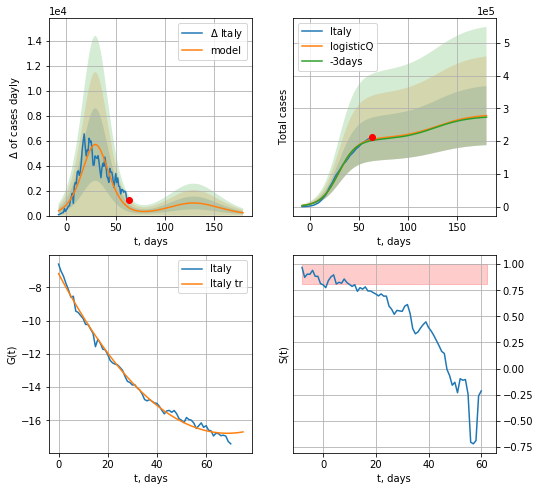

Italy data at: 2020-05-04
+3 day model MAPE: 0.016702
model: logisticQ
coeffs: [ 2.08608737e+05  7.68562722e-07  2.96936102e+01 -1.41791843e+05]
S.Korea scenario coeffs: [0.35416971, 0.02606324, 4.35859408, 19.30413219]
rational stdev: 0.324566
forecast at the end of period: +117 days
	 deltaDaycases: 229
	 total cases: 278148 ± 90277
	 total death: 38163 ± 37159
trend coefficient of determination: 0.993518
 intercept_: -7.162403635462255
 coeffs_: [ 0.         -0.28015401  0.00203922]


In [543]:
x = forecastRRR('Italy',dfIT[:],d1,7*22-dT,1.0,addpred=True,xcoef=koreaCoeffs)#[.35,.5,4.,1])

/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:153: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


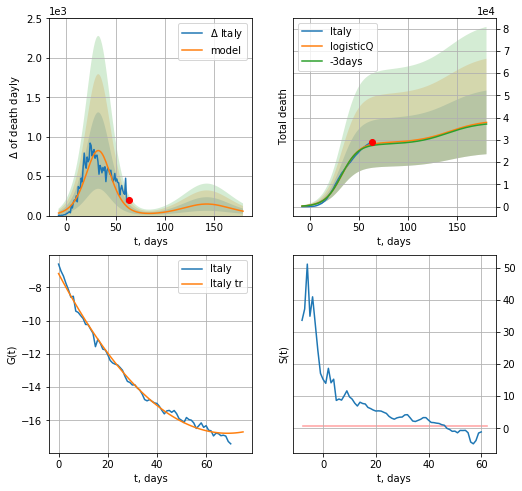

Italy data at: 2020-05-04
+3 day model MAPE: 0.020278
model: logisticQ
coeffs: [ 2.87178882e+04  8.48327464e-07  3.27354785e+01 -1.35268856e+05]
S.Korea scenario coeffs: [0.35416971, 0.02606324, 4.35859408, 19.30413219]
rational stdev: 0.378011
forecast at the end of period: +117 days
	 total death: 37832 ± 14300
trend coefficient of determination: 0.993518
 intercept_: -7.162403635462255
 coeffs_: [ 0.         -0.28015401  0.00203922]


In [544]:
x = forecastRRR('Italy',dfIT[:],d1,7*22-dT,1.0,addpred=True,xcoef=koreaCoeffs,cases='death')#[.35,.5,4.,1])

In [545]:
dT

37

FR
          date     cases  active    death
75 2020-04-30  167178.0   93326  24376.0
76 2020-05-01  167346.0   92540  24594.0
77 2020-05-02  168396.0   93074  24760.0
78 2020-05-03  168693.0   93014  24895.0
79 2020-05-04  169462.0   92890  25201.0


/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 800.
  warnings.warn(errors[info][0], RuntimeWarning)


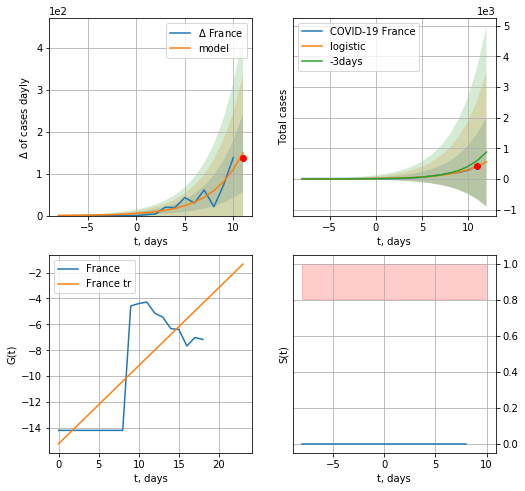

France data at: 2020-05-04
+3 day model MAPE: 0.3579011645535763
model: logistic
coeffs:  [9.13757357e+04 3.09894510e-01 2.83979795e+01]
rational stdev:  2.5989080654975822
forecast at the end of period: +1 days
	 deltaDaycases:  149
	 total cases:  563 ± 1465
	 total death:  83 ± 647
trend coefficient of determination: 0.603781
 intercept: -15.217380
 slope: 0.602806


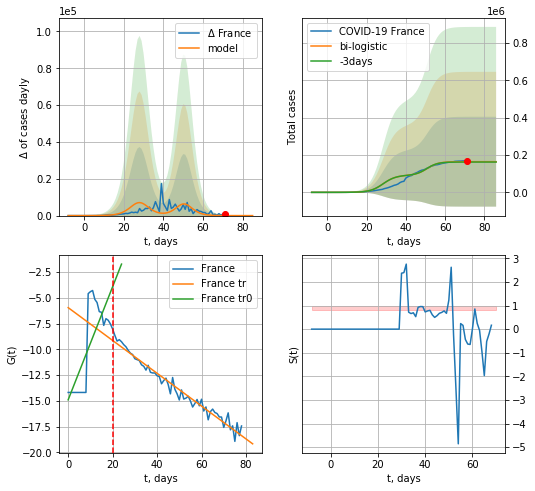

France data at: 2020-05-04
+3 day model MAPE: 0.011857038228095345
model: bi-logistic
coeffs:  [7.27532951e+04 3.49354247e-01 5.08771769e+01] [9.13757357e+04 3.09894510e-01 2.83979795e+01]
rational stdev:  1.4648077359887959
forecast at the end of period: +15 days
	 deltaDaycases:  0
	 total cases:  164128 ± 240416
	 total death:  24407 ± 107254
bi-logistic approximation splitting point: 20
trend0 coefficient of determination: 0.576236
 intercept: -14.895009
 slope: 0.549077
trend coefficient of determination: 0.965999
 intercept: -5.944162
 slope: -0.159329


In [546]:
# prideta 1990 2020-04-17
# prideta 3824 2020-04-18
dfFR = read_df(pd.DataFrame(),"FR")
vL=20
x = forecast('France',dfFR[:vL],d1,6*7-dT-4,1.0)
xx = forecast2('France',dfFR,d1,8*7-dT-4,x,1.0,addpred=False,xcoef=[.25,1.,1.5],vL=vL)

In [547]:
#vL=len(dfFR)-9-5-dT
#x = forecast('France',dfFR[10:-9-dT],d1,7*5-dT-4,1.0)
#xx = forecast2('France',dfFR[10:],d1,7*7-dT-4,x,1.0,addpred=True,xcoef=[.25,1.,1.4],vL=vL)

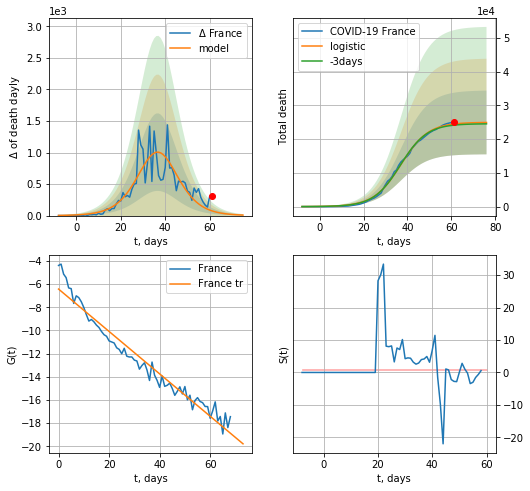

France data at: 2020-05-04
+3 day model MAPE: 0.014432830626972776
model: logistic
coeffs:  [2.49728949e+04 1.61328793e-01 3.70598266e+01]
rational stdev:  0.3786653489367998
forecast at the end of period: +15 days
	 total death:  24926 ± 9438
trend coefficient of determination: 0.953655
 intercept: -6.430802
 slope: -0.182851


In [548]:
#dfFR = read_df(pd.DataFrame(),"FR")
x = forecast('France',dfFR[10:],d1,7*8-dT-4,1.0,cases='death')

/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:18: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:18: RuntimeWarning: divide by zero encountered in true_divide


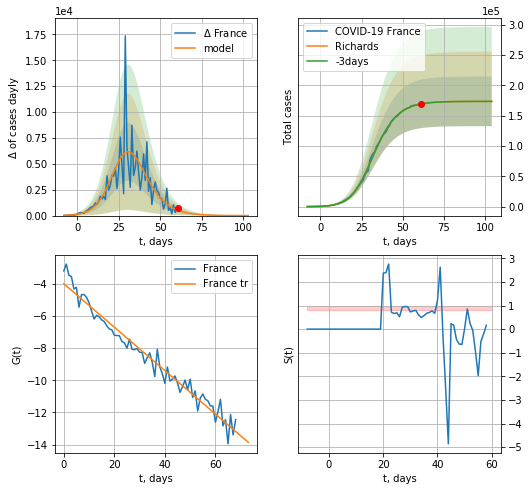

France data at: 2020-05-04
+3 day model MAPE: 0.000480
model: Richards
coeffs: [1.73564433e+05 2.11393783e-01 2.69063078e+01 5.85847638e-01]
rational stdev: 0.235681
forecast at the end of period: +43 days
	 deltaDaycases: 2
	 total cases: 173543 ± 40900
	 total death: 25807 ± 18246
trend coefficient of determination: 0.965100
 intercept: -3.994444
 slope: -0.135079


In [549]:
x = forecastRR('France',dfFR[10:],d1,12*7-dT-4,1.0)

/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:153: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


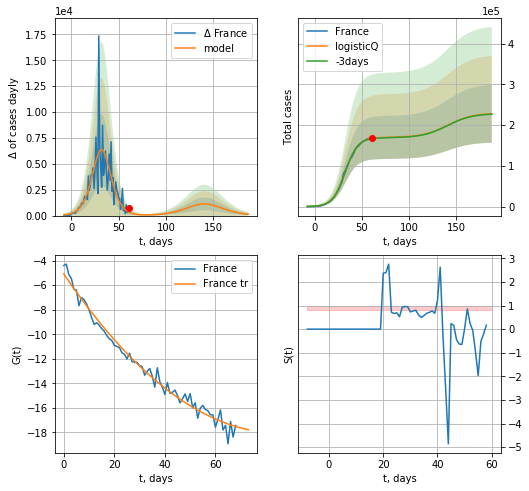

France data at: 2020-05-04
+3 day model MAPE: 0.004671
model: logisticQ
coeffs: [ 1.69654537e+05  2.63961136e-06  3.23712875e+01 -5.68429791e+04]
S.Korea scenario coeffs: [0.35416971, 0.02606324, 4.35859408, 19.30413219]
rational stdev: 0.311507
forecast at the end of period: +127 days
	 deltaDaycases: 128
	 total cases: 228049 ± 71039
	 total death: 33913 ± 31692
trend coefficient of determination: 0.982300
 intercept_: -5.081743310780215
 coeffs_: [ 0.         -0.30368452  0.00177713]


In [550]:
x = forecastRRR('France',dfFR[10:],d1,24*7-dT-4,1.0,addpred=True,xcoef=koreaCoeffs)#[.35,.5,3.,1.])

/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


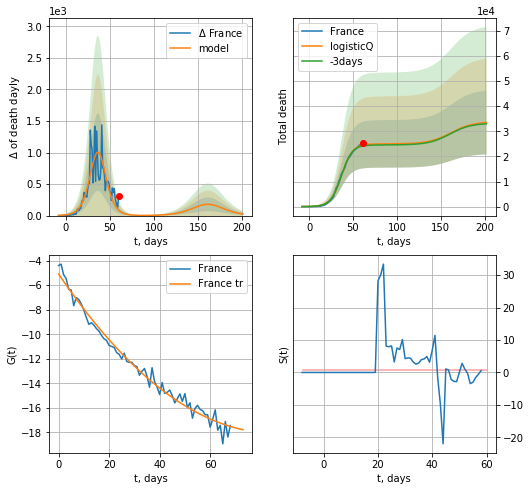

France data at: 2020-05-04
+3 day model MAPE: 0.014459
model: logisticQ
coeffs: [ 2.49711583e+04  2.36907229e-06  3.70593159e+01 -6.80469398e+04]
S.Korea scenario coeffs: [0.35416971, 0.02606324, 4.35859408, 19.30413219]
rational stdev: 0.378887
forecast at the end of period: +141 days
	 total death: 33495 ± 12691
trend coefficient of determination: 0.982300
 intercept_: -5.081743310780215
 coeffs_: [ 0.         -0.30368452  0.00177713]


In [551]:
x = forecastRRR('France',dfFR[10:],d1,26*7-dT-4,1.0,addpred=True,xcoef=koreaCoeffs,cases='death')#[.35,.5,3.,1.])

In [552]:
#x = forecastR('France',dfFR[:],d1,8*7-dT-4,1.0,addpred=True,xcoef=[0.25,1.,20.,1])

In [553]:
#trend3(dfGR,dfUS,dfGB[:],'GR','US','GB',40,40,40)

/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:118: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.5/dist-packages/numpy/core/_methods.py:193: RuntimeWarning: invalid value encountered in subtract
  x = asanyarray(arr - arrmean)


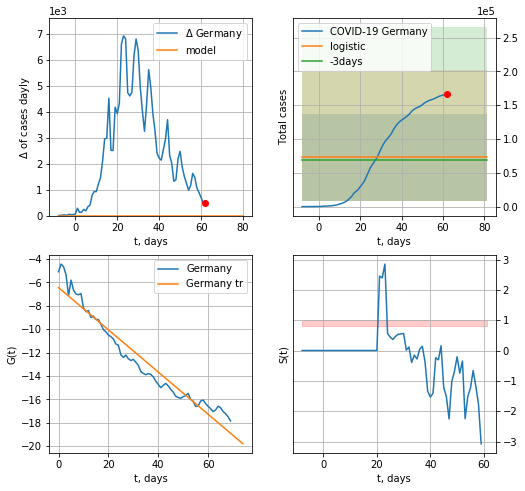

Germany data at: 2020-05-04
+3 day model MAPE: 0.05898176087155563
model: logistic
coeffs:  [ 7.31922252e+04 -3.38125515e+00  1.10089160e+02]
rational stdev:  0.8772338542600601
forecast at the end of period: +19 days
	 deltaDaycases:  0
	 total cases:  73192 ± 64206
	 total death:  3080 ± 8105
trend coefficient of determination: 0.943143
 intercept: -6.445448
 slope: -0.180567


In [554]:
x = forecast('Germany',dfGR[:],d1,7*8-dT,1.0)
#xx = forecast2('Germany',dfGR,d1,7*7-dT,x,1.0)

/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 800.
  warnings.warn(errors[info][0], RuntimeWarning)


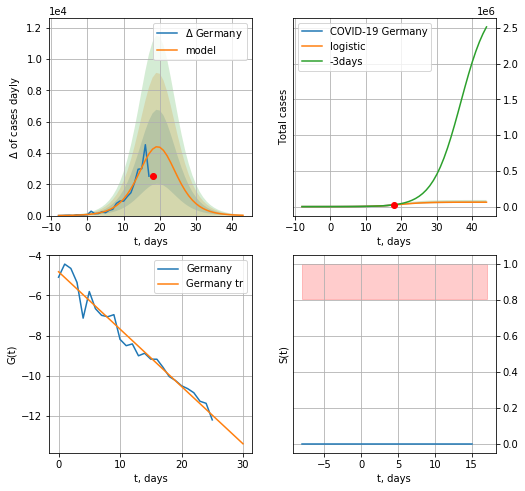

Germany data at: 2020-05-04
+3 day model MAPE: 0.18319320379671997
model: logistic
coeffs:  [6.16394025e+04 2.86275294e-01 1.98444846e+01]
rational stdev:  0.17054836328949527
forecast at the end of period: +26 days
	 deltaDaycases:  20
	 total cases:  61578 ± 10502
	 total death:  2591 ± 1325
trend coefficient of determination: 0.966826
 intercept: -4.817840
 slope: -0.285777


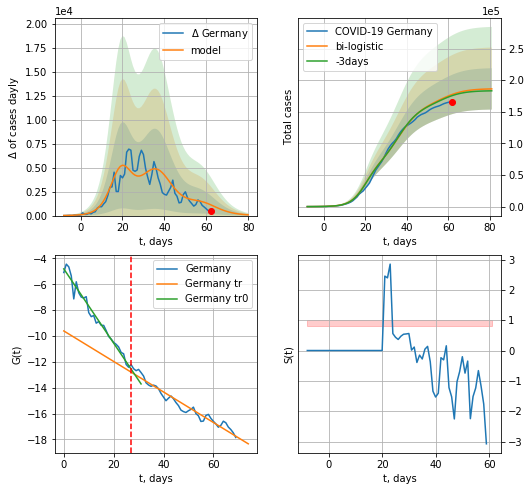

Germany data at: 2020-05-04
+3 day model MAPE: 0.010891512226537718
model: bi-logistic
coeffs:  [9.99847877e+04 1.86033981e-01 3.63549735e+01] [6.16394025e+04 2.86275294e-01 1.98444846e+01]
scenario coeffs:  [0.25, 1.0, 1.6]
rational stdev:  0.17554015450889932
forecast at the end of period: +19 days
	 deltaDaycases:  75
	 total cases:  186243 ± 32693
	 total death:  7838 ± 4127
bi-logistic approximation splitting point: 27
trend0 coefficient of determination: 0.970373
 intercept: -4.806769
 slope: -0.287106
trend coefficient of determination: 0.951359
 intercept: -9.607327
 slope: -0.118013


In [555]:
vL = 27
x = forecast('Germany',dfGR[:vL],d1,9*7-dT,1.0)#,addpred=True,xcoef=[0.25,1.,2.0,1])
xx = forecast2('Germany',dfGR,d1,7*8-dT,x,1.0,addpred=True,xcoef=[0.25,1.,1.6],vL=vL)

GR
          date   cases  active   death
66 2020-04-30  163009   32886  6623.0
67 2020-05-01  164077   30441  6736.0
68 2020-05-02  164967   27555  6812.0
69 2020-05-03  165664   28198  6866.0
70 2020-05-04  166152   24059  6993.0


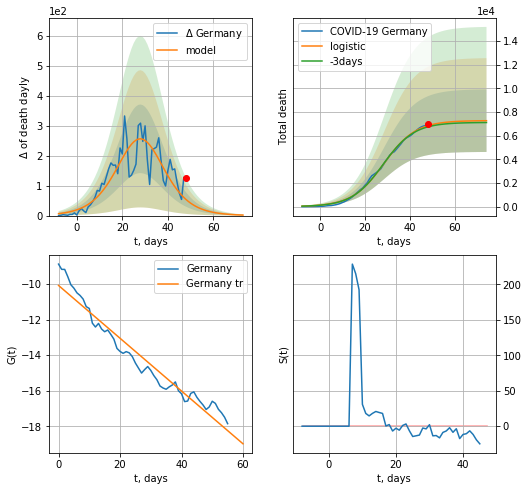

Germany data at: 2020-05-04
+3 day model MAPE: 0.015828041797245757
model: logistic
coeffs:  [7.27544477e+03 1.41190236e-01 2.83919815e+01]
rational stdev:  0.36383738796126563
forecast at the end of period: +26 days
	 total death:  7263 ± 2642
trend coefficient of determination: 0.945391
 intercept: -10.080194
 slope: -0.148399


In [556]:
dfGR = read_df(pd.DataFrame(),"GR")
x = forecast('Germany',dfGR[14:],d1,9*7-dT,1.0,cases='death')

/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:18: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:18: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


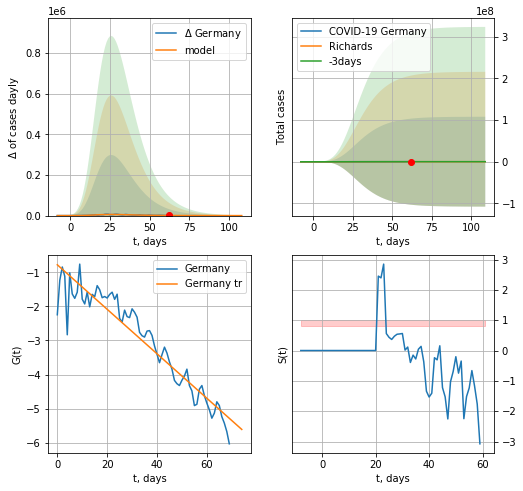

Germany data at: 2020-05-04
+3 day model MAPE: 0.004684
model: Richards
coeffs: [ 1.72291961e+05  5.28363171e+00 -2.00280645e+01  1.66886514e-02]
rational stdev: 625.306535
forecast at the end of period: +47 days
	 deltaDaycases: 10
	 total cases: 172173 ± 107661379
	 total death: 7246 ± 13592913
trend coefficient of determination: 0.898626
 intercept: -0.780029
 slope: -0.065258


In [557]:
x = forecastRR('Germany',dfGR[:],d1,12*7-dT,1.0,addpred=False,xcoef=[0.25,1.,5.0,1])

/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:153: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


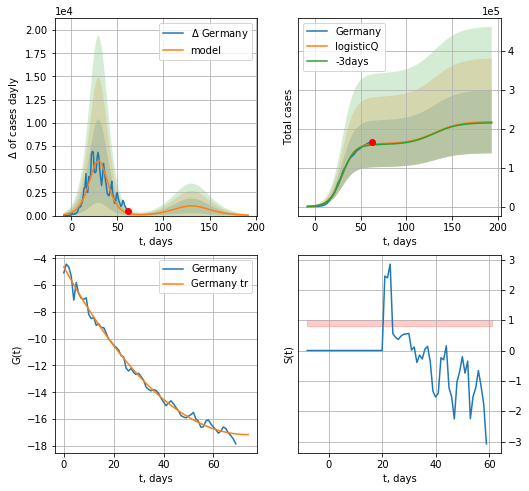

Germany data at: 2020-05-04
+3 day model MAPE: 0.012579
model: logisticQ
coeffs: [ 1.61664606e+05  1.24249044e-06  3.00390432e+01 -1.17299390e+05]
S.Korea scenario coeffs: [0.35416971, 0.02606324, 4.35859408, 19.30413219]
rational stdev: 0.372532
forecast at the end of period: +131 days
	 deltaDaycases: 44
	 total cases: 218323 ± 81332
	 total death: 9188 ± 10268
trend coefficient of determination: 0.993006
 intercept_: -4.650719542219628
 coeffs_: [ 0.         -0.33894939  0.00229557]


In [558]:
x = forecastRRR('Germany',dfGR[:],d1,24*7-dT,1.0,addpred=True,xcoef=koreaCoeffs)#[0.35,.5,3.0,1])

/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)
/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:207: RuntimeWarning: invalid value encountered in true_divide


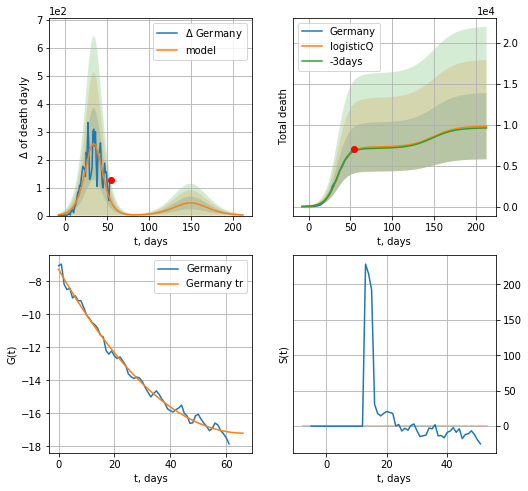

Germany data at: 2020-05-04
+3 day model MAPE: 0.016466
model: logisticQ
coeffs: [ 7.25676839e+03  3.58953378e-05  3.43580935e+01 -3.91105945e+03]
S.Korea scenario coeffs: [0.35416971, 0.02606324, 4.35859408, 19.30413219]
rational stdev: 0.411821
forecast at the end of period: +159 days
	 total death: 9798 ± 4035
trend coefficient of determination: 0.992223
 intercept_: -7.275198388869284
 coeffs_: [ 0.         -0.29778324  0.00223168]


In [559]:
x = forecastRRR('Germany',dfGR[8:],d1,28*7-dT,1.0,addpred=True,xcoef=koreaCoeffs,cases='death')#[0.35,.5,3.0,1])

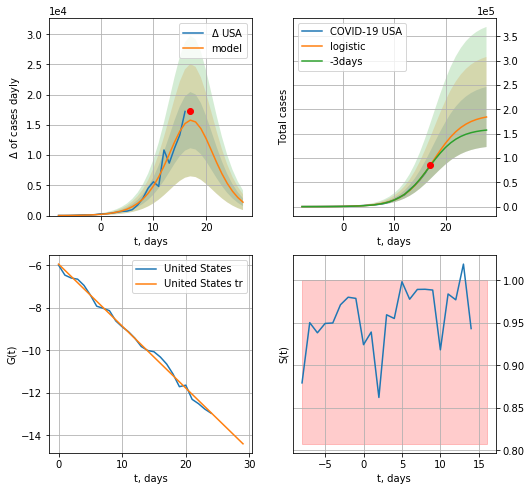

USA data at: 2020-05-04
+3 day model MAPE: 0.02944277425803263
model: logistic
coeffs:  [1.89999777e+05 3.33354123e-01 1.76550850e+01]
rational stdev:  0.3349926957690878
forecast at the end of period: +11 days
	 deltaDaycases:  2217
	 total cases:  184145 ± 61687
	 total death:  10615 ± 10667
trend coefficient of determination: 0.994747
 intercept: -5.944308
 slope: -0.291379


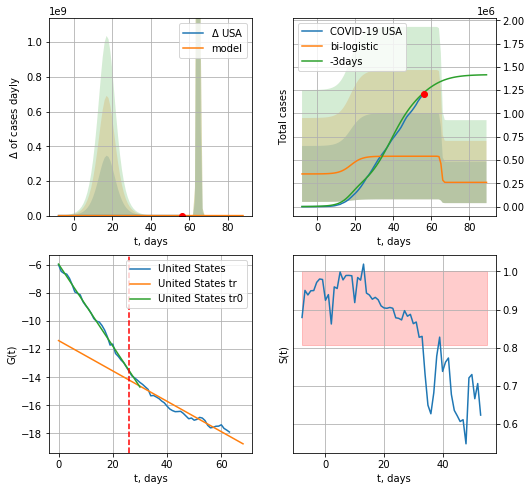

USA data at: 2020-05-04
+3 day model MAPE: 0.5640154040850206
model: bi-logistic
coeffs:  [ 2.80579511e+05 -3.32306521e+00  6.52907365e+01] [1.89999777e+05 3.33354123e-01 1.76550850e+01]
scenario coeffs:  [0.25, 1.0, 1.5]
rational stdev:  0.8557924220390171
forecast at the end of period: +33 days
	 deltaDaycases:  0
	 total cases:  260144 ± 222629
	 total death:  14996 ± 38500
bi-logistic approximation splitting point: 26
trend0 coefficient of determination: 0.995329
 intercept: -5.941731
 slope: -0.291701
trend coefficient of determination: 0.944323
 intercept: -11.386041
 slope: -0.108117


In [560]:
x = forecast('USA',dfUS[:26],d1,16*3-dT,1.0,addpred=False,xcoef=[0.25,1.,2.])
xx = forecast2('USA',dfUS[:],d1,10*7-dT,x,1.0,addpred=True,xcoef=[0.25,1.,1.5],vL=26)

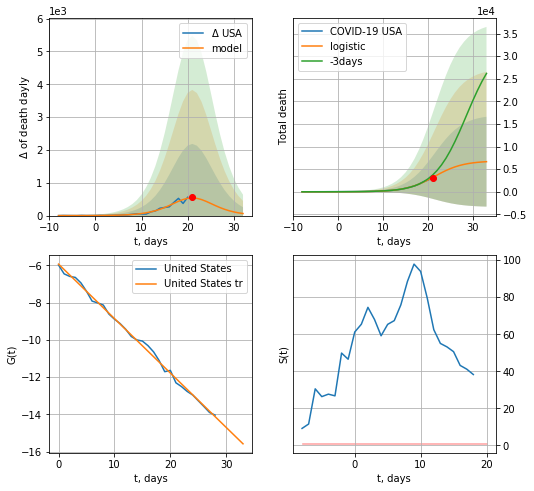

USA data at: 2020-05-04
+3 day model MAPE: 0.214213224760407
model: logistic
coeffs:  [6.83398319e+03 3.16137728e-01 2.14876356e+01]
rational stdev:  1.4929056707100332
forecast at the end of period: +12 days
	 total death:  6659 ± 9941
trend coefficient of determination: 0.996563
 intercept: -5.939898
 slope: -0.291951


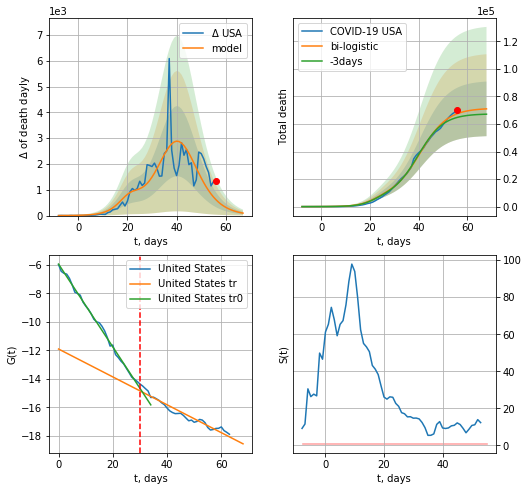

USA data at: 2020-05-04
+3 day model MAPE: 0.04415701791499357
model: bi-logistic
coeffs:  [6.46382436e+04 1.78369622e-01 4.07179207e+01] [6.83398319e+03 3.16137728e-01 2.14876356e+01]
rational stdev:  0.2795054395785495
forecast at the end of period: +12 days
	 deltaDaydeath:  95
	 total death:  70978 ± 19838
bi-logistic approximation splitting point: 30
trend0 coefficient of determination: 0.996662
 intercept: -5.952610
 slope: -0.290589
trend coefficient of determination: 0.942625
 intercept: -11.913720
 slope: -0.097870


In [561]:
vL=30
x = forecast('USA',dfUS[:vL],d1,7*7-dT,1.0,cases='death')
xx = forecast2('USA',dfUS,d1,7*7-dT,x,1.0,cases='death',vL=vL)
#x = forecast('USA',dfUS[:],d1,28*3-dT)

/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:153: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


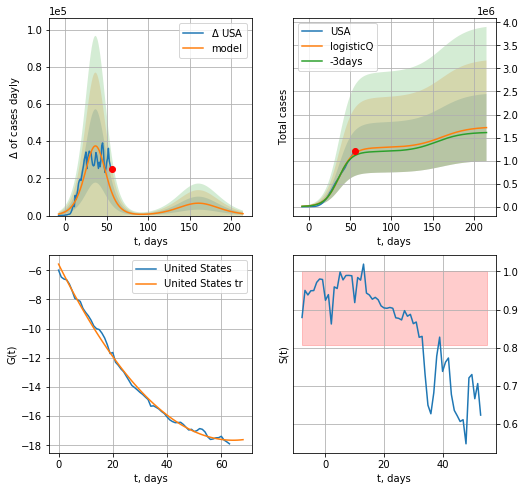

USA data at: 2020-05-04
+3 day model MAPE: 0.045285
model: logisticQ
coeffs: [ 1.27997941e+06  1.28233949e-06  3.68873133e+01 -9.12459676e+04]
S.Korea scenario coeffs: [0.35416971, 0.02606324, 4.35859408, 19.30413219]
rational stdev: 0.424897
forecast at the end of period: +159 days
	 deltaDaycases: 1039
	 total cases: 1715426 ± 728879
	 total death: 98890 ± 126054
trend coefficient of determination: 0.996626
 intercept_: -5.576095611051418
 coeffs_: [ 0.         -0.37547705  0.00291817]


In [562]:
x = forecastRRR('USA',dfUS[:],d1,7*28-dT,1.0,addpred=True,xcoef=koreaCoeffs)#[0.35,.5,3.,1.])

/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


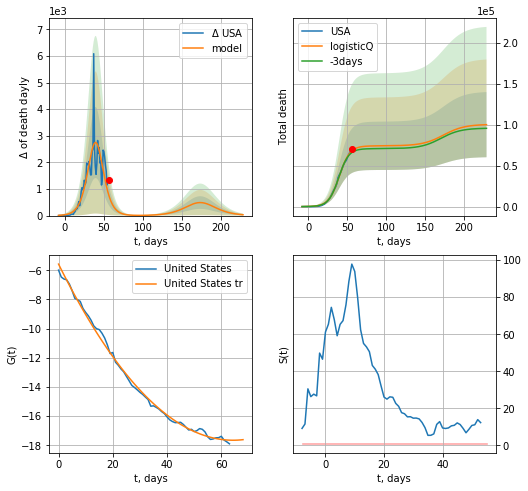

USA data at: 2020-05-04
+3 day model MAPE: 0.031905
model: logisticQ
coeffs: [ 7.43199517e+04  3.85622036e-06  3.98555815e+01 -3.83651037e+04]
S.Korea scenario coeffs: [0.35416971, 0.02606324, 4.35859408, 19.30413219]
rational stdev: 0.397644
forecast at the end of period: +173 days
	 total death: 100219 ± 39851
trend coefficient of determination: 0.996626
 intercept_: -5.576095611051418
 coeffs_: [ 0.         -0.37547705  0.00291817]


In [563]:
x = forecastRRR('USA',dfUS[:],d1,7*30-dT,1.0,addpred=True,xcoef=koreaCoeffs,cases='death')#[0.35,.5,3.,1.])

/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:18: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:18: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


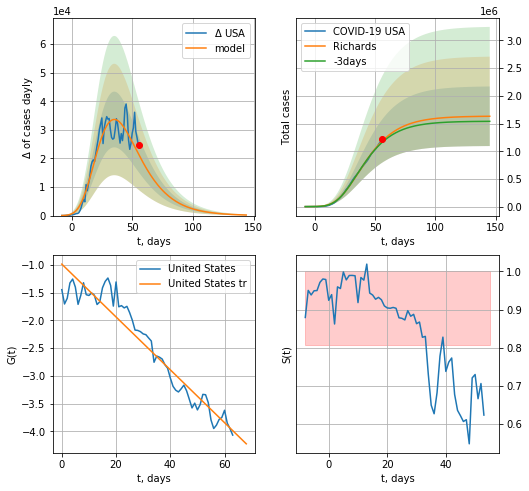

USA data at: 2020-05-04
+3 day model MAPE: 0.020844
model: Richards
coeffs: [ 1.63519773e+06  4.41336155e+00 -4.17866729e+01  1.27490602e-02]
rational stdev: 0.329652
forecast at the end of period: +89 days
	 deltaDaycases: 201
	 total cases: 1631704 ± 537893
	 total death: 94064 ± 93025
trend coefficient of determination: 0.924339
 intercept: -0.983910
 slope: -0.047690


In [564]:
x = forecastRR('USA',dfUS[:],d1,7*18-dT,1.0)

/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:15: RuntimeWarning: overflow encountered in exp
  from ipykernel import kernelapp as app
/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:15: RuntimeWarning: divide by zero encountered in true_divide
  from ipykernel import kernelapp as app
/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1200.
  warnings.warn(errors[info][0], RuntimeWarning)


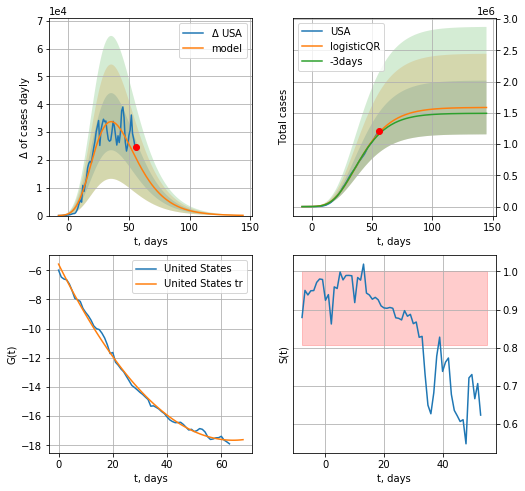

USA data at: 2020-05-04
+3 day model MAPE: 0.022336265239615207
model: logisticQR
coeffs:  [ 1.58762424e+06  1.92718459e-02 -7.75423230e+01 -7.56025313e+02
  3.32154612e-03]
rational stdev:  0.2710924971388263
forecast at the end of period: +89 days
	 deltaDaycases:  94
	 total cases:  1586351 ± 430047
	 total death:  91449 ± 74373
trend coefficient of determination: 0.996626
 intercept_: -5.576095611051418
 coeffs_: [ 0.         -0.37547705  0.00291817]


In [565]:
x = forecastQR('USA',dfUS[:],d1,7*18-dT,1.0,addpred=False,xcoef=[0.35,.5,3.,1.,1.])

GB
          date   cases  active    death
64 2020-04-30  171253  144138  26771.0
65 2020-05-01  177454  149600  27510.0
66 2020-05-02  182260  153785  28131.0
67 2020-05-03  186599  157809  28446.0
68 2020-05-04  190584  161506  28734.0


/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:118: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.5/dist-packages/numpy/core/_methods.py:193: RuntimeWarning: invalid value encountered in subtract
  x = asanyarray(arr - arrmean)


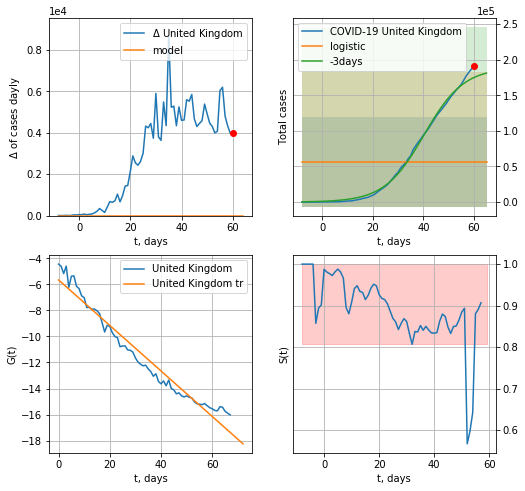

United Kingdom data at: 2020-05-04
+3 day model MAPE: 0.6784402789930714
model: logistic
coeffs:  [ 5.67256232e+04 -3.99337870e+00  1.15742518e+02]
rational stdev:  1.1125241129831043
forecast at the end of period: +5 days
	 deltaDaycases:  0
	 total cases:  56725 ± 63108
	 total death:  8552 ± 28542
trend coefficient of determination: 0.956825
 intercept: -5.661343
 slope: -0.174817


In [566]:
dfGB = read_df(pd.DataFrame(),"GB")
x = forecast('United Kingdom',dfGB[:],d1,6*7-dT,1.)
#x = forecast('United Kingdom',dfGB[:-8-dT],d1,4*7-dT,1.)
#xx = forecast2('United Kingdom',dfGB[:],d1,4*7-dT,x,1.)

/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:118: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.5/dist-packages/numpy/core/_methods.py:193: RuntimeWarning: invalid value encountered in subtract
  x = asanyarray(arr - arrmean)


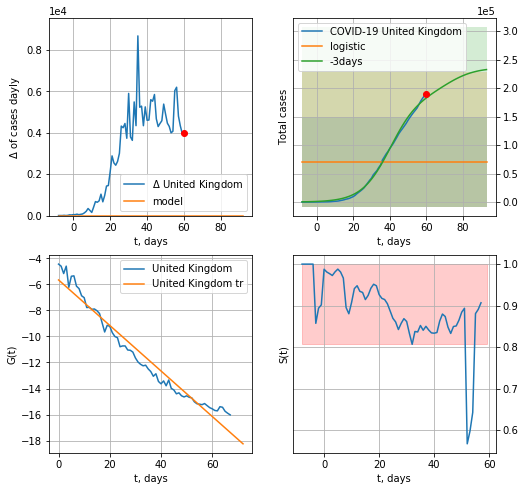

United Kingdom data at: 2020-05-04
+3 day model MAPE: 0.6171323173252506
model: logistic
coeffs:  [ 5.67256232e+04 -3.99337870e+00  1.15742518e+02]
scenario coeffs:  [0.25, 1.0, 1.8]
rational stdev:  1.1125241129831043
forecast at the end of period: +33 days
	 deltaDaycases:  0
	 total cases:  70907 ± 78885
	 total death:  10690 ± 35678
trend coefficient of determination: 0.956825
 intercept: -5.661343
 slope: -0.174817


In [567]:
x = forecast('United Kingdom',dfGB[:],d1,10*7-dT,1.,addpred=True,xcoef=[0.25,1.,1.8])

/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:131: RuntimeWarning: divide by zero encountered in true_divide


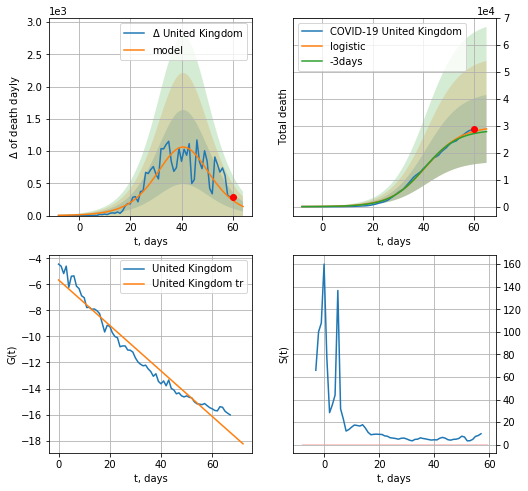

United Kingdom data at: 2020-05-04
+3 day model MAPE: 0.03147868207562318
model: logistic
coeffs:  [2.98019917e+04 1.42781576e-01 4.11332235e+01]
rational stdev:  0.4375228008588116
forecast at the end of period: +5 days
	 total death:  28846 ± 12621
trend coefficient of determination: 0.956825
 intercept: -5.661343
 slope: -0.174817


In [568]:
x = forecast('United Kingdom',dfGB[:],d1,6*7-dT,1.,cases='death')

/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:18: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:18: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


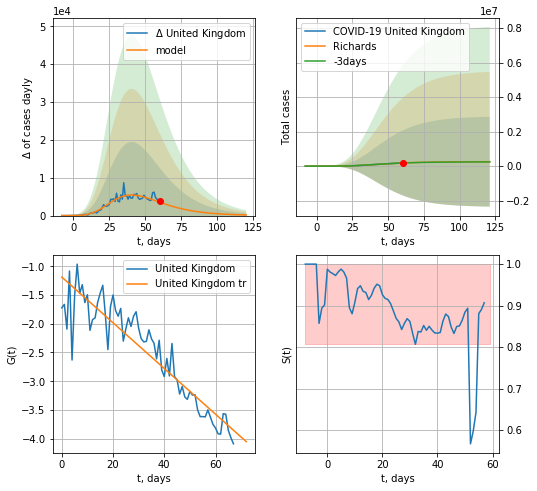

United Kingdom data at: 2020-05-04
+3 day model MAPE: 0.018649
model: Richards
coeffs: [ 2.62857077e+05  3.13339616e+00 -2.96743753e+01  1.81227748e-02]
rational stdev: 10.006967
forecast at the end of period: +61 days
	 deltaDaycases: 161
	 total cases: 260082 ± 2602633
	 total death: 39212 ± 1177179
trend coefficient of determination: 0.852043
 intercept: -1.188524
 slope: -0.039742


In [569]:
x = forecastRR('United Kingdom',dfGB[:],d1,14*7-dT,1.)

/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:153: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


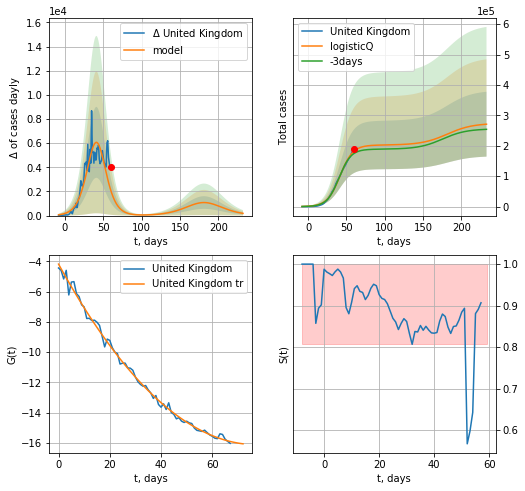

United Kingdom data at: 2020-05-04
+3 day model MAPE: 0.044799
model: logisticQ
coeffs: [ 2.02394358e+05  1.71568523e-06  4.16719373e+01 -6.98919802e+04]
S.Korea scenario coeffs: [0.35416971, 0.02606324, 4.35859408, 19.30413219]
rational stdev: 0.393432
forecast at the end of period: +173 days
	 deltaDaycases: 183
	 total cases: 270985 ± 106614
	 total death: 40855 ± 48221
trend coefficient of determination: 0.995332
 intercept_: -4.1908616926383715
 coeffs_: [ 0.         -0.30852154  0.00199576]


In [570]:
x = forecastRRR('United Kingdom',dfGB[:],d1,30*7-dT,1.,addpred=True,xcoef=koreaCoeffs)#[0.35,.5,3,1])

/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)
/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:207: RuntimeWarning: divide by zero encountered in true_divide


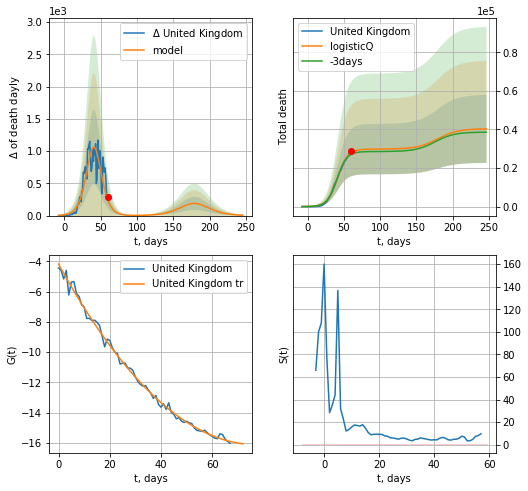

United Kingdom data at: 2020-05-04
+3 day model MAPE: 0.031521
model: logisticQ
coeffs: [ 2.97974371e+04  2.12308566e-06  4.11312460e+01 -6.72078890e+04]
S.Korea scenario coeffs: [0.35416971, 0.02606324, 4.35859408, 19.30413219]
rational stdev: 0.437557
forecast at the end of period: +187 days
	 total death: 40269 ± 17620
trend coefficient of determination: 0.995332
 intercept_: -4.1908616926383715
 coeffs_: [ 0.         -0.30852154  0.00199576]


In [571]:
x = forecastRRR('United Kingdom',dfGB[:],d1,32*7-dT,1.,addpred=True,xcoef=koreaCoeffs,cases='death')

In [134]:
#x = forecastQR('United Kingdom',dfGB[:],d1,18*7-dT,1.,addpred=True,xcoef=[0.35,.5,3,1,1])

In [169]:
#x = forecastR('United Kingdom',dfGB[:],d1,20*7-dT,1.,addpred=True,xcoef=[0.25,1.,2.4,1])

In [170]:
#trend3(dfDK,dfNG,dfSW[:],'DK','NG','SW',40,40,40)

In [171]:
#x = forecastR('United Kingdom',dfGB[:],d1,20*7-dT,1.,addpred=True,xcoef=[0.25,1.,4.,1])

In [172]:
#x = forecast('Denmark',dfDK[:15],d1,2*7-dT,1.0)
#xx = forecast2('Denmark',dfDK[:],d1,4*7-dT, x,1.0)
#xx = np.concatenate((x, xx), axis=0)
#xxx = forecast3('Denmark',dfDK[:],d1,14-dT, xx)

In [572]:
dT

37

/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 800.
  warnings.warn(errors[info][0], RuntimeWarning)


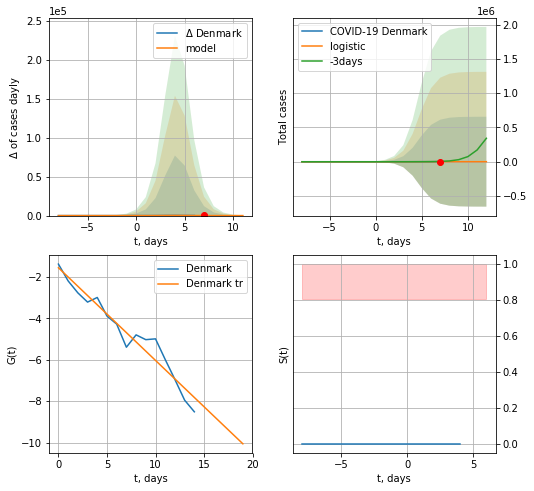

Denmark data at: 2020-05-04
+3 day model MAPE: 0.9299494930201694
model: logistic
coeffs:  [849.15572285   1.15642837   4.69716859]
rational stdev:  772.2918388633376
forecast at the end of period: +5 days
	 deltaDaycases:  0
	 total cases:  848 ± 655655
	 total death:  43 ± 99625
trend coefficient of determination: 0.941867
 intercept: -1.561623
 slope: -0.447087


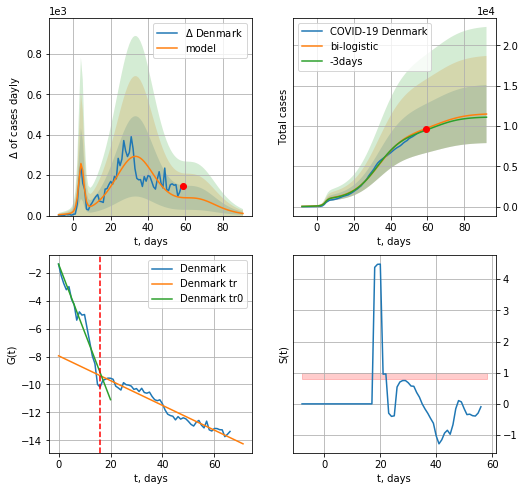

Denmark data at: 2020-05-04
+3 day model MAPE: 0.02226847205839491
model: bi-logistic
coeffs:  [8.57134941e+03 1.35392174e-01 3.36273861e+01] [849.15572285   1.15642837   4.69716859]
scenario coeffs:  [0.25, 1.0, 2.0]
rational stdev:  0.31382144550855784
forecast at the end of period: +33 days
	 deltaDaycases:  10
	 total cases:  11487 ± 3605
	 total death:  585 ± 550
bi-logistic approximation splitting point: 16
trend0 coefficient of determination: 0.932975
 intercept: -1.384195
 slope: -0.485107
trend coefficient of determination: 0.947338
 intercept: -7.947646
 slope: -0.088718


In [573]:
vL = 16
x = forecast('Denmark',dfDK[:vL],d1,6*7-dT,1.0)
xx = forecast2('Denmark',dfDK[:],d1,10*7-dT, x,1.0,addpred=True,xcoef=[0.25,1.,2.],vL=vL)

/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:18: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:18: RuntimeWarning: divide by zero encountered in true_divide


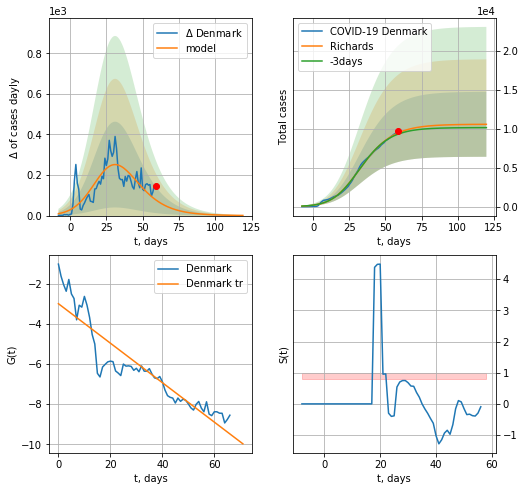

Denmark data at: 2020-05-04
+3 day model MAPE: 0.017840
model: Richards
coeffs: [1.05767481e+04 1.67269934e-01 2.21412099e+01 4.75376665e-01]
rational stdev: 0.394537
forecast at the end of period: +61 days
	 deltaDaycases: 0
	 total cases: 10567 ± 4169
	 total death: 538 ± 636
trend coefficient of determination: 0.851318
 intercept: -2.995196
 slope: -0.098293


In [574]:
x = forecastRR('Denmark',dfDK[:],d1,14*7-dT,1.0)
#x2 = forecast2R('Denmark',dfDK[:],d1,16*7-dT,x,1.0)

/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)
/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:153: RuntimeWarning: overflow encountered in exp


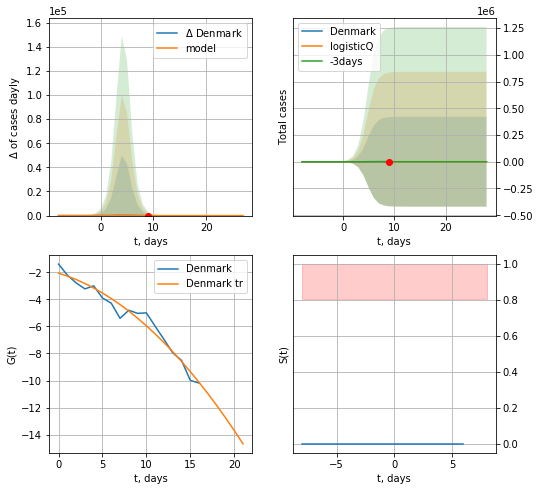

Denmark data at: 2020-05-04
+3 day model MAPE: 2.879608
model: logisticQ
coeffs: [ 8.62480490e+02  2.49401516e-04  4.73670538e+00 -4.50088701e+03]
rational stdev: 487.269302
forecast at the end of period: +19 days
	 deltaDaycases: 0
	 total cases: 862 ± 420260
	 total death: 43 ± 62857
trend coefficient of determination: 0.965266
 intercept_: -2.0557034713075613
 coeffs_: [ 0.         -0.1970759  -0.01925246]


/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:288: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


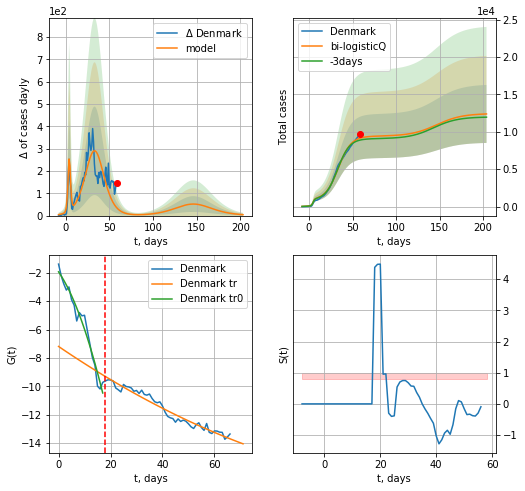

Denmark data at: 2020-05-04
+3 day model MAPE: 0.029833
model: bi-logisticQ
coeffs: [ 8.55218150e+03  1.04625316e-06  3.36445202e+01 -1.29826956e+05]
S.Korea scenario coeffs: [0.35416971, 0.02606324, 4.35859408, 19.30413219]
rational stdev: 0.313099
forecast at the end of period: +145 days
	 deltaDaycases: 4
	 total cases: 12384 ± 3877
	 total death: 631 ± 592
bi-logisticQ approximation splitting point: 18
trend coefficient of determination: 0.963211
 intercept_: -1.9308894789691964
 coeffs_: [ 0.         -0.26605777 -0.01390014]
trend coefficient of determination: 0.956729
 intercept_: -7.190529695657682
 coeffs_: [ 0.         -0.12459892  0.00039315]


In [575]:
x = forecastRRR('Denmark',dfDK[:18],d1,8*7-dT,1.0,addpred=False,xcoef=koreaCoeffs)#[0.35,0.5,4.5,1.])
x = forecast2RRR('Denmark',dfDK[:],d1,26*7-dT,x,addpred=True,xcoef=koreaCoeffs,vL=18)

NG
          date  cases  active  death
64 2020-04-30   7738    7496  210.0
65 2020-05-01   7783    7541  210.0
66 2020-05-02   7809    7566  211.0
67 2020-05-03   7847    7604  211.0
68 2020-05-04   7904    7658  214.0


/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 800.
  warnings.warn(errors[info][0], RuntimeWarning)


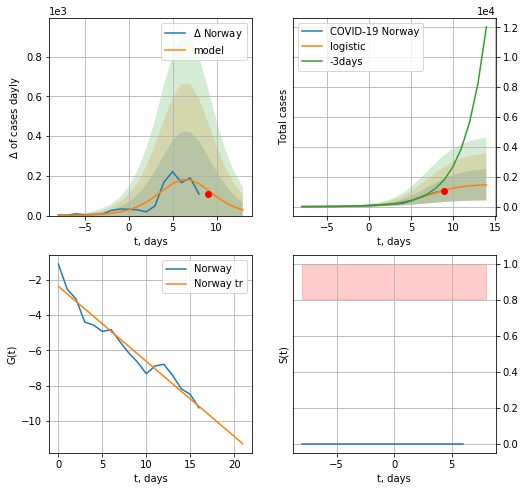

Norway data at: 2020-05-04
+3 day model MAPE: 0.5371818041233266
model: logistic
coeffs:  [1.50888671e+03 4.87443897e-01 6.97859719e+00]
rational stdev:  0.7165081035353225
forecast at the end of period: +5 days
	 deltaDaycases:  28
	 total cases:  1461 ± 1046
	 total death:  39 ± 83
trend coefficient of determination: 0.944117
 intercept: -2.361427
 slope: -0.426195


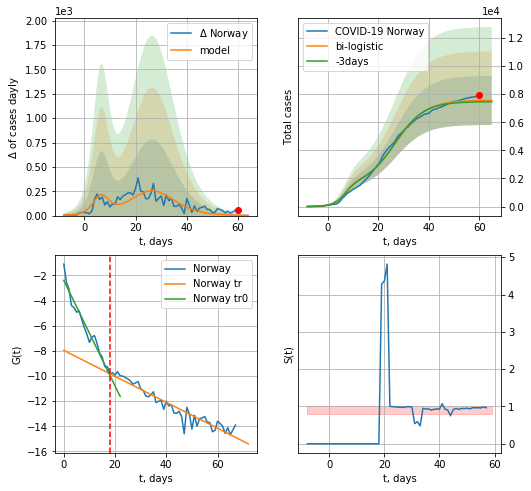

Norway data at: 2020-05-04
+3 day model MAPE: 0.012526968245161878
model: bi-logistic
coeffs:  [6.05044215e+03 1.68534253e-01 2.69269701e+01] [1.50888671e+03 4.87443897e-01 6.97859719e+00]
rational stdev:  0.23093943712192352
forecast at the end of period: +5 days
	 deltaDaycases:  1
	 total cases:  7549 ± 1743
	 total death:  204 ± 141
bi-logistic approximation splitting point: 18
trend0 coefficient of determination: 0.950087
 intercept: -2.394883
 slope: -0.419922
trend coefficient of determination: 0.912918
 intercept: -7.962784
 slope: -0.103272


In [576]:
dfNG = read_df(pd.DataFrame(),"NG")
vL=18
x = forecast('Norway',dfNG[:vL],d1,6*7-dT,1.0)
xx = forecast2('Norway',dfNG[:],d1,6*7-dT,x,1.0,vL=vL)
#xx = np.concatenate((x, xx), axis=0)

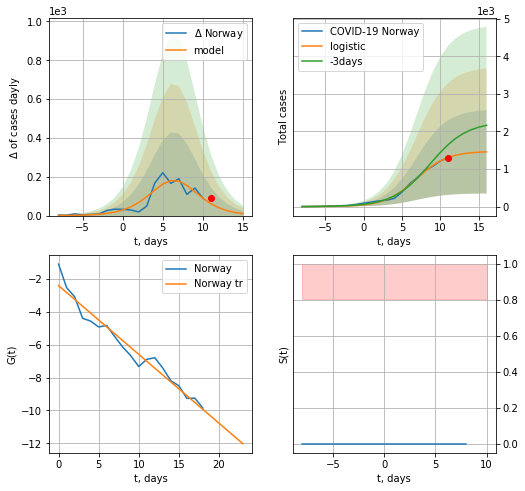

Norway data at: 2020-05-04
+3 day model MAPE: 0.247655347933597
model: logistic
coeffs:  [1.47478891e+03 4.95866797e-01 6.87524749e+00]
rational stdev:  0.7596156049961639
forecast at the end of period: +5 days
	 deltaDaycases:  9
	 total cases:  1458 ± 1108
	 total death:  39 ± 88
trend coefficient of determination: 0.956890
 intercept: -2.403448
 slope: -0.418410


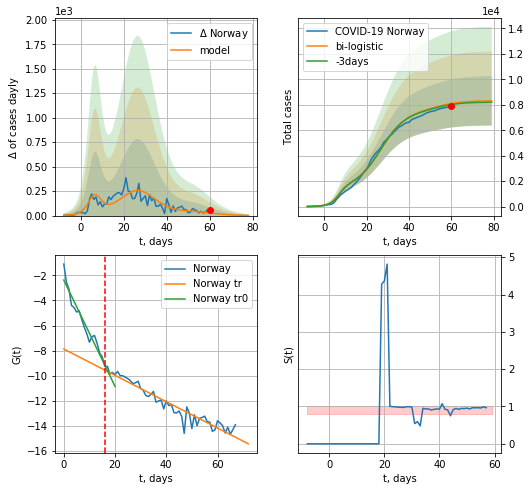

Norway data at: 2020-05-04
+3 day model MAPE: 0.01039163152544342
model: bi-logistic
coeffs:  [6.08572144e+03 1.67730853e-01 2.68490514e+01] [1.47478891e+03 4.95866797e-01 6.87524749e+00]
scenario coeffs:  [0.125, 1.0, 2.0]
rational stdev:  0.23312787509542476
forecast at the end of period: +19 days
	 deltaDaycases:  2
	 total cases:  8309 ± 1937
	 total death:  224 ± 156
bi-logistic approximation splitting point: 16
trend0 coefficient of determination: 0.933194
 intercept: -2.371994
 slope: -0.424081
trend coefficient of determination: 0.922269
 intercept: -7.874670
 slope: -0.105015


In [577]:
vL = 16#len(dfNG)-13-dT
x = forecast('Norway',dfNG[:-12-dT],d1,6*7-dT,1.0)
xx = forecast2('Norway',dfNG[:],d1,8*7-dT,x,1.0,addpred=True,xcoef=[0.25/2,1.,2.],vL=vL)

/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:18: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:18: RuntimeWarning: divide by zero encountered in true_divide


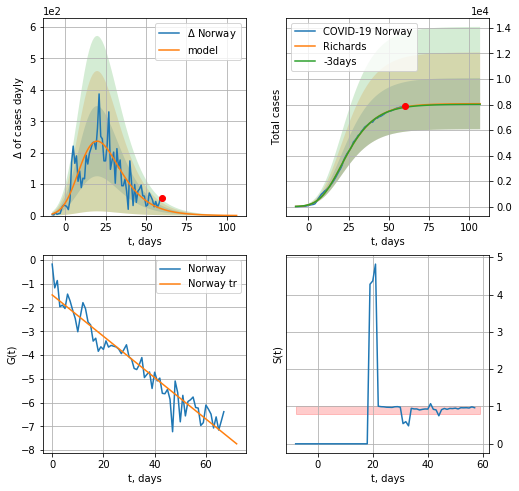

Norway data at: 2020-05-04
+3 day model MAPE: 0.004545
model: Richards
coeffs: [ 8.06876717e+03  5.33791328e-01 -8.97453104e-01  1.61413777e-01]
rational stdev: 0.248672
forecast at the end of period: +47 days
	 deltaDaycases: 0
	 total cases: 8064 ± 2005
	 total death: 218 ± 162
trend coefficient of determination: 0.931324
 intercept: -1.472595
 slope: -0.086920


In [578]:
x = forecastRR('Norway',dfNG[:],d1,12*7-dT,1.0)
#x = forecastQR('Norway',dfNG[:],d1,8*7-dT,1.0)

/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:153: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


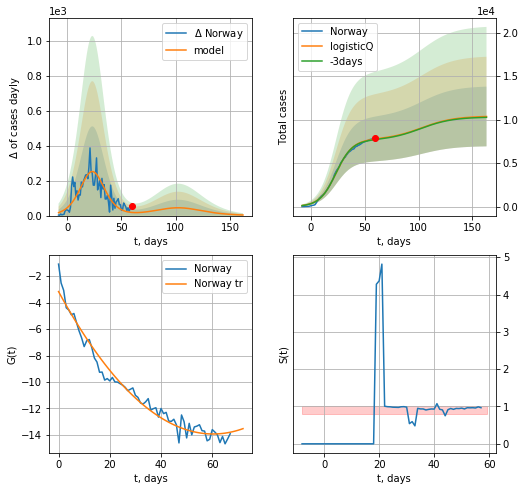

Norway data at: 2020-05-04
+3 day model MAPE: 0.009029
model: logisticQ
coeffs: [ 7.68161363e+03  1.17124255e-06  2.35668235e+01 -1.11631921e+05]
S.Korea scenario coeffs: [0.35416971, 0.02606324, 4.35859408, 19.30413219]
rational stdev: 0.331435
forecast at the end of period: +103 days
	 deltaDaycases: 3
	 total cases: 10351 ± 3430
	 total death: 280 ± 278
trend coefficient of determination: 0.969992
 intercept_: -3.172614416001025
 coeffs_: [ 0.         -0.35650922  0.00295501]


In [579]:
x = forecastRRR('Norway',dfNG[:],d1,20*7-dT,1.0,addpred=True,xcoef=koreaCoeffs)#[.35,.5,4.,1])

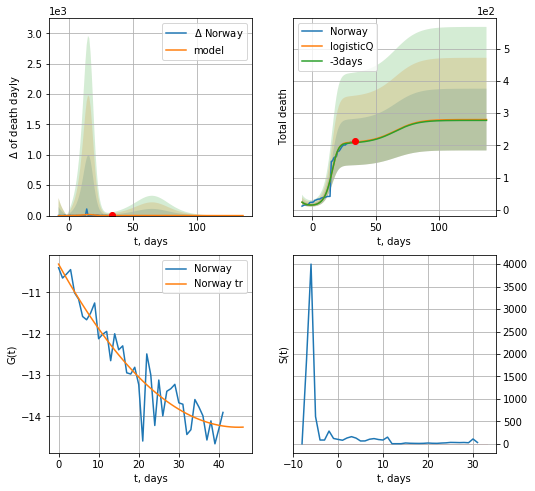

Norway data at: 2020-05-04
+3 day model MAPE: 0.009129
model: logisticQ
coeffs: [ 2.06911307e+02  1.04467410e-02  1.47904434e+01 -1.67602504e+01]
S.Korea scenario coeffs: [0.35416971, 0.02606324, 4.35859408, 19.30413219]
rational stdev: 0.342705
forecast at the end of period: +103 days
	 total death: 280 ± 96
trend coefficient of determination: 0.898577
 intercept_: -10.313341753979357
 coeffs_: [ 0.         -0.17610208  0.00196135]


In [580]:
x = forecastRRR('Norway',dfNG[26:],d1,20*7-dT,1.0,addpred=True,xcoef=koreaCoeffs,cases='death')#[.35,.5,4.,1])

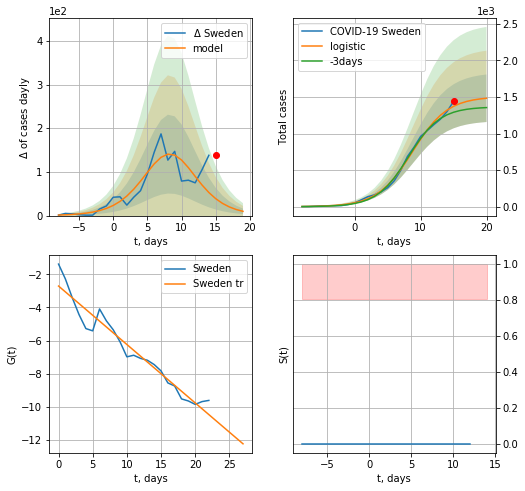

Sweden data at: 2020-05-04
+3 day model MAPE: 0.0730548600677782
model: logistic
coeffs:  [1.50473584e+03 3.76040161e-01 8.77120622e+00]
rational stdev:  0.21926973222081286
forecast at the end of period: +5 days
	 deltaDaycases:  9
	 total cases:  1482 ± 325
	 total death:  180 ± 118
trend coefficient of determination: 0.941971
 intercept: -2.710792
 slope: -0.352814


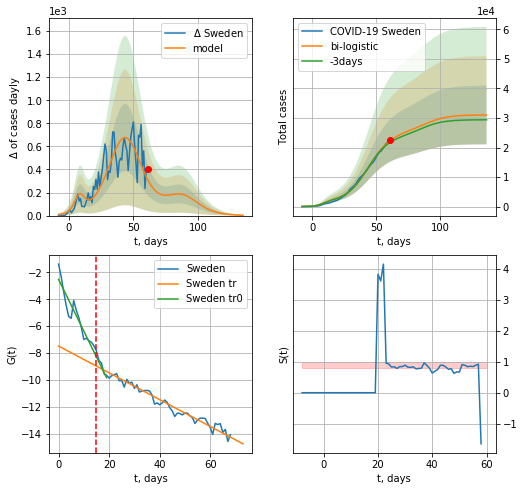

Sweden data at: 2020-05-04
+3 day model MAPE: 0.030003245010397493
model: bi-logistic
coeffs:  [2.36409173e+04 1.13903876e-01 4.39579421e+01] [1.50473584e+03 3.76040161e-01 8.77120622e+00]
scenario coeffs:  [0.25, 1.0, 2.0]
rational stdev:  0.3203248589087004
forecast at the end of period: +75 days
	 deltaDaycases:  3
	 total cases:  31030 ± 9939
	 total death:  3781 ± 3633
bi-logistic approximation splitting point: 15
trend0 coefficient of determination: 0.870123
 intercept: -2.515075
 slope: -0.384868
trend coefficient of determination: 0.956490
 intercept: -7.477000
 slope: -0.099524


In [581]:
vL = 15#len(dfSW)-12-dT
x = forecast('Sweden',dfSW[:-9-dT],d1,6*7-dT,1.0)
xx = forecast2('Sweden',dfSW[:],d1,7*16-dT,x,1.0,addpred=True,xcoef=[.25,1.,2.],vL=vL)

SW
          date  cases  active   death
65 2020-04-30  21092   17501  2586.0
66 2020-05-01  21520   17862  2653.0
67 2020-05-02  22082   18408  2669.0
68 2020-05-03  22317   18633  2679.0
69 2020-05-04  22721   15878  2769.0


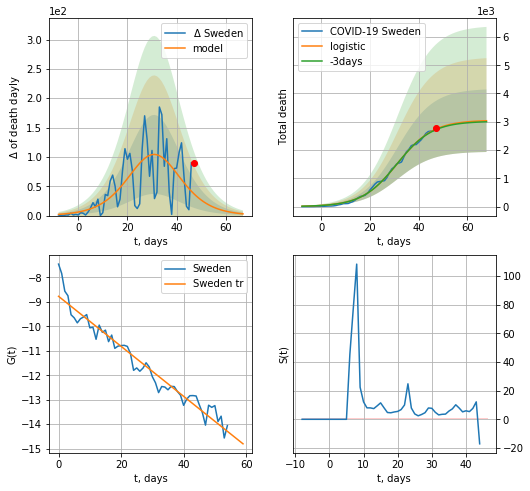

Sweden data at: 2020-05-04
+3 day model MAPE: 0.00800265524387205
model: logistic
coeffs:  [3.05754971e+03 1.36449774e-01 3.13439678e+01]
rational stdev:  0.3641459017452289
forecast at the end of period: +21 days
	 total death:  3037 ± 1105
trend coefficient of determination: 0.949090
 intercept: -8.769987
 slope: -0.102287


In [582]:
dfSW = read_df(pd.DataFrame(),"SW")
x = forecast('Sweden',dfSW[14:],d1,3*7,shift=1.0,cases='death')

/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:18: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:18: RuntimeWarning: divide by zero encountered in true_divide


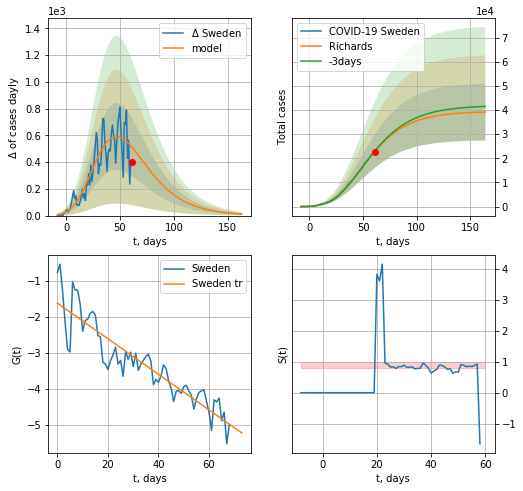

Sweden data at: 2020-05-04
+3 day model MAPE: 0.006645
model: Richards
coeffs: [ 3.94547869e+04  4.36234972e-01 -7.09514265e+00  9.79435487e-02]
rational stdev: 0.299874
forecast at the end of period: +103 days
	 deltaDaycases: 11
	 total cases: 39186 ± 11750
	 total death: 4775 ± 4295
trend coefficient of determination: 0.829026
 intercept: -1.617189
 slope: -0.049531


In [583]:
x = forecastRR('Sweden',dfSW[:],d1,20*7-dT,1.0)
#x = forecastQR('Sweden',dfSW[:],d1,16*7-dT,1.0)
#xx = forecast2R('Sweden',dfSW[:],d1,12*7-dT,x,1.0)#,addpred=True,xcoef=[0.25,1.,2.3,1]

/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:153: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


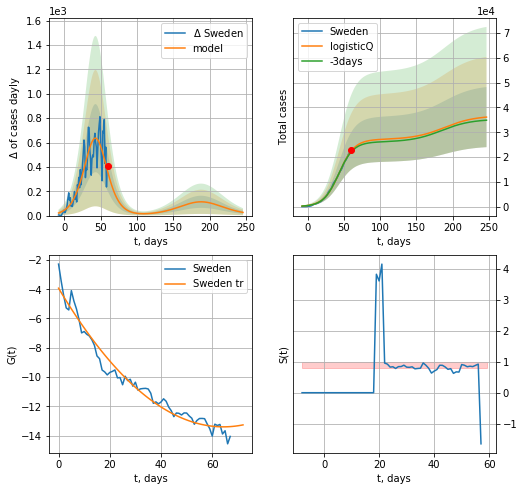

Sweden data at: 2020-05-04
+3 day model MAPE: 0.019312
model: logisticQ
coeffs: [ 2.70898682e+04  1.95586200e-06  4.32895065e+01 -4.79619640e+04]
S.Korea scenario coeffs: [0.35416971, 0.02606324, 4.35859408, 19.30413219]
rational stdev: 0.335868
forecast at the end of period: +187 days
	 deltaDaycases: 26
	 total cases: 36109 ± 12128
	 total death: 4400 ± 4433
trend coefficient of determination: 0.965719
 intercept_: -3.92873701188595
 coeffs_: [ 0.         -0.29454583  0.00228842]


In [584]:
x = forecastRRR('Sweden',dfSW[1:],d1,32*7-dT,1.0,addpred=True,xcoef=koreaCoeffs)

/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)
/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:207: RuntimeWarning: invalid value encountered in true_divide


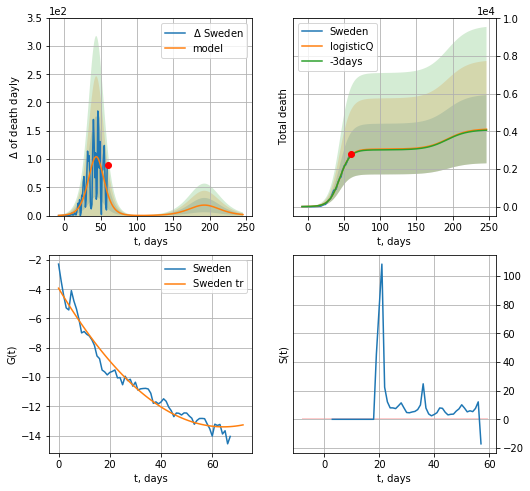

Sweden data at: 2020-05-04
+3 day model MAPE: 0.008281
model: logisticQ
coeffs: [ 3.05508568e+03  4.04304570e-06  4.43305306e+01 -3.37429141e+04]
S.Korea scenario coeffs: [0.35416971, 0.02606324, 4.35859408, 19.30413219]
rational stdev: 0.440751
forecast at the end of period: +187 days
	 total death: 4110 ± 1811
trend coefficient of determination: 0.965719
 intercept_: -3.92873701188595
 coeffs_: [ 0.         -0.29454583  0.00228842]


In [585]:
x = forecastRRR('Sweden',dfSW[1:],d1,32*7-dT,1.0,addpred=True,xcoef=koreaCoeffs,cases='death')

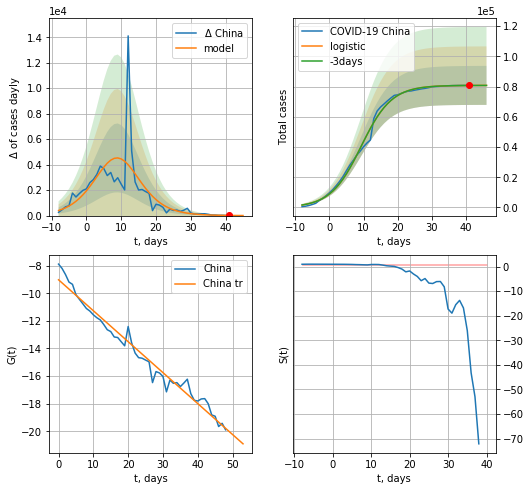

China data at: 2020-05-04
+3 day model MAPE: 0.00012785692335583266
model: logistic
coeffs:  [8.08101838e+04 2.24512818e-01 9.29453373e+00]
rational stdev:  0.15971316009002232
forecast at the end of period: +5 days
	 deltaDaycases:  5
	 total cases:  80788 ± 12903
	 total death:  4516 ± 2163
trend coefficient of determination: 0.972183
 intercept: -9.021396
 slope: -0.224243


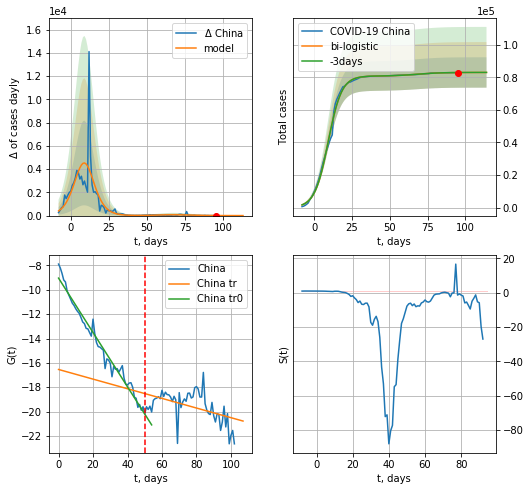

China data at: 2020-05-04
+3 day model MAPE: 0.00036817110564599074
model: bi-logistic
coeffs:  [2.21264408e+03 1.25613014e-01 6.80119914e+01] [8.08101838e+04 2.24512818e-01 9.29453373e+00]
rational stdev:  0.11243354135795955
forecast at the end of period: +19 days
	 deltaDaycases:  0
	 total cases:  83015 ± 9333
	 total death:  4640 ± 1565
bi-logistic approximation splitting point: 50
trend0 coefficient of determination: 0.973282
 intercept: -9.036652
 slope: -0.223289
trend coefficient of determination: 0.236824
 intercept: -16.542039
 slope: -0.039605


In [586]:
x = forecast('China',dfCN[:50],d1,6*7-dT,1.0)
#xx = forecast('China',dfCN[21:-32],d1,17)
#xx = np.concatenate((x, xx), axis=0)
xx = forecast2('China',dfCN[:],d1,8*7-dT,x,1.0,vL=50)

In [587]:
#dfTT[dfTT.Country=='%s'%('China')][0].values[0]

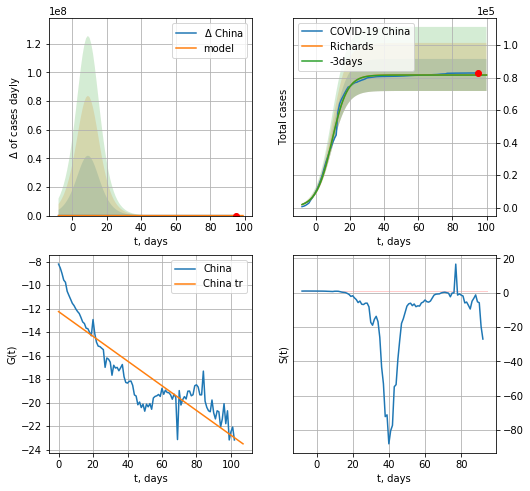

China data at: 2020-05-04
+3 day model MAPE: 0.000737
model: Richards
coeffs: [8.16672969e+04 2.12766438e-01 9.74847291e+00 1.04727814e+00]
rational stdev: 0.120824
forecast at the end of period: +5 days
	 deltaDaycases: 0
	 total cases: 81667 ± 9867
	 total death: 4565 ± 1654
trend coefficient of determination: 0.778266
 intercept: -12.249080
 slope: -0.105291


In [588]:
x = forecastRR('China',dfCN[:],d1,6*7-dT,1.0)
#x = forecastQR('China',dfCN[:],d1,6*7-dT,1.0)
#xx = forecast('China',dfCN[21:-32],d1,17)
#xx = np.concatenate((x, xx), axis=0)
#xx = forecast2R('China',dfCN[:],d1,6*7-dT,x,1.0)

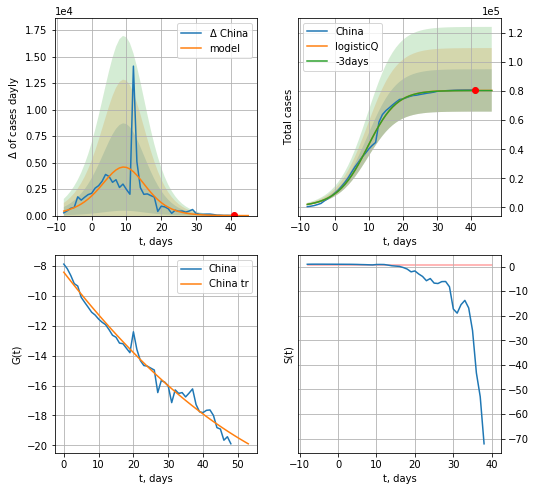

China data at: 2020-05-04
+3 day model MAPE: 0.001323
model: logisticQ
coeffs: [ 8.04175259e+04  1.07650457e-03  9.35257488e+00 -2.02425652e+02]
rational stdev: 0.181019
forecast at the end of period: +5 days
	 deltaDaycases: 1
	 total cases: 80413 ± 14556
	 total death: 4495 ± 2441
trend coefficient of determination: 0.979964
 intercept_: -8.428864441790822
 coeffs_: [ 0.         -0.29994819  0.00157784]


/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:288: RuntimeWarning: overflow encountered in exp


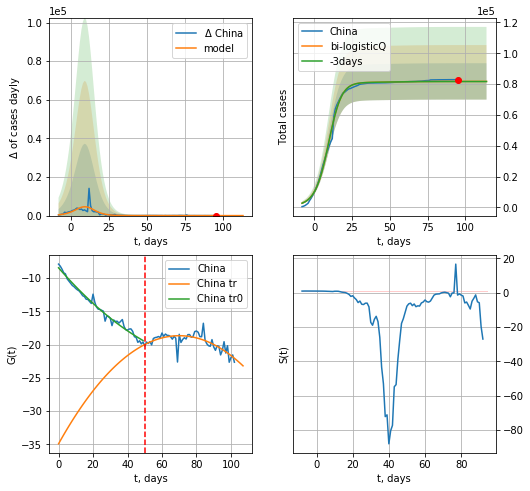

China data at: 2020-05-04
+3 day model MAPE: 0.000879
model: bi-logisticQ
coeffs: [ 1.32783044e+03  8.19724967e-04  2.50232521e+01 -5.88891290e-03]
rational stdev: 0.144101
forecast at the end of period: +19 days
	 deltaDaycases: 0
	 total cases: 81745 ± 11779
	 total death: 4569 ± 1975
bi-logisticQ approximation splitting point: 50
trend coefficient of determination: 0.980847
 intercept_: -8.442415731989867
 coeffs_: [ 0.         -0.29762768  0.00151769]
trend coefficient of determination: 0.553225
 intercept_: -34.92367659364491
 coeffs_: [ 0.          0.46458741 -0.0033173 ]


In [589]:
x = forecastRRR('China',dfCN[:50],d1,6*7-dT,1.0)
xx=forecast2RRR('China',dfCN[:],d1,8*7-dT,x,1.0,vL=50)

In [590]:
#x = forecastQR('China',dfCN[50:],d1,6*7-dT,1.0)

KR
          date  cases  active  death
75 2020-04-30  10774  1454.0  248.0
76 2020-05-01  10780  1407.0  250.0
77 2020-05-02  10793  1360.0  250.0
78 2020-05-03  10801  1332.0  252.0
79 2020-05-04  10804  1267.0  254.0


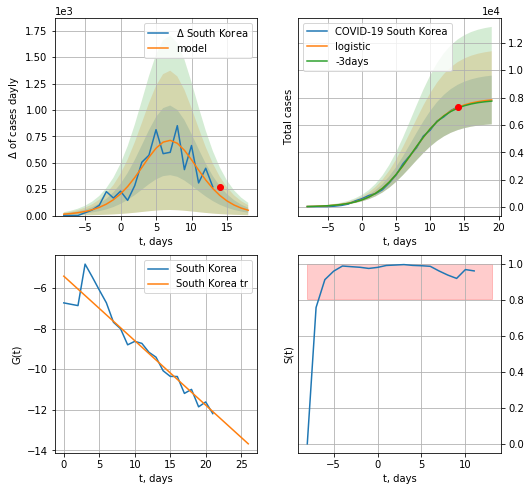

South Korea data at: 2020-05-04
model: logistic
coeffs:  [7.94116797e+03 3.59786702e-01 7.37445793e+00]
rational stdev:  0.2275932520547523
forecast at the end of period: +5 days
	 deltaDaycases:  50
	 total cases:  7821 ± 1780
	 total death:  183 ± 124
trend coefficient of determination: 0.904554
 intercept: -5.419235
 slope: -0.317547


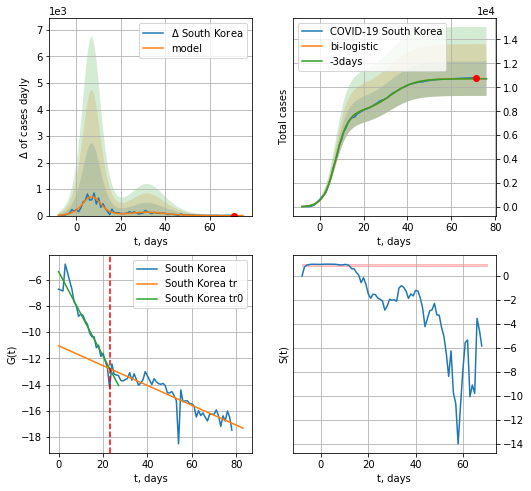

South Korea data at: 2020-05-04
+3 day model MAPE: 0.0013342113205652877
model: bi-logistic
coeffs:  [2.78280348e+03 1.81588678e-01 3.23498596e+01] [7.94116797e+03 3.59786702e-01 7.37445793e+00]
rational stdev:  0.13441184014035137
forecast at the end of period: +5 days
	 deltaDaycases:  0
	 total cases:  10722 ± 1441
	 total death:  252 ± 101
bi-logistic approximation splitting point: 23
trend0 coefficient of determination: 0.916463
 intercept: -5.394262
 slope: -0.321115
trend coefficient of determination: 0.780630
 intercept: -11.042051
 slope: -0.075587


In [591]:
dfKR = read_df(pd.DataFrame(),"KR")
x = forecast('South Korea',dfKR[:23],d1,6*7-dT,1.0,pMAPE=False)
xx=forecast2('South Korea',dfKR[:],d1,6*7-dT,x,1.0,vL=23)

In [592]:
#vL = 30
#x = forecastRRR('South Korea',dfKR[:vL],d1,8*7-dT,1.0)
#x1 = forecastRRR('South Korea',dfKR[39:],d1,12*7-dT,1.0)
#xx = np.concatenate((x, x1), axis=0)
#xx=forecast2RRR('South Korea',dfKR[:],d1,8*7-dT,x,1.0,vL=vL)

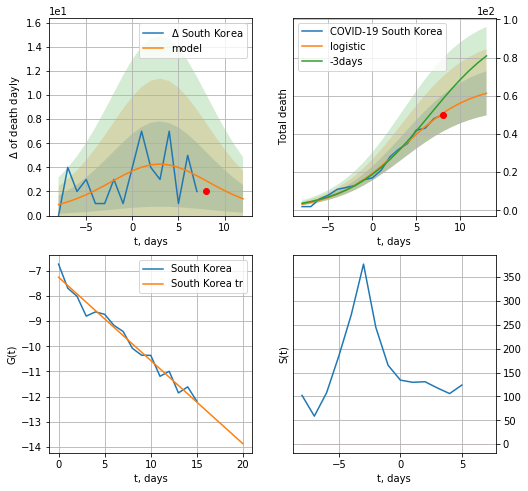

South Korea data at: 2020-05-04
model: logistic
coeffs:  [66.59757424  0.25734808  3.46382915]
rational stdev:  0.18867115045959354
forecast at the end of period: +5 days
	 total death:  61 ± 11
trend coefficient of determination: 0.972428
 intercept: -7.252219
 slope: -0.331355


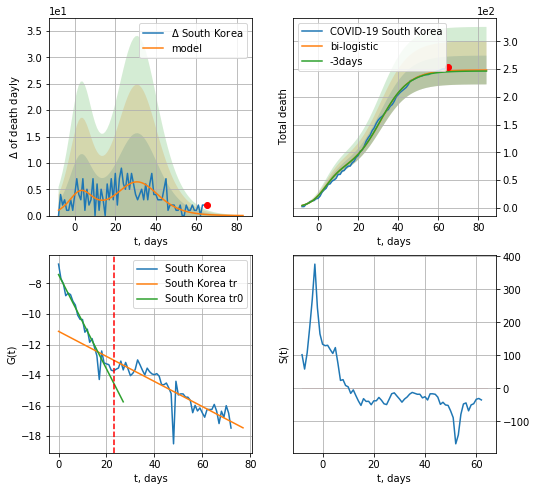

South Korea data at: 2020-05-04
+3 day model MAPE: 0.007058365389564087
model: bi-logistic
coeffs:  [1.81704920e+02 1.40682434e-01 3.12591873e+01] [66.59757424  0.25734808  3.46382915]
rational stdev:  0.10438628266930985
forecast at the end of period: +19 days
	 deltaDaydeath:  0
	 total death:  248 ± 25
bi-logistic approximation splitting point: 23
trend0 coefficient of determination: 0.950305
 intercept: -7.416817
 slope: -0.308862
trend coefficient of determination: 0.778544
 intercept: -11.137265
 slope: -0.082128


In [593]:
x = forecast('South Korea',dfKR[6:23],d1,6*7-dT,1.0,cases='death',pMAPE=False)
xx=forecast2('South Korea',dfKR[6:],d1,8*7-dT,x,1.0,vL=23,cases='death')

/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


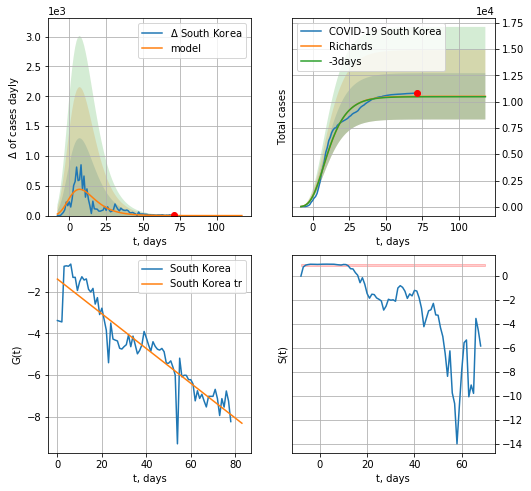

South Korea data at: 2020-05-04
+3 day model MAPE: 0.003478
model: Richards
coeffs: [ 1.04961329e+04  3.01925994e+01 -4.12000119e+01  3.79134831e-03]
rational stdev: 0.209392
forecast at the end of period: +47 days
	 deltaDaycases: 0
	 total cases: 10496 ± 2197
	 total death: 246 ± 154
trend coefficient of determination: 0.849241
 intercept: -1.393475
 slope: -0.083236


In [594]:
x = forecastRR('South Korea',dfKR[:],d1,12*7-dT,1.0)

/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


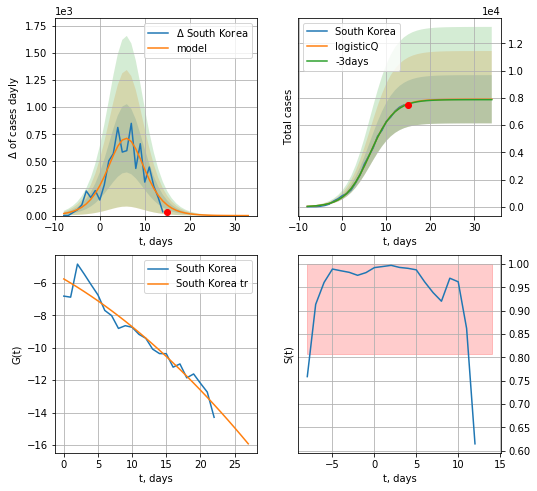

South Korea data at: 2020-05-04
+3 day model MAPE: 0.003444
model: logisticQ
coeffs: [ 7.90024888e+03  7.99722084e-05  6.33808286e+00 -4.52403663e+03]
rational stdev: 0.223765
forecast at the end of period: +19 days
	 deltaDaycases: 0
	 total cases: 7899 ± 1767
	 total death: 185 ± 124
trend coefficient of determination: 0.939645
 intercept_: -5.742054822567119
 coeffs_: [ 0.         -0.24685696 -0.00483449]


/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:288: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


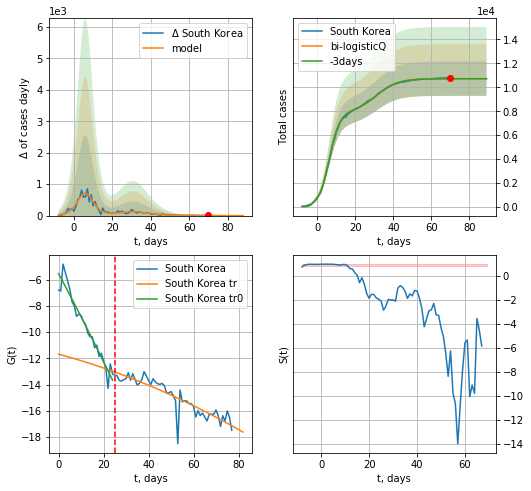

South Korea data at: 2020-05-04
+3 day model MAPE: 0.001301
model: bi-logisticQ
coeffs: [ 2.82635744e+03  1.75141676e-06  3.11588082e+01 -1.01674807e+05]
rational stdev: 0.134324
forecast at the end of period: +19 days
	 deltaDaycases: 0
	 total cases: 10726 ± 1440
	 total death: 252 ± 101
bi-logisticQ approximation splitting point: 25
trend coefficient of determination: 0.936575
 intercept_: -5.550309986859278
 coeffs_: [ 0.         -0.32029791 -0.00074495]
trend coefficient of determination: 0.789631
 intercept_: -11.68453872743249
 coeffs_: [ 0.         -0.04628202 -0.0003182 ]


In [595]:
vL=25
x = forecastRRR('South Korea',dfKR[1:vL],d1,8*7-dT,1.0)
xx=forecast2RRR('South Korea',dfKR[1:],d1,8*7-dT,x,1.0,vL=vL)

/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:15: RuntimeWarning: overflow encountered in exp
  from ipykernel import kernelapp as app
/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:15: RuntimeWarning: overflow encountered in power
  from ipykernel import kernelapp as app
/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1200.
  warnings.warn(errors[info][0], RuntimeWarning)


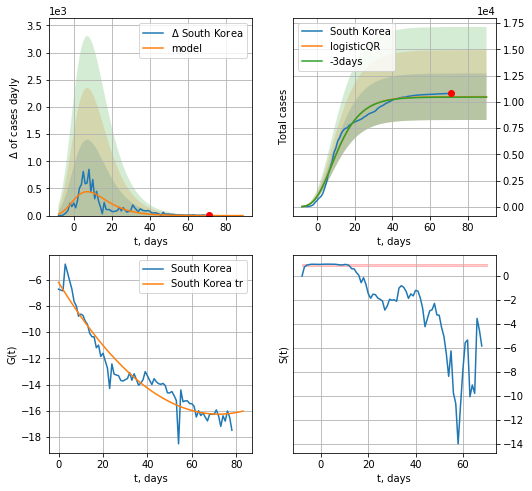

South Korea data at: 2020-05-04
+3 day model MAPE: 0.003533944167491422
model: logisticQR
coeffs:  [ 1.04883077e+04  1.55072467e-01 -6.50943089e+01 -2.13709162e+03
  3.31804348e-04]
rational stdev:  0.21123192221395506
forecast at the end of period: +19 days
	 deltaDaycases:  0
	 total cases:  10487 ± 2215
	 total death:  246 ± 155
trend coefficient of determination: 0.925162
 intercept_: -6.210610907844126
 coeffs_: [ 0.         -0.27869007  0.00193414]


In [596]:
x = forecastQR('South Korea',dfKR[:],d1,8*7-dT,1.0)

SG
           date  cases  active  death
98  2020-04-30  16169   14910   15.0
99  2020-05-01  17101   15817   16.0
100 2020-05-02  17548   16184   17.0
101 2020-05-03  18205   16779   18.0
102 2020-05-04  18778   17303   18.0


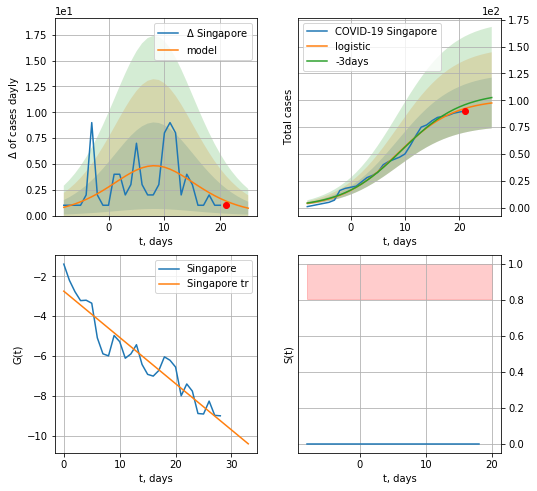

Singapore data at: 2020-05-04
+3 day model MAPE: 0.03963437966370839
model: logistic
coeffs:  [101.02990869   0.19128696   8.67555654]
rational stdev:  0.24212715882466435
forecast at the end of period: +5 days
	 deltaDaycases:  0
	 total cases:  97 ± 23
	 total death:  0 ± 0
trend coefficient of determination: 0.887345
 intercept: -2.744831
 slope: -0.232145


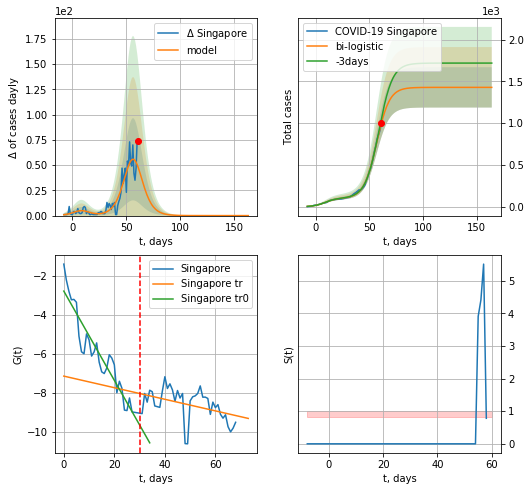

Singapore data at: 2020-05-04
+3 day model MAPE: 0.06119828055586902
model: bi-logistic
coeffs:  [1.32695355e+03 1.68329223e-01 5.66911530e+01] [101.02990869   0.19128696   8.67555654]
rational stdev:  0.16894112354758975
forecast at the end of period: +103 days
	 deltaDaycases:  0
	 total cases:  1427 ± 241
	 total death:  1 ± 0
bi-logistic approximation splitting point: 30
trend0 coefficient of determination: 0.893525
 intercept: -2.772249
 slope: -0.229208
trend coefficient of determination: 0.177815
 intercept: -7.138791
 slope: -0.029776


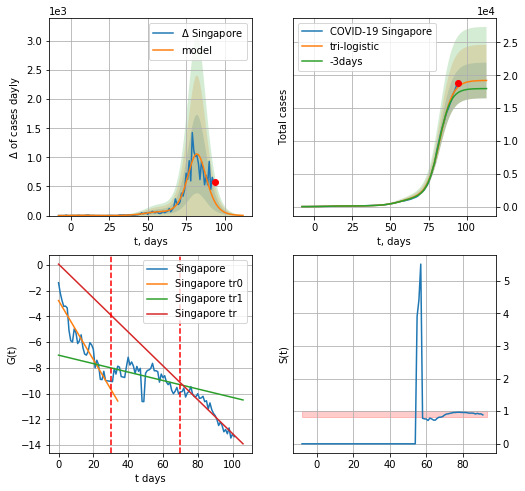

Singapore data at: 2020-05-04
+3 day model MAPE: 0.051593127374937583
model: tri-logistic
coeffs:  [1.77873075e+04 2.37892106e-01 8.25165204e+01] [1.01029909e+02 1.91286963e-01 8.67555654e+00 1.32695355e+03
 1.68329223e-01 5.66911530e+01]
forecast rational stdev:  0.1415044758700431
forecast at the end of period: +19 days
	 deltaDaycases:  3
	 total cases:  19202 ± 2717
	 total death:  18 ± 7
tri-logistic approximation splitting points: 30,70
trend0 coefficient of determination: 0.893525
 intercept: -2.772249
 slope: -0.229208
trend1 coefficient of determination: 0.215531
 intercept: -7.009854
 slope: -0.032798
trend coefficient of determination: 0.912292
 intercept: 0.058642
 slope: -0.131603


In [597]:
vL = 30
vL1 = 70
dfSG = read_df(pd.DataFrame(),"SG")
x = forecast('Singapore',dfSG[:vL],d1,6*7-dT,1.0)
xx = forecast2('Singapore',dfSG[:vL1],d1,20*7-dT,x,1.0,vL=vL)
xx = np.concatenate((x, xx), axis=0)
xxx = forecast3("Singapore",dfSG,d1,8*7-dT, xx, shift=1.,addpred=False,xcoef=[.25,1.,2.0],vL=[vL,vL1])

/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


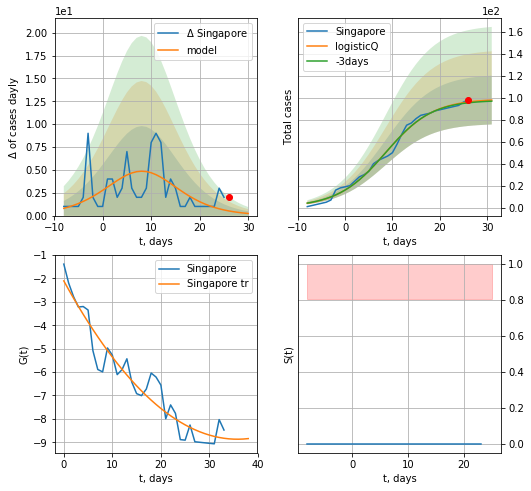

Singapore data at: 2020-05-04
+3 day model MAPE: 0.008158
model: logisticQ
coeffs: [ 9.88556757e+01  2.70682558e-04  8.43151542e+00 -7.17677228e+02]
rational stdev: 0.226599
forecast at the end of period: +5 days
	 deltaDaycases: 0
	 total cases: 97 ± 22
	 total death: 0 ± 0
trend coefficient of determination: 0.918167
 intercept_: -2.103369555726971
 coeffs_: [ 0.         -0.37832792  0.00528917]


/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:288: RuntimeWarning: overflow encountered in exp


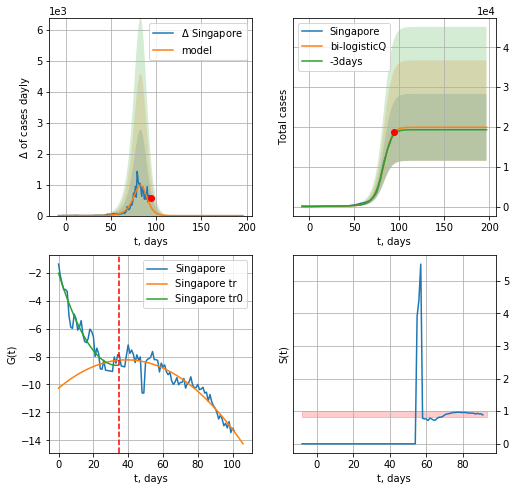

Singapore data at: 2020-05-04
+3 day model MAPE: 0.021790
model: bi-logisticQ
coeffs: [ 1.98027596e+04  1.53757682e-03  8.22921294e+01 -4.57967006e+01]
S.Korea scenario coeffs: [0.35, 0.5, 4.0, 1.0]
rational stdev: 0.422168
forecast at the end of period: +103 days
	 deltaDaycases: 0
	 total cases: 19901 ± 8401
	 total death: 19 ± 24
bi-logisticQ approximation splitting point: 35
trend coefficient of determination: 0.914568
 intercept_: -2.036640634366525
 coeffs_: [ 0.         -0.39517788  0.00592335]
trend coefficient of determination: 0.889529
 intercept_: -10.267052536710436
 coeffs_: [ 0.          0.10413853 -0.00133667]


In [598]:
vL = 35
x = forecastRRR('Singapore',dfSG[:vL],d1,6*7-dT,1.0)
xx = forecast2RRR('Singapore',dfSG[:],d1,20*7-dT,x,1.0,addpred=True,xcoef=[0.35,.5,4.,1.],vL=vL)

In [599]:
#vL = 31
#x = forecast('Singapore',dfSG[:vL],d1,6*7-dT,1.0)
#xx = forecast2('Singapore',dfSG[:],d1,12*7-dT,x,1.0,addpred=True,xcoef=[0.25,1.,1.8],vL=vL)

/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:18: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:18: RuntimeWarning: divide by zero encountered in true_divide


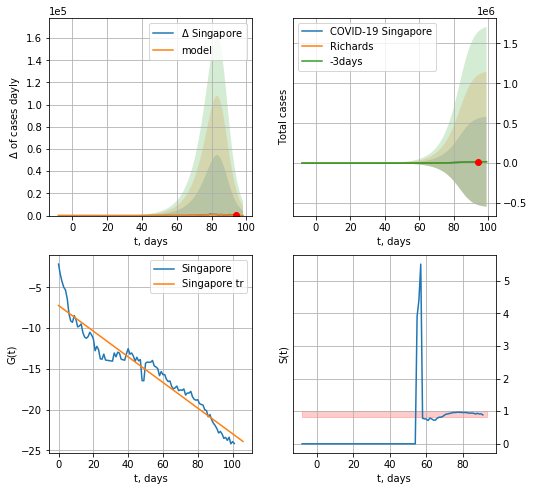

Singapore data at: 2020-05-04
+3 day model MAPE: 0.079672
model: Richards
coeffs: [1.92488606e+04 1.32719687e-01 8.62620719e+01 2.09945174e+00]
rational stdev: 29.592470
forecast at the end of period: +5 days
	 deltaDaycases: 80
	 total cases: 18990 ± 561983
	 total death: 18 ± 1597
trend coefficient of determination: 0.920118
 intercept: -7.225465
 slope: -0.157299


In [600]:
x = forecastRR('Singapore',dfSG[:],d1,6*7-dT,1.0)
#xx = forecast2R('Singapore',dfSG[:],d1,28*7-dT,x,1.0)

In [162]:
#trend3(dfLT,dfES,dfLV[:],'LT','ES','LV',40,40,40)
#x = forecastRRR('Singapore',dfSG[35:],d1,6*7-dT,1.0)

In [163]:
#+1932/2944.#2020-04-03
#shift = 1.0#1+1849/1900.#2020-04-02
#shift = 1.+3288./2809
#x =forecast('Lithuania',dfLT[:],d1,8*7-dT,shift,addpred=True,xcoef=[0.25,1.,3.])
#xx =forecast2('Lithuania',dfLT[:],d1,3*7-dT,x)

In [164]:
#x =forecastR('Lithuania',dfLT[:],d1,7*6-dT,shift)

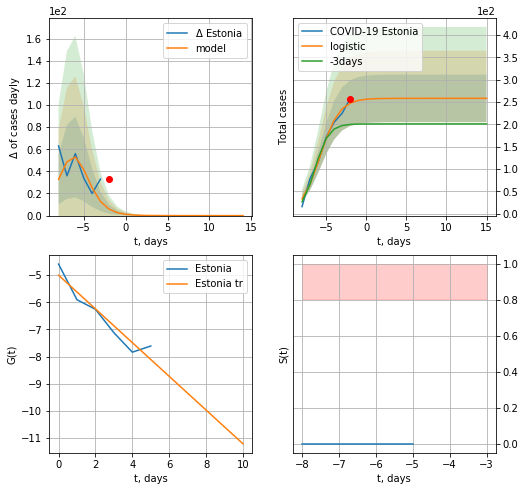

Estonia data at: 2020-05-04
+3 day model MAPE: 0.26329059885154926
model: logistic
coeffs:  [258.51169182   0.83984365  -5.73516243]
rational stdev:  0.20630354623999803
forecast at the end of period: +17 days
	 deltaDaycases:  0
	 total cases:  258 ± 53
	 total death:  8 ± 4
trend coefficient of determination: 0.908255
 intercept: -5.002820
 slope: -0.620580


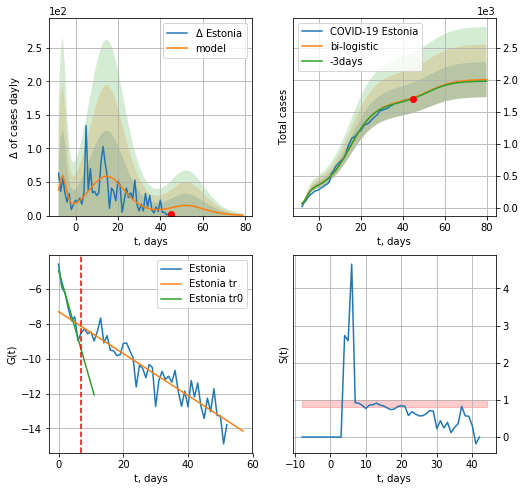

Estonia data at: 2020-05-04
+3 day model MAPE: 0.006832019874209023
model: bi-logistic
coeffs:  [1.40193373e+03 1.67463499e-01 1.51322187e+01] [258.51169182   0.83984365  -5.73516243]
scenario coeffs:  [0.25, 1.0, 3.5]
rational stdev:  0.13726369305704902
forecast at the end of period: +35 days
	 deltaDaycases:  0
	 total cases:  2007 ± 275
	 total death:  64 ± 26
bi-logistic approximation splitting point: 7
trend0 coefficient of determination: 0.942621
 intercept: -4.958003
 slope: -0.647470
trend coefficient of determination: 0.861482
 intercept: -7.315346
 slope: -0.119849


In [601]:
shift = 1.0
x = forecast('Estonia',dfES[:7],d1,17,1.)
xx = forecast2('Estonia',dfES[:],d1,12*6-dT,x,1.,addpred=True,xcoef=[0.25,1.,3.5],vL=7)

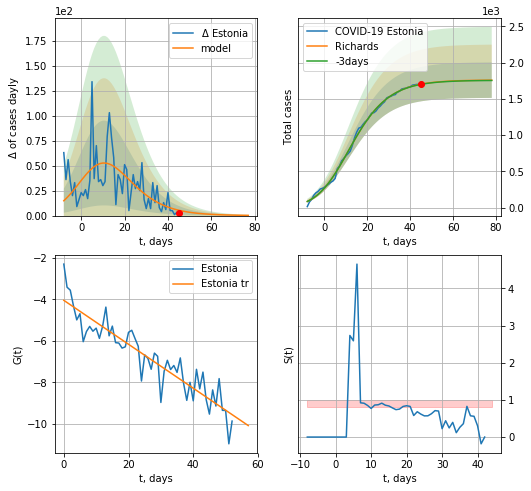

Estonia data at: 2020-05-04
+3 day model MAPE: 0.001690
model: Richards
coeffs: [1.75988285e+03 2.10738380e-01 3.54476219e+00 4.74335066e-01]
rational stdev: 0.139106
forecast at the end of period: +33 days
	 deltaDaycases: 0
	 total cases: 1757 ± 244
	 total death: 56 ± 23
trend coefficient of determination: 0.842605
 intercept: -4.045204
 slope: -0.105995


In [602]:
x = forecastRR('Estonia',dfES[:],d1,7*10-dT,1.)
#x = forecastQR('Estonia',dfES[10:],d1,7*10-dT,1.)
#xx = forecast2R('Estonia',dfES[:],d1,7*5-dT,x,1.)

/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:153: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


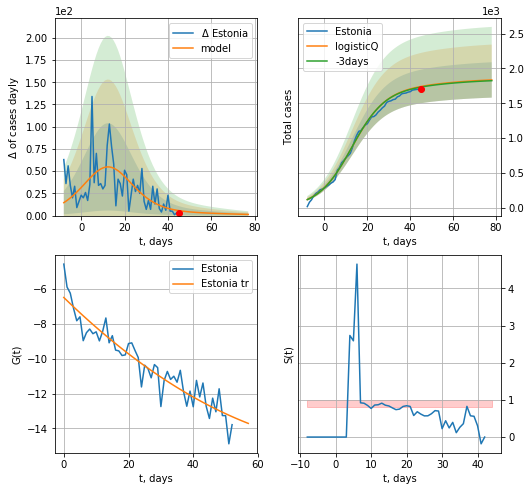

Estonia data at: 2020-05-04
+3 day model MAPE: 0.005017
model: logisticQ
coeffs: [ 1.70876963e+03  2.52318236e-06  1.27734294e+01 -5.01875792e+04]
S.Korea scenario coeffs: [0.0875, 0.5, 4.0, 1]
rational stdev: 0.138358
forecast at the end of period: +33 days
	 deltaDaycases: 1
	 total cases: 1834 ± 253
	 total death: 59 ± 24
trend coefficient of determination: 0.887650
 intercept_: -6.505151430544258
 coeffs_: [ 0.         -0.1800094   0.00094096]


In [603]:
x = forecastRRR('Estonia',dfES[:],d1,7*10-dT,1.,addpred=True,xcoef=[0.35/4,.5,4.,1])

LV
          date  cases  active  death
54 2020-04-30  858.0     495   15.0
55 2020-05-01  870.0     506   16.0
56 2020-05-02  871.0     507   16.0
57 2020-05-03  879.0     515   16.0
58 2020-05-04  896.0     532   16.0


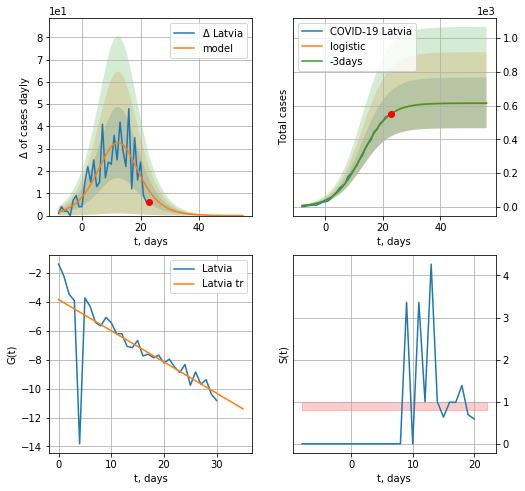

Latvia data at: 2020-05-04
+3 day model MAPE: 0.0032633377916749073
model: logistic
coeffs:  [6.16080291e+02 2.13516215e-01 1.27871959e+01]
rational stdev:  0.24373797630646024
forecast at the end of period: +33 days
	 deltaDaycases:  0
	 total cases:  616 ± 150
	 total death:  11 ± 8
trend coefficient of determination: 0.538666
 intercept: -3.837099
 slope: -0.216023


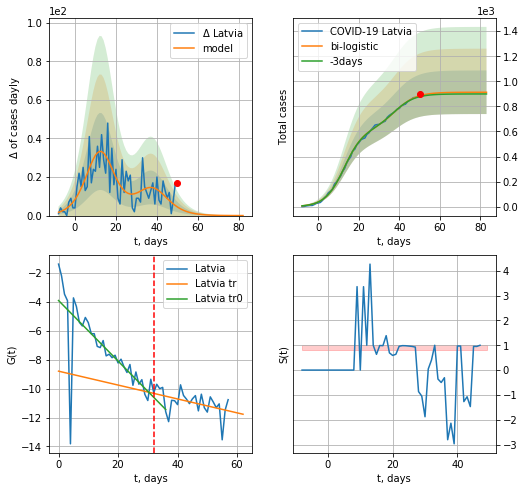

Latvia data at: 2020-05-04
+3 day model MAPE: 0.009370894329996701
model: bi-logistic
coeffs:  [2.96726496e+02 1.88654441e-01 3.79970520e+01] [6.16080291e+02 2.13516215e-01 1.27871959e+01]
rational stdev:  0.1902981479096572
forecast at the end of period: +33 days
	 deltaDaycases:  0
	 total cases:  912 ± 173
	 total death:  16 ± 9
bi-logistic approximation splitting point: 32
trend0 coefficient of determination: 0.543521
 intercept: -3.904452
 slope: -0.209287
trend coefficient of determination: 0.200478
 intercept: -8.790821
 slope: -0.048036


In [604]:
vL=32
dfLV = read_df(pd.DataFrame(),"LV")
x = forecast('Latvia',dfLV[:vL],d1,10*7-dT,1.)
xx=forecast2('Latvia',dfLV[:],d1,10*7-dT,x,1.,addpred=False,xcoef=[0.25,1.,3.],vL=vL)

/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


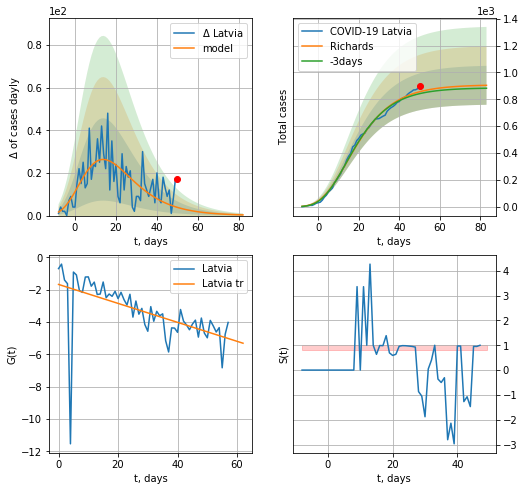

Latvia data at: 2020-05-04
+3 day model MAPE: 0.017238
model: Richards
coeffs: [ 9.08378031e+02  8.26960684e+00 -4.45165842e+01  9.57062727e-03]
rational stdev: 0.160344
forecast at the end of period: +33 days
	 deltaDaycases: 0
	 total cases: 904 ± 145
	 total death: 16 ± 7
trend coefficient of determination: 0.315137
 intercept: -1.679170
 slope: -0.058631


/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:15: RuntimeWarning: overflow encountered in exp
  from ipykernel import kernelapp as app
/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:15: RuntimeWarning: overflow encountered in power
  from ipykernel import kernelapp as app
/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1200.
  warnings.warn(errors[info][0], RuntimeWarning)


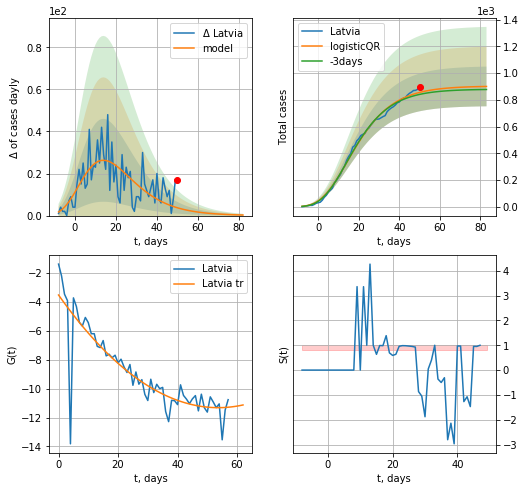

Latvia data at: 2020-05-04
+3 day model MAPE: 0.018056873704357886
model: logisticQR
coeffs:  [ 9.03213647e+02  4.65023304e-02 -7.66670123e+01 -1.33267460e+03
  1.18502841e-03]
rational stdev:  0.16500634436457115
forecast at the end of period: +33 days
	 deltaDaycases:  0
	 total cases:  900 ± 148
	 total death:  16 ± 7
trend coefficient of determination: 0.743096
 intercept_: -3.523642027031876
 coeffs_: [ 0.         -0.29028393  0.00270374]


In [605]:
x = forecastRR('Latvia',dfLV[:],d1,7*10-dT,1.)
x = forecastQR('Latvia',dfLV[:],d1,7*10-dT,1.)
#xx=forecast2R('Latvia',dfLV[:],d1,10*7-dT,x)

/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:153: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


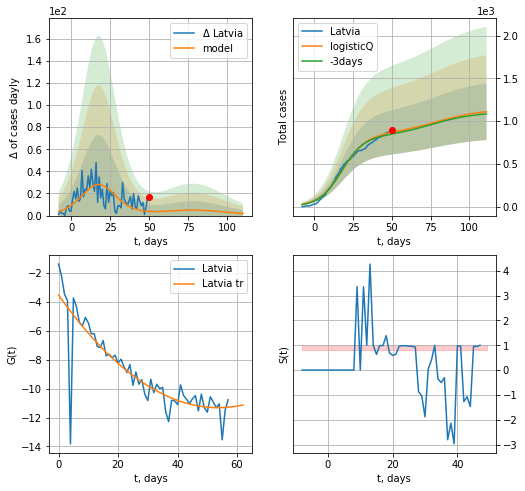

Latvia data at: 2020-05-04
+3 day model MAPE: 0.022842
model: logisticQ
coeffs: [ 8.42870727e+02  7.38741173e-07  1.80367360e+01 -1.78624895e+05]
S.Korea scenario coeffs: [0.35416971, 0.02606324, 4.35859408, 19.30413219]
rational stdev: 0.297975
forecast at the end of period: +61 days
	 deltaDaycases: 1
	 total cases: 1110 ± 330
	 total death: 19 ± 16
trend coefficient of determination: 0.743096
 intercept_: -3.523642027031876
 coeffs_: [ 0.         -0.29028393  0.00270374]


In [606]:
#trend3(dfCA[12:],dfPT,dfTR[4:],'CA','PT','TR',40,40,40)
x = forecastRRR('Latvia',dfLV[:],d1,7*14-dT,1.,addpred=True,xcoef=koreaCoeffs)

/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 800.
  warnings.warn(errors[info][0], RuntimeWarning)


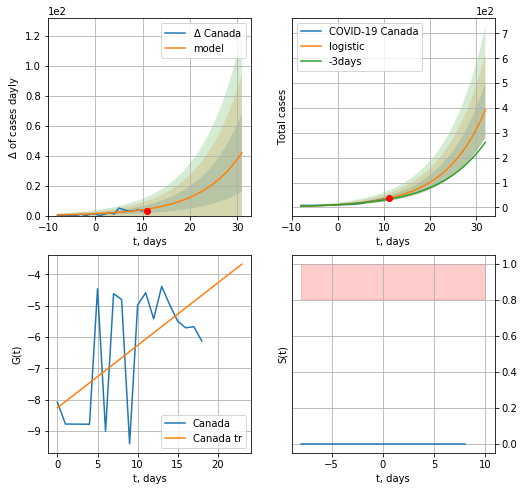

Canada data at: 2020-05-04
+3 day model MAPE: 0.14132705134128837
model: logistic
coeffs:  [1.25340432e+05 1.13222117e-01 8.29016731e+01]
rational stdev:  0.2833741000964234
forecast at the end of period: +21 days
	 deltaDaycases:  41
	 total cases:  392 ± 111
	 total death:  24 ± 20
trend coefficient of determination: 0.348503
 intercept: -8.254919
 slope: 0.199271


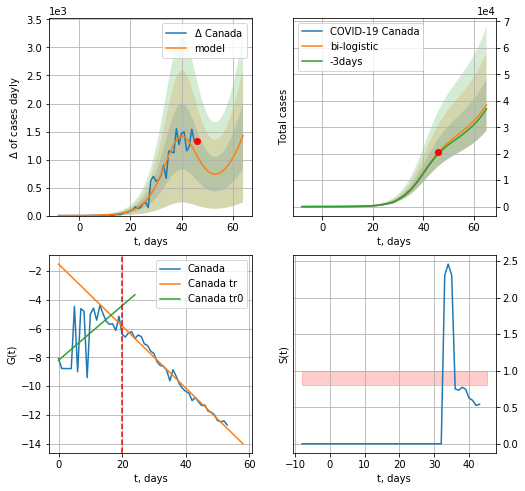

Canada data at: 2020-05-04
+3 day model MAPE: 0.02936701556145869
model: bi-logistic
coeffs:  [2.40154010e+04 2.16961372e-01 4.02658693e+01] [1.25340432e+05 1.13222117e-01 8.29016731e+01]
rational stdev:  0.2549294046309869
forecast at the end of period: +19 days
	 deltaDaycases:  1424
	 total cases:  38494 ± 9813
	 total death:  2441 ± 1866
bi-logistic approximation splitting point: 20
trend0 coefficient of determination: 0.359029
 intercept: -8.196978
 slope: 0.189614
trend coefficient of determination: 0.982767
 intercept: -1.518979
 slope: -0.215271


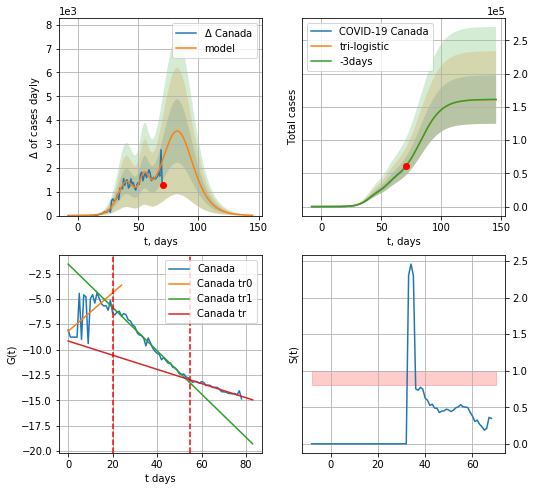

Canada data at: 2020-05-04
+3 day model MAPE: 0.0029733788847107695
model: tri-logistic
coeffs:  [1.16738891e+04 3.64391486e-01 5.56403342e+01] [1.25340432e+05 1.13222117e-01 8.29016731e+01 2.40154010e+04
 2.16961372e-01 4.02658693e+01]
forecast rational stdev:  0.22638820643808724
forecast at the end of period: +75 days
	 deltaDaycases:  11
	 total cases:  160930 ± 36432
	 total death:  10205 ± 6930
tri-logistic approximation splitting points: 20,55
trend0 coefficient of determination: 0.359029
 intercept: -8.196978
 slope: 0.189614
trend1 coefficient of determination: 0.983223
 intercept: -1.572806
 slope: -0.213535
trend coefficient of determination: 0.918932
 intercept: -9.157419
 slope: -0.069875


In [607]:
vL=20
vL1=55
x = forecast('Canada',dfCA[:vL],d1,3*7,1.)
xx=forecast2('Canada',dfCA[:vL1],d1,8*7-dT,x,1.,vL=vL)#,addpred=True,xcoef=[0.25,1.,2.]
xx = np.concatenate((x, xx), axis=0)
xxx = forecast3("Canada",dfCA[:],d1,16*7-dT, xx, shift=1.,addpred=False,xcoef=[.25,1.,2.0],vL=[vL,vL1])

CA
          date    cases  active   death
75 2020-04-30  53236.0   28629  3184.0
76 2020-05-01  55061.0   28919  3391.0
77 2020-05-02  56714.0   29347  3566.0
78 2020-05-03  59474.0   30884  3682.0
79 2020-05-04  60772.0   30901  3854.0


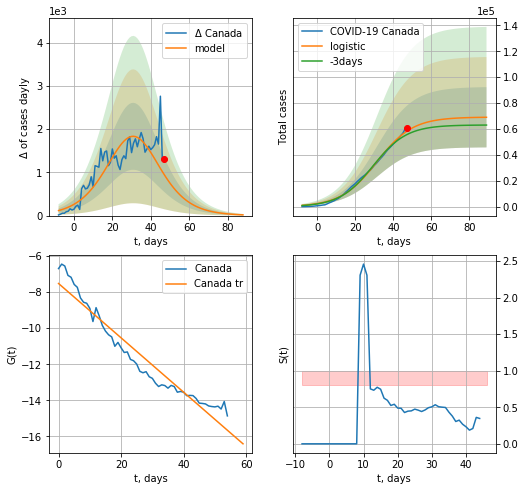

Canada data at: 2020-05-04
+3 day model MAPE: 0.050094465923198724
model: logistic
coeffs:  [6.92137370e+04 1.05988234e-01 3.13061922e+01]
rational stdev:  0.3367851348870592
forecast at the end of period: +42 days
	 deltaDaycases:  17
	 total cases:  69061 ± 23258
	 total death:  4379 ± 4424
trend coefficient of determination: 0.933145
 intercept: -7.520930
 slope: -0.150661


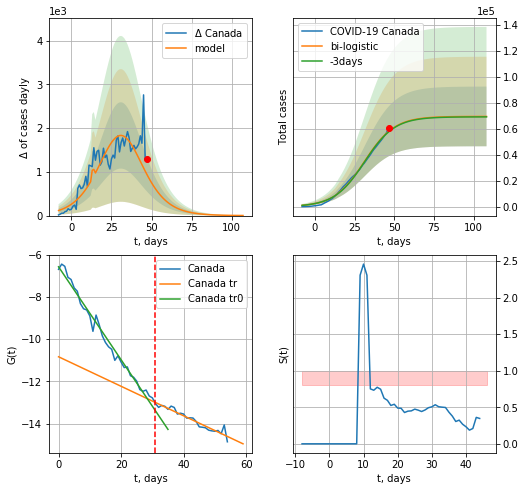

Canada data at: 2020-05-04
+3 day model MAPE: 0.0059072802906815994
model: bi-logistic
coeffs:  [349.3245885   13.41218408  13.9800199 ] [6.92137370e+04 1.05988234e-01 3.13061922e+01]
rational stdev:  0.3304944374768272
forecast at the end of period: +61 days
	 deltaDaycases:  2
	 total cases:  69542 ± 22983
	 total death:  4410 ± 4372
bi-logistic approximation splitting point: 31
trend0 coefficient of determination: 0.983688
 intercept: -6.573152
 slope: -0.220036
trend coefficient of determination: 0.918932
 intercept: -10.834424
 slope: -0.069875


In [610]:
dfCA = read_df(pd.DataFrame(),"CA")
x = forecast('Canada',dfCA[24:],d1,6*7,1.,cases='cases')
xx=forecast2('Canada',dfCA[24:],d1,14*7-dT,x,1.,vL=31,cases='cases')

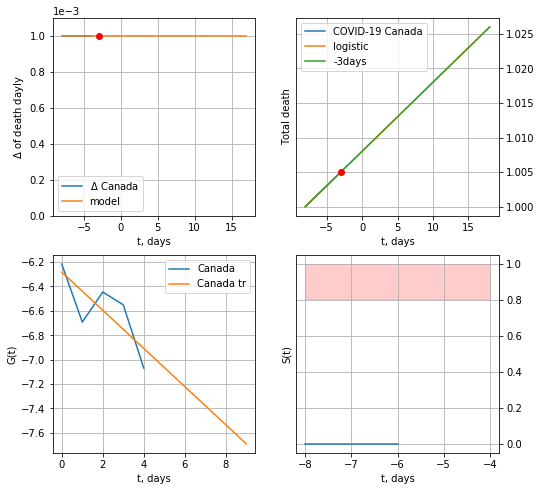

Canada data at: 2020-05-04
+3 day model MAPE: 5.06934136593531e-07
model: logistic
coeffs:  [2.01698683e+00 1.98322956e-03 4.93279263e-01]
rational stdev:  1.4705534785239981e-08
forecast at the end of period: +21 days
	 total death:  1 ± 0
trend coefficient of determination: 0.608158
 intercept: -6.282802
 slope: -0.156326


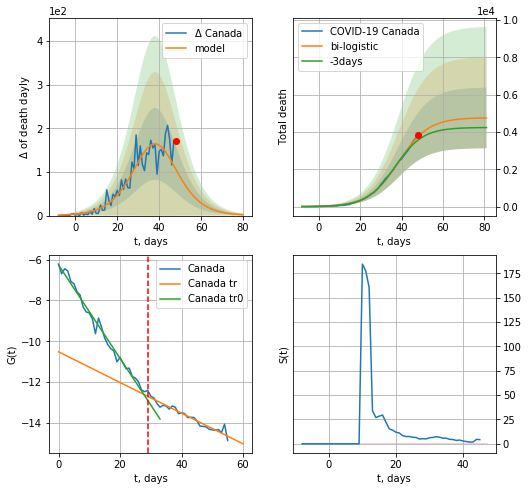

Canada data at: 2020-05-04
+3 day model MAPE: 0.05845127811899927
model: bi-logistic
coeffs:  [4.76676736e+03 1.38206714e-01 3.85305414e+01] [2.01698683e+00 1.98322956e-03 4.93279263e-01]
rational stdev:  0.34195437920027444
forecast at the end of period: +33 days
	 deltaDaydeath:  1
	 total death:  4754 ± 1625
bi-logistic approximation splitting point: 29
trend0 coefficient of determination: 0.986075
 intercept: -6.260314
 slope: -0.228750
trend coefficient of determination: 0.936414
 intercept: -10.516574
 slope: -0.075160


In [611]:
vL=29
vL1=50
x = forecast('Canada',dfCA[23:vL],d1,3*7,1.,cases='death')
xx=forecast2('Canada',dfCA[23:],d1,10*7-dT,x,1.,vL=vL,cases='death')#,addpred=True,xcoef=[0.25,1.,2.]
#xx = np.concatenate((x, xx), axis=0)
#xxx = forecast3("Canada",dfCA[24:],d1,16*7-dT, xx, shift=1.,addpred=False,xcoef=[.25,1.,2.0],vL=[vL,vL1],cases='death')

/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:18: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:18: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


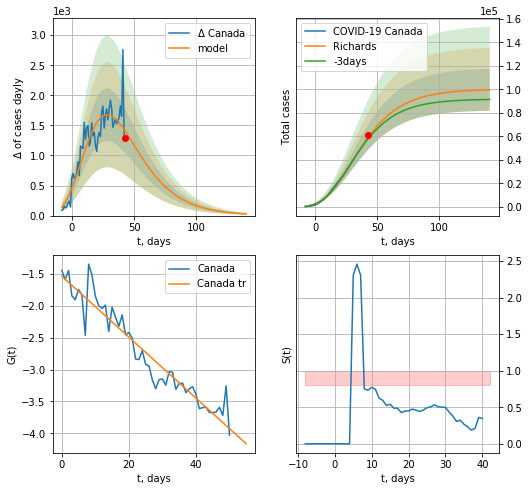

Canada data at: 2020-05-04
+3 day model MAPE: 0.023504
model: Richards
coeffs: [ 1.00167957e+05  2.70467675e+00 -5.98273643e+01  1.69820388e-02]
rational stdev: 0.178963
forecast at the end of period: +98 days
	 deltaDaycases: 27
	 total cases: 99587 ± 17822
	 total death: 6315 ± 3390
trend coefficient of determination: 0.914853
 intercept: -1.533425
 slope: -0.047869


/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:15: RuntimeWarning: overflow encountered in power
  from ipykernel import kernelapp as app
/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1200.
  warnings.warn(errors[info][0], RuntimeWarning)


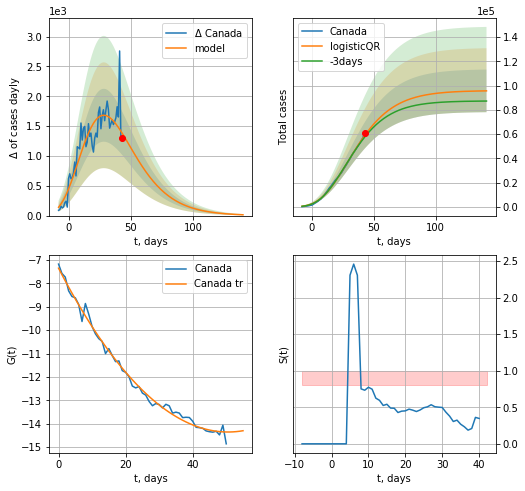

Canada data at: 2020-05-04
+3 day model MAPE: 0.025082974100954707
model: logisticQR
coeffs:  [ 9.58766782e+04  1.04622140e-02 -1.01526956e+02 -7.94063505e+02
  4.80020364e-03]
rational stdev:  0.18372728806670865
forecast at the end of period: +98 days
	 deltaDaycases:  13
	 total cases:  95650 ± 17573
	 total death:  6065 ± 3342
trend coefficient of determination: 0.992007
 intercept_: -7.34923928819879
 coeffs_: [ 0.         -0.27734285  0.00274432]


In [612]:
x = forecastRR('Canada',dfCA[28:],d1,14*7,1.)
x = forecastQR('Canada',dfCA[28:],d1,14*7,1.)

/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:153: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


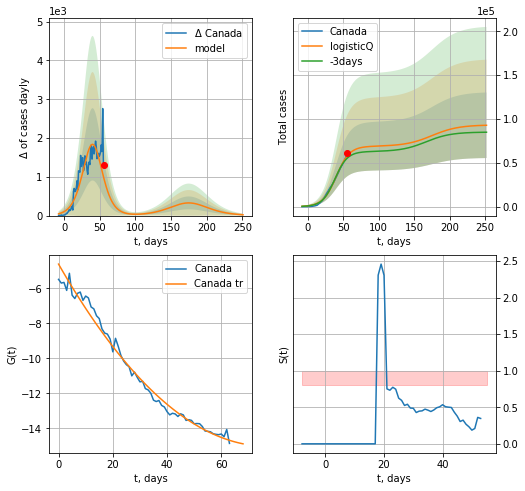

Canada data at: 2020-05-04
+3 day model MAPE: 0.050557
model: logisticQ
coeffs: [ 6.88675959e+04  1.52302995e-06  4.01923199e+01 -7.00261060e+04]
S.Korea scenario coeffs: [0.35416971, 0.02606324, 4.35859408, 19.30413219]
rational stdev: 0.402888
forecast at the end of period: +196 days
	 deltaDaycases: 21
	 total cases: 92869 ± 37416
	 total death: 5889 ± 7117
trend coefficient of determination: 0.985479
 intercept_: -4.621433972937829
 coeffs_: [ 0.         -0.2704661   0.00175789]


In [613]:
x = forecastRRR('Canada',dfCA[15:],d1,7*28,1.,addpred=True,xcoef=koreaCoeffs)

PT
          date  cases  active   death
59 2020-04-30  24686   22537   989.0
60 2020-05-01  24988   22697  1007.0
61 2020-05-02  25190   22496  1023.0
62 2020-05-03  25282   22550  1043.0
63 2020-05-04  25524   22749  1063.0


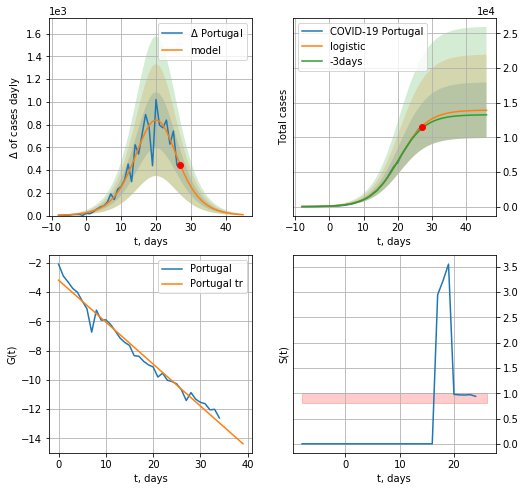

Portugal data at: 2020-05-04
+3 day model MAPE: 0.028768813359110825
model: logistic
coeffs:  [1.39435560e+04 2.41732854e-01 2.05234131e+01]
rational stdev:  0.2880659201380634
forecast at the end of period: +19 days
	 deltaDaycases:  8
	 total cases:  13914 ± 4008
	 total death:  579 ± 500
trend coefficient of determination: 0.976552
 intercept: -3.178197
 slope: -0.287215


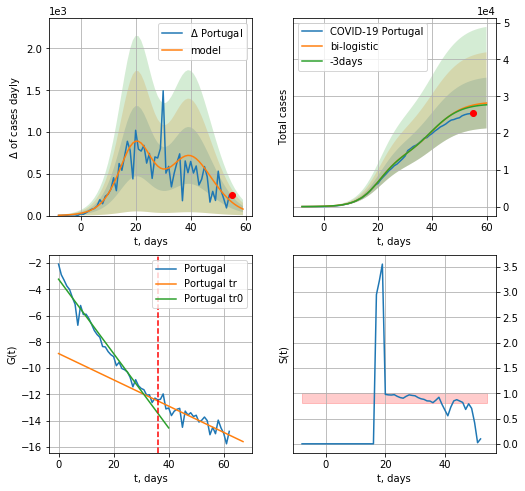

Portugal data at: 2020-05-04
+3 day model MAPE: 0.014323735442034323
model: bi-logistic
coeffs:  [1.16592759e+04 2.07108323e-01 3.93972325e+01] [1.39435560e+04 2.41732854e-01 2.05234131e+01]
scenario coeffs:  [0.25, 1.0, 1.2]
rational stdev:  0.2449248254080196
forecast at the end of period: +5 days
	 deltaDaycases:  77
	 total cases:  28160 ± 6897
	 total death:  1172 ± 861
bi-logistic approximation splitting point: 36
trend0 coefficient of determination: 0.975262
 intercept: -3.226992
 slope: -0.282910
trend coefficient of determination: 0.770244
 intercept: -8.884953
 slope: -0.100008


In [614]:
vL = 36
dfPT = read_df(pd.DataFrame(),"PT")
x = forecast('Portugal',dfPT[:vL],d1,8*7-dT,1.)
xx=forecast2('Portugal',dfPT[:],d1,6*7-dT,x,addpred=True,xcoef=[0.25,1.,1.2],vL=vL)

/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:18: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:18: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


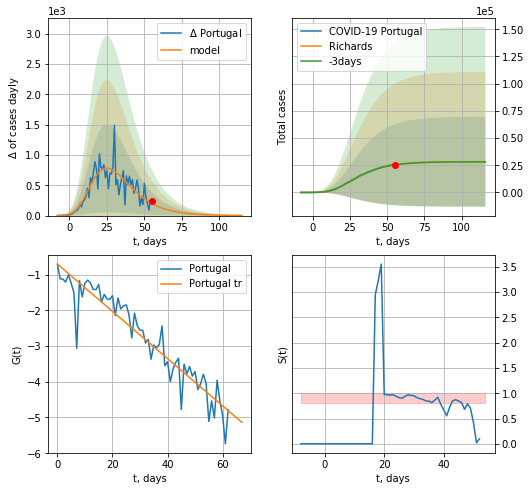

Portugal data at: 2020-05-04
+3 day model MAPE: 0.002932
model: Richards
coeffs: [ 2.83192243e+04  6.35909194e+00 -3.31147215e+01  1.18933881e-02]
rational stdev: 1.459855
forecast at the end of period: +61 days
	 deltaDaycases: 2
	 total cases: 28289 ± 41298
	 total death: 1178 ± 5159
trend coefficient of determination: 0.886666
 intercept: -0.706279
 slope: -0.066130


In [615]:
x = forecastRR('Portugal',dfPT[:],d1,14*7-dT,1.)

/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:153: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


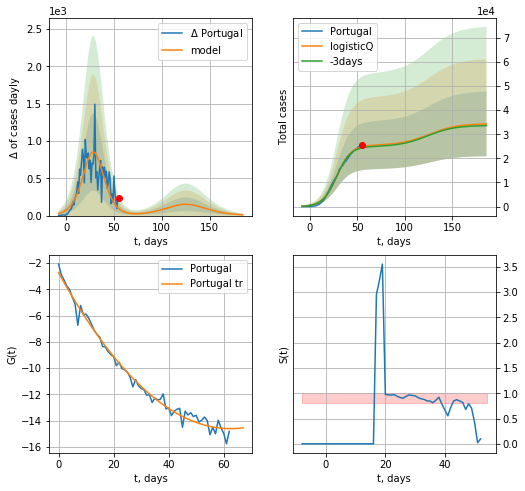

Portugal data at: 2020-05-04
+3 day model MAPE: 0.017973
model: logisticQ
coeffs: [ 2.54139414e+04  1.16318084e-06  2.87958294e+01 -1.15365867e+05]
S.Korea scenario coeffs: [0.35416971, 0.02606324, 4.35859408, 19.30413219]
rational stdev: 0.391138
forecast at the end of period: +131 days
	 deltaDaycases: 10
	 total cases: 34265 ± 13402
	 total death: 1427 ± 1674
trend coefficient of determination: 0.987095
 intercept_: -2.7298049072862254
 coeffs_: [ 0.         -0.37999566  0.00304147]


In [616]:
x = forecastRRR('Portugal',dfPT[:],d1,24*7-dT,1.,addpred=True,xcoef=koreaCoeffs)

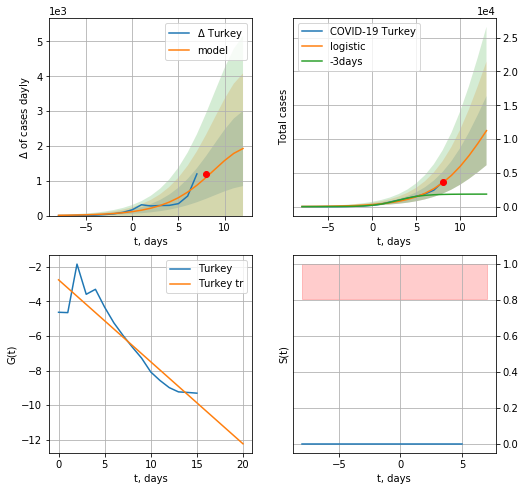

Turkey data at: 2020-05-04
+3 day model MAPE: 1.5246814929812549
model: logistic
coeffs:  [2.42672036e+04 3.25610640e-01 1.34529779e+01]
rational stdev:  0.45520286558776807
forecast at the end of period: +5 days
	 deltaDaycases:  1924
	 total cases:  11240 ± 5116
	 total death:  304 ± 415
trend coefficient of determination: 0.850665
 intercept: -2.746555
 slope: -0.474541


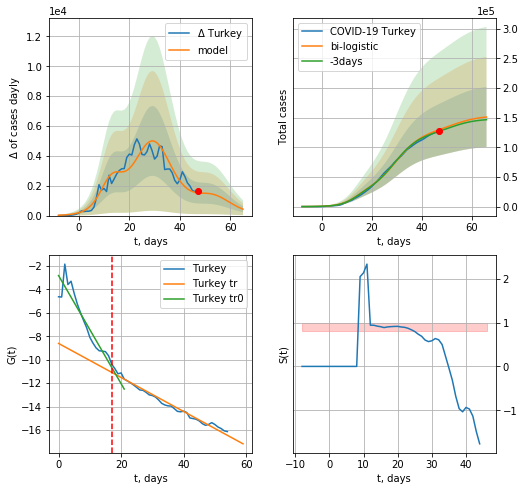

Turkey data at: 2020-05-04
+3 day model MAPE: 0.021592086753967142
model: bi-logistic
coeffs:  [1.03223109e+05 1.90590485e-01 2.96784540e+01] [2.42672036e+04 3.25610640e-01 1.34529779e+01]
scenario coeffs:  [0.25, 1.0, 1.8]
rational stdev:  0.33551073585578106
forecast at the end of period: +19 days
	 deltaDaycases:  428
	 total cases:  151043 ± 50676
	 total death:  4094 ± 4120
bi-logistic approximation splitting point: 17
trend0 coefficient of determination: 0.862807
 intercept: -2.813054
 slope: -0.461241
trend coefficient of determination: 0.977885
 intercept: -8.605902
 slope: -0.145199


In [617]:
vL=17
x = forecast('Turkey',dfTR[:vL],d1,6*7-dT,1.)
xx=forecast2('Turkey',dfTR[:],d1,8*7-dT,x,1.,addpred=True,xcoef=[0.25,1.,1.8],vL=vL)

/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:18: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:18: RuntimeWarning: divide by zero encountered in true_divide


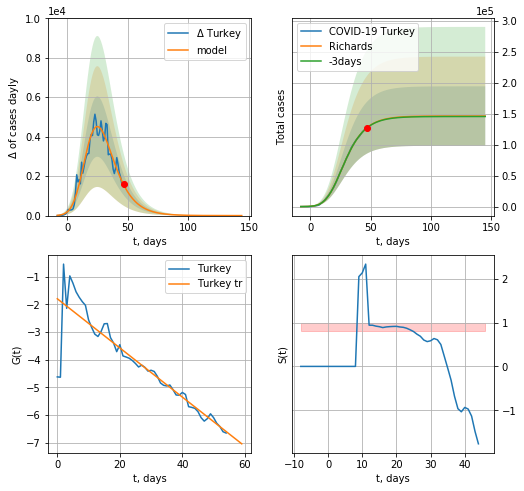

Turkey data at: 2020-05-04
+3 day model MAPE: 0.001921
model: Richards
coeffs: [1.46269367e+05 4.74511157e-01 7.63781917e+00 1.93695466e-01]
rational stdev: 0.328050
forecast at the end of period: +98 days
	 deltaDaycases: 0
	 total cases: 146266 ± 47982
	 total death: 3965 ± 3902
trend coefficient of determination: 0.827142
 intercept: -1.792437
 slope: -0.088888


/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:15: RuntimeWarning: overflow encountered in exp
  from ipykernel import kernelapp as app
/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:15: RuntimeWarning: divide by zero encountered in true_divide
  from ipykernel import kernelapp as app
/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:15: RuntimeWarning: overflow encountered in power
  from ipykernel import kernelapp as app


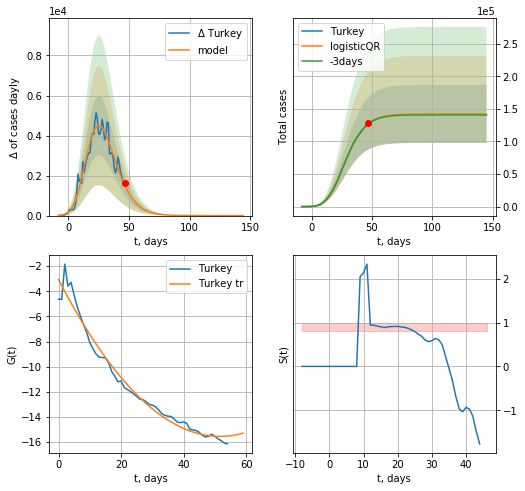

Turkey data at: 2020-05-04
+3 day model MAPE: 0.004119497931593112
model: logisticQR
coeffs:  [ 1.42344907e+05  2.67334227e-02 -7.03285528e+01 -7.05834033e+01
  1.70037938e-02]
rational stdev:  0.312967411551311
forecast at the end of period: +98 days
	 deltaDaycases:  0
	 total cases:  142344 ± 44549
	 total death:  3859 ± 3623
trend coefficient of determination: 0.976057
 intercept_: -3.0619220252876573
 coeffs_: [ 0.         -0.48306631  0.00467631]


In [618]:
x = forecastRR('Turkey',dfTR[:],d1,14*7,1.,addpred=False,xcoef=[0.35,.5,3,1])
x = forecastQR('Turkey',dfTR[:],d1,14*7,1.,addpred=False,xcoef=[0.35,.5,3,1])

/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:153: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


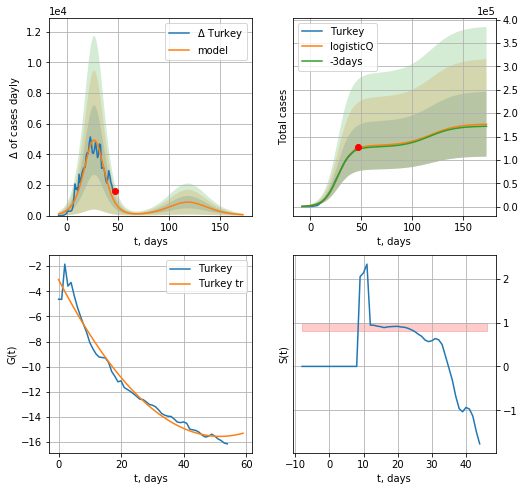

Turkey data at: 2020-05-04
+3 day model MAPE: 0.019766
model: logisticQ
coeffs: [ 1.30703624e+05  2.51182125e-06  2.72026661e+01 -6.00143206e+04]
S.Korea scenario coeffs: [0.35416971, 0.02606324, 4.35859408, 19.30413219]
rational stdev: 0.393789
forecast at the end of period: +126 days
	 deltaDaycases: 56
	 total cases: 176261 ± 69409
	 total death: 4778 ± 5644
trend coefficient of determination: 0.976057
 intercept_: -3.0619220252876573
 coeffs_: [ 0.         -0.48306631  0.00467631]


In [619]:
x = forecastRRR('Turkey',dfTR[:],d1,18*7,1.,addpred=True,xcoef=koreaCoeffs)

#xx=forecast2R('Turkey',dfTR[:],d1,14*7-dT,x,1.)

In [620]:
dfTT[dfTT.Country=='%s'%("Latvia")][0].values[0]

0.017857142857142856

In [621]:
#trend3(dfPL[1:],dfIS[7:],dfSW,'PL','IS','SW',40,40,40)

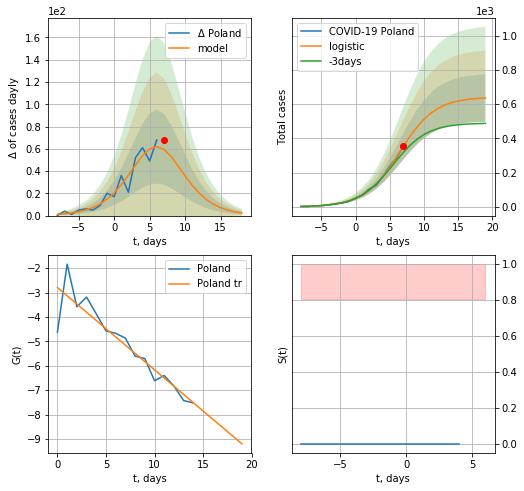

Poland data at: 2020-05-04
+3 day model MAPE: 0.14646234511665837
model: logistic
coeffs:  [6.41107567e+02 3.87606719e-01 6.46563498e+00]
rational stdev:  0.21770687952847212
forecast at the end of period: +12 days
	 deltaDaycases:  2
	 total cases:  636 ± 138
	 total death:  31 ± 20
trend coefficient of determination: 0.843228
 intercept: -2.795749
 slope: -0.337043


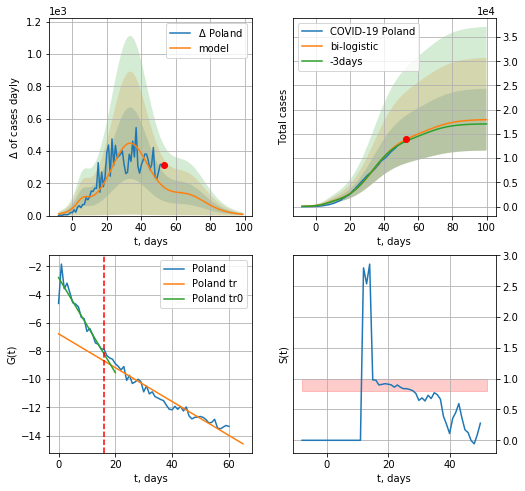

Poland data at: 2020-05-04
+3 day model MAPE: 0.029367678039605355
model: bi-logistic
coeffs:  [1.38915578e+04 1.27653951e-01 3.38511772e+01] [6.41107567e+02 3.87606719e-01 6.46563498e+00]
scenario coeffs:  [0.25, 1.0, 2.0]
rational stdev:  0.3554502994918309
forecast at the end of period: +47 days
	 deltaDaycases:  7
	 total cases:  17947 ± 6379
	 total death:  894 ± 953
bi-logistic approximation splitting point: 16
trend0 coefficient of determination: 0.867285
 intercept: -2.795308
 slope: -0.337138
trend coefficient of determination: 0.949016
 intercept: -6.782051
 slope: -0.120087


In [622]:
vL=16
vL1=38
x =  forecast('Poland',dfPL[:vL],d1,7*7-dT,1.)
xx = forecast2('Poland',dfPL[:],d1,12*7-dT,x,1.,vL=vL,addpred=True,xcoef=[0.25,1.,2.])
#xx = np.concatenate((x, xx), axis=0)
#xxx = forecast3("Poland",dfPL,d1,8*7-dT, xx, shift=1.,addpred=False,xcoef=[.5,1.,1.3],vL=[vL,vL1])

/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:18: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:18: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


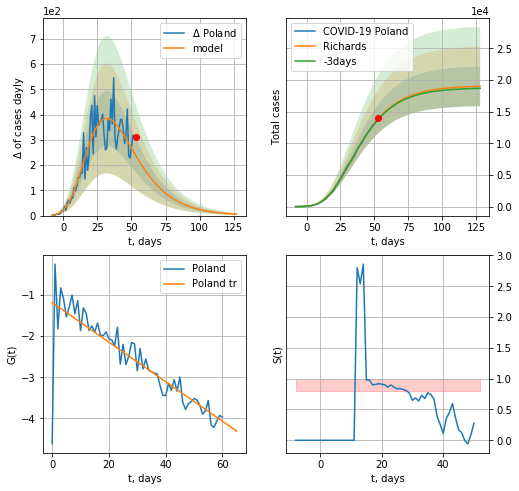

Poland data at: 2020-05-04
+3 day model MAPE: 0.005762
model: Richards
coeffs: [ 1.90831561e+04  3.18849736e+00 -4.08538005e+01  1.73586800e-02]
rational stdev: 0.164709
forecast at the end of period: +75 days
	 deltaDaycases: 5
	 total cases: 18987 ± 3127
	 total death: 946 ± 467
trend coefficient of determination: 0.727503
 intercept: -1.188016
 slope: -0.047981


In [623]:
x =  forecastRR('Poland',dfPL[:],d1,16*7-dT)
#xx = forecast2R('Poland',dfPL[:],d1,8*7-dT,x)

/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


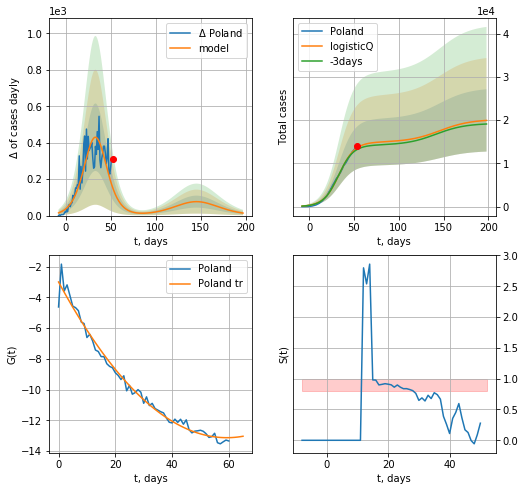

Poland data at: 2020-05-04
+3 day model MAPE: 0.029624
model: logisticQ
coeffs: [ 1.48998638e+04  1.73138544e-06  3.34356122e+01 -6.66429397e+04]
S.Korea scenario coeffs: [0.35416971, 0.02606324, 4.35859408, 19.30413219]
rational stdev: 0.361536
forecast at the end of period: +145 days
	 deltaDaycases: 13
	 total cases: 19934 ± 7207
	 total death: 993 ± 1077
trend coefficient of determination: 0.984004
 intercept_: -2.9993187789822136
 coeffs_: [ 0.         -0.34178733  0.00288182]


In [624]:
x =  forecastRRR('Poland',dfPL[:],d1,26*7-dT,addpred=True,xcoef=koreaCoeffs)

IS
          date    cases  active  death
68 2020-04-30  15946.0    7163  222.0
69 2020-05-01  16101.0    6720  225.0
70 2020-05-02  16185.0    6363  229.0
71 2020-05-03  16208.0    6227  232.0
72 2020-05-04  16246.0    5947  235.0


/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:118: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.5/dist-packages/numpy/core/_methods.py:193: RuntimeWarning: invalid value encountered in subtract
  x = asanyarray(arr - arrmean)


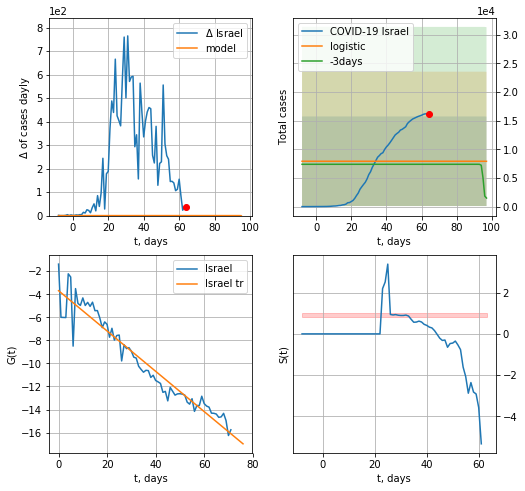

Israel data at: 2020-05-04
+3 day model MAPE: 0.07163358336028881
model: logistic
coeffs:  [ 6.33389137e+03 -3.31778197e+00  9.89126205e+01]
scenario coeffs:  [0.25, 1.0, 1.8]
rational stdev:  0.9873368606138906
forecast at the end of period: +33 days
	 deltaDaycases:  -10
	 total cases:  7906 ± 7806
	 total death:  114 ± 337
trend coefficient of determination: 0.927069
 intercept: -3.691833
 slope: -0.174738


In [625]:
dfIS = read_df(pd.DataFrame(),"IS")
x = forecast('Israel',dfIS[:],d1,10*7-dT,addpred=True,xcoef=[0.25,1.,1.8])
#xx = forecast2('Israel',dfIS[:],d1,20-dT,x)

/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:18: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:18: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


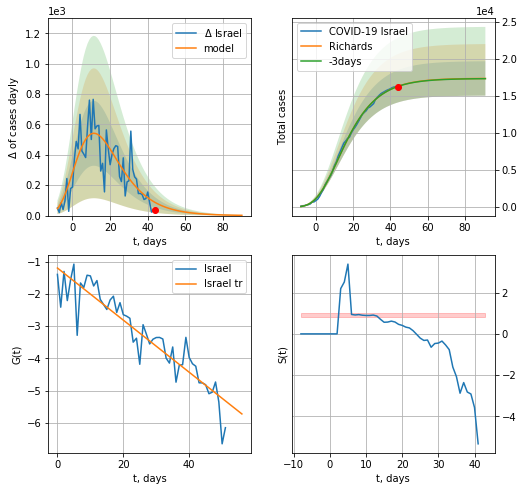

Israel data at: 2020-05-04
+3 day model MAPE: 0.001179
model: Richards
coeffs: [ 1.73555837e+04  9.31624837e+00 -4.31806839e+01  9.15528248e-03]
rational stdev: 0.133496
forecast at the end of period: +47 days
	 deltaDaycases: 1
	 total cases: 17335 ± 2314
	 total death: 250 ± 100
trend coefficient of determination: 0.853687
 intercept: -1.200785
 slope: -0.080720


In [626]:
x = forecastRR('Israel',dfIS[20:],d1,12*7-dT)
#xx = forecast2R('Israel',dfIS[:],d1,7*7-dT,x)

/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:153: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


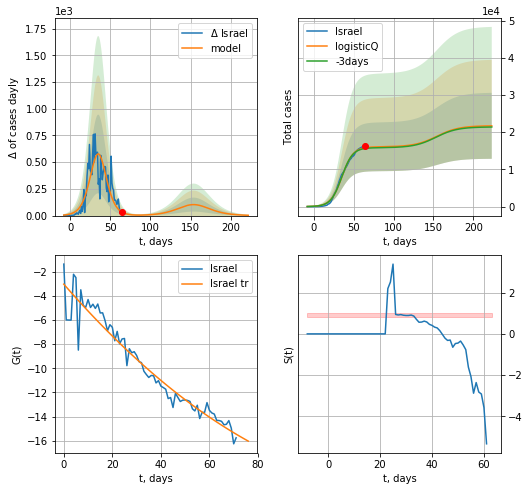

Israel data at: 2020-05-04
+3 day model MAPE: 0.013153
model: logisticQ
coeffs: [ 1.60648097e+04  1.15655097e-06  3.53924328e+01 -1.24271298e+05]
S.Korea scenario coeffs: [0.35416971, 0.02606324, 4.35859408, 19.30413219]
rational stdev: 0.408271
forecast at the end of period: +159 days
	 deltaDaycases: 2
	 total cases: 21715 ± 8865
	 total death: 314 ± 384
trend coefficient of determination: 0.933491
 intercept_: -3.045083496657373
 coeffs_: [ 0.         -0.23018891  0.0007811 ]


In [627]:
x = forecastRRR('Israel',dfIS[:],d1,28*7-dT,addpred=True,xcoef=koreaCoeffs)

/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


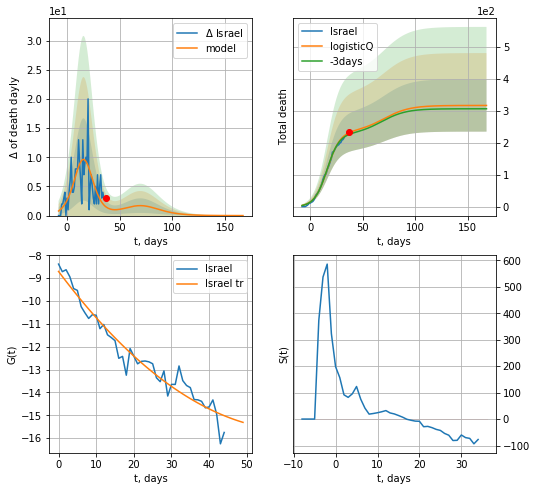

Israel data at: 2020-05-04
+3 day model MAPE: 0.024194
model: logisticQ
coeffs: [ 2.33834481e+02  1.33039549e-05  1.60910623e+01 -1.22815341e+04]
S.Korea scenario coeffs: [0.35416971, 0.02606324, 4.35859408, 19.30413219]
rational stdev: 0.258014
forecast at the end of period: +131 days
	 total death: 316 ± 81
trend coefficient of determination: 0.947762
 intercept_: -8.7067063313938
 coeffs_: [ 0.         -0.21967886  0.001732  ]


In [628]:
x = forecastRRR('Israel',dfIS[27:],d1,24*7-dT,addpred=True,xcoef=koreaCoeffs,cases='death')

/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 800.
  warnings.warn(errors[info][0], RuntimeWarning)


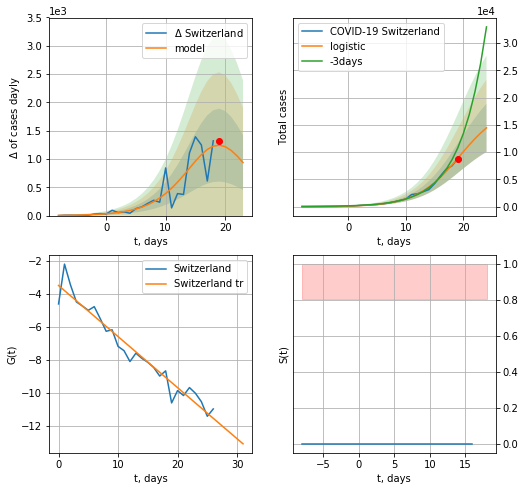

Switzerland data at: 2020-05-04
+3 day model MAPE: 0.24949892382467553
model: logistic
coeffs:  [1.87061213e+04 2.66466230e-01 1.93986309e+01]
rational stdev:  0.30604789910568747
forecast at the end of period: +5 days
	 deltaDaycases:  936
	 total cases:  14462 ± 4426
	 total death:  860 ± 789
trend coefficient of determination: 0.944448
 intercept: -3.508672
 slope: -0.309041


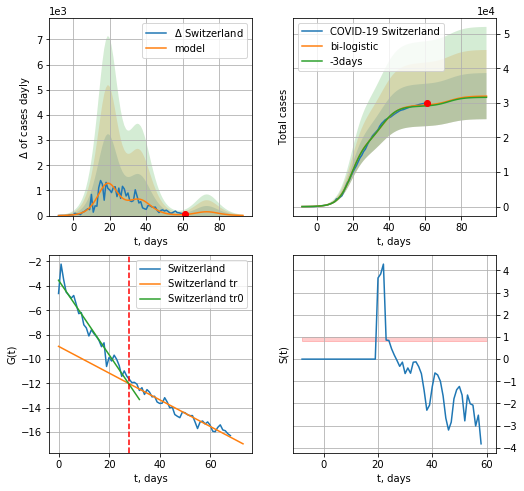

Switzerland data at: 2020-05-04
+3 day model MAPE: 0.009258824388947417
model: bi-logistic
coeffs:  [1.06301739e+04 2.28217284e-01 3.68318797e+01] [1.87061213e+04 2.66466230e-01 1.93986309e+01]
scenario coeffs:  [0.25, 1.0, 2.0]
rational stdev:  0.2088733972525509
forecast at the end of period: +33 days
	 deltaDaycases:  6
	 total cases:  31968 ± 6677
	 total death:  1902 ± 1191
bi-logistic approximation splitting point: 28
trend0 coefficient of determination: 0.947988
 intercept: -3.537068
 slope: -0.305765
trend coefficient of determination: 0.951964
 intercept: -8.962541
 slope: -0.109548


In [629]:
vL= 28
x = forecast('Switzerland',dfSZ[:vL],d1,7*6-dT)
xx = forecast2('Switzerland',dfSZ[:],d1,7*10-dT,x,vL=vL,addpred=True,xcoef=[0.25,1.,2.])#,addpred=False,xcoef=[0.25,1.,2.5]

/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:18: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:18: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


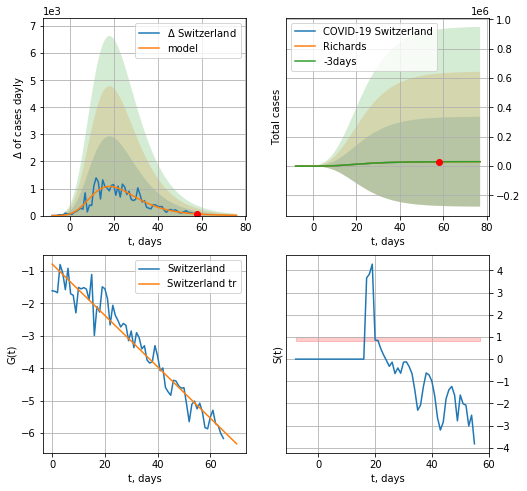

Switzerland data at: 2020-05-04
+3 day model MAPE: 0.001826
model: Richards
coeffs: [ 3.04462751e+04  5.45371349e+00 -2.27856287e+01  1.78343042e-02]
rational stdev: 10.096857
forecast at the end of period: +19 days
	 deltaDaycases: 10
	 total cases: 30342 ± 306362
	 total death: 1805 ± 54674
trend coefficient of determination: 0.937851
 intercept: -0.788685
 slope: -0.079119


In [630]:
x = forecastRR('Switzerland',dfSZ[3:],d1,7*8-dT)
#xx = forecastR('Switzerland',dfSZ[:],d1,7*5-dT,x,vL=15)

/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:153: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


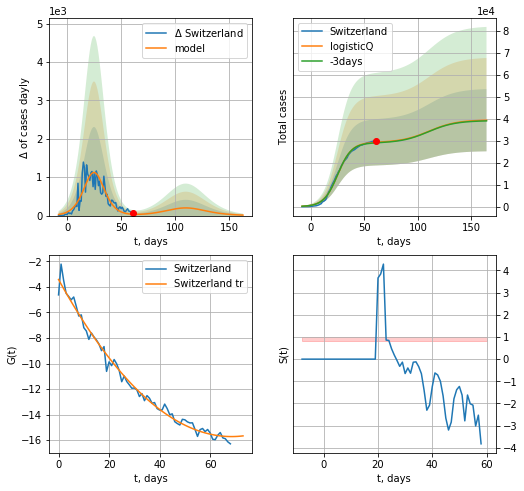

Switzerland data at: 2020-05-04
+3 day model MAPE: 0.008028
model: logisticQ
coeffs: [ 2.91457188e+04  1.06520350e-06  2.53162193e+01 -1.44824071e+05]
S.Korea scenario coeffs: [0.35416971, 0.02606324, 4.35859408, 19.30413219]
rational stdev: 0.360017
forecast at the end of period: +103 days
	 deltaDaycases: 12
	 total cases: 39310 ± 14152
	 total death: 2339 ± 2526
trend coefficient of determination: 0.987211
 intercept_: -3.419693334221604
 coeffs_: [ 0.         -0.35920102  0.00262264]


In [631]:
x = forecastRRR('Switzerland',dfSZ[:],d1,7*20-dT,addpred=True,xcoef=koreaCoeffs)

In [632]:
#trend3(dfUR[5:],dfIN[7:],dfRS[5:],'UR','IN','RS',40,40,40)

Ukr
          date    cases  active  death
51 2020-04-30  10861.0    9176  272.0
52 2020-05-01  11411.0    9634  279.0
53 2020-05-02  11913.0   10077  288.0
54 2020-05-03  12331.0   10409  303.0
55 2020-05-04  12697.0   10506  316.0


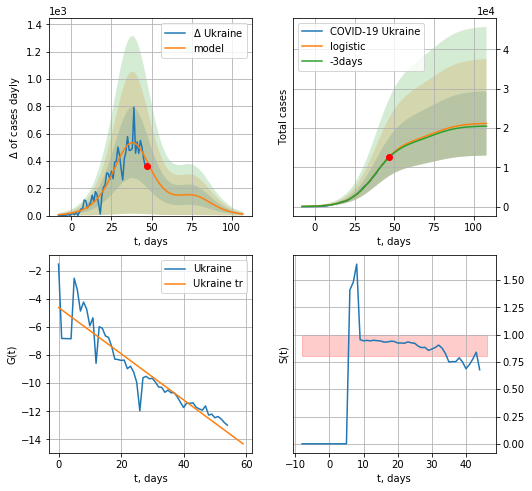

Ukraine data at: 2020-05-04
+3 day model MAPE: 0.01368313460344999
model: logistic
coeffs:  [1.69974100e+04 1.24634277e-01 3.83676029e+01]
scenario coeffs:  [0.25, 1.0, 2.0]
rational stdev:  0.386780404007073
forecast at the end of period: +61 days
	 deltaDaycases:  11
	 total cases:  21159 ± 8183
	 total death:  519 ± 602
trend coefficient of determination: 0.850672
 intercept: -4.600276
 slope: -0.164821


In [633]:
dfUR = read_df(pd.DataFrame(),"Ukr")
x=forecast('Ukraine',dfUR[:],d1,14*7-dT,addpred=True,xcoef=[0.25,1.,2.])
#xx=forecast2('Ukraine',dfUR[:],d1,14-dT,x)

/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:131: RuntimeWarning: invalid value encountered in true_divide


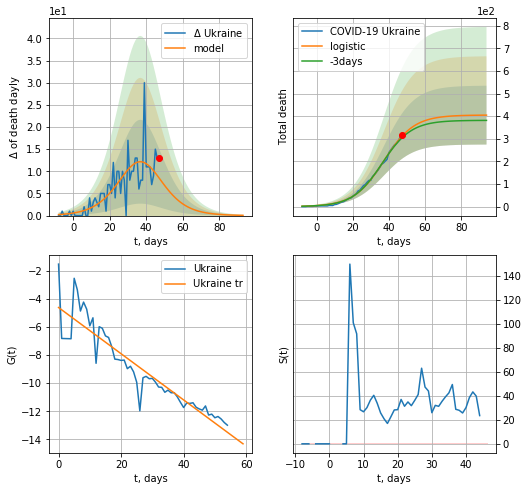

Ukraine data at: 2020-05-04
+3 day model MAPE: 0.02593666550775386
model: logistic
coeffs:  [4.05256236e+02 1.20139382e-01 3.72634727e+01]
rational stdev:  0.321485960917471
forecast at the end of period: +47 days
	 total death:  404 ± 130
trend coefficient of determination: 0.850672
 intercept: -4.600276
 slope: -0.164821


In [634]:
x=forecast('Ukraine',dfUR[:],d1,12*7-dT,addpred=False,xcoef=[0.25,1.,2.],cases='death')
#xx=forecast2('Ukraine',dfUR[:],d1,14-dT,x)

/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:18: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:18: RuntimeWarning: divide by zero encountered in true_divide


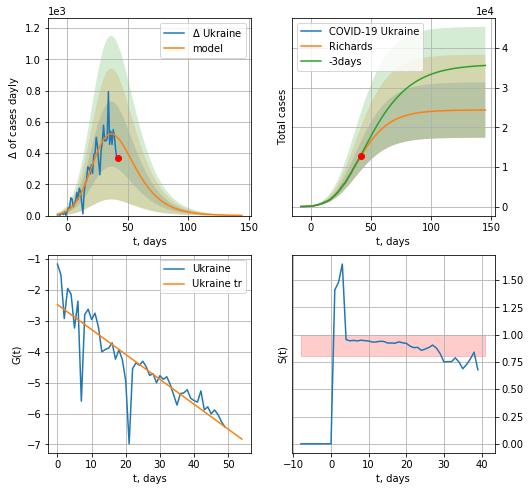

Ukraine data at: 2020-05-04
+3 day model MAPE: 0.029871
model: Richards
coeffs: [2.43704221e+04 2.19216592e-01 1.90562741e+01 3.05241956e-01]
rational stdev: 0.287003
forecast at the end of period: +103 days
	 deltaDaycases: 1
	 total cases: 24352 ± 6989
	 total death: 598 ± 514
trend coefficient of determination: 0.751325
 intercept: -2.474217
 slope: -0.080654


In [635]:
x=forecastRR('Ukraine',dfUR[5:],d1,7*20-dT)

/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


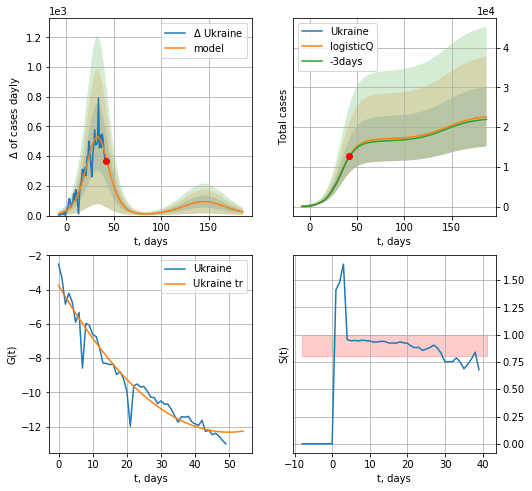

Ukraine data at: 2020-05-04
+3 day model MAPE: 0.013859
model: logisticQ
coeffs: [ 1.70017450e+04  6.73529045e-06  3.33744741e+01 -1.84650694e+04]
S.Korea scenario coeffs: [0.35416971, 0.02606324, 4.35859408, 19.30413219]
rational stdev: 0.333034
forecast at the end of period: +145 days
	 deltaDaycases: 24
	 total cases: 22607 ± 7528
	 total death: 555 ± 554
trend coefficient of determination: 0.940979
 intercept_: -3.7464061957209216
 coeffs_: [ 0.         -0.34359632  0.00344419]


In [636]:
x=forecastRRR('Ukraine',dfUR[5:],d1,7*26-dT,addpred=True,xcoef=koreaCoeffs)

In [637]:
#np.log(np.diff(dfIS["cases"].values)[:]/dfIS["cases"].values[1:]**2)

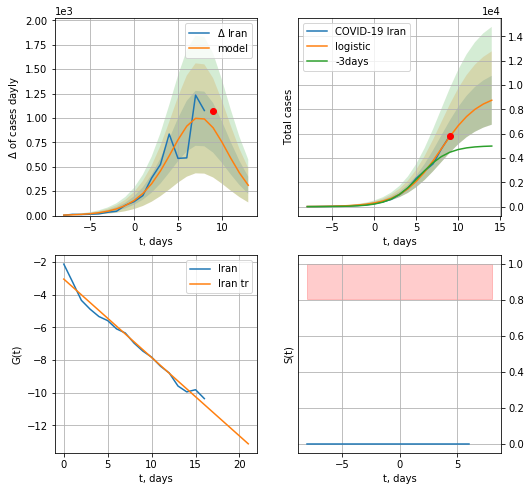

Iran data at: 2020-05-04
+3 day model MAPE: 0.41768987892528675
model: logistic
coeffs:  [9.38566037e+03 4.29600563e-01 7.92981697e+00]
rational stdev:  0.2297342175744371
forecast at the end of period: +5 days
	 deltaDaycases:  310
	 total cases:  8741 ± 2008
	 total death:  556 ± 383
trend coefficient of determination: 0.980602
 intercept: -3.037586
 slope: -0.480406


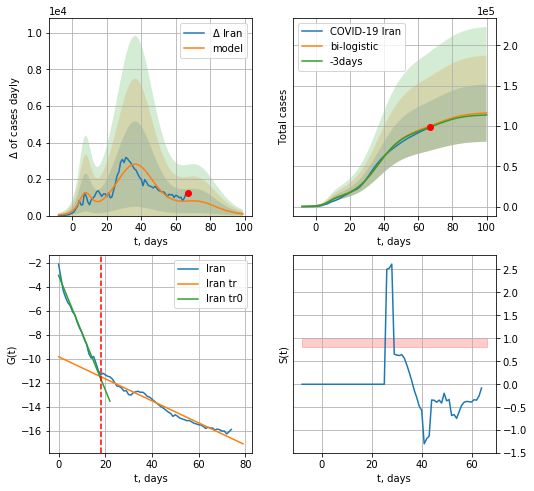

Iran data at: 2020-05-04
+3 day model MAPE: 0.014149854498876853
model: bi-logistic
coeffs:  [8.59217066e+04 1.30254041e-01 3.67921530e+01] [9.38566037e+03 4.29600563e-01 7.92981697e+00]
scenario coeffs:  [0.25, 1.0, 2.0]
rational stdev:  0.30667921475933785
forecast at the end of period: +33 days
	 deltaDaycases:  92
	 total cases:  116098 ± 35604
	 total death:  7387 ± 6796
bi-logistic approximation splitting point: 18
trend0 coefficient of determination: 0.982944
 intercept: -3.059655
 slope: -0.476268
trend coefficient of determination: 0.971849
 intercept: -9.837300
 slope: -0.091797


In [638]:
x = forecast('Iran',dfIN[:18],d1,6*7-dT)
xx = forecast2('Iran',dfIN[:],d1,10*7-dT,x,vL=18,addpred=True,xcoef=[0.25,1.,2.0])

/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:18: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:18: RuntimeWarning: divide by zero encountered in true_divide


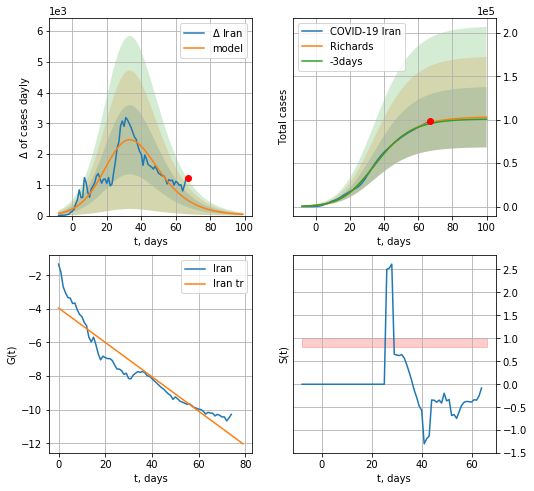

Iran data at: 2020-05-04
+3 day model MAPE: 0.012180
model: Richards
coeffs: [1.03361746e+05 1.58000601e-01 2.55545335e+01 5.12178441e-01]
rational stdev: 0.337089
forecast at the end of period: +33 days
	 deltaDaycases: 40
	 total cases: 102875 ± 34678
	 total death: 6546 ± 6619
trend coefficient of determination: 0.894828
 intercept: -3.948287
 slope: -0.102336


In [639]:
x = forecastRR('Iran',dfIN[:],d1,10*7-dT)

/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


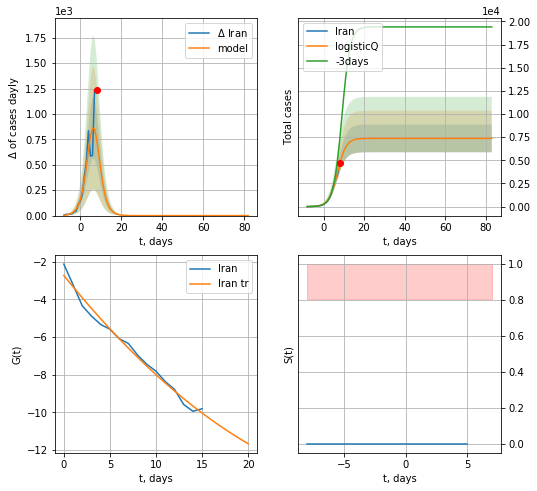

Iran data at: 2020-05-04
+3 day model MAPE: 0.437963
model: logisticQ
coeffs: [ 7.36885538e+03  7.42900276e-05 -6.37012173e+03  6.90117085e+00]
rational stdev: 0.203007
forecast at the end of period: +75 days
	 deltaDaycases: 0
	 total cases: 7368 ± 1495
	 total death: 468 ± 285
trend coefficient of determination: 0.985826
 intercept_: -2.7244557798652984
 coeffs_: [ 0.         -0.60810956  0.00802289]


/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:288: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


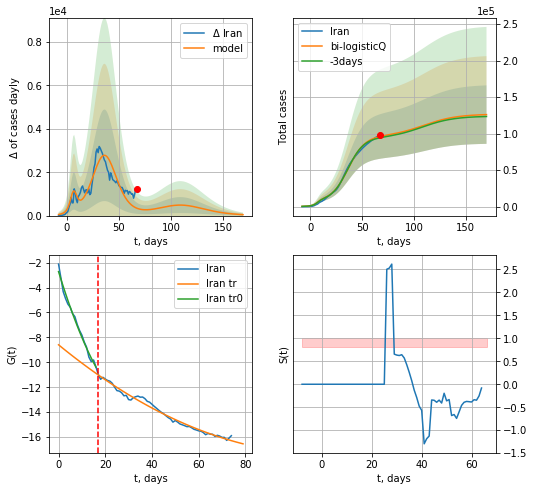

Iran data at: 2020-05-04
+3 day model MAPE: 0.018342
model: bi-logisticQ
coeffs: [ 8.84400558e+04  9.91669145e-07  3.64454485e+01 -1.25950597e+05]
S.Korea scenario coeffs: [0.35, 0.5, 3, 1]
rational stdev: 0.317769
forecast at the end of period: +103 days
	 deltaDaycases: 42
	 total cases: 126081 ± 40064
	 total death: 8022 ± 7647
bi-logisticQ approximation splitting point: 17
trend coefficient of determination: 0.987745
 intercept_: -2.720144864989817
 coeffs_: [ 0.         -0.61067547  0.00823538]
trend coefficient of determination: 0.984095
 intercept_: -8.59407175548279
 coeffs_: [ 0.         -0.15364807  0.00067152]


In [640]:
x = forecastRRR('Iran',dfIN[:17],d1,16*7-dT,addpred=False,xcoef=[0.35,.5,3,1])
xx = forecast2RRR('Iran',dfIN[:],d1,20*7-dT,x,addpred=True,xcoef=[0.35,.5,3,1],vL=17)

RS
          date     cases  active   death
61 2020-04-30  106498.0   93806  1073.0
62 2020-05-01  114431.0  100042  1169.0
63 2020-05-02  124054.0  107819  1222.0
64 2020-05-03  134687.0  116768  1280.0
65 2020-05-04  145268.0  125817  1356.0


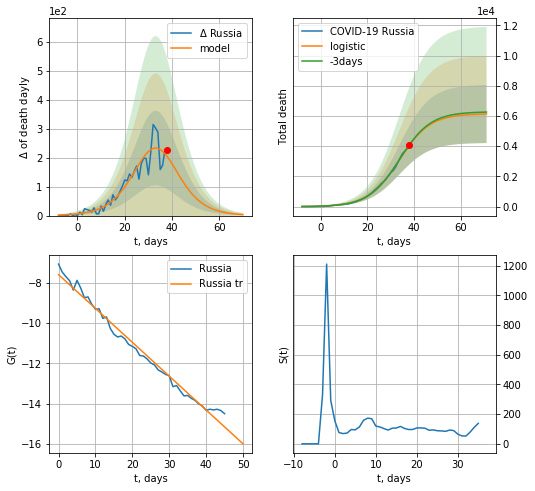

Russia data at: 2020-05-04
+3 day model MAPE: 0.006801645026936973
model: logistic
coeffs:  [6.14967509e+03 1.52055981e-01 3.35587444e+01]
rational stdev:  0.31343869114944295
forecast at the end of period: +33 days
	 total death:  6129 ± 1921
trend coefficient of determination: 0.984780
 intercept: -7.599311
 slope: -0.168038


In [641]:
dfRS = read_df(pd.DataFrame(),"RS")
x = forecast('Russia',dfRS[19:],d1,10*7-dT,shift=3.,cases='death')
#xx = forecast2('Russia',dfRS[:],d1,9*7-dT,x,vL=14)#,addpred=True,xcoef=[0.5,1.,3.5]

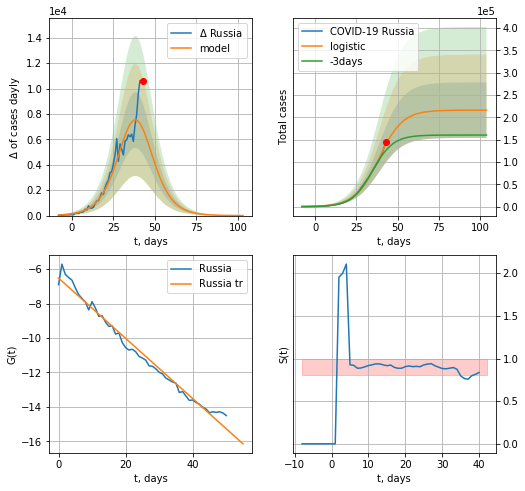

Russia data at: 2020-05-04
+3 day model MAPE: 0.12206861983140108
model: logistic
coeffs:  [2.16225659e+05 1.39446551e-01 3.86811332e+01]
rational stdev:  0.2875796581617236
forecast at the end of period: +61 days
	 deltaDaycases:  3
	 total cases:  216201 ± 62175
	 total death:  2018 ± 1741
trend coefficient of determination: 0.982174
 intercept: -6.514597
 slope: -0.175107


In [642]:
x = forecast('Russia',dfRS[14:],d1,14*7-dT,shift=1.)
#xx = forecast2('Russia',dfRS[:],d1,9*7-dT,x,vL=14,shift=1.)#,addpred=True,xcoef=[0.5,1.,3.5]

/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:18: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:18: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


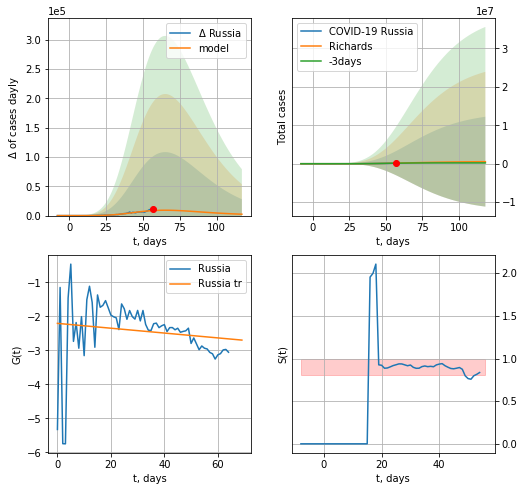

Russia data at: 2020-05-04
+3 day model MAPE: 0.101611
model: Richards
coeffs: [ 5.82052189e+05  1.18712217e+00 -1.03251050e+01  3.67080269e-02]
rational stdev: 22.238208
forecast at the end of period: +61 days
	 deltaDaycases: 2364
	 total cases: 525948 ± 11696157
	 total death: 4909 ± 327502
trend coefficient of determination: 0.021849
 intercept: -2.205843
 slope: -0.007131


/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1200.
  warnings.warn(errors[info][0], RuntimeWarning)
/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:15: RuntimeWarning: overflow encountered in power
  from ipykernel import kernelapp as app


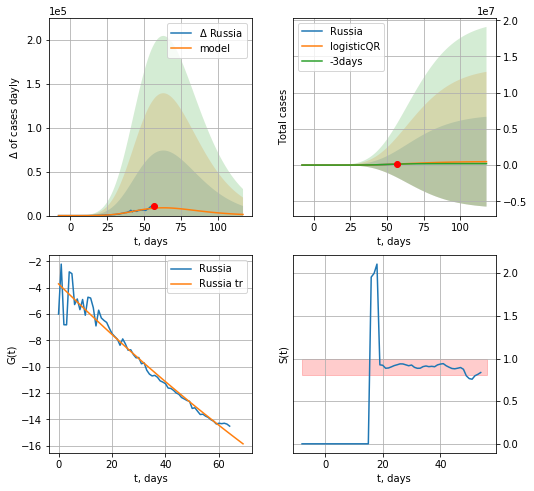

Russia data at: 2020-05-04
+3 day model MAPE: 0.09983963975114028
model: logisticQR
coeffs:  [ 4.91276786e+05  1.51332412e-02 -9.04031615e+01 -2.33009758e+02
  7.26858643e-03]
rational stdev:  13.19418374099282
forecast at the end of period: +61 days
	 deltaDaycases:  1309
	 total cases:  470105 ± 6202663
	 total death:  4388 ± 173688
trend coefficient of determination: 0.951648
 intercept_: -3.707947971924197
 coeffs_: [ 0.         -0.19879302  0.00033149]


In [643]:
x = forecastRR('Russia',dfRS[:],d1,14*7-dT)#,addpred=True,xcoef=[0.25,1.,1.5,1]
x = forecastQR('Russia',dfRS[:],d1,14*7-dT)#,addpred=True,xcoef=[0.25,1.,1.5,1]

/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:153: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


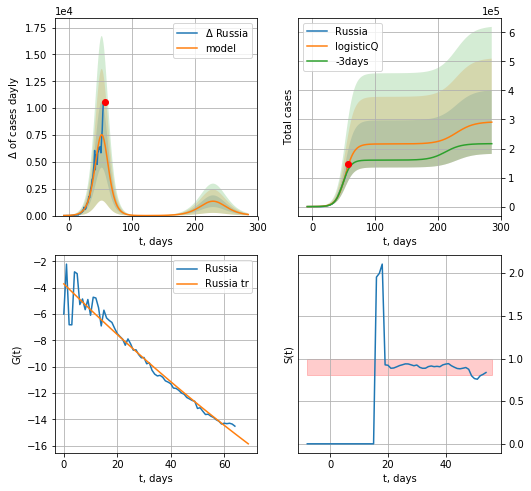

Russia data at: 2020-05-04
+3 day model MAPE: 0.122425
model: logisticQ
coeffs: [ 2.15767488e+05  6.86395565e-06  5.26496077e+01 -2.02955437e+04]
S.Korea scenario coeffs: [0.35416971, 0.02606324, 4.35859408, 19.30413219]
rational stdev: 0.375975
forecast at the end of period: +229 days
	 deltaDaycases: 101
	 total cases: 290762 ± 109319
	 total death: 2714 ± 3061
trend coefficient of determination: 0.951648
 intercept_: -3.707947971924197
 coeffs_: [ 0.         -0.19879302  0.00033149]


In [644]:
x = forecastRRR('Russia',dfRS[:],d1,38*7-dT,addpred=True,xcoef=koreaCoeffs)

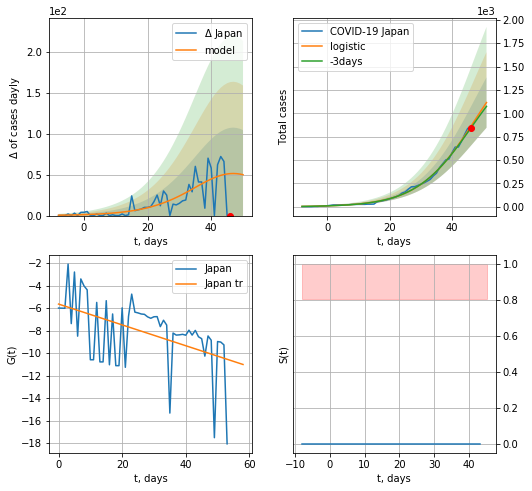

Japan data at: 2020-05-04
+3 day model MAPE: 0.0244139001087548
model: logistic
coeffs:  [1.86668601e+03 1.09971339e-01 4.74124632e+01]
rational stdev:  0.24188431663406776
forecast at the end of period: +5 days
	 deltaDaycases:  49
	 total cases:  1115 ± 269
	 total death:  39 ± 28
trend coefficient of determination: 0.226001
 intercept: -5.646499
 slope: -0.092589


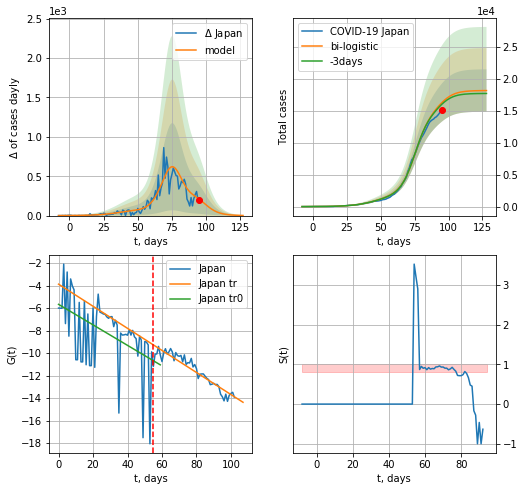

Japan data at: 2020-05-04
+3 day model MAPE: 0.016240915740197717
model: bi-logistic
coeffs:  [1.30748217e+04 1.81985632e-01 7.55067697e+01] [1.86668601e+03 1.09971339e-01 4.74124632e+01]
scenario coeffs:  [0.25, 1.0, 1.25]
rational stdev:  0.18281595709666204
forecast at the end of period: +33 days
	 deltaDaycases:  1
	 total cases:  18201 ± 3327
	 total death:  647 ± 354
bi-logistic approximation splitting point: 55
trend0 coefficient of determination: 0.229818
 intercept: -5.672459
 slope: -0.091119
trend coefficient of determination: 0.868106
 intercept: -3.877777
 slope: -0.098128


In [645]:
x = forecast('Japan',dfJP[:55],d1,6*7-dT)
xx = forecast2('Japan',dfJP[:],d1,10*7-dT,x,addpred=True,xcoef=[0.25,1.,1.25],vL=55)

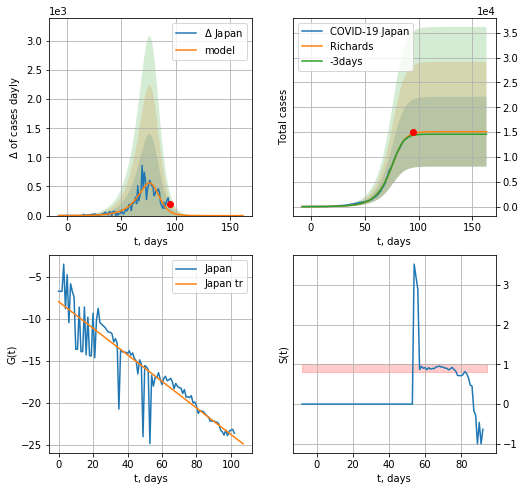

Japan data at: 2020-05-04
+3 day model MAPE: 0.024886
model: Richards
coeffs: [1.50791018e+04 9.64896063e-02 7.99066977e+01 2.00388320e+00]
rational stdev: 0.466105
forecast at the end of period: +68 days
	 deltaDaycases: 0
	 total cases: 15079 ± 7028
	 total death: 536 ± 749
trend coefficient of determination: 0.842762
 intercept: -7.950504
 slope: -0.157967


In [646]:
x = forecastRR('Japan',dfJP[:],d1,15*7-dT)

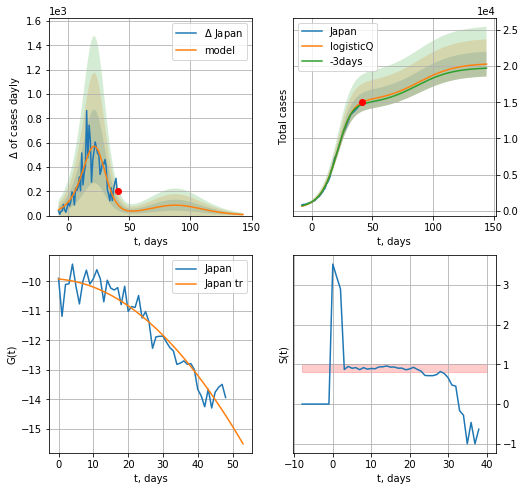

Japan data at: 2020-05-04
+3 day model MAPE: 0.020538
model: logisticQ
coeffs: [ 1.50604542e+04  1.29746348e-03  2.01020297e+01 -9.40341220e+01]
S.Korea scenario coeffs: [0.35416971, 0.02606324, 4.35859408, 19.30413219]
rational stdev: 0.084471
forecast at the end of period: +103 days
	 deltaDaycases: 8
	 total cases: 20270 ± 1712
	 total death: 720 ± 182
trend coefficient of determination: 0.916678
 intercept_: -9.91869930525792
 coeffs_: [ 0.         -0.00888347 -0.00182275]


In [647]:
x = forecastRRR('Japan',dfJP[54:],d1,20*7-dT,addpred=True,xcoef=koreaCoeffs)

/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 800.
  warnings.warn(errors[info][0], RuntimeWarning)


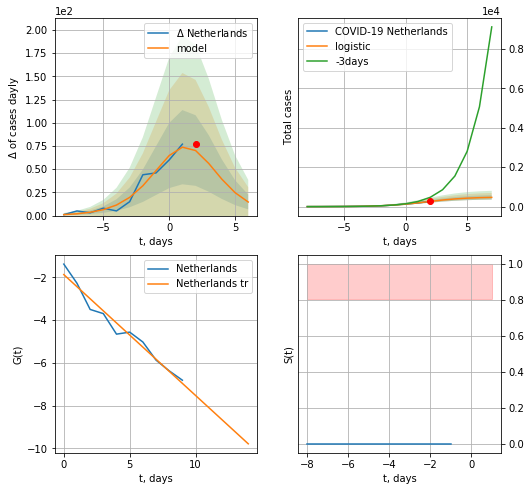

Netherlands data at: 2020-05-04
model: logistic
coeffs:  [487.74708253   0.61204074   1.72557629]
rational stdev:  0.23761280835096962
forecast at the end of period: +5 days
	 deltaDaycases:  14
	 total cases:  469 ± 111
	 total death:  58 ± 41
trend coefficient of determination: 0.966773
 intercept: -1.876651
 slope: -0.565279


/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:230: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.5/dist-packages/numpy/core/_methods.py:193: RuntimeWarning: invalid value encountered in subtract
  x = asanyarray(arr - arrmean)


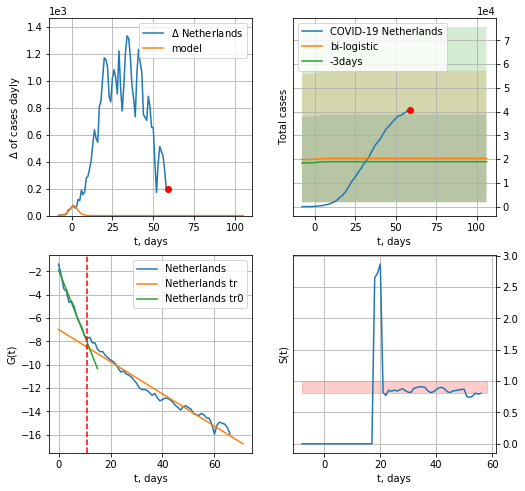

Netherlands data at: 2020-05-04
+3 day model MAPE: 0.07383320358704386
model: bi-logistic
coeffs:  [ 1.58477676e+04 -3.65979381e+00  1.19207000e+02] [487.74708253   0.61204074   1.72557629]
scenario coeffs:  [0.25, 1.0, 2.0]
rational stdev:  0.9087589164891515
forecast at the end of period: +47 days
	 deltaDaycases:  0
	 total cases:  20297 ± 18445
	 total death:  2530 ± 6897
bi-logistic approximation splitting point: 11
trend0 coefficient of determination: 0.974821
 intercept: -1.878275
 slope: -0.564738
trend coefficient of determination: 0.962558
 intercept: -6.991164
 slope: -0.137935


In [648]:
vL=11
vL1=32
x = forecast('Netherlands',dfNL[:vL],d1,6*7-dT,pMAPE=False)
xx = forecast2('Netherlands',dfNL[:],d1,12*7-dT,x,addpred=True,xcoef=[0.25,1.,2.],vL=vL)
#xx = np.concatenate((x, xx), axis=0)
#xxx = forecast3("Philippines",dfPH,d1,8*7-dT, xx, shift=1.,addpred=False,xcoef=[.25,1.,2.],vL=[vL,vL1])

NL
          date  cases  active   death
63 2020-04-30  39316   34271  4795.0
64 2020-05-01  39791   34648  4893.0
65 2020-05-02  40236   34999  4987.0
66 2020-05-03  40571   35265  5056.0
67 2020-05-04  40770   35438  5082.0


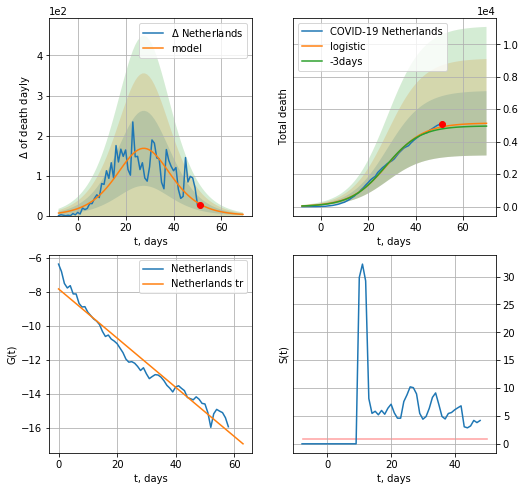

Netherlands data at: 2020-05-04
+3 day model MAPE: 0.026839302985257427
model: logistic
coeffs:  [5.15232943e+03 1.30571568e-01 2.80627180e+01]
rational stdev:  0.3858195310204685
forecast at the end of period: +19 days
	 total death:  5130 ± 1979
trend coefficient of determination: 0.958425
 intercept: -7.836453
 slope: -0.144508


In [649]:
dfNL = read_df(pd.DataFrame(),"NL")
x = forecast('Netherlands',dfNL[8:],d1,8*7-dT,cases='death')

/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:18: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:18: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


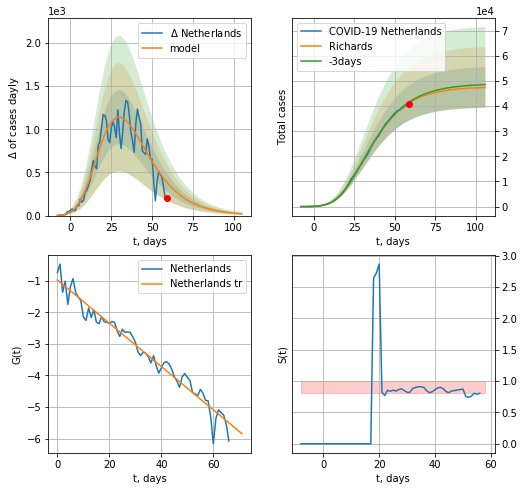

Netherlands data at: 2020-05-04
+3 day model MAPE: 0.009053
model: Richards
coeffs: [ 4.77038222e+04  9.47881639e-01 -9.07606725e+00  7.09422916e-02]
rational stdev: 0.169582
forecast at the end of period: +47 days
	 deltaDaycases: 20
	 total cases: 47411 ± 8040
	 total death: 5909 ± 3006
trend coefficient of determination: 0.961120
 intercept: -0.975616
 slope: -0.068536


In [650]:
x = forecastRR('Netherlands',dfNL[:],d1,12*7-dT)

/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:15: RuntimeWarning: overflow encountered in exp
  from ipykernel import kernelapp as app
/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:15: RuntimeWarning: divide by zero encountered in true_divide
  from ipykernel import kernelapp as app
/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:15: RuntimeWarning: overflow encountered in power
  from ipykernel import kernelapp as app
/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1200.
  warnings.warn(errors[info][0], RuntimeWarning)


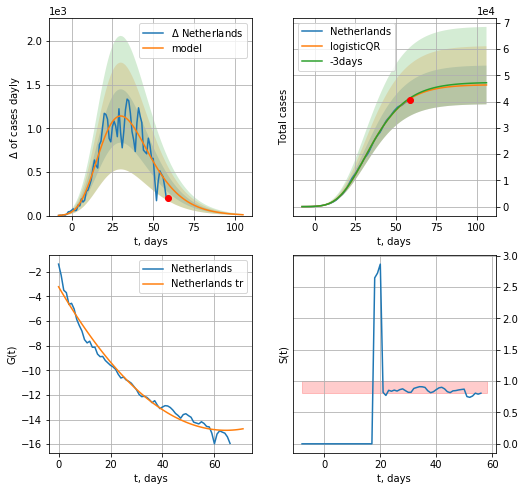

Netherlands data at: 2020-05-04
+3 day model MAPE: 0.006834912046888314
model: logisticQR
coeffs:  [ 4.64484135e+04  2.97420590e-02 -7.58797635e+01 -2.64658823e+02
  5.62523231e-03]
rational stdev:  0.15912539954765276
forecast at the end of period: +47 days
	 deltaDaycases:  10
	 total cases:  46344 ± 7374
	 total death:  5776 ± 2757
trend coefficient of determination: 0.980179
 intercept_: -3.223784178496583
 coeffs_: [ 0.         -0.36182443  0.00280933]


In [651]:
x = forecastQR('Netherlands',dfNL[:],d1,12*7-dT)

/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:153: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


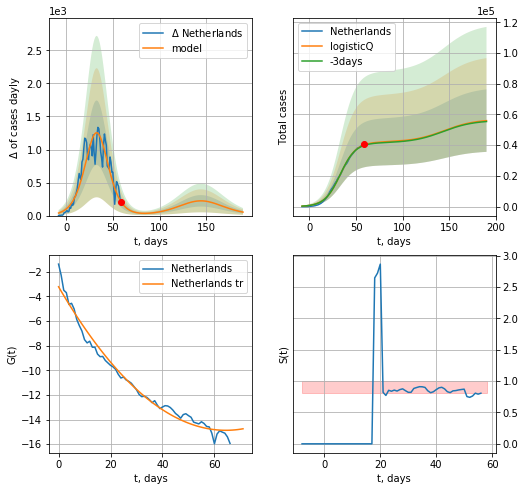

Netherlands data at: 2020-05-04
+3 day model MAPE: 0.009169
model: logisticQ
coeffs: [ 4.19953592e+04  1.50263276e-06  3.31505261e+01 -7.94418060e+04]
S.Korea scenario coeffs: [0.35416971, 0.02606324, 4.35859408, 19.30413219]
rational stdev: 0.363318
forecast at the end of period: +131 days
	 deltaDaycases: 52
	 total cases: 55961 ± 20331
	 total death: 6975 ± 7602
trend coefficient of determination: 0.980179
 intercept_: -3.223784178496583
 coeffs_: [ 0.         -0.36182443  0.00280933]


/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)
/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:207: RuntimeWarning: invalid value encountered in true_divide


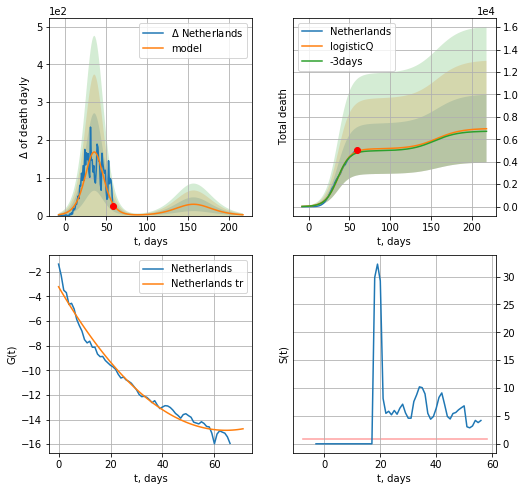

Netherlands data at: 2020-05-04
+3 day model MAPE: 0.026933
model: logisticQ
coeffs: [ 5.14885033e+03  1.52311323e-06  3.60499707e+01 -8.58179336e+04]
S.Korea scenario coeffs: [0.35416971, 0.02606324, 4.35859408, 19.30413219]
rational stdev: 0.435848
forecast at the end of period: +159 days
	 total death: 6939 ± 3024
trend coefficient of determination: 0.980179
 intercept_: -3.223784178496583
 coeffs_: [ 0.         -0.36182443  0.00280933]


In [652]:
x = forecastRRR('Netherlands',dfNL[:],d1,24*7-dT,addpred=True,xcoef=koreaCoeffs)
x = forecastRRR('Netherlands',dfNL[:],d1,28*7-dT,addpred=True,xcoef=koreaCoeffs,cases='death')

In [653]:
#trend3(dfAT[1:],dfSG[:],dfBG[:],'AT','SG','BG',40,35,35)

/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:118: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.5/dist-packages/numpy/core/_methods.py:193: RuntimeWarning: invalid value encountered in subtract
  x = asanyarray(arr - arrmean)


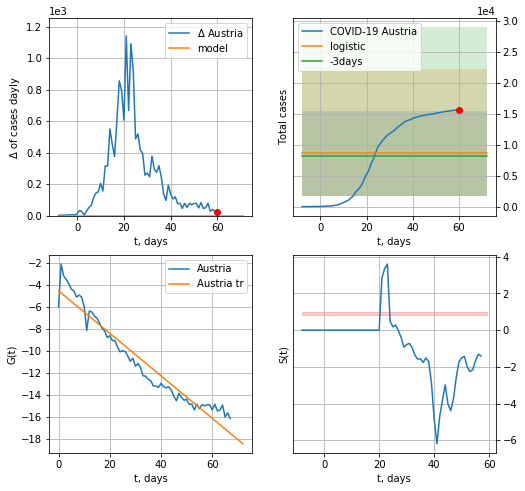

Austria data at: 2020-05-04
+3 day model MAPE: 0.04411237224223235
model: logistic
coeffs:  [ 8.08097114e+03 -2.86112081e+00  1.06862638e+02]
scenario coeffs:  [0.0625, 1.0, 2.0]
rational stdev:  0.7932913044932778
forecast at the end of period: +12 days
	 deltaDaycases:  0
	 total cases:  8586 ± 6811
	 total death:  329 ± 782
trend coefficient of determination: 0.935656
 intercept: -4.552288
 slope: -0.193074


In [654]:
x = forecast('Austria',dfAT[:],d1,7*7-dT,addpred=True,xcoef=[0.25/4,1.,2.0])
#xx = forecast2('Austria',dfAT[:],d1,7*7-dT,x,addpred=True,xcoef=[0.35*2,1.,1.5],vL=36)

/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:18: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:18: RuntimeWarning: divide by zero encountered in true_divide


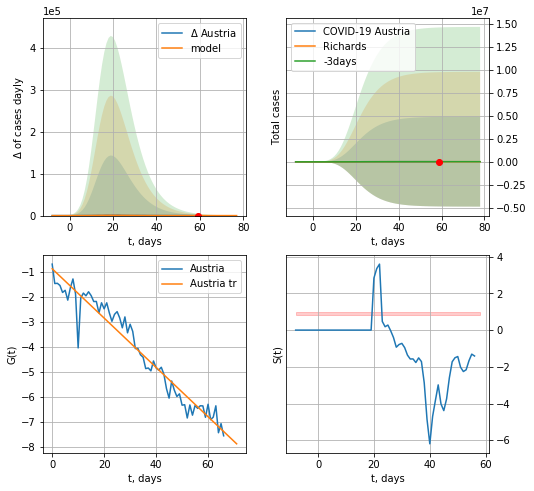

Austria data at: 2020-05-04
+3 day model MAPE: 0.005925
model: Richards
coeffs: [1.53792223e+04 1.25646489e+00 3.86665886e+00 1.11030525e-01]
rational stdev: 316.986535
forecast at the end of period: +19 days
	 deltaDaycases: 0
	 total cases: 15374 ± 4873590
	 total death: 590 ± 561066
trend coefficient of determination: 0.941735
 intercept: -0.879041
 slope: -0.098474


In [655]:
x = forecastRR('Austria',dfAT[1:],d1,8*7-dT,addpred=False,xcoef=[0.25,1.,2.2,1.])
#xx = forecast2R('Austria',dfAT[:],d1,8*7-dT,x)

/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:153: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


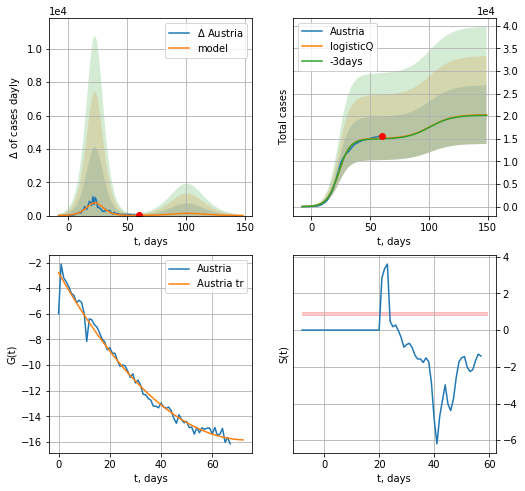

Austria data at: 2020-05-04
+3 day model MAPE: 0.007285
model: logisticQ
coeffs: [ 1.50349249e+04  1.44856464e-06  2.31680731e+01 -1.40996931e+05]
S.Korea scenario coeffs: [0.35416971, 0.02606324, 4.35859408, 19.30413219]
rational stdev: 0.318439
forecast at the end of period: +89 days
	 deltaDaycases: 4
	 total cases: 20321 ± 6471
	 total death: 780 ± 745
trend coefficient of determination: 0.979979
 intercept_: -2.7901938520997884
 coeffs_: [ 0.         -0.35329181  0.00239151]


In [656]:
x = forecastRRR('Austria',dfAT[:],d1,18*7-dT,addpred=True,xcoef=koreaCoeffs)

/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:118: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.5/dist-packages/numpy/core/_methods.py:193: RuntimeWarning: invalid value encountered in subtract
  x = asanyarray(arr - arrmean)


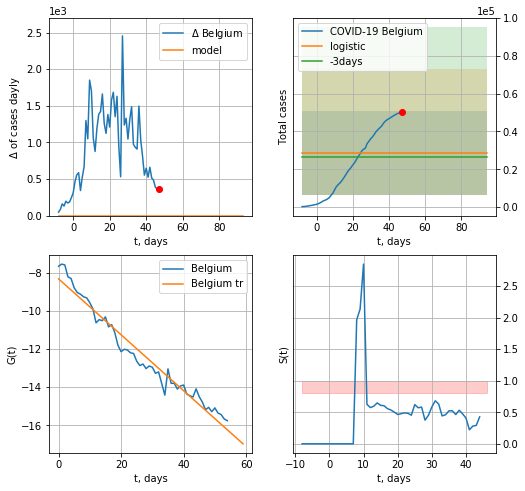

Belgium data at: 2020-05-04
+3 day model MAPE: 0.07169839226493951
model: logistic
coeffs:  [ 2.28681429e+04 -4.73679655e+00  1.82642335e+02]
scenario coeffs:  [0.25, 1.0, 3.0]
rational stdev:  0.7768563373435757
forecast at the end of period: +47 days
	 deltaDaycases:  0
	 total cases:  28585 ± 22206
	 total death:  4506 ± 10501
trend coefficient of determination: 0.960797
 intercept: -8.309133
 slope: -0.146883


In [657]:
vL=9
x = forecast('Belgium',dfBG[vL:],d1,12*7-dT,addpred=True,xcoef=[0.25,1.,3.])
#xx = forecast2('Belgium',dfBG[vL:],d1,10*7-dT,x,addpred=True,xcoef=[0.25,1.,2.],vL=vL)

BG
          date  cases  active   death
60 2020-04-30  48519   29349  7594.0
61 2020-05-01  49032   29437  7703.0
62 2020-05-02  49517   29541  7765.0
63 2020-05-03  49906   29753  7844.0
64 2020-05-04  50267   29965  7924.0


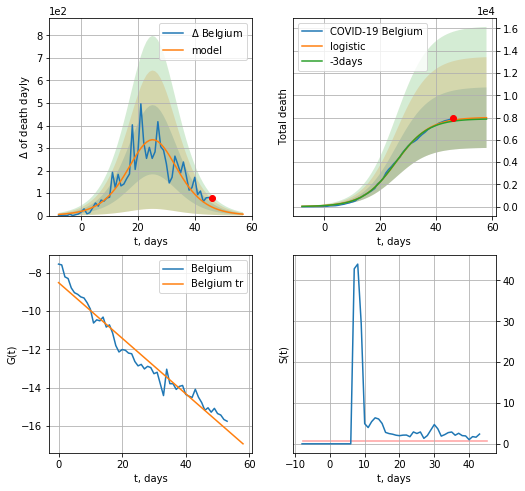

Belgium data at: 2020-05-04
+3 day model MAPE: 0.013190495005027811
model: logistic
coeffs:  [8.02305425e+03 1.68117871e-01 2.56598746e+01]
rational stdev:  0.34026352390049475
forecast at the end of period: +12 days
	 total death:  7988 ± 2718
trend coefficient of determination: 0.959466
 intercept: -8.504942
 slope: -0.145498


In [658]:
dfBG = read_df(pd.DataFrame(),"BG")
x = forecast('Belgium',dfBG[10:],d1,7*7-dT,cases='death')

/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:18: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:18: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


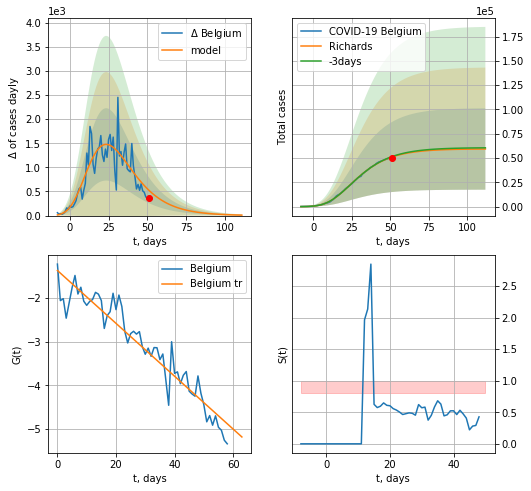

Belgium data at: 2020-05-04
+3 day model MAPE: 0.008362
model: Richards
coeffs: [ 5.94577465e+04  1.87297500e+00 -2.40584409e+01  3.67457036e-02]
rational stdev: 0.706122
forecast at the end of period: +61 days
	 deltaDaycases: 9
	 total cases: 59319 ± 41886
	 total death: 9350 ± 19806
trend coefficient of determination: 0.905869
 intercept: -1.369885
 slope: -0.060435


In [659]:
x = forecastRR('Belgium',dfBG[5:],d1,14*7-dT,addpred=False,xcoef=[0.25,1.,2.,1.])

/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:153: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


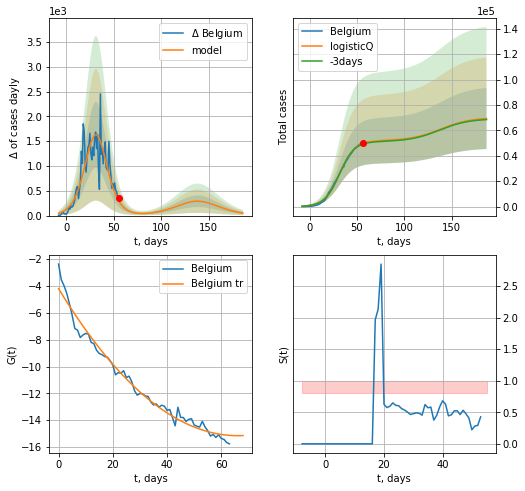

Belgium data at: 2020-05-04
+3 day model MAPE: 0.010225
model: logisticQ
coeffs: [ 5.18262097e+04  1.70006414e-06  3.17759568e+01 -7.39854664e+04]
S.Korea scenario coeffs: [0.35416971, 0.02606324, 4.35859408, 19.30413219]
rational stdev: 0.346564
forecast at the end of period: +131 days
	 deltaDaycases: 50
	 total cases: 69367 ± 24040
	 total death: 10934 ± 11367
trend coefficient of determination: 0.978781
 intercept_: -4.197028139253948
 coeffs_: [ 0.         -0.33196635  0.00251431]


In [660]:
x = forecastRRR('Belgium',dfBG[:],d1,24*7-dT,addpred=True,xcoef=koreaCoeffs)

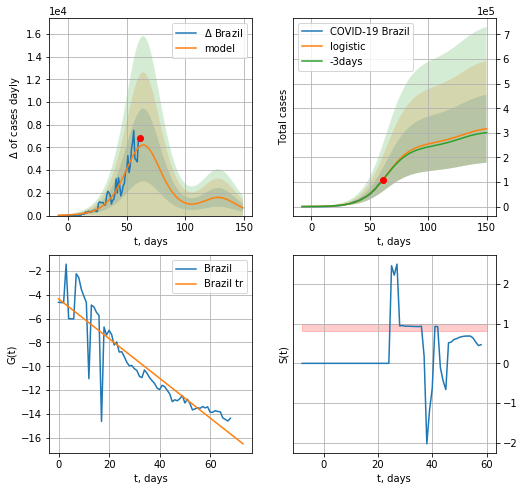

Brazil data at: 2020-05-04
+3 day model MAPE: 0.009970878009054674
model: logistic
coeffs:  [2.59455011e+05 9.56495626e-02 6.44954162e+01]
scenario coeffs:  [0.25, 1.0, 2.0]
rational stdev:  0.43620920377114375
forecast at the end of period: +89 days
	 deltaDaycases:  677
	 total cases:  316578 ± 138094
	 total death:  21471 ± 28097
trend coefficient of determination: 0.828647
 intercept: -4.337441
 slope: -0.166853


In [661]:
x = forecast('Brazil',dfBZ[:],d1,18*7-dT,addpred=True,xcoef=[0.25,1.,2.])
#xx = forecast2('Brazil',dfBZ[:],d1,4*7-dT,x)

/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:18: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:18: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


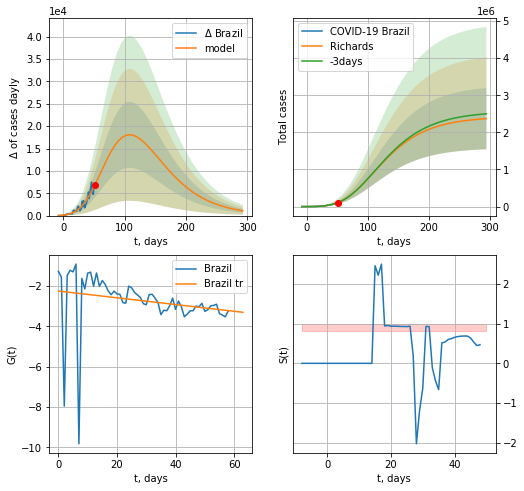

Brazil data at: 2020-05-04
+3 day model MAPE: 0.001808
model: Richards
coeffs: [ 2.42166421e+06  5.25334347e-01 -4.77043504e+01  3.93571225e-02]
rational stdev: 0.347720
forecast at the end of period: +243 days
	 deltaDaycases: 1073
	 total cases: 2369673 ± 823981
	 total death: 160719 ± 167655
trend coefficient of determination: 0.044270
 intercept: -2.246163
 slope: -0.016723


/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1200.
  warnings.warn(errors[info][0], RuntimeWarning)


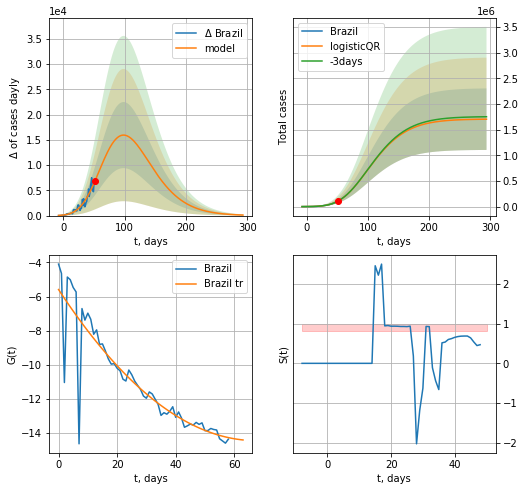

Brazil data at: 2020-05-04
+3 day model MAPE: 0.00026999781814039274
model: logisticQR
coeffs:  [ 1.70731922e+06  3.36737717e-03 -2.61686212e+02 -2.69754405e+02
  1.04606308e-02]
rational stdev:  0.3518853656966633
forecast at the end of period: +243 days
	 deltaDaycases:  105
	 total cases:  1704688 ± 599855
	 total death:  115618 ± 122052
trend coefficient of determination: 0.805451
 intercept_: -5.589063042800863
 coeffs_: [ 0.         -0.26223363  0.00193916]


In [662]:
x = forecastRR('Brazil',dfBZ[10:],d1,40*7-dT)
x = forecastQR('Brazil',dfBZ[10:],d1,40*7-dT)

/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


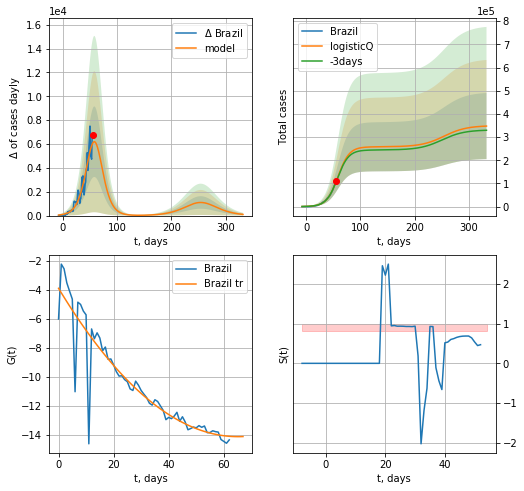

Brazil data at: 2020-05-04
+3 day model MAPE: 0.010090
model: logisticQ
coeffs: [ 2.57995309e+05  7.77319105e-06  5.83816485e+01 -1.22936063e+04]
S.Korea scenario coeffs: [0.35416971, 0.02606324, 4.35859408, 19.30413219]
rational stdev: 0.410533
forecast at the end of period: +278 days
	 deltaDaycases: 98
	 total cases: 347333 ± 142591
	 total death: 23557 ± 29012
trend coefficient of determination: 0.842498
 intercept_: -3.899300817075522
 coeffs_: [ 0.         -0.31431093  0.00241042]


In [663]:
x = forecastRRR('Brazil',dfBZ[6:],d1,45*7-dT,addpred=True,xcoef=koreaCoeffs)

In [664]:
#x = forecastRRR('Brazil',dfBZ[5:],d1,25*7-dT,addpred=True,xcoef=koreaCoeffs,cases='death')

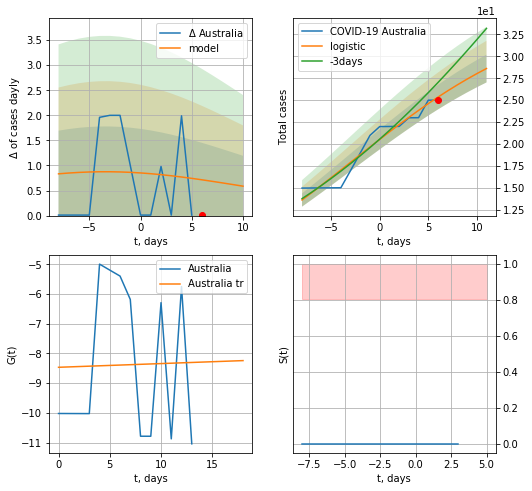

Australia data at: 2020-05-04
model: logistic
coeffs:  [35.98153551  0.09728993 -2.93367767]
rational stdev:  0.0551816162827012
forecast at the end of period: +5 days
	 deltaDaycases:  0
	 total cases:  28 ± 1
	 total death:  0 ± 0
trend coefficient of determination: 0.000431
 intercept: -8.467221
 slope: 0.012491


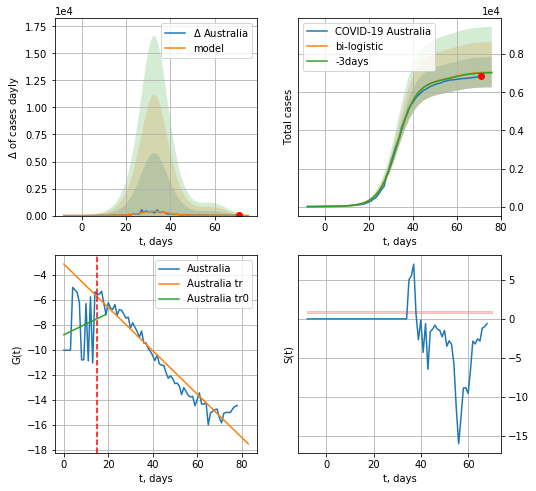

Australia data at: 2020-05-04
+3 day model MAPE: 0.004019373116003379
model: bi-logistic
coeffs:  [6.61176842e+03 2.32467565e-01 3.31651045e+01] [35.98153551  0.09728993 -2.93367767]
scenario coeffs:  [0.0625, 1.0, 1.8]
rational stdev:  0.11210962078221666
forecast at the end of period: +5 days
	 deltaDaycases:  2
	 total cases:  7051 ± 790
	 total death:  98 ± 32
bi-logistic approximation splitting point: 15
trend0 coefficient of determination: 0.022779
 intercept: -8.785888
 slope: 0.086030
trend coefficient of determination: 0.950149
 intercept: -3.133258
 slope: -0.173218


In [665]:
x = forecast('Australia',dfAS[:15],d1,6*7-dT,pMAPE=False)
xx = forecast2('Australia',dfAS[:],d1,6*7-dT,x,vL=15,addpred=True,xcoef=[0.25/4,1.,1.8])

/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


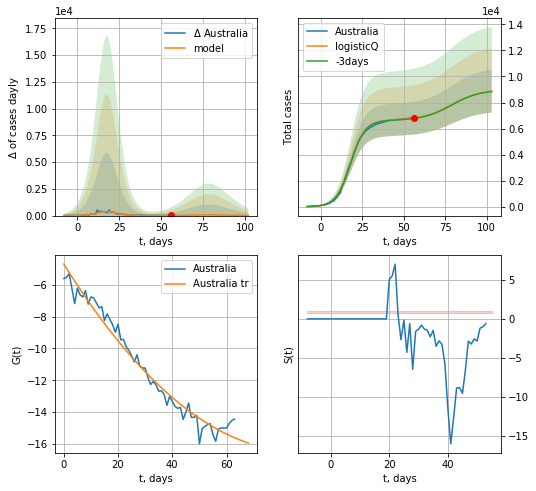

Australia data at: 2020-05-04
+3 day model MAPE: 0.004048
model: logisticQ
coeffs: [ 6.65173602e+03  2.77410129e-06  1.81118032e+01 -8.27444301e+04]
S.Korea scenario coeffs: [0.35416971, 0.02606324, 4.35859408, 19.30413219]
rational stdev: 0.185424
forecast at the end of period: +47 days
	 deltaDaycases: 15
	 total cases: 8869 ± 1644
	 total death: 124 ± 68
trend coefficient of determination: 0.971745
 intercept_: -4.704494963777984
 coeffs_: [ 0.         -0.27263439  0.00157823]


In [666]:
x = forecastRRR('Australia',dfAS[15:],d1,12*7-dT,addpred=True,xcoef=koreaCoeffs)

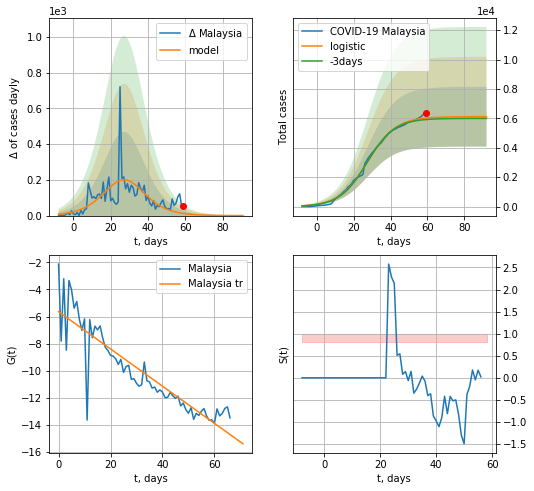

Malaysia data at: 2020-05-04
+3 day model MAPE: 0.01738377446991993
model: logistic
coeffs:  [6.11727585e+03 1.31296269e-01 2.76343736e+01]
rational stdev:  0.3326217908653035
forecast at the end of period: +33 days
	 deltaDaycases:  0
	 total cases:  6115 ± 2034
	 total death:  101 ± 100
trend coefficient of determination: 0.797645
 intercept: -5.644572
 slope: -0.137779


In [667]:
x = forecast('Malaysia',dfML[:],d1,10*7-dT,addpred=False,xcoef=[0.25/2,1.,2.2])

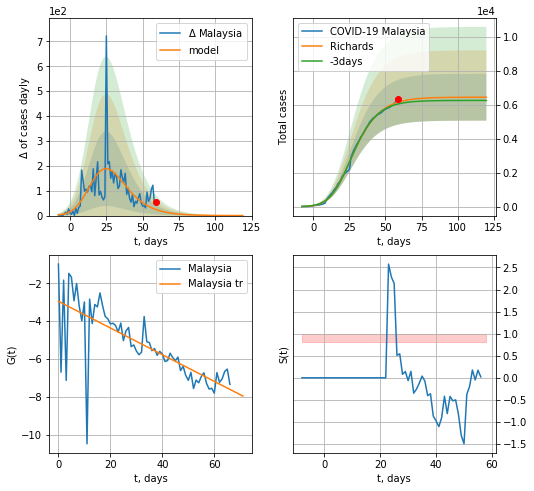

Malaysia data at: 2020-05-04
+3 day model MAPE: 0.017994
model: Richards
coeffs: [6.44506955e+03 3.07785695e-01 1.18777758e+01 2.95722812e-01]
rational stdev: 0.214132
forecast at the end of period: +61 days
	 deltaDaycases: 0
	 total cases: 6443 ± 1379
	 total death: 106 ± 68
trend coefficient of determination: 0.542234
 intercept: -2.950773
 slope: -0.070493


In [668]:
x = forecastRR('Malaysia',dfML[:],d1,14*7-dT)

/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


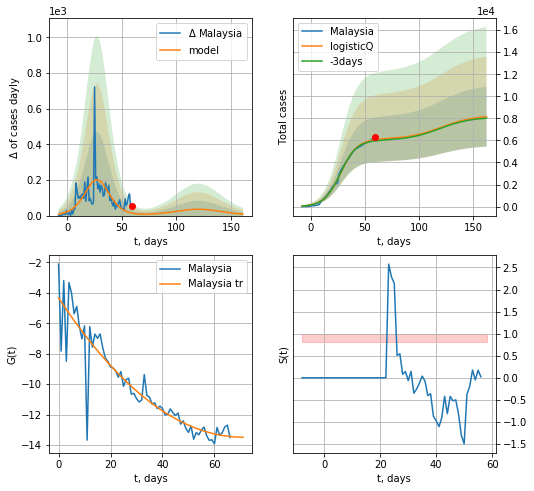

Malaysia data at: 2020-05-04
+3 day model MAPE: 0.017457
model: logisticQ
coeffs: [ 6.11686701e+03  1.60200441e-06  2.76338772e+01 -8.19186535e+04]
S.Korea scenario coeffs: [0.35416971, 0.02606324, 4.35859408, 19.30413219]
rational stdev: 0.332729
forecast at the end of period: +103 days
	 deltaDaycases: 8
	 total cases: 8152 ± 2712
	 total death: 134 ± 133
trend coefficient of determination: 0.839474
 intercept_: -4.341920078543348
 coeffs_: [ 0.         -0.25804474  0.00182237]


In [669]:
x = forecastRRR('Malaysia',dfML[:],d1,20*7-dT,addpred=True,xcoef=koreaCoeffs)

ZL
          date   cases  active  death
62 2020-04-30  1479.0     208   19.0
63 2020-05-01  1485.0     202   20.0
64 2020-05-02  1487.0     201   20.0
65 2020-05-03  1487.5     191   20.0
66 2020-05-04  1487.8     164   20.0


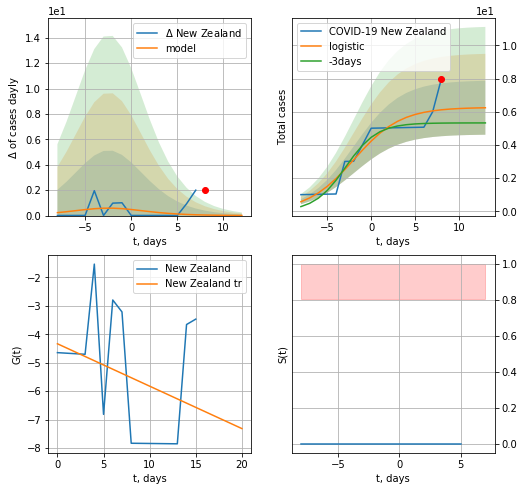

New Zealand data at: 2020-05-04
model: logistic
coeffs:  [ 6.26235961  0.37662733 -1.95315921]
rational stdev:  0.26005250078288755
forecast at the end of period: +5 days
	 deltaDaycases:  0
	 total cases:  6 ± 1
	 total death:  0 ± 0
trend coefficient of determination: 0.103357
 intercept: -4.332661
 slope: -0.149156


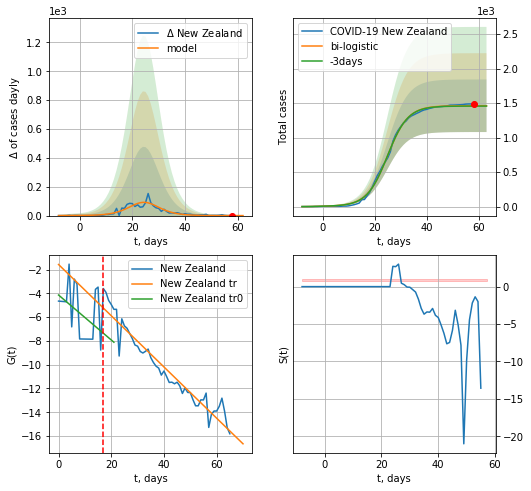

New Zealand data at: 2020-05-04
+3 day model MAPE: 0.0033799381152867544
model: bi-logistic
coeffs:  [1.45505069e+03 2.53440717e-01 2.48761277e+01] [ 6.26235961  0.37662733 -1.95315921]
rational stdev:  0.26045786772190305
forecast at the end of period: +5 days
	 deltaDaycases:  0
	 total cases:  1461 ± 380
	 total death:  19 ± 14
bi-logistic approximation splitting point: 17
trend0 coefficient of determination: 0.175036
 intercept: -4.131936
 slope: -0.189301
trend coefficient of determination: 0.928590
 intercept: -1.563057
 slope: -0.215665


In [670]:
vL=17
dfZL = read_df(pd.DataFrame(),"ZL")
x = forecast('New Zealand',dfZL[:vL],d1,6*7-dT,pMAPE=False)
xx = forecast2('New Zealand',dfZL[:],d1,6*7-dT,x,addpred=False,xcoef=[0.25,1.,2.],vL=vL)#

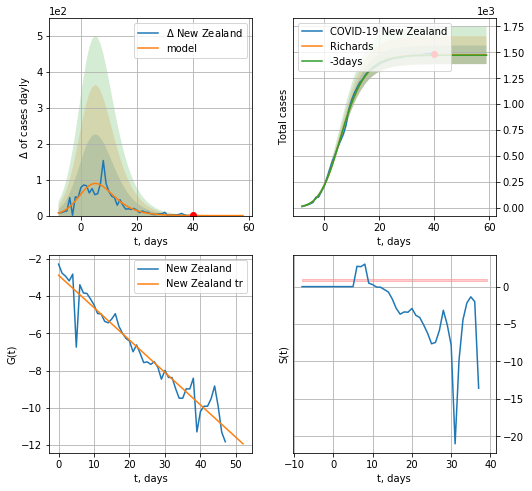

New Zealand data at: 2020-05-04
+3 day model MAPE: 0.002495
model: Richards
coeffs: [1.47609286e+03 4.42504679e-01 1.73472415e+00 4.54605220e-01]
rational stdev: 0.060742
forecast at the end of period: +19 days
	 deltaDaycases: 0
	 total cases: 1476 ± 89
	 total death: 19 ± 3
trend coefficient of determination: 0.925415
 intercept: -2.876582
 slope: -0.174337


In [672]:
x = forecastRR('New Zealand',dfZL[18:],d1,8*7-dT)

/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


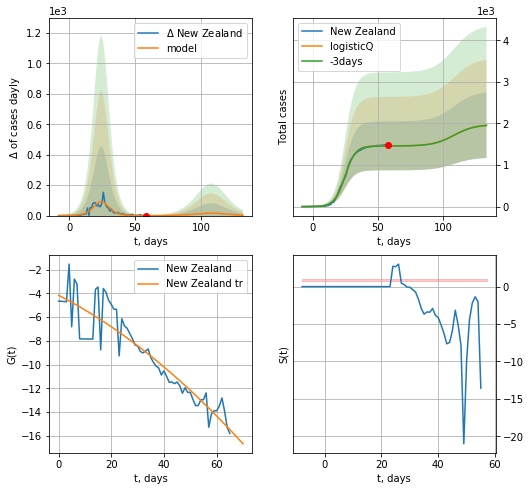

New Zealand data at: 2020-05-04
+3 day model MAPE: 0.003319
model: logisticQ
coeffs: [ 1.46208383e+03  4.25469532e-06  2.48338156e+01 -5.89157925e+04]
S.Korea scenario coeffs: [0.35416971, 0.02606324, 4.35859408, 19.30413219]
rational stdev: 0.402813
forecast at the end of period: +75 days
	 deltaDaycases: 2
	 total cases: 1958 ± 788
	 total death: 26 ± 31
trend coefficient of determination: 0.852019
 intercept_: -4.16083440993709
 coeffs_: [ 0.         -0.11391724 -0.00092757]


In [673]:
x = forecastRRR('New Zealand',dfZL[:],d1,16*7-dT,addpred=True,xcoef=koreaCoeffs)

BR
          date    cases  active  death
62 2020-04-30  14027.0   11552   89.0
63 2020-05-01  14917.0   11906   93.0
64 2020-05-02  15828.0   12614   97.0
65 2020-05-03  16705.0   13410   99.0
66 2020-05-04  17489.0   14127  103.0


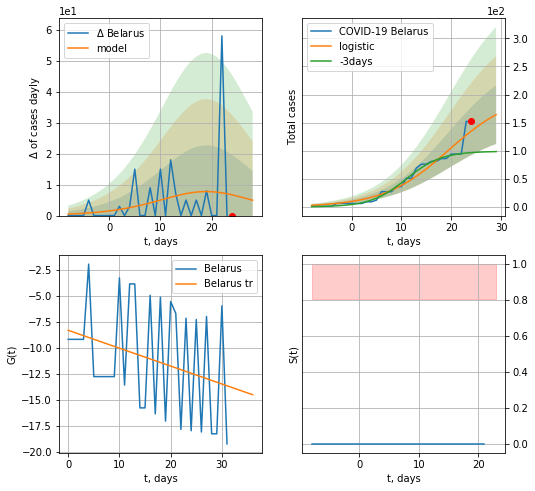

Belarus data at: 2020-05-04
+3 day model MAPE: 0.45662004942481244
model: logistic
coeffs:  [2.01843698e+02 1.53900219e-01 1.94560978e+01]
rational stdev:  0.31755857499649554
forecast at the end of period: +5 days
	 deltaDaycases:  4
	 total cases:  164 ± 52
	 total death:  0 ± 0
trend coefficient of determination: 0.089858
 intercept: -8.339930
 slope: -0.172092


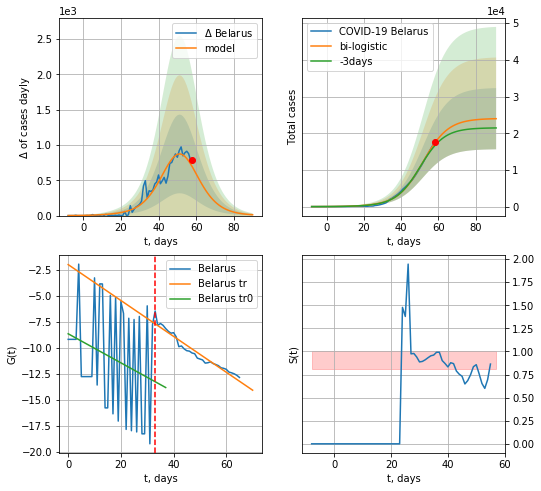

Belarus data at: 2020-05-04
+3 day model MAPE: 0.048706856071314954
model: bi-logistic
coeffs:  [2.38371734e+04 1.46618375e-01 5.16893773e+01] [2.01843698e+02 1.53900219e-01 1.94560978e+01]
rational stdev:  0.34801125116691123
forecast at the end of period: +33 days
	 deltaDaycases:  11
	 total cases:  23964 ± 8339
	 total death:  141 ± 147
bi-logistic approximation splitting point: 33
trend0 coefficient of determination: 0.064228
 intercept: -8.674644
 slope: -0.139700
trend coefficient of determination: 0.945074
 intercept: -2.020227
 slope: -0.172598


In [675]:
dfBR = read_df(pd.DataFrame(),"BR")
x = forecast('Belarus',dfBR[:33],d1,6*7-dT)
xx = forecast2('Belarus',dfBR[:],d1,10*7-dT,x,addpred=False,xcoef=[0.25,1.,1.8],vL=33)

BR
          date    cases  active  death
62 2020-04-30  14027.0   11552   89.0
63 2020-05-01  14917.0   11906   93.0
64 2020-05-02  15828.0   12614   97.0
65 2020-05-03  16705.0   13410   99.0
66 2020-05-04  17489.0   14127  103.0


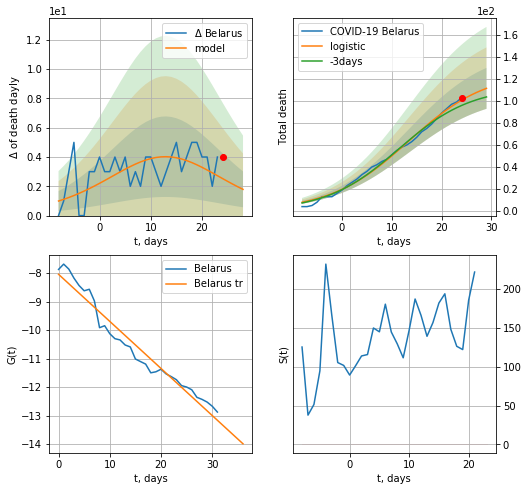

Belarus data at: 2020-05-04
+3 day model MAPE: 0.05563396165984794
model: logistic
coeffs:  [126.78403364   0.12693338  13.35077024]
rational stdev:  0.16693888236139884
forecast at the end of period: +5 days
	 total death:  111 ± 18
trend coefficient of determination: 0.955478
 intercept: -8.042390
 slope: -0.165154


In [676]:
dfBR = read_df(pd.DataFrame(),"BR")
x = forecast('Belarus',dfBR[34:],d1,6*7-dT,cases='death')

/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:18: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:18: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


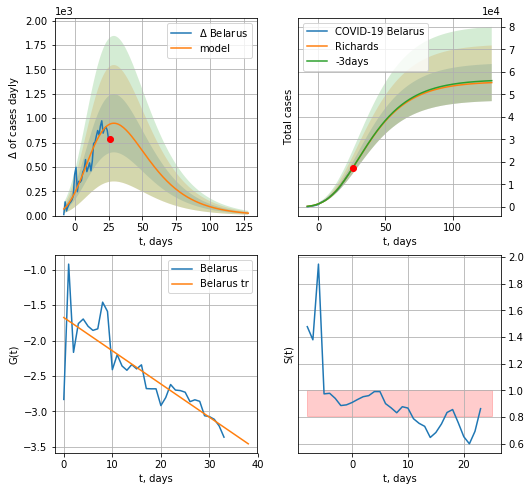

Belarus data at: 2020-05-04
+3 day model MAPE: 0.001048
model: Richards
coeffs: [ 5.57701566e+04  1.76625856e+00 -4.81570612e+01  2.65064994e-02]
rational stdev: 0.149255
forecast at the end of period: +103 days
	 deltaDaycases: 24
	 total cases: 55246 ± 8245
	 total death: 325 ± 145
trend coefficient of determination: 0.691042
 intercept: -1.674484
 slope: -0.046927


/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:153: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


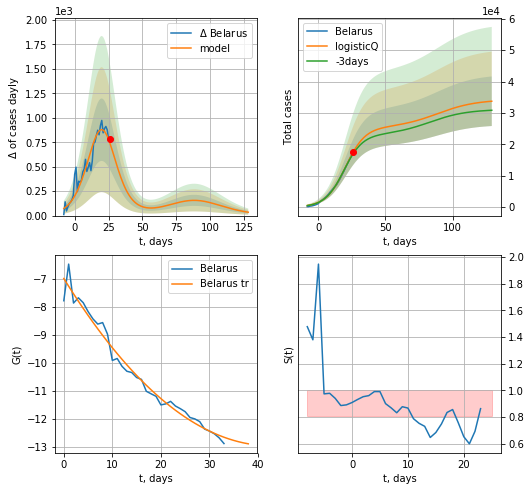

Belarus data at: 2020-05-04
+3 day model MAPE: 0.035494
model: logisticQ
coeffs: [ 2.52738208e+04  6.82379899e-06  2.03377374e+01 -2.02453368e+04]
S.Korea scenario coeffs: [0.35416971, 0.02606324, 4.35859408, 19.30413219]
rational stdev: 0.234108
forecast at the end of period: +103 days
	 deltaDaycases: 34
	 total cases: 33714 ± 7892
	 total death: 198 ± 139
trend coefficient of determination: 0.975505
 intercept_: -6.996510230019162
 coeffs_: [ 0.         -0.27926896  0.00327267]


In [677]:
x = forecastRR('Belarus',dfBR[32:],d1,20*7-dT)
x = forecastRRR('Belarus',dfBR[32:],d1,20*7-dT,addpred=True,xcoef=koreaCoeffs)

/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


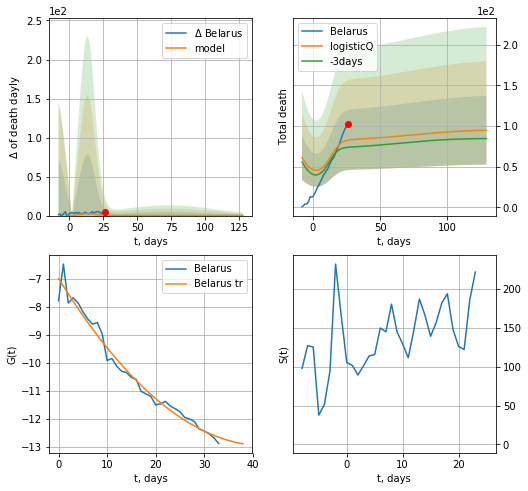

Belarus data at: 2020-05-04
+3 day model MAPE: 0.120693
model: logisticQ
coeffs: [ 7.06815655e+01  8.46783464e-03  5.76557413e+00 -9.26477503e-01]
S.Korea scenario coeffs: [0.35416971, 0.02606324, 4.35859408, 19.30413219]
rational stdev: 0.445252
forecast at the end of period: +103 days
	 total death: 94 ± 42
trend coefficient of determination: 0.975505
 intercept_: -6.996510230019162
 coeffs_: [ 0.         -0.27926896  0.00327267]


In [678]:
x = forecastRRR('Belarus',dfBR[32:],d1,20*7-dT,addpred=True,xcoef=koreaCoeffs,cases='death')

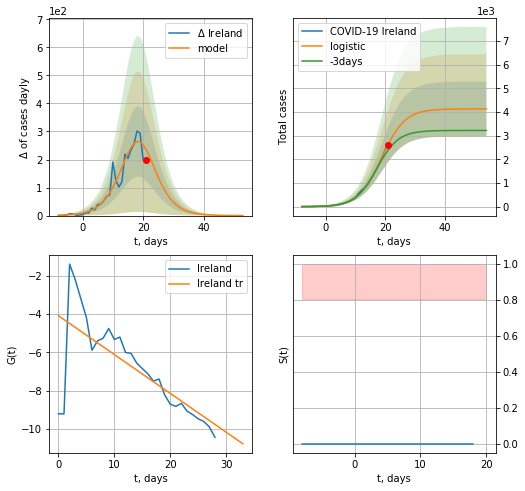

Ireland data at: 2020-05-04
+3 day model MAPE: 0.12282208812559416
model: logistic
coeffs:  [4.12730398e+03 2.56984382e-01 1.88154165e+01]
rational stdev:  0.27980533262906077
forecast at the end of period: +33 days
	 deltaDaycases:  0
	 total cases:  4126 ± 1154
	 total death:  250 ± 209
trend coefficient of determination: 0.521820
 intercept: -4.083344
 slope: -0.202899


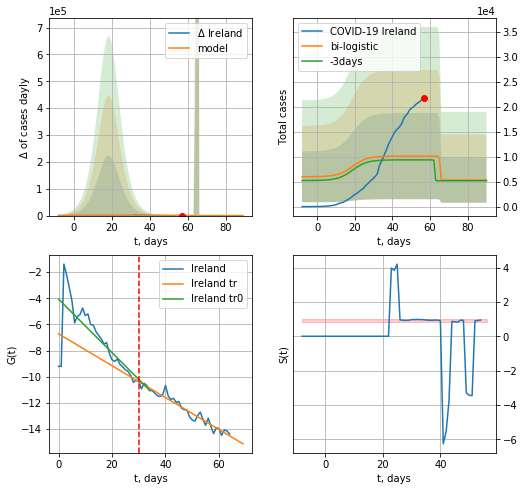

Ireland data at: 2020-05-04
+3 day model MAPE: 0.08014745376390177
model: bi-logistic
coeffs:  [4774.0077072   -10.11900847   65.21004752] [4.12730398e+03 2.56984382e-01 1.88154165e+01]
scenario coeffs:  [0.25, 1.0, 1.8]
rational stdev:  0.8530037680694647
forecast at the end of period: +33 days
	 deltaDaycases:  0
	 total cases:  5320 ± 4538
	 total death:  322 ± 824
bi-logistic approximation splitting point: 30
trend0 coefficient of determination: 0.551550
 intercept: -4.065434
 slope: -0.204818
trend coefficient of determination: 0.944016
 intercept: -6.723219
 slope: -0.121982


In [679]:
vL=30
x = forecast('Ireland',dfIR[:vL],d1,10*7-dT)
xx = forecast2('Ireland',dfIR[:],d1,10*7-dT,x,addpred=True,xcoef=[0.25,1.,1.8],vL=vL)

/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:18: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:18: RuntimeWarning: divide by zero encountered in true_divide


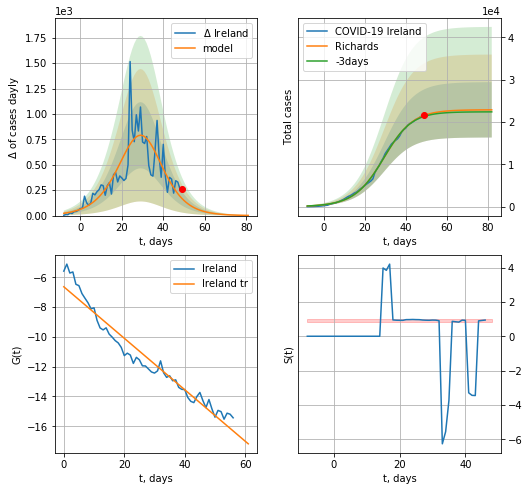

Ireland data at: 2020-05-04
+3 day model MAPE: 0.011641
model: Richards
coeffs: [2.29017617e+04 1.29080550e-01 3.02352992e+01 1.10418815e+00]
rational stdev: 0.285484
forecast at the end of period: +33 days
	 deltaDaycases: 1
	 total cases: 22888 ± 6534
	 total death: 1386 ± 1187
trend coefficient of determination: 0.946587
 intercept: -6.639052
 slope: -0.172787


/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:153: RuntimeWarning: overflow encountered in exp


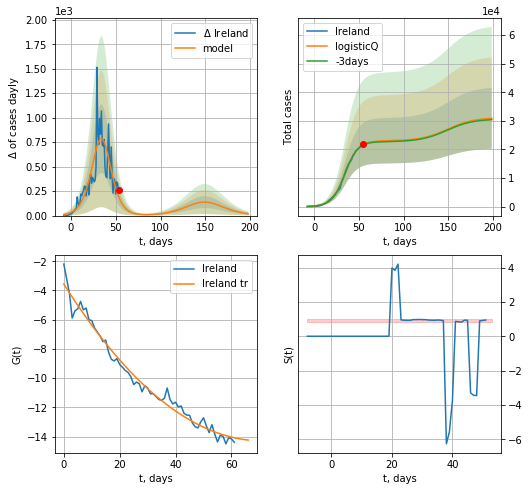

Ireland data at: 2020-05-04
+3 day model MAPE: 0.008029
model: logisticQ
coeffs: [ 2.30265904e+04  7.33387669e-05  3.43197580e+01 -1.82681270e+03]
S.Korea scenario coeffs: [0.35416971, 0.02606324, 4.35859408, 19.30413219]
rational stdev: 0.345108
forecast at the end of period: +145 days
	 deltaDaycases: 18
	 total cases: 30905 ± 10665
	 total death: 1872 ± 1938
trend coefficient of determination: 0.979889
 intercept_: -3.559875104157376
 coeffs_: [ 0.         -0.30229193  0.00212978]


In [680]:
x = forecastRR('Ireland',dfIR[8:],d1,10*7-dT)
x = forecastRRR('Ireland',dfIR[3:],d1,26*7-dT,addpred=True,xcoef=koreaCoeffs)

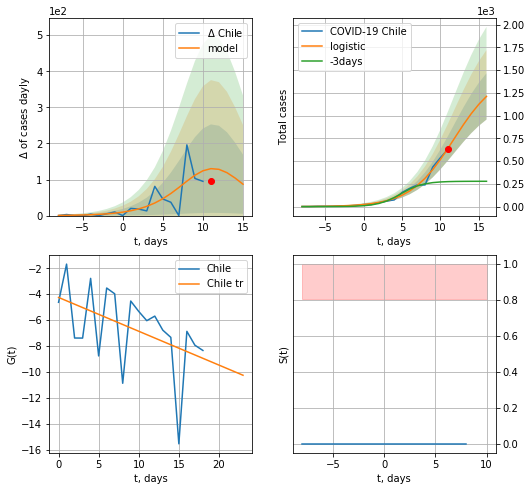

Chile data at: 2020-05-04
+3 day model MAPE: 1.7934705345739388
model: logistic
coeffs:  [1.48202088e+03 3.52936511e-01 1.17607351e+01]
rational stdev:  0.2100967778814968
forecast at the end of period: +5 days
	 deltaDaycases:  87
	 total cases:  1210 ± 254
	 total death:  15 ± 9
trend coefficient of determination: 0.220917
 intercept: -4.249067
 slope: -0.261154


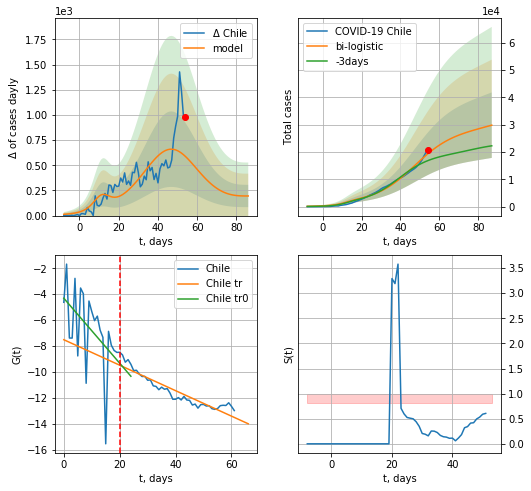

Chile data at: 2020-05-04
+3 day model MAPE: 0.1632827514476613
model: bi-logistic
coeffs:  [2.66581511e+04 9.80388844e-02 4.70860334e+01] [1.48202088e+03 3.52936511e-01 1.17607351e+01]
scenario coeffs:  [0.25, 1.0, 2.0]
rational stdev:  0.40211414217332453
forecast at the end of period: +33 days
	 deltaDaycases:  194
	 total cases:  29824 ± 11992
	 total death:  390 ± 470
bi-logistic approximation splitting point: 20
trend0 coefficient of determination: 0.233377
 intercept: -4.310588
 slope: -0.250901
trend coefficient of determination: 0.872569
 intercept: -7.513990
 slope: -0.098330


In [681]:
vL=20
x = forecast('Chile',dfCL[:vL],d1,6*7-dT)
xx = forecast2('Chile',dfCL[:],d1,10*7-dT,x,addpred=True,xcoef=[0.25,1.,2.],vL=vL)

/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:18: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:18: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


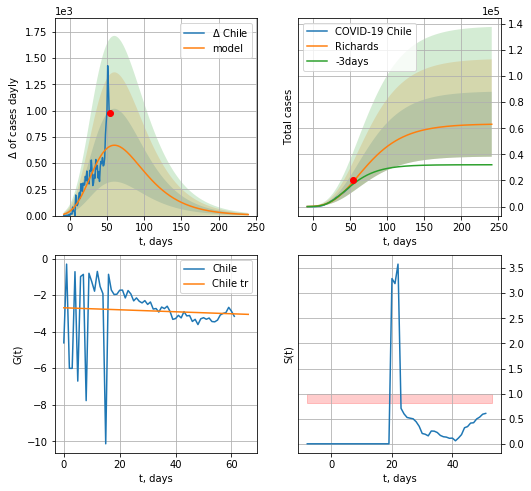

Chile data at: 2020-05-04
+3 day model MAPE: 0.114826
model: Richards
coeffs: [ 6.33794856e+04  2.49138934e+00 -9.37681897e+01  1.15983809e-02]
rational stdev: 0.394021
forecast at the end of period: +187 days
	 deltaDaycases: 10
	 total cases: 63036 ± 24837
	 total death: 824 ± 974
trend coefficient of determination: 0.003554
 intercept: -2.696764
 slope: -0.005459


/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:153: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


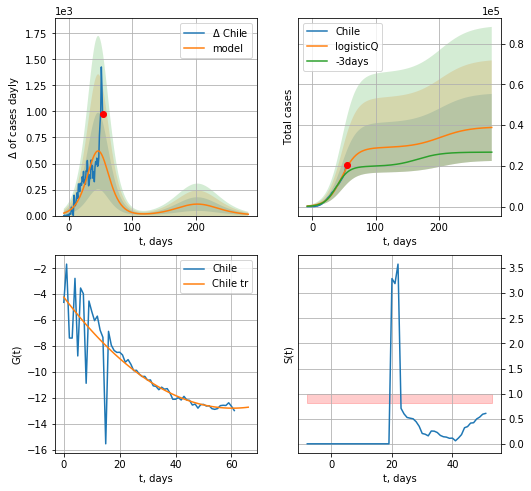

Chile data at: 2020-05-04
+3 day model MAPE: 0.159172
model: logisticQ
coeffs: [ 2.89117429e+04  1.16256965e-06  4.64436830e+01 -7.37875646e+04]
S.Korea scenario coeffs: [0.35416971, 0.02606324, 4.35859408, 19.30413219]
rational stdev: 0.423399
forecast at the end of period: +229 days
	 deltaDaycases: 13
	 total cases: 38844 ± 16446
	 total death: 508 ± 645
trend coefficient of determination: 0.750489
 intercept_: -4.225554906537425
 coeffs_: [ 0.         -0.28408898  0.00235348]


In [682]:
x = forecastRR('Chile',dfCL[:],d1,32*7-dT)
x = forecastRRR('Chile',dfCL[:],d1,38*7-dT,addpred=True,xcoef=koreaCoeffs)

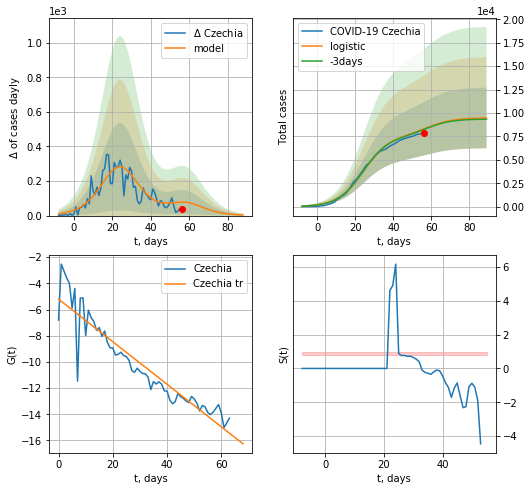

Czechia data at: 2020-05-04
+3 day model MAPE: 0.007608907179709348
model: logistic
coeffs:  [7.59111635e+03 1.48029537e-01 2.43608833e+01]
scenario coeffs:  [0.25, 1.0, 2.4]
rational stdev:  0.3423249954643067
forecast at the end of period: +33 days
	 deltaDaycases:  3
	 total cases:  9467 ± 3241
	 total death:  305 ± 313
trend coefficient of determination: 0.874246
 intercept: -5.208533
 slope: -0.162530


In [683]:
x = forecast('Czechia',dfCH[:],d1,10*7-dT,shift=1.,addpred=True,xcoef=[0.25,1.,2.4])

/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:18: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:18: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


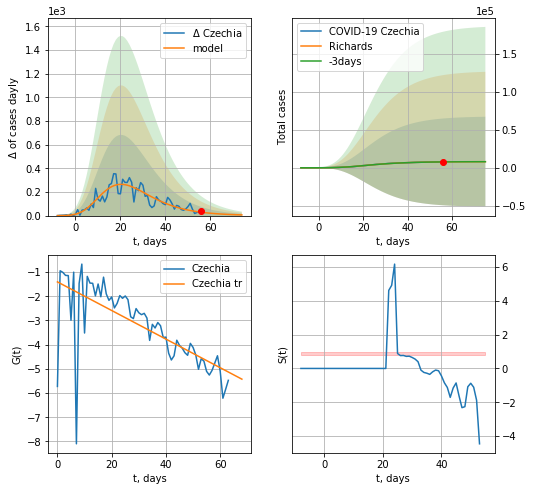

Czechia data at: 2020-05-04
+3 day model MAPE: 0.004460
model: Richards
coeffs: [ 8.08789496e+03  5.46014515e+00 -2.51220169e+01  1.64035757e-02]
rational stdev: 7.374315
forecast at the end of period: +19 days
	 deltaDaycases: 5
	 total cases: 8025 ± 59180
	 total death: 258 ± 5707
trend coefficient of determination: 0.488894
 intercept: -1.407263
 slope: -0.059084


/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:153: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


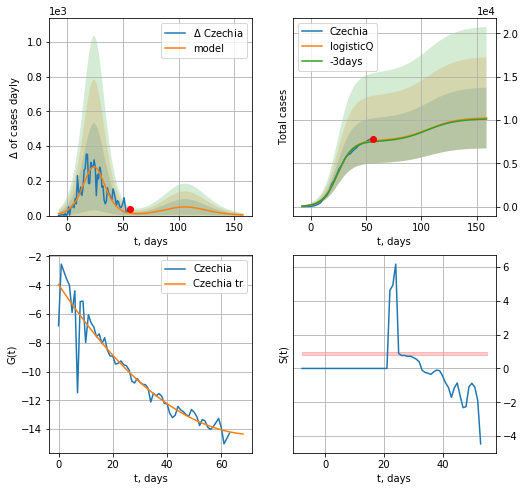

Czechia data at: 2020-05-04
+3 day model MAPE: 0.013074
model: logisticQ
coeffs: [ 7.59088486e+03  1.19499572e-06  2.43609188e+01 -1.23821509e+05]
S.Korea scenario coeffs: [0.35416971, 0.02606324, 4.35859408, 19.30413219]
rational stdev: 0.342425
forecast at the end of period: +103 days
	 deltaDaycases: 3
	 total cases: 10227 ± 3502
	 total death: 329 ± 337
trend coefficient of determination: 0.908149
 intercept_: -3.9493711038252943
 coeffs_: [ 0.         -0.28441092  0.00193483]


In [684]:
x = forecastRR('Czechia',dfCH[:],d1,8*7-dT)
x = forecastRRR('Czechia',dfCH[:],d1,20*7-dT,addpred=True,xcoef=koreaCoeffs)

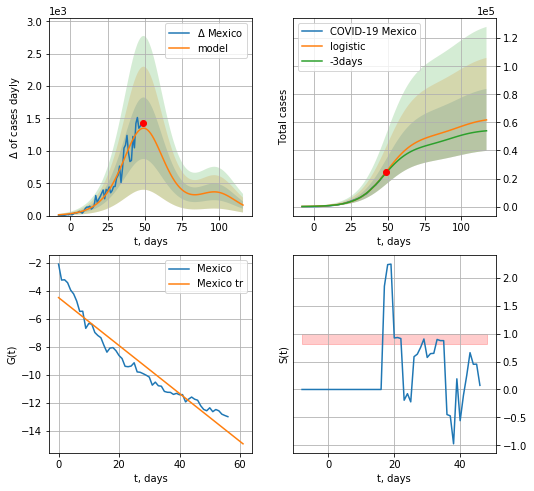

Mexico data at: 2020-05-04
+3 day model MAPE: 0.033394738684907437
model: logistic
coeffs:  [5.07877946e+04 1.05797089e-01 4.95252332e+01]
scenario coeffs:  [0.25, 1.0, 2.0]
rational stdev:  0.3573544986861364
forecast at the end of period: +68 days
	 deltaDaycases:  162
	 total cases:  61791 ± 22081
	 total death:  5634 ± 6040
trend coefficient of determination: 0.924879
 intercept: -4.470437
 slope: -0.171244


In [685]:
x = forecast('Mexico',dfMX[:],d1,15*7-dT,addpred=True,xcoef=[.25,1.,2.])#

/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


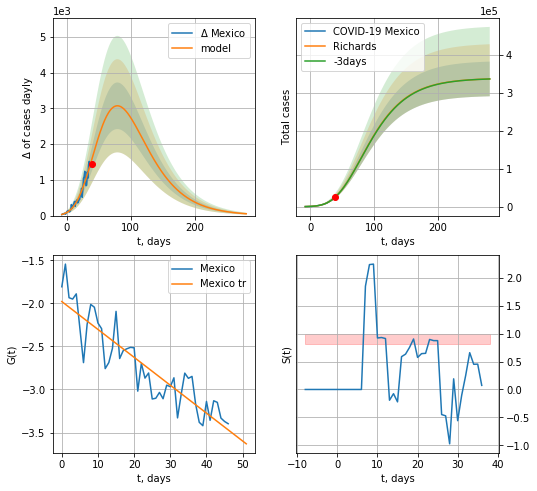

Mexico data at: 2020-05-04
+3 day model MAPE: 0.002256
model: Richards
coeffs: [ 3.37924520e+05  4.72709599e-01 -3.58028002e+01  5.36435091e-02]
rational stdev: 0.135831
forecast at the end of period: +243 days
	 deltaDaycases: 50
	 total cases: 335938 ± 45630
	 total death: 30633 ± 12482
trend coefficient of determination: 0.813185
 intercept: -1.979404
 slope: -0.032384


/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


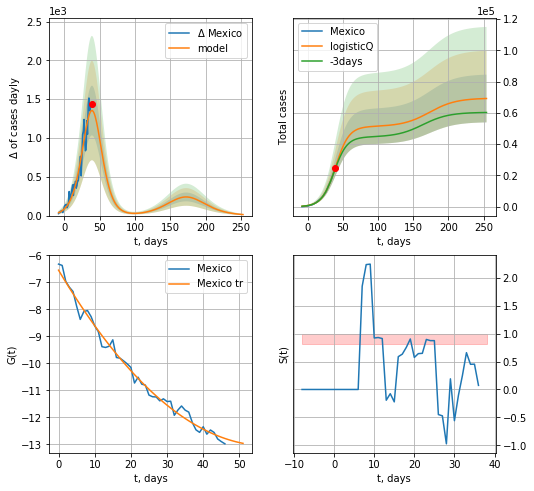

Mexico data at: 2020-05-04
+3 day model MAPE: 0.031841
model: logisticQ
coeffs: [ 5.12587968e+04  1.28537644e-05  3.96807974e+01 -8.17746093e+03]
S.Korea scenario coeffs: [0.35416971, 0.02606324, 4.35859408, 19.30413219]
rational stdev: 0.220484
forecast at the end of period: +215 days
	 deltaDaycases: 13
	 total cases: 69168 ± 15250
	 total death: 6307 ± 4171
trend coefficient of determination: 0.988551
 intercept_: -6.547056879060921
 coeffs_: [ 0.         -0.22512856  0.0019486 ]


In [686]:
x = forecastRR('Mexico',dfMX[10:],d1,40*7-dT,addpred=False,xcoef=[.25,1.,2.])#
x = forecastRRR('Mexico',dfMX[10:],d1,36*7-dT,addpred=True,xcoef=koreaCoeffs)#

LT
          date  cases  active  death   tests
52 2020-04-30   1399     760   45.0  132768
53 2020-05-01   1406     728   45.0  138270
54 2020-05-02   1410     727   46.0  141678
55 2020-05-03   1419     735   46.1  144029
56 2020-05-04   1423     678   46.0  149106


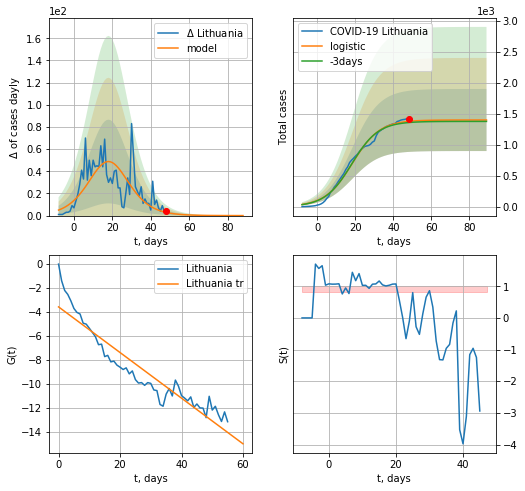

Lithuania data at: 2020-05-04
+3 day model MAPE: 0.014396819691586946
model: logistic
coeffs:  [1.40008741e+03 1.39450563e-01 1.84600918e+01]
rational stdev:  0.3583030475551336
forecast at the end of period: +41 days
	 deltaDaycases:  0
	 total cases:  1400 ± 501
	 total death:  45 ± 48
trend coefficient of determination: 0.881055
 intercept: -3.564614
 slope: -0.190229


In [687]:
vL = 17
dfLT = read_df(pd.DataFrame(),"LT")
x = forecast('Lithuania',dfLT[:],d1,6*7-1)
#xx = forecast2('Lithuania',dfLT[:],d1,8*7-1,x,shift=1.0,addpred=True,xcoef=[.25,1.,2.],vL=vL)

In [688]:
#np.diff(dfLT["cases"])

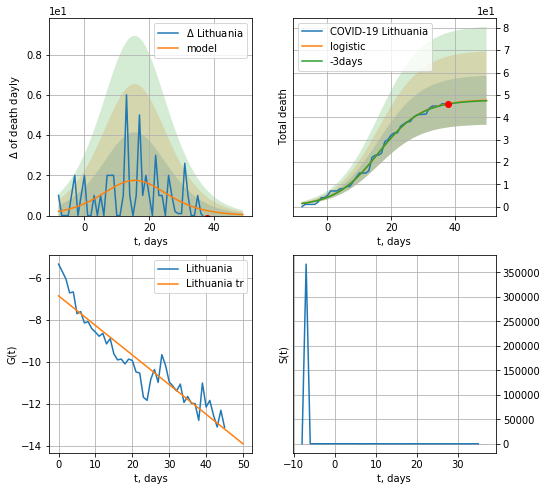

Lithuania data at: 2020-05-04
+3 day model MAPE: 0.004004333972352032
model: logistic
coeffs:  [47.92107226  0.14617652 16.01940865]
rational stdev:  0.2299972810777542
forecast at the end of period: +12 days
	 total death:  47 ± 10
trend coefficient of determination: 0.885619
 intercept: -6.856146
 slope: -0.141263


In [689]:
x = forecast('Lithuania',dfLT[10:],d1,7*7-dT,cases='death')

/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:153: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


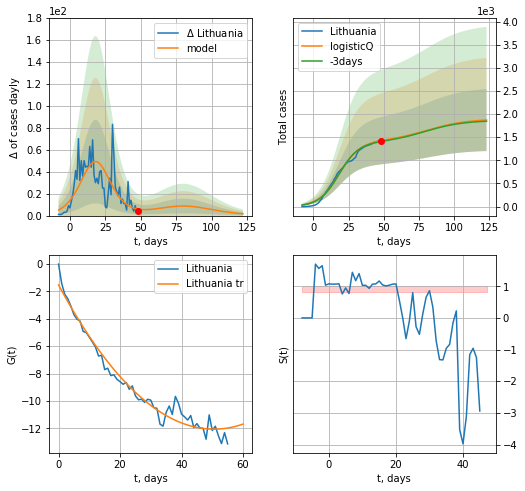

Lithuania data at: 2020-05-04
+3 day model MAPE: 0.012957
model: logisticQ
coeffs: [ 1.40003854e+03  9.08424793e-07  1.84600545e+01 -1.53455362e+05]
S.Korea scenario coeffs: [0.35416971, 0.02606324, 4.35859408, 19.30413219]
rational stdev: 0.358347
forecast at the end of period: +75 days
	 deltaDaycases: 1
	 total cases: 1872 ± 670
	 total death: 60 ± 64
trend coefficient of determination: 0.968183
 intercept_: -1.519874676099799
 coeffs_: [ 0.         -0.41748067  0.00413237]


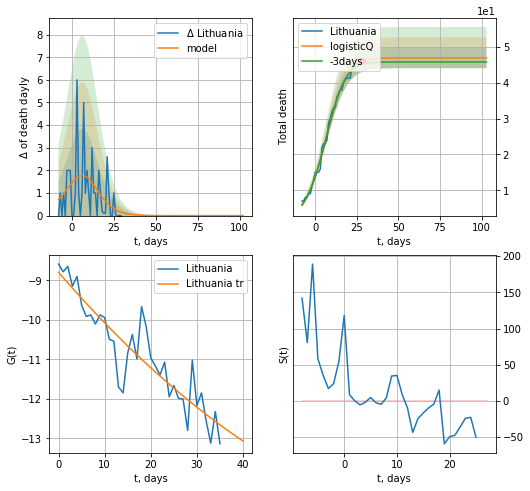

Lithuania data at: 2020-05-04
+3 day model MAPE: 0.016827
model: logisticQ
coeffs: [ 4.69732079e+01  6.70586950e-04  5.86143217e+00 -2.18843043e+02]
rational stdev: 0.061239
forecast at the end of period: +75 days
	 total death: 46 ± 2
trend coefficient of determination: 0.823734
 intercept_: -8.798304973670938
 coeffs_: [ 0.         -0.13470927  0.00070129]


In [690]:
#x = forecast('Lithuania',dfLT[10-4:],d1,6*7-1,cases='active')
x = forecastRRR('Lithuania',dfLT[:],d1,16*7-dT,addpred=True,xcoef=koreaCoeffs)
x = forecastRRR('Lithuania',dfLT[20:],d1,16*7-dT,addpred=False,xcoef=koreaCoeffs,cases='death')

/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:18: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:18: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


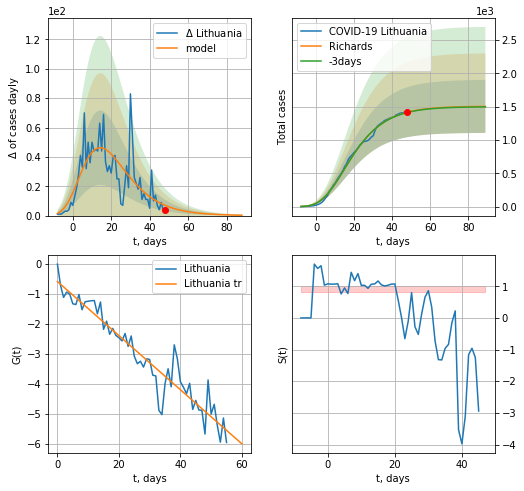

Lithuania data at: 2020-05-04
+3 day model MAPE: 0.003356
model: Richards
coeffs: [ 1.50539456e+03  9.04150925e+00 -4.09913899e+01  9.28453030e-03]
rational stdev: 0.264476
forecast at the end of period: +41 days
	 deltaDaycases: 0
	 total cases: 1502 ± 397
	 total death: 48 ± 38
trend coefficient of determination: 0.908498
 intercept: -0.579530
 slope: -0.090127


In [691]:
x = forecastRR('Lithuania',dfLT[:],d1,6*7-1)
#xx = forecast2R('Lithuania',dfLT[:],d1,2*7-1,x,shift=1.0,addpred=True,xcoef=[0.25,1.,1.5])

/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:15: RuntimeWarning: overflow encountered in exp
  from ipykernel import kernelapp as app
/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:15: RuntimeWarning: overflow encountered in power
  from ipykernel import kernelapp as app
/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1200.
  warnings.warn(errors[info][0], RuntimeWarning)


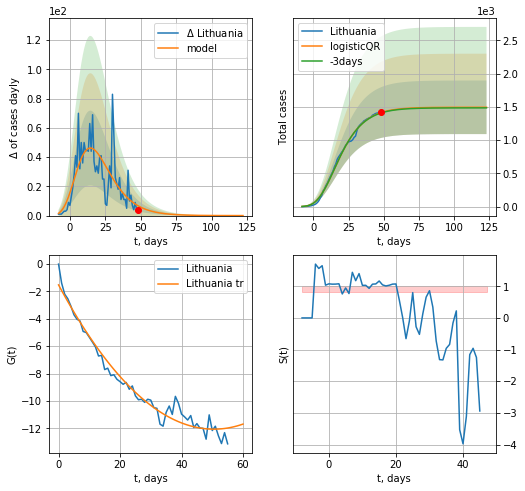

Lithuania data at: 2020-05-04
+3 day model MAPE: 0.004044052770565358
model: logisticQR
coeffs:  [ 1.49502256e+03  4.82069735e-02 -6.84550610e+01 -1.04523337e+03
  1.52714186e-03]
rational stdev:  0.26971961262427513
forecast at the end of period: +75 days
	 deltaDaycases:  0
	 total cases:  1494 ± 403
	 total death:  48 ± 38
trend coefficient of determination: 0.968183
 intercept_: -1.519874676099799
 coeffs_: [ 0.         -0.41748067  0.00413237]


In [692]:
x = forecastQR('Lithuania',dfLT[:],d1,16*7-dT,addpred=False,xcoef=[0.35,.52,4.,1.,1.])

LX
          date   cases  active  death
54 2020-04-30  3784.0     481   90.0
55 2020-05-01  3802.0     497   92.0
56 2020-05-02  3812.0     402   92.0
57 2020-05-03  3824.0     349   96.0
58 2020-05-04  3828.0     327   96.0


/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 800.
  warnings.warn(errors[info][0], RuntimeWarning)


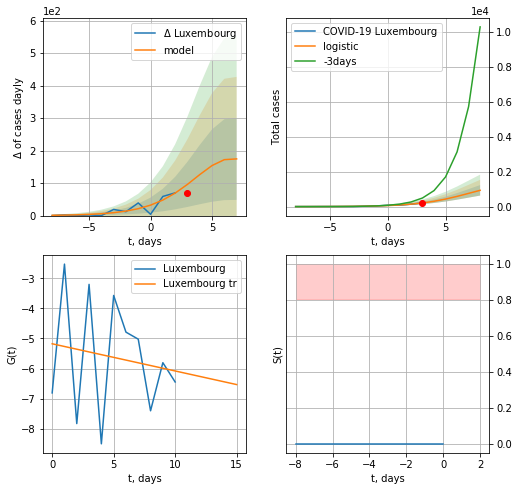

Luxembourg data at: 2020-05-04
model: logistic
coeffs:  [1.56298312e+03 4.51684200e-01 7.13428385e+00]
rational stdev:  0.3215238047871676
forecast at the end of period: +5 days
	 deltaDaycases:  174
	 total cases:  932 ± 299
	 total death:  23 ± 22
trend coefficient of determination: 0.022967
 intercept: -5.176630
 slope: -0.090347


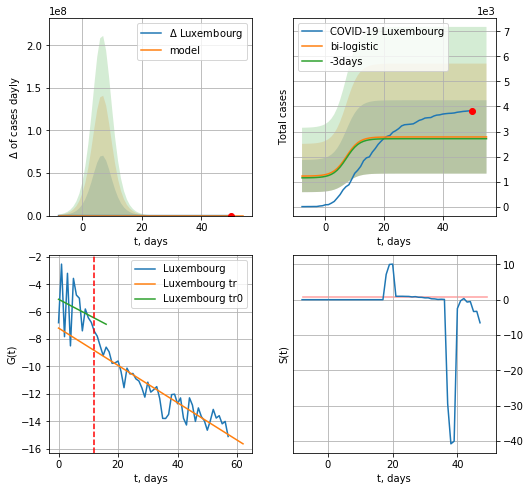

Luxembourg data at: 2020-05-04
+3 day model MAPE: 0.02606519560875768
model: bi-logistic
coeffs:  [1085.03539233   -5.02413788  207.47387809] [1.56298312e+03 4.51684200e-01 7.13428385e+00]
scenario coeffs:  [0.125, 1.0, 2.0]
rational stdev:  0.5258201884576481
forecast at the end of period: +5 days
	 deltaDaycases:  0
	 total cases:  2783 ± 1463
	 total death:  69 ± 108
bi-logistic approximation splitting point: 12
trend0 coefficient of determination: 0.045986
 intercept: -5.098250
 slope: -0.113861
trend coefficient of determination: 0.856369
 intercept: -7.200192
 slope: -0.136278


In [693]:
dfLX = read_df(pd.DataFrame(),"LX")
x = forecast("Luxembourg",dfLX[:12],d1,6*7-dT,pMAPE=False)
xx = forecast2("Luxembourg",dfLX[:],d1,6*7-dT,x,vL=12,addpred=True,xcoef=[0.25/2,1.,2.])

/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:18: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:18: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


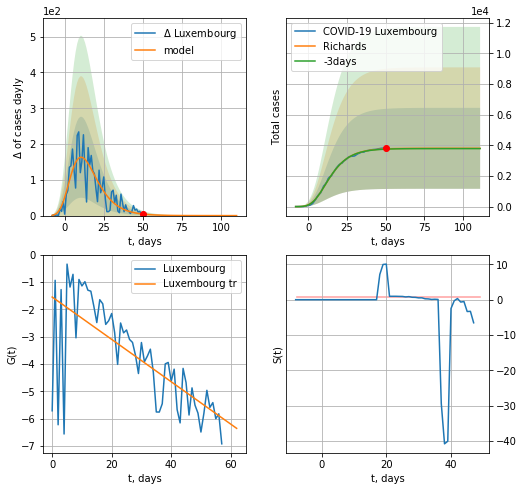

Luxembourg data at: 2020-05-04
+3 day model MAPE: 0.004606
model: Richards
coeffs: [ 3.80463260e+03  1.53921797e+01 -3.06535946e+01  7.61164284e-03]
rational stdev: 0.694089
forecast at the end of period: +61 days
	 deltaDaycases: 0
	 total cases: 3804 ± 2640
	 total death: 95 ± 197
trend coefficient of determination: 0.504384
 intercept: -1.546101
 slope: -0.077625


In [694]:
x = forecastRR("Luxembourg",dfLX[:],d1,14*7-dT)

/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:153: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


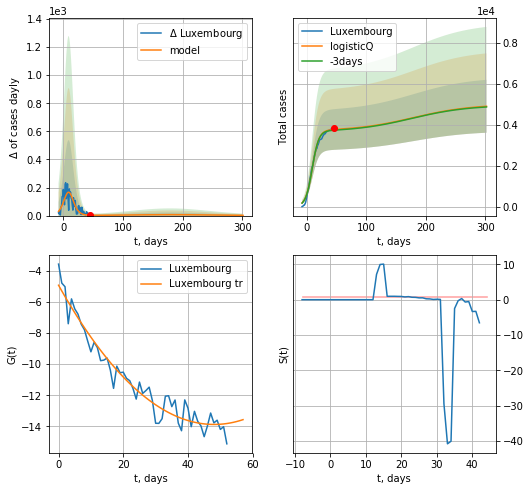

Luxembourg data at: 2020-05-04
+3 day model MAPE: 0.008794
model: logisticQ
coeffs: [ 3.68698650e+03  1.21324316e-06 -1.48439629e+05  9.27333988e+00]
S.Korea scenario coeffs: [0.35416971, 0.02606324, 4.35859408, 19.30413219]
rational stdev: 0.263282
forecast at the end of period: +257 days
	 deltaDaycases: 1
	 total cases: 4895 ± 1288
	 total death: 122 ± 96
trend coefficient of determination: 0.943288
 intercept_: -4.928668677841369
 coeffs_: [ 0.         -0.37214348  0.00387164]


In [695]:
x = forecastRRR("Luxembourg",dfLX[5:],d1,42*7-dT,addpred=True,xcoef=koreaCoeffs)

ED
          date    cases   active   death
61 2020-04-30  24934.0  22476.0   900.0
62 2020-05-01  26336.0  23360.0  1063.0
63 2020-05-02  27464.0  23961.0  1371.0
64 2020-05-03  29538.0  24674.0  1564.0
65 2020-05-04  31881.0  26879.0  1569.0


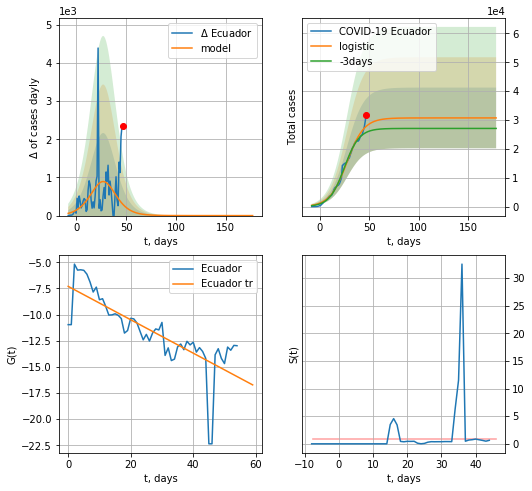

Ecuador data at: 2020-05-04
+3 day model MAPE: 0.08645116522945039
model: logistic
coeffs:  [3.07296476e+04 1.16235195e-01 2.75567798e+01]
rational stdev:  0.34169703599552126
forecast at the end of period: +131 days
	 deltaDaycases:  0
	 total cases:  30729 ± 10500
	 total death:  1512 ± 1549
trend coefficient of determination: 0.603198
 intercept: -7.303684
 slope: -0.159714


In [696]:
dfED = read_df(pd.DataFrame(),"ED")
x = forecast("Ecuador",dfED[10:],d1,24*7-dT)
#xx = forecast2(c,adf[:],d1,4*7-dT,x)

/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:18: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:18: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


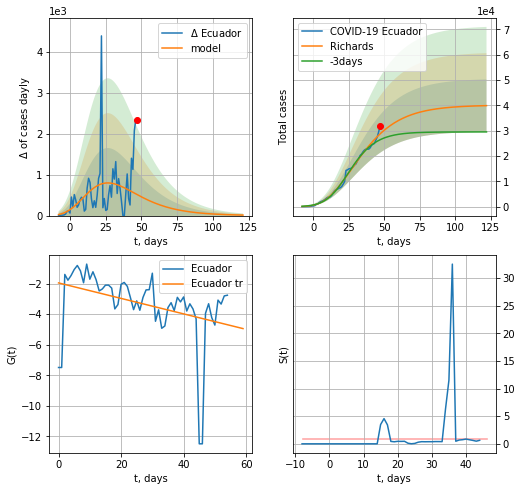

Ecuador data at: 2020-05-04
+3 day model MAPE: 0.095941
model: Richards
coeffs: [ 4.01078564e+04  3.65330437e+00 -5.01397240e+01  1.49337485e-02]
rational stdev: 0.259644
forecast at the end of period: +75 days
	 deltaDaycases: 12
	 total cases: 39884 ± 10355
	 total death: 1962 ± 1528
trend coefficient of determination: 0.129162
 intercept: -1.960703
 slope: -0.050614


In [697]:
x = forecastRR("Ecuador",dfED[10:],d1,16*7-dT,addpred=False,xcoef=[0.35,.5,4.,1.])

/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:153: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


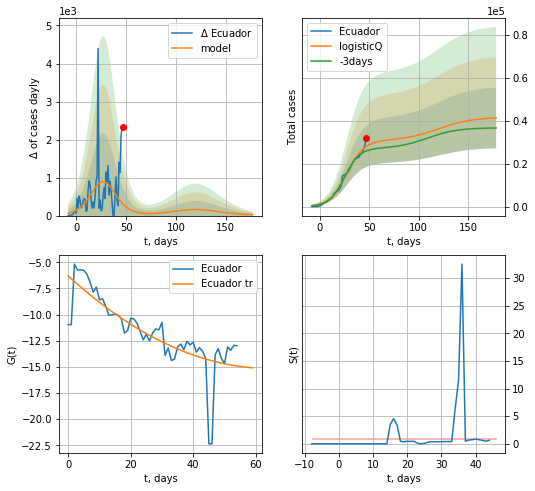

Ecuador data at: 2020-05-04
+3 day model MAPE: 0.085850
model: logisticQ
coeffs: [ 3.07235442e+04  1.55214511e-06  2.75534123e+01 -7.48634821e+04]
S.Korea scenario coeffs: [0.35416971, 0.02606324, 4.35859408, 19.30413219]
rational stdev: 0.341728
forecast at the end of period: +131 days
	 deltaDaycases: 20
	 total cases: 41248 ± 14095
	 total death: 2030 ± 2081
trend coefficient of determination: 0.624533
 intercept_: -6.297136920890916
 coeffs_: [ 0.         -0.27370308  0.00211128]


In [698]:
x = forecastRRR("Ecuador",dfED[10:],d1,24*7-dT,addpred=True,xcoef=koreaCoeffs)

FI
          date   cases  active  death
65 2020-04-30  4995.0    1784  211.0
66 2020-05-01  5051.0    1833  218.0
67 2020-05-02  5176.0    1956  220.0
68 2020-05-03  5254.0    2024  230.0
69 2020-05-04  5327.0    1587  240.0


/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 800.
  warnings.warn(errors[info][0], RuntimeWarning)


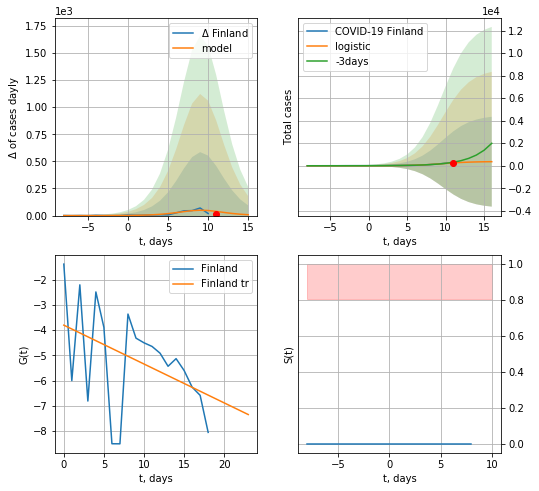

Finland data at: 2020-05-04
+3 day model MAPE: 0.3536794792474036
model: logistic
coeffs:  [373.20900186   0.53490302   9.59276199]
rational stdev:  11.028448708024662
forecast at the end of period: +5 days
	 deltaDaycases:  7
	 total cases:  361 ± 3986
	 total death:  16 ± 529
trend coefficient of determination: 0.182614
 intercept: -3.802910
 slope: -0.153962


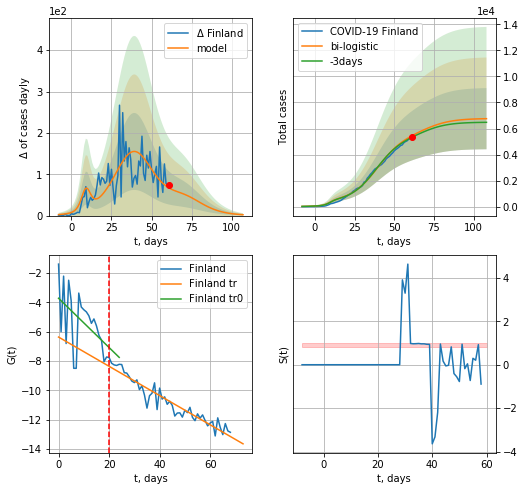

Finland data at: 2020-05-04
+3 day model MAPE: 0.022754345869136175
model: bi-logistic
coeffs:  [5.11979410e+03 1.18534621e-01 3.93006627e+01] [373.20900186   0.53490302   9.59276199]
scenario coeffs:  [0.25, 1.0, 1.8]
rational stdev:  0.34790307099747547
forecast at the end of period: +47 days
	 deltaDaycases:  2
	 total cases:  6756 ± 2350
	 total death:  304 ± 317
bi-logistic approximation splitting point: 20
trend0 coefficient of determination: 0.234981
 intercept: -3.717136
 slope: -0.168257
trend coefficient of determination: 0.910436
 intercept: -6.367174
 slope: -0.099868


In [699]:
dfFI = read_df(pd.DataFrame(),"FI")
x = forecast("Finland",dfFI[:20],d1,6*7-dT)
xx = forecast2("Finland",dfFI[:],d1,12*7-dT,x,vL=20,addpred=True,xcoef=[0.25,1.,1.8])

/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:18: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:18: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


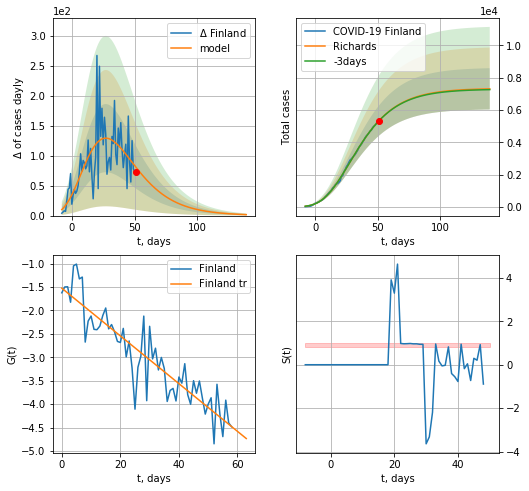

Finland data at: 2020-05-04
+3 day model MAPE: 0.001871
model: Richards
coeffs: [ 7.33614743e+03  2.17765350e+00 -5.11188634e+01  2.22231916e-02]
rational stdev: 0.174996
forecast at the end of period: +89 days
	 deltaDaycases: 1
	 total cases: 7304 ± 1278
	 total death: 329 ± 172
trend coefficient of determination: 0.818115
 intercept: -1.525271
 slope: -0.050905


In [700]:
x = forecastRR("Finland",dfFI[10:],d1,18*7-dT)

/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:153: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


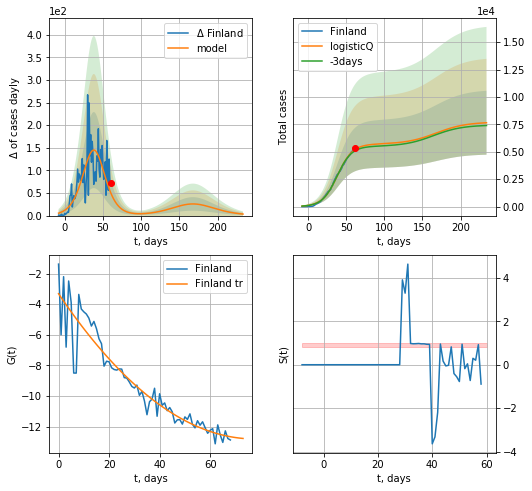

Finland data at: 2020-05-04
+3 day model MAPE: 0.022801
model: logisticQ
coeffs: [ 5.69765754e+03  1.43182798e-06  3.85469348e+01 -7.09290368e+04]
S.Korea scenario coeffs: [0.35416971, 0.02606324, 4.35859408, 19.30413219]
rational stdev: 0.380901
forecast at the end of period: +173 days
	 deltaDaycases: 3
	 total cases: 7648 ± 2913
	 total death: 344 ± 393
trend coefficient of determination: 0.883566
 intercept_: -3.3187569761172657
 coeffs_: [ 0.         -0.24433096  0.00157352]


In [701]:
x = forecastRRR("Finland",dfFI[:],d1,30*7-dT,addpred=True,xcoef=koreaCoeffs)

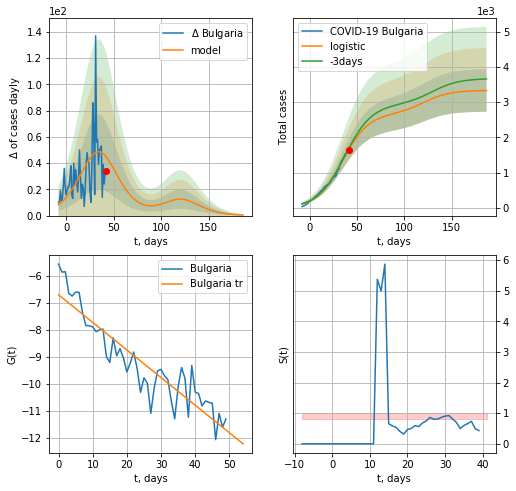

Bulgaria data at: 2020-05-04
+3 day model MAPE: 0.02293557844971459
model: logistic
coeffs:  [2.66948825e+03 7.27220377e-02 3.46182103e+01]
scenario coeffs:  [0.25, 1.0, 3.5]
rational stdev:  0.18044900580918866
forecast at the end of period: +145 days
	 deltaDaycases:  0
	 total cases:  3331 ± 601
	 total death:  157 ± 84
trend coefficient of determination: 0.841917
 intercept: -6.697082
 slope: -0.102148


In [702]:
x = forecast('Bulgaria',dfBL[5:],d1,26*7-dT,shift=1.0,addpred=True,xcoef=[0.25,1.,3.5])

/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


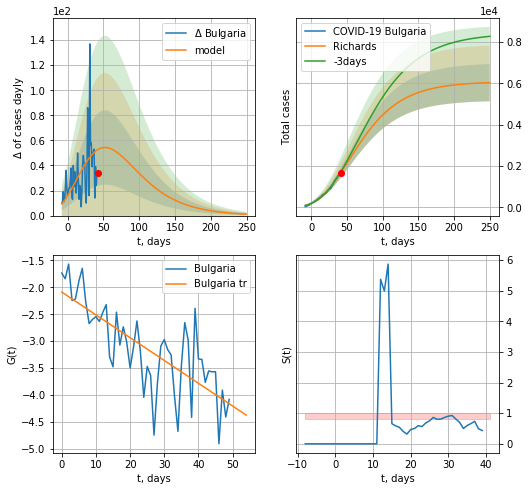

Bulgaria data at: 2020-05-04
+3 day model MAPE: 0.027261
model: Richards
coeffs: [ 6.07738014e+03  9.14578461e-01 -9.41403531e+01  2.69392969e-02]
rational stdev: 0.148876
forecast at the end of period: +208 days
	 deltaDaycases: 1
	 total cases: 6030 ± 897
	 total death: 284 ± 126
trend coefficient of determination: 0.567476
 intercept: -2.088925
 slope: -0.042341


In [703]:
x = forecastRR('Bulgaria',dfBL[5:],d1,35*7-dT,shift=1.0,addpred=False,xcoef=[0.25,1.,4.5])

/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


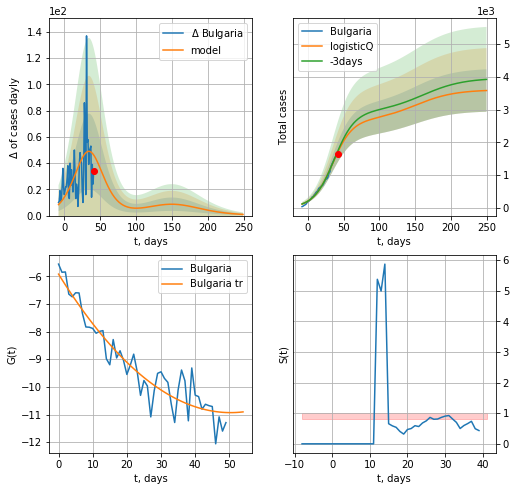

Bulgaria data at: 2020-05-04
+3 day model MAPE: 0.021655
model: logisticQ
coeffs: [ 2.66223516e+03  3.62030306e-06  3.45419314e+01 -2.01040699e+04]
S.Korea scenario coeffs: [0.35416971, 0.02606324, 4.35859408, 19.30413219]
rational stdev: 0.180603
forecast at the end of period: +208 days
	 deltaDaycases: 0
	 total cases: 3581 ± 646
	 total death: 169 ± 91
trend coefficient of determination: 0.894553
 intercept_: -5.92360172676006
 coeffs_: [ 0.         -0.19887214  0.00197436]


In [704]:
x = forecastRRR('Bulgaria',dfBL[5:],d1,35*7-dT,shift=1.0,addpred=True,xcoef=koreaCoeffs)

TH
          date  cases  active  death
63 2020-04-30   2960   187.0   54.0
64 2020-05-01   2966   180.0   54.0
65 2020-05-02   2969   176.0   54.0
66 2020-05-03   2987   193.0   54.0
67 2020-05-04   2988   187.0   54.0


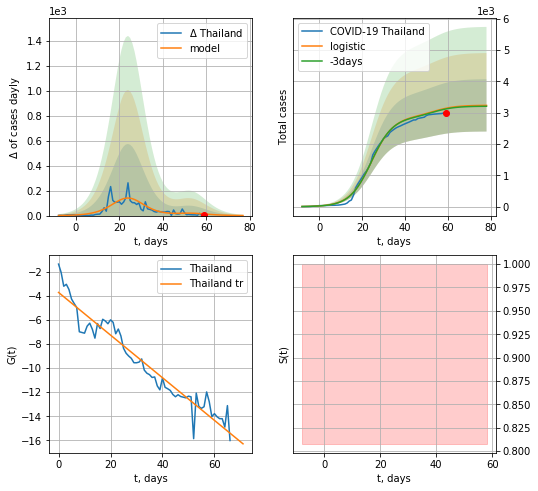

Thailand data at: 2020-05-04
+3 day model MAPE: 0.006978253535519705
model: logistic
coeffs:  [2.87405197e+03 1.96326713e-01 2.44005425e+01]
scenario coeffs:  [0.125, 1.0, 2.2]
rational stdev:  0.2583020900924466
forecast at the end of period: +19 days
	 deltaDaycases:  0
	 total cases:  3230 ± 834
	 total death:  58 ± 44
trend coefficient of determination: 0.928747
 intercept: -3.734548
 slope: -0.176688


In [705]:
dfTH = read_df(pd.DataFrame(),"TH")
x = forecast("Thailand",dfTH[:],d1,8*7-dT,addpred=True,xcoef=[0.25/2,1.,2.2])
#xx = forecast2("Thailand",dfTH[:],d1,8*7-dT,x,vL=20,addpred=True,xcoef=[0.25,1.,1.8])

In [706]:
#x = forecastRR("Thailand",dfTH[20:],d1,8*7-dT,addpred=False,xcoef=[0.25/2,1.,2.2])

/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


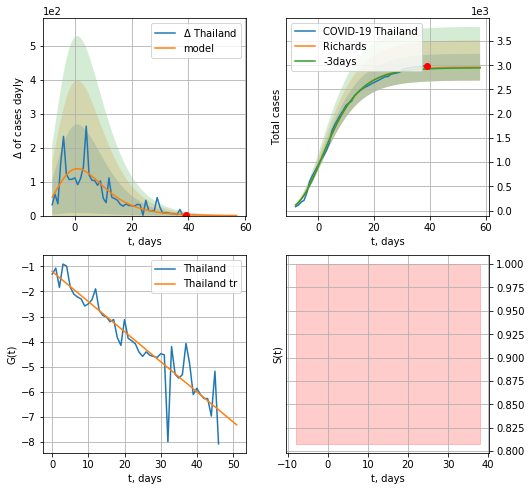

Thailand data at: 2020-05-04
+3 day model MAPE: 0.004724
model: Richards
coeffs: [ 2.96202236e+03  1.56887338e+01 -3.65145010e+01  8.10416922e-03]
rational stdev: 0.093622
forecast at the end of period: +19 days
	 deltaDaycases: 0
	 total cases: 2959 ± 277
	 total death: 53 ± 14
trend coefficient of determination: 0.858033
 intercept: -1.207754
 slope: -0.119690


In [707]:
x = forecastRR("Thailand",dfTH[20:],d1,8*7-dT,addpred=False,xcoef=[0.35/6,.5,4,1])

/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


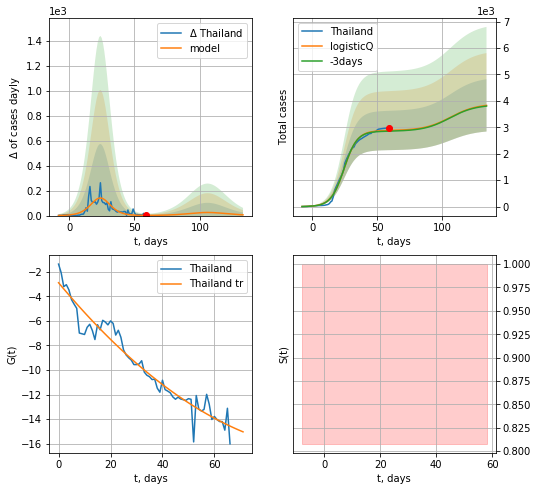

Thailand data at: 2020-05-04
+3 day model MAPE: 0.008838
model: logisticQ
coeffs: [ 2.87402292e+03  1.77320025e-06  2.44009091e+01 -1.10658319e+05]
S.Korea scenario coeffs: [0.35416971, 0.02606324, 4.35859408, 19.30413219]
rational stdev: 0.258310
forecast at the end of period: +75 days
	 deltaDaycases: 6
	 total cases: 3829 ± 989
	 total death: 69 ± 53
trend coefficient of determination: 0.940912
 intercept_: -2.900322832480459
 coeffs_: [ 0.         -0.25371389  0.00116722]


In [708]:
x = forecastRRR("Thailand",dfTH[:],d1,16*7-dT,addpred=True,xcoef=koreaCoeffs)

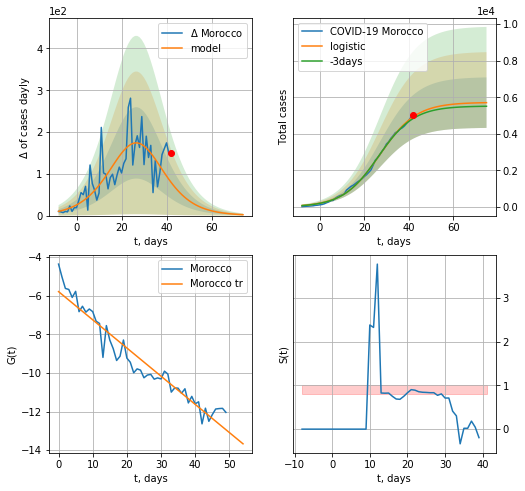

Morocco data at: 2020-05-04
+3 day model MAPE: 0.01981454059158075
model: logistic
coeffs:  [5.72234527e+03 1.21712115e-01 2.70198913e+01]
rational stdev:  0.2421808178341643
forecast at the end of period: +33 days
	 deltaDaycases:  2
	 total cases:  5705 ± 1381
	 total death:  202 ± 146
trend coefficient of determination: 0.928633
 intercept: -5.787528
 slope: -0.146045


In [709]:
x = forecast("Morocco",dfMR[5:],d1,10*7-dT)

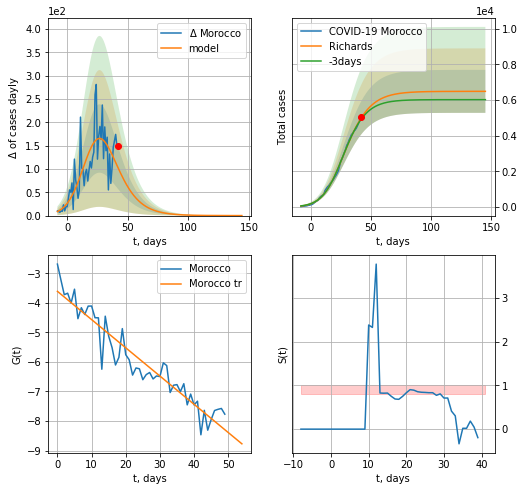

Morocco data at: 2020-05-04
+3 day model MAPE: 0.016851
model: Richards
coeffs: [6.48045758e+03 1.72585836e-01 1.90714551e+01 4.98613864e-01]
rational stdev: 0.185868
forecast at the end of period: +103 days
	 deltaDaycases: 0
	 total cases: 6480 ± 1204
	 total death: 229 ± 127
trend coefficient of determination: 0.902727
 intercept: -3.612149
 slope: -0.095556


/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


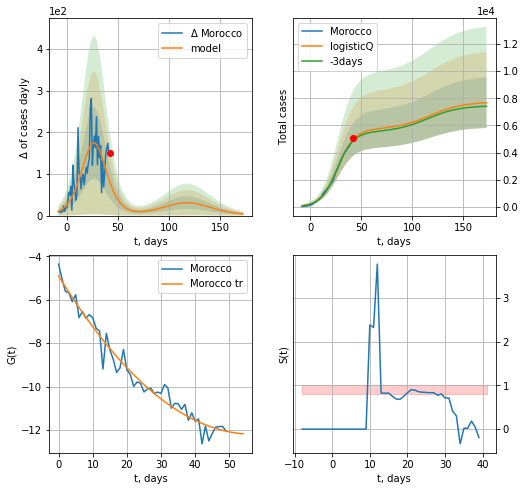

Morocco data at: 2020-05-04
+3 day model MAPE: 0.019926
model: logisticQ
coeffs: [ 5.71744317e+03  6.37480879e-06  2.70056270e+01 -1.90838932e+04]
S.Korea scenario coeffs: [0.35416971, 0.02606324, 4.35859408, 19.30413219]
rational stdev: 0.242619
forecast at the end of period: +131 days
	 deltaDaycases: 4
	 total cases: 7676 ± 1862
	 total death: 271 ± 197
trend coefficient of determination: 0.965873
 intercept_: -4.902227540903189
 coeffs_: [ 0.         -0.25675871  0.00225996]


In [710]:
x = forecastRR("Morocco",dfMR[5:],d1,20*7-dT,addpred=False,xcoef=[0.35/4,.5,3,1])
x = forecastRRR("Morocco",dfMR[5:],d1,24*7-dT,addpred=True,xcoef=koreaCoeffs)

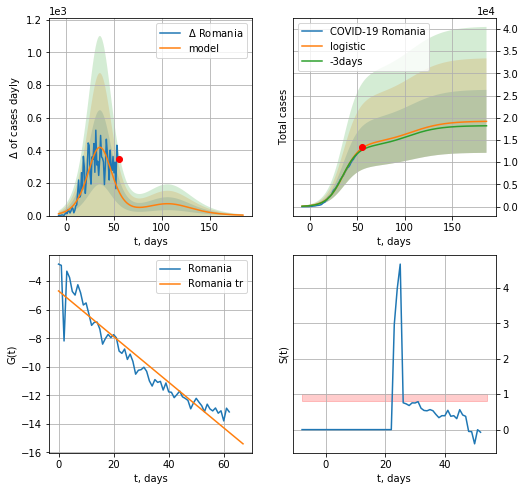

Romania data at: 2020-05-04
+3 day model MAPE: 0.034401895126668185
model: logistic
coeffs:  [1.42537089e+04 1.16193395e-01 3.56317522e+01]
scenario coeffs:  [0.35, 0.5, 3, 1]
rational stdev:  0.36923941596223603
forecast at the end of period: +131 days
	 deltaDaycases:  2
	 total cases:  19192 ± 7086
	 total death:  1161 ± 1286
trend coefficient of determination: 0.911344
 intercept: -4.683343
 slope: -0.159998


In [712]:
#dfRM = read_df(pd.DataFrame(),"RM")
x = forecast("Romania",dfRM[5:],d1,24*7-dT,addpred=True,xcoef=[0.35,.5,3,1])

/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:18: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:18: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


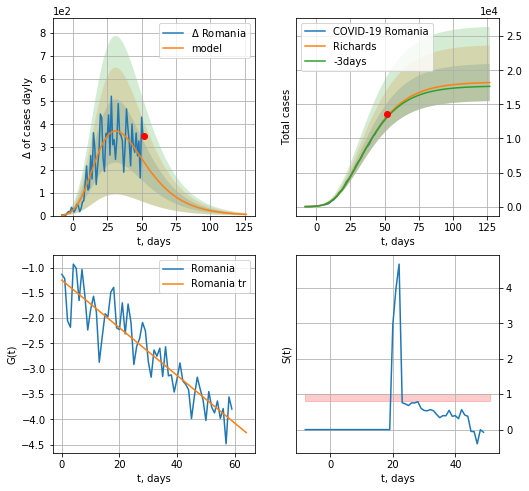

Romania data at: 2020-05-04
+3 day model MAPE: 0.010931
model: Richards
coeffs: [ 1.82881388e+04  3.74124001e+00 -4.42172676e+01  1.48431898e-02]
rational stdev: 0.149506
forecast at the end of period: +75 days
	 deltaDaycases: 5
	 total cases: 18196 ± 2720
	 total death: 1101 ± 493
trend coefficient of determination: 0.834854
 intercept: -1.249613
 slope: -0.047110


/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:153: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


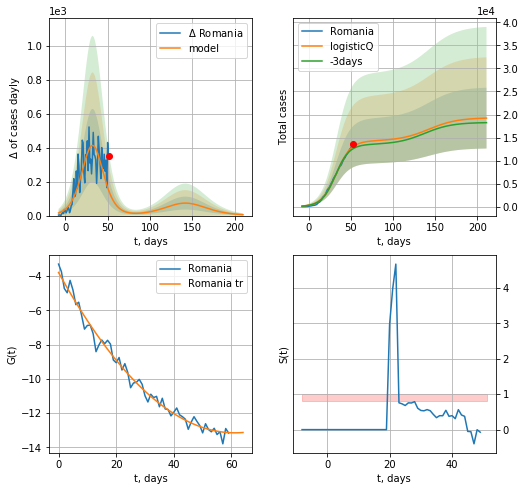

Romania data at: 2020-05-04
+3 day model MAPE: 0.034945
model: logisticQ
coeffs: [ 1.42588314e+04  1.62290068e-06  3.26406997e+01 -7.14898038e+04]
S.Korea scenario coeffs: [0.35416971, 0.02606324, 4.35859408, 19.30413219]
rational stdev: 0.343450
forecast at the end of period: +159 days
	 deltaDaycases: 5
	 total cases: 19219 ± 6600
	 total death: 1163 ± 1198
trend coefficient of determination: 0.985231
 intercept_: -3.7883817527445904
 coeffs_: [ 0.         -0.30627455  0.00250344]


In [714]:
x = forecastRR("Romania",dfRM[8:],d1,16*7-dT)
xx = forecastRRR("Romania",dfRM[8:],d1,28*7-dT,addpred=True,xcoef=koreaCoeffs)

In [715]:
#x = forecastRRR("Thailand",dfTH[20:],d1,8*7-dT,addpred=False,xcoef=[0.35/4,.5,2.2,1])

EU
          date    cases  active     death
82 2020-04-30  1013204  451651  104482.0
83 2020-05-01  1022788  447423  105770.0
84 2020-05-02  1031728  444169  107059.0
85 2020-05-03  1038173  444491  107861.0
86 2020-05-04  1044364  435371  108980.0


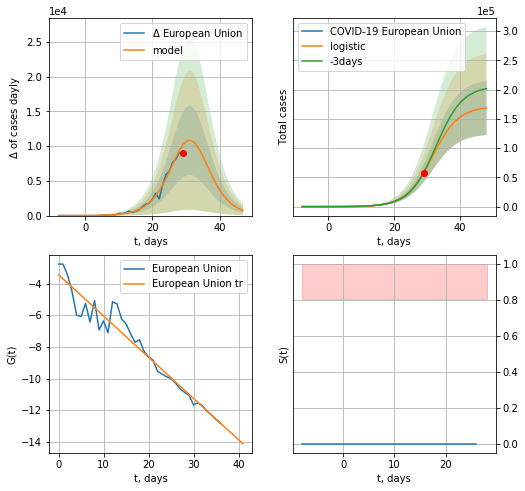

European Union data at: 2020-05-04
+3 day model MAPE: 0.026654473576493115
model: logistic
coeffs:  [1.71206811e+05 2.54019570e-01 3.15968250e+01]
rational stdev:  0.2741183518342743
forecast at the end of period: +19 days
	 deltaDaycases:  741
	 total cases:  168593 ± 46214
	 total death:  17592 ± 14466
trend coefficient of determination: 0.946316
 intercept: -3.442935
 slope: -0.260531


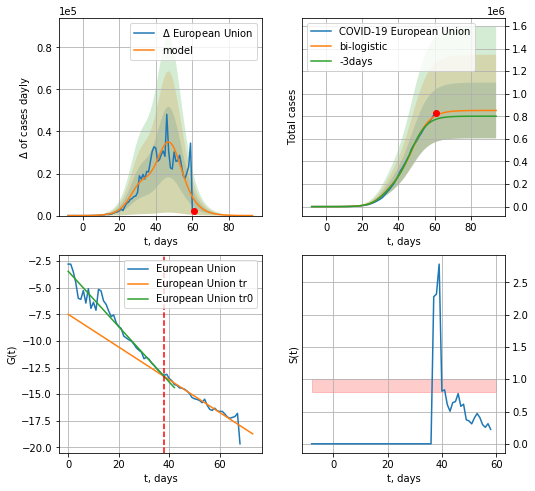

European Union data at: 2020-05-04
+3 day model MAPE: 0.04651829112234155
model: bi-logistic
coeffs:  [6.80547246e+05 2.01837730e-01 4.76694046e+01] [1.71206811e+05 2.54019570e-01 3.15968250e+01]
rational stdev:  0.28952183224371997
forecast at the end of period: +33 days
	 deltaDaycases:  13
	 total cases:  851694 ± 246584
	 total death:  88874 ± 77192
bi-logistic approximation splitting point: 38
trend0 coefficient of determination: 0.950267
 intercept: -3.442010
 slope: -0.260608
trend coefficient of determination: 0.919561
 intercept: -7.491452
 slope: -0.154009


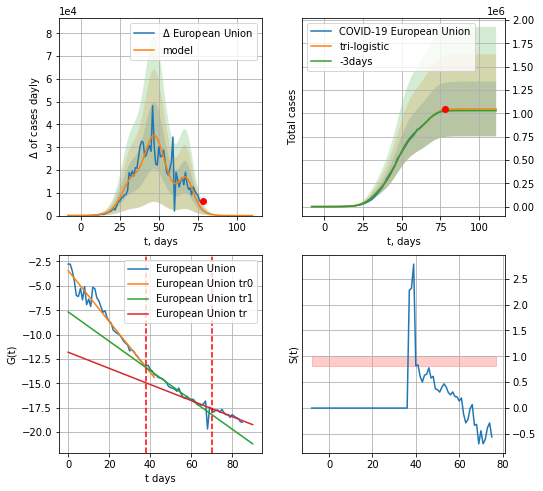

European Union data at: 2020-05-04
+3 day model MAPE: 0.014331108318362845
model: tri-logistic
coeffs:  [1.95620446e+05 2.99575551e-01 6.79198127e+01] [1.71206811e+05 2.54019570e-01 3.15968250e+01 6.80547246e+05
 2.01837730e-01 4.76694046e+01]
forecast rational stdev:  0.28000701328187894
forecast at the end of period: +33 days
	 deltaDaycases:  0
	 total cases:  1047372 ± 293271
	 total death:  109293 ± 91808
tri-logistic approximation splitting points: 38,70
trend0 coefficient of determination: 0.950267
 intercept: -3.442010
 slope: -0.260608
trend1 coefficient of determination: 0.917498
 intercept: -7.673048
 slope: -0.150226
trend coefficient of determination: 0.857669
 intercept: -11.806907
 slope: -0.082472


In [716]:
vL=38
vL1=70
dfEU = read_df(pd.DataFrame(),"EU")
x = forecast("European Union",dfEU[:vL],d1,8*7-dT)
xx = forecast2("European Union",dfEU[:vL1],d1,10*7-dT,x,vL=38,addpred=False,xcoef=[0.25,1.,1.5])
xx = np.concatenate((x, xx), axis=0)
xxx = forecast3("European Union",dfEU,d1,10*7-dT, xx, shift=1.,addpred=False,xcoef=[.25,1.,2.],vL=[vL,vL1])

/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:18: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:18: RuntimeWarning: divide by zero encountered in true_divide


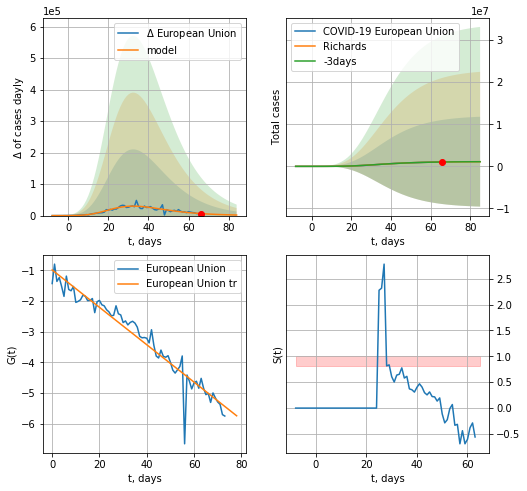

European Union data at: 2020-05-04
+3 day model MAPE: 0.004666
model: Richards
coeffs: [ 1.13464779e+06  1.64853763e+00 -9.40025901e+00  4.45919119e-02]
rational stdev: 9.616338
forecast at the end of period: +19 days
	 deltaDaycases: 1836
	 total cases: 1110275 ± 10676781
	 total death: 115857 ± 3342360
trend coefficient of determination: 0.932618
 intercept: -0.983014
 slope: -0.060957


In [717]:
x = forecastRR("European Union",dfEU[12:],d1,8*7-dT)

/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:153: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


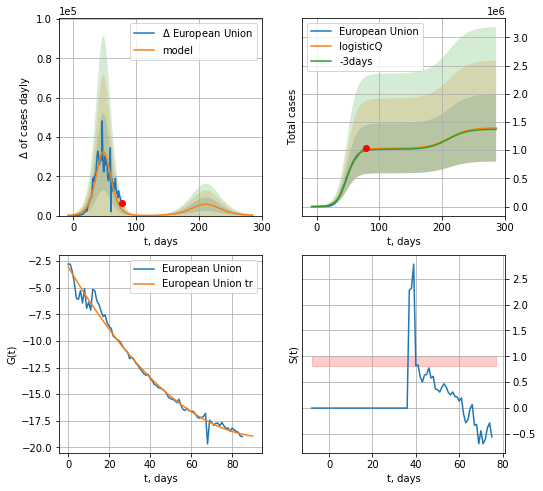

European Union data at: 2020-05-04
+3 day model MAPE: 0.015403
model: logisticQ
coeffs: [ 1.03224342e+06  1.20654630e-06  4.83924599e+01 -1.04532878e+05]
S.Korea scenario coeffs: [0.35416971, 0.02606324, 4.35859408, 19.30413219]
rational stdev: 0.427805
forecast at the end of period: +208 days
	 deltaDaycases: 200
	 total cases: 1394742 ± 596678
	 total death: 145542 ± 186790
trend coefficient of determination: 0.986880
 intercept_: -3.0268360787846085
 coeffs_: [ 0.         -0.32703623  0.00166905]


In [718]:
x = forecastRRR("European Union",dfEU[:],d1,35*7-dT,addpred=True,xcoef=koreaCoeffs)

/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:15: RuntimeWarning: overflow encountered in exp
  from ipykernel import kernelapp as app
/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:15: RuntimeWarning: divide by zero encountered in true_divide
  from ipykernel import kernelapp as app
/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:15: RuntimeWarning: overflow encountered in power
  from ipykernel import kernelapp as app
/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:15: RuntimeWarning: overflow encountered in true_divide
  from ipykernel import kernelapp as app
/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1200.
  warnings.warn(errors[info][0], RuntimeWarning)


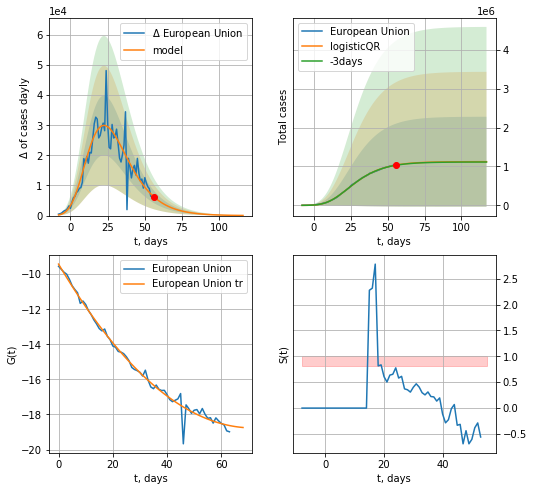

European Union data at: 2020-05-04
+3 day model MAPE: 0.004056965352399696
model: logisticQR
coeffs:  [ 1.12440997e+06  2.02195299e-02 -6.05399539e+01 -6.83987185e+02
  4.54537179e-03]
rational stdev:  1.0286911918854376
forecast at the end of period: +61 days
	 deltaDaycases:  49
	 total cases:  1123888 ± 1156134
	 total death:  117278 ± 361928
trend coefficient of determination: 0.986747
 intercept_: -9.424568330823902
 coeffs_: [ 0.         -0.26097487  0.00182265]


In [721]:
x = forecastQR("European Union",dfEU[22:],d1,14*7-dT,addpred=False,xcoef=[0.35,.5,2.5,1.,1])

In [722]:
#x = forecastRR("Romania",dfRM[5:],d1,14*7-dT)

In [723]:
#x = forecastRRR("European Union",dfEU[:],d1,8*7-dT)

In [724]:
#x = forecastRRR("Romania",dfRM[5:],d1,18*7-dT,addpred=True,xcoef=[0.35,.5,3.,1.])

In [725]:
#dfIC[:]

IC
          date    cases  active  death
60 2020-04-30  1797.10     117  10.04
61 2020-05-01  1798.00      99  10.05
62 2020-05-02  1798.01      82  10.06
63 2020-05-03  1799.00      72  10.00
64 2020-05-04  1799.50      66  10.00


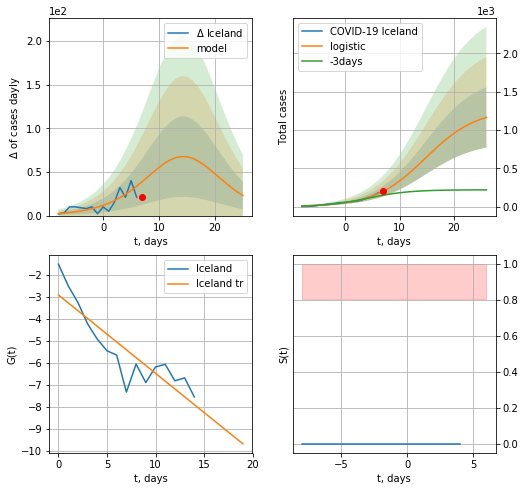

Iceland data at: 2020-05-04
+3 day model MAPE: 0.49229543132944575
model: logistic
coeffs:  [1.27194861e+03 2.12945173e-01 1.48141483e+01]
rational stdev:  0.3377978270267634
forecast at the end of period: +19 days
	 deltaDaycases:  22
	 total cases:  1164 ± 393
	 total death:  6 ± 6
trend coefficient of determination: 0.778766
 intercept: -2.904405
 slope: -0.356109


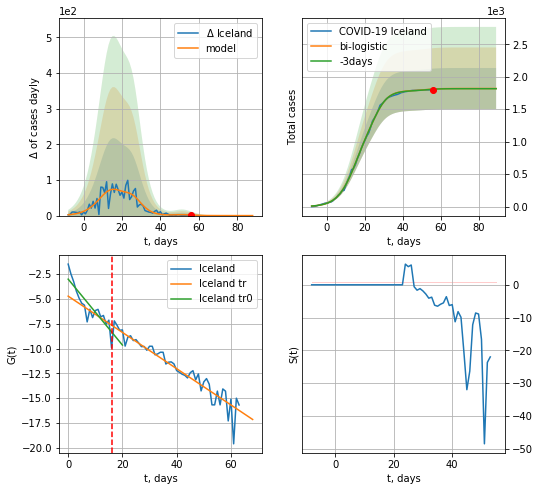

Iceland data at: 2020-05-04
+3 day model MAPE: 0.0014386514869882397
model: bi-logistic
coeffs:  [5.14386280e+02 2.90936246e-01 2.60724662e+01] [1.27194861e+03 2.12945173e-01 1.48141483e+01]
scenario coeffs:  [0.0625, 1.0, 2]
rational stdev:  0.1738188004995581
forecast at the end of period: +33 days
	 deltaDaycases:  0
	 total cases:  1818 ± 316
	 total death:  10 ± 5
bi-logistic approximation splitting point: 16
trend0 coefficient of determination: 0.772657
 intercept: -3.017482
 slope: -0.331878
trend coefficient of determination: 0.890190
 intercept: -4.728758
 slope: -0.182557


In [726]:
dfIC = read_df(pd.DataFrame(),"IC")
vL=16
x = forecast("Iceland",dfIC[:vL],d1,8*7-dT,addpred=False,xcoef=[0.25/2,1.,2])
xx = forecast2("Iceland",dfIC[:],d1,10*7-dT,x,addpred=True,xcoef=[0.25/4,1.,2],vL=vL)

/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:18: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:18: RuntimeWarning: divide by zero encountered in true_divide


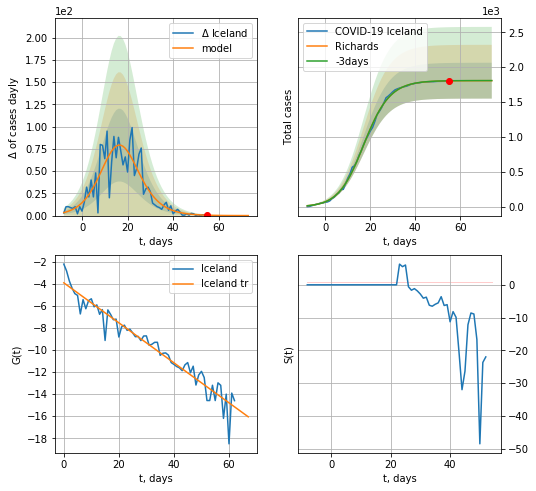

Iceland data at: 2020-05-04
+3 day model MAPE: 0.000657
model: Richards
coeffs: [1.80696993e+03 1.96598965e-01 1.59943469e+01 8.54083536e-01]
rational stdev: 0.142065
forecast at the end of period: +19 days
	 deltaDaycases: 0
	 total cases: 1806 ± 256
	 total death: 10 ± 4
trend coefficient of determination: 0.934120
 intercept: -3.919042
 slope: -0.181133


In [727]:
x = forecastRR("Iceland",dfIC[1:],d1,8*7-dT,addpred=False,xcoef=[0.25/2,1.,2])
#x = forecastRRR("Iceland",dfIC[:20],d1,8*7-dT,addpred=False,xcoef=[0.25/2,1.,2])

/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:153: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


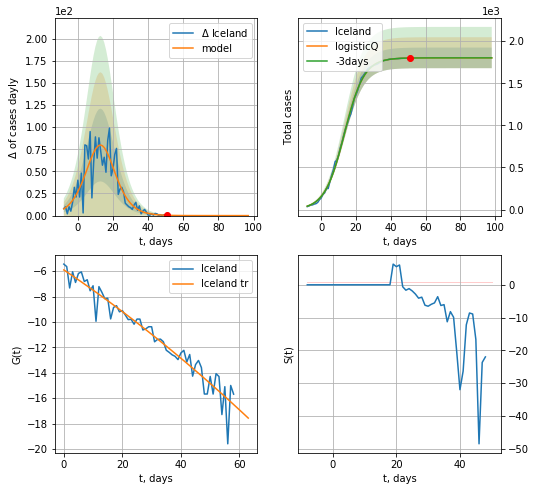

Iceland data at: 2020-05-04
+3 day model MAPE: 0.000047
model: logisticQ
coeffs: [ 1.80196234e+03  9.77334790e-06  1.33194422e+01 -1.81285259e+04]
rational stdev: 0.068028
forecast at the end of period: +47 days
	 deltaDaycases: 0
	 total cases: 1801 ± 122
	 total death: 10 ± 2
trend coefficient of determination: 0.934712
 intercept_: -5.900561127560202
 coeffs_: [ 0.         -0.15429423 -0.0004904 ]


In [728]:
x = forecastRRR("Iceland",dfIC[5:],d1,12*7-dT,addpred=False,xcoef=[0.35/6,.5,4.,1.])

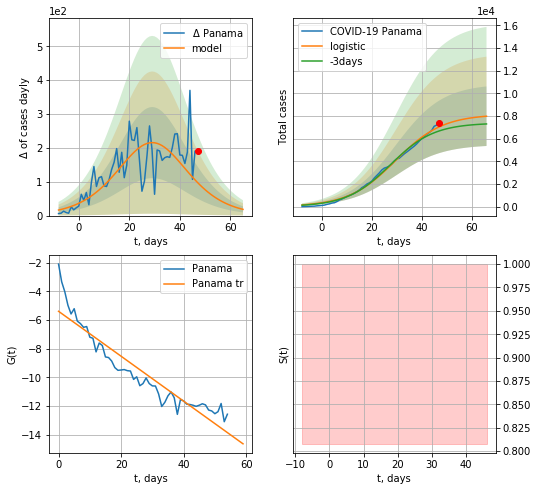

Panama data at: 2020-05-04
+3 day model MAPE: 0.057341935262880506
model: logistic
coeffs:  [8.14888675e+03 1.05882609e-01 2.95671237e+01]
rational stdev:  0.32932660104861966
forecast at the end of period: +19 days
	 deltaDaycases:  18
	 total cases:  7980 ± 2628
	 total death:  219 ± 216
trend coefficient of determination: 0.878634
 intercept: -5.390235
 slope: -0.156635


In [729]:
#dfPM = read_df(pd.DataFrame(),"PM")
x = forecast("Panama",dfPM[:],d1,8*7-dT)

/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:18: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:18: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


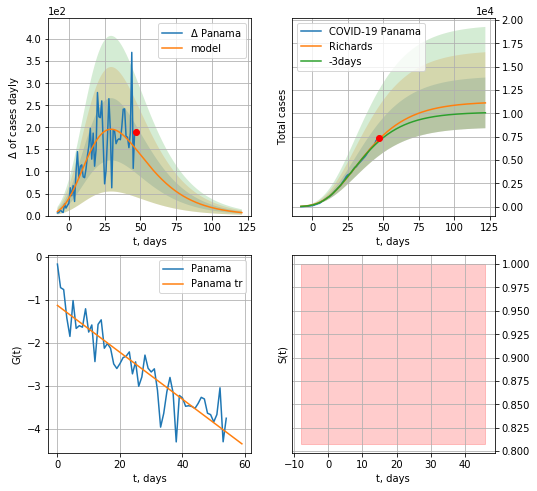

Panama data at: 2020-05-04
+3 day model MAPE: 0.030499
model: Richards
coeffs: [ 1.12537688e+04  4.21939979e+00 -6.42785332e+01  1.12712382e-02]
rational stdev: 0.244191
forecast at the end of period: +75 days
	 deltaDaycases: 6
	 total cases: 11112 ± 2713
	 total death: 305 ± 223
trend coefficient of determination: 0.836932
 intercept: -1.136516
 slope: -0.054565


In [730]:
x = forecastRR("Panama",dfPM[:],d1,16*7-dT)

/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:153: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


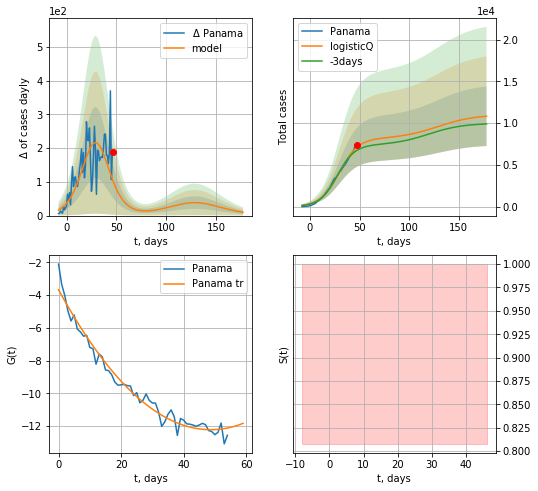

Panama data at: 2020-05-04
+3 day model MAPE: 0.056608
model: logisticQ
coeffs: [ 8.14656291e+03  1.43474294e-06  2.95615555e+01 -7.37811968e+04]
S.Korea scenario coeffs: [0.35416971, 0.02606324, 4.35859408, 19.30413219]
rational stdev: 0.329383
forecast at the end of period: +131 days
	 deltaDaycases: 9
	 total cases: 10835 ± 3569
	 total death: 297 ± 293
trend coefficient of determination: 0.973245
 intercept_: -3.666562005312734
 coeffs_: [ 0.         -0.35181962  0.00361501]


In [731]:
x = forecastRRR("Panama",dfPM[:],d1,24*7-dT,addpred=True,xcoef=koreaCoeffs)

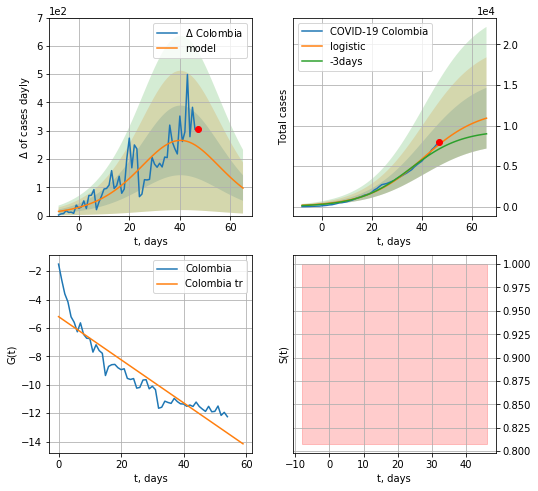

Colombia data at: 2020-05-04
+3 day model MAPE: 0.08670365369537755
model: logistic
coeffs:  [1.20937174e+04 8.79891007e-02 4.07592145e+01]
rational stdev:  0.34394937101423007
forecast at the end of period: +19 days
	 deltaDaycases:  97
	 total cases:  10909 ± 3752
	 total death:  489 ± 504
trend coefficient of determination: 0.847007
 intercept: -5.201897
 slope: -0.151779


/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


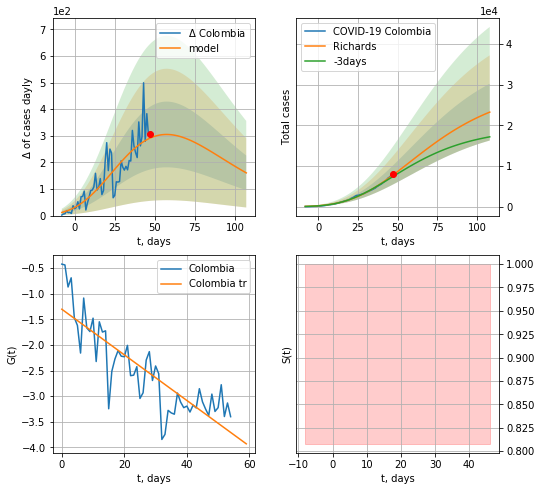

Colombia data at: 2020-05-04
+3 day model MAPE: 0.054766
model: Richards
coeffs: [ 2.96402343e+04  1.84730086e+00 -9.06406588e+01  1.52504942e-02]
rational stdev: 0.300608
forecast at the end of period: +61 days
	 deltaDaycases: 160
	 total cases: 23246 ± 6988
	 total death: 1043 ± 940
trend coefficient of determination: 0.710755
 intercept: -1.302850
 slope: -0.044536


In [732]:
x = forecast("Colombia",dfCB[:],d1,8*7-dT)
x = forecastRR("Colombia",dfCB[:],d1,14*7-dT)

/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


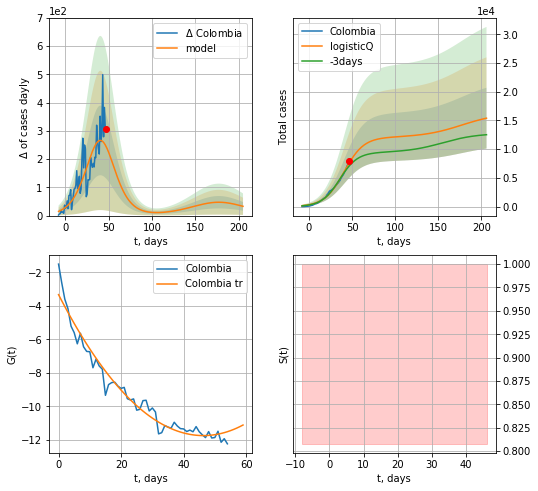

Colombia data at: 2020-05-04
+3 day model MAPE: 0.086034
model: logisticQ
coeffs: [ 1.20687497e+04  3.16671300e-06  4.07110707e+01 -2.77859150e+04]
S.Korea scenario coeffs: [0.35416971, 0.02606324, 4.35859408, 19.30413219]
rational stdev: 0.343989
forecast at the end of period: +159 days
	 deltaDaycases: 32
	 total cases: 15402 ± 5298
	 total death: 691 ± 713
trend coefficient of determination: 0.961661
 intercept_: -3.3290163019425707
 coeffs_: [ 0.         -0.36385728  0.00392786]


In [733]:
x = forecastRRR("Colombia",dfCB[:],d1,28*7-dT,addpred=True,xcoef=koreaCoeffs)

AR
          date   cases  active  death
57 2020-04-30  4006.0  1777.0  450.0
58 2020-05-01  4154.0  1880.0  453.0
59 2020-05-02  4295.0  1964.0  459.0
60 2020-05-03  4474.0  2075.0  463.0
61 2020-05-04  4648.0  2185.0  465.0


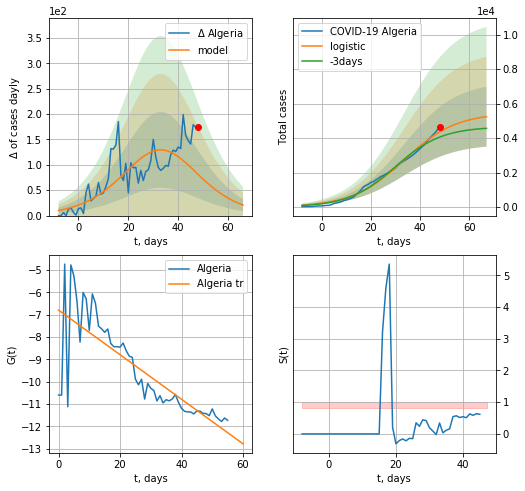

Algeria data at: 2020-05-04
+3 day model MAPE: 0.08039105464973356
model: logistic
coeffs:  [5.46420247e+03 9.47570118e-02 3.34860945e+01]
rational stdev:  0.33119016602793266
forecast at the end of period: +19 days
	 deltaDaycases:  20
	 total cases:  5245 ± 1737
	 total death:  524 ± 520
trend coefficient of determination: 0.643066
 intercept: -6.789782
 slope: -0.099869


In [734]:
dfAR = read_df(pd.DataFrame(),"AR")
dfAR = dfAR.fillna(0)
x = forecast("Algeria",dfAR[5:],d1,8*7-dT)
#dfAG

/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


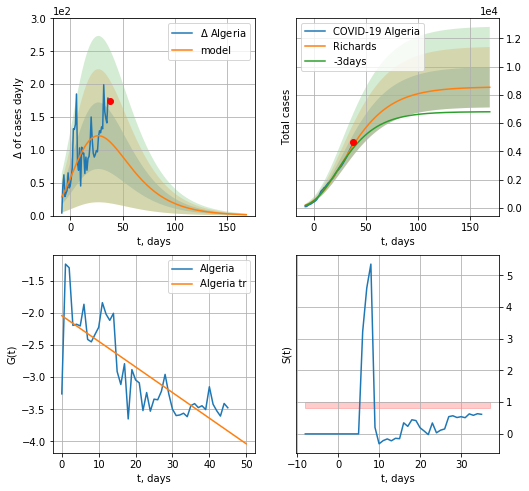

Algeria data at: 2020-05-04
+3 day model MAPE: 0.052594
model: Richards
coeffs: [ 8.57106203e+03  1.71562712e+00 -6.96940177e+01  2.27186879e-02]
rational stdev: 0.166913
forecast at the end of period: +131 days
	 deltaDaycases: 1
	 total cases: 8536 ± 1424
	 total death: 854 ± 427
trend coefficient of determination: 0.634665
 intercept: -2.043071
 slope: -0.039905


In [735]:
x = forecastRR("Algeria",dfAR[15:],d1,24*7-dT)

/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


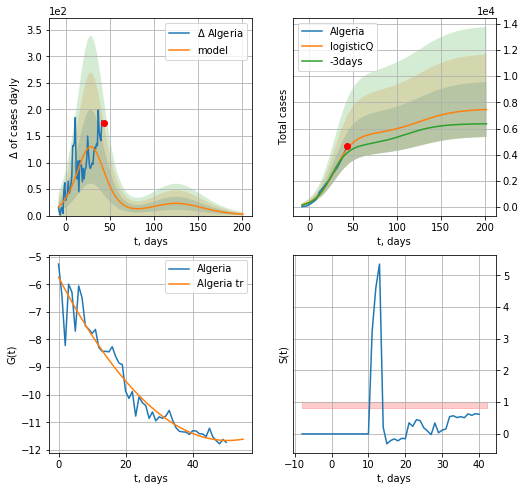

Algeria data at: 2020-05-04
+3 day model MAPE: 0.075906
model: logisticQ
coeffs: [ 5.54669888e+03  1.45991041e-06  2.88608078e+01 -6.37229599e+04]
S.Korea scenario coeffs: [0.35416971, 0.02606324, 4.35859408, 19.30413219]
rational stdev: 0.281883
forecast at the end of period: +159 days
	 deltaDaycases: 2
	 total cases: 7457 ± 2102
	 total death: 746 ± 630
trend coefficient of determination: 0.940890
 intercept_: -5.743753313174552
 coeffs_: [ 0.         -0.23456472  0.00232463]


In [736]:
x = forecastRRR("Algeria",dfAR[10:],d1,28*7-dT,addpred=True,xcoef=koreaCoeffs)

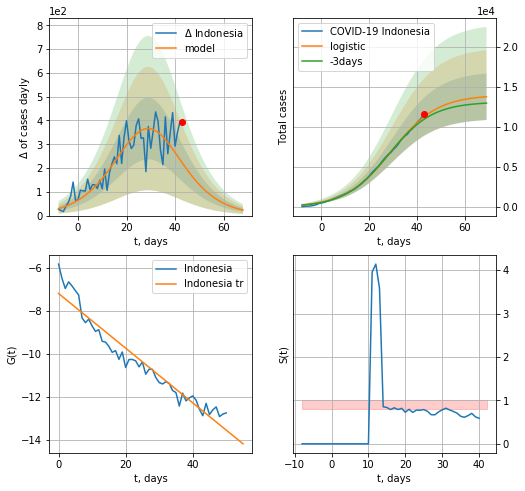

Indonesia data at: 2020-05-04
+3 day model MAPE: 0.03055443727696948
model: logistic
coeffs:  [1.39658211e+04 1.04888438e-01 2.93867877e+01]
rational stdev:  0.21073218704269697
forecast at the end of period: +26 days
	 deltaDaycases:  23
	 total cases:  13750 ± 2897
	 total death:  1025 ± 648
trend coefficient of determination: 0.933748
 intercept: -7.196233
 slope: -0.126794


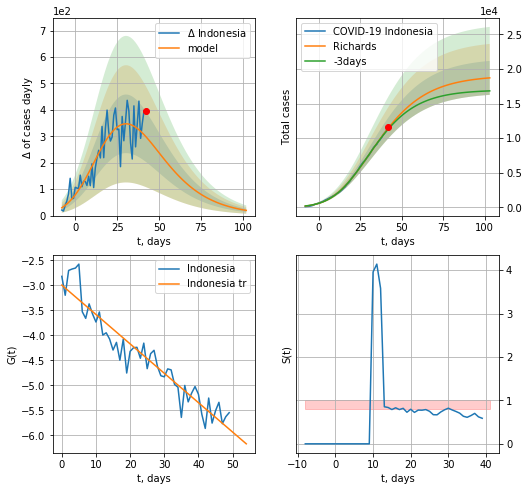

Indonesia data at: 2020-05-04
+3 day model MAPE: 0.015557
model: Richards
coeffs: [1.90610698e+04 2.37813208e-01 4.28402080e+00 2.31907320e-01]
rational stdev: 0.131282
forecast at the end of period: +61 days
	 deltaDaycases: 19
	 total cases: 18709 ± 2456
	 total death: 1395 ± 549
trend coefficient of determination: 0.901907
 intercept: -2.997013
 slope: -0.058790


In [737]:
x = forecast("Indonesia",dfIE[5:],d1,9*7-dT)
x = forecastRR("Indonesia",dfIE[6:],d1,14*7-dT)

/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


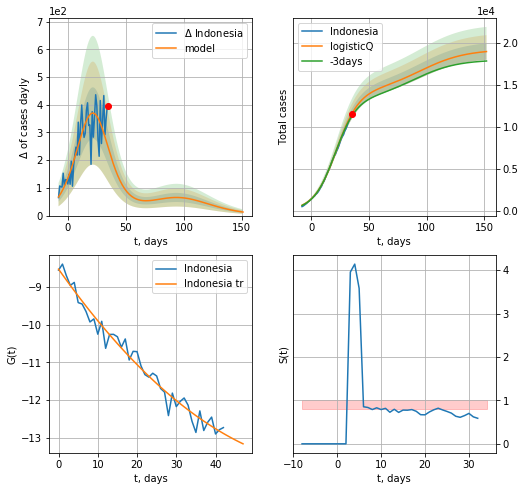

Indonesia data at: 2020-05-04
+3 day model MAPE: 0.025205
model: logisticQ
coeffs: [ 1.42170968e+04  2.42119319e-05  2.18043172e+01 -4.21036996e+03]
S.Korea scenario coeffs: [0.35416971, 0.02606324, 4.35859408, 19.30413219]
rational stdev: 0.051589
forecast at the end of period: +117 days
	 deltaDaycases: 12
	 total cases: 18996 ± 980
	 total death: 1416 ± 219
trend coefficient of determination: 0.973015
 intercept_: -8.52305940284915
 coeffs_: [ 0.         -0.14765513  0.00103908]


In [738]:
x = forecastRRR("Indonesia",dfIE[13:],d1,22*7-dT,addpred=True,xcoef=koreaCoeffs)

/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 800.
  warnings.warn(errors[info][0], RuntimeWarning)


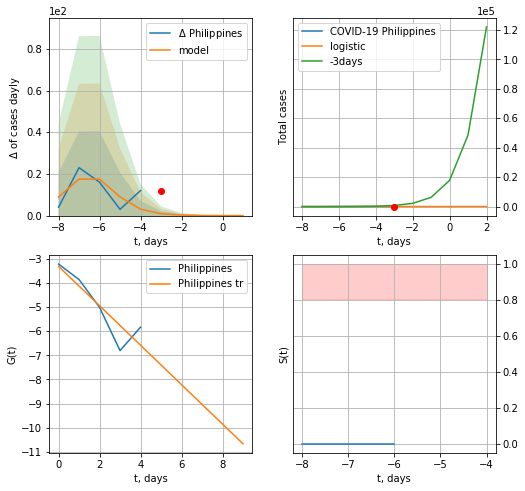

Philippines data at: 2020-05-04
+3 day model MAPE: 0.9724006736169737
model: logistic
coeffs:  [61.51692029  1.2919553  -5.99802409]
rational stdev:  0.19348550855350297
forecast at the end of period: +5 days
	 deltaDaycases:  0
	 total cases:  61 ± 11
	 total death:  4 ± 2
trend coefficient of determination: 0.794507
 intercept: -3.309972
 slope: -0.817432


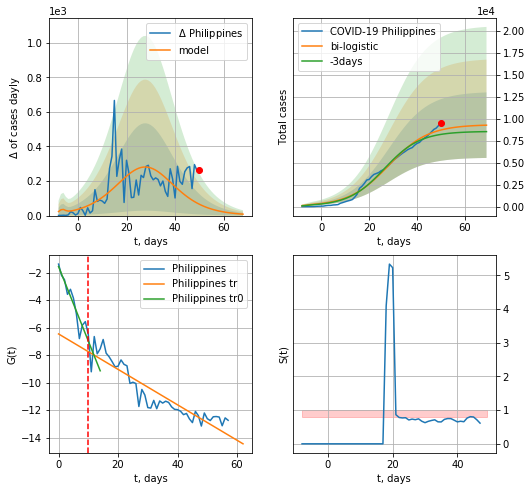

Philippines data at: 2020-05-04
+3 day model MAPE: 0.06359909689948569
model: bi-logistic
coeffs:  [9.26225947e+03 1.21497684e-01 2.81835540e+01] [61.51692029  1.2919553  -5.99802409]
rational stdev:  0.4022122788524083
forecast at the end of period: +19 days
	 deltaDaycases:  8
	 total cases:  9259 ± 3724
	 total death:  608 ± 733
bi-logistic approximation splitting point: 10
trend0 coefficient of determination: 0.872436
 intercept: -1.560268
 slope: -0.541848
trend coefficient of determination: 0.843723
 intercept: -6.464920
 slope: -0.128907


/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:304: RuntimeWarning: overflow encountered in exp


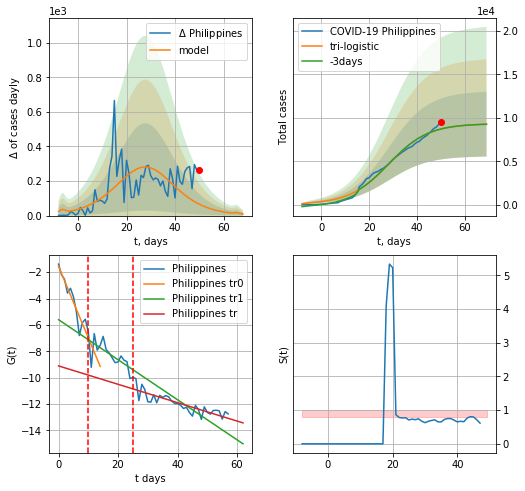

Philippines data at: 2020-05-04
+3 day model MAPE: 5.5675884249273e-13
model: tri-logistic
coeffs:  [17.1139246   1.46111059 66.04074174] [ 6.15169203e+01  1.29195530e+00 -5.99802409e+00  9.26225947e+03
  1.21497684e-01  2.81835540e+01]
forecast rational stdev:  0.4022122788524057
forecast at the end of period: +19 days
	 deltaDaycases:  8
	 total cases:  9276 ± 3730
	 total death:  609 ± 734
tri-logistic approximation splitting points: 10,25
trend0 coefficient of determination: 0.872436
 intercept: -1.560268
 slope: -0.541848
trend1 coefficient of determination: 0.474240
 intercept: -5.600607
 slope: -0.151865
trend coefficient of determination: 0.719761
 intercept: -9.107004
 slope: -0.069722


In [739]:
vL=10
vL1=25
x = forecast("Philippines",dfPH[4:vL],d1,6*7-dT,addpred=False,xcoef=[0.25,1.,2.3])
xx = forecast2("Philippines",dfPH[:],d1,8*7-dT,x,vL=vL,addpred=False,xcoef=[0.25,1.,1.8])
xx = np.concatenate((x, xx), axis=0)
xxx = forecast3("Philippines",dfPH,d1,8*7-dT, xx, shift=1.,addpred=False,xcoef=[.25,1.,2.],vL=[vL,vL1])

/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


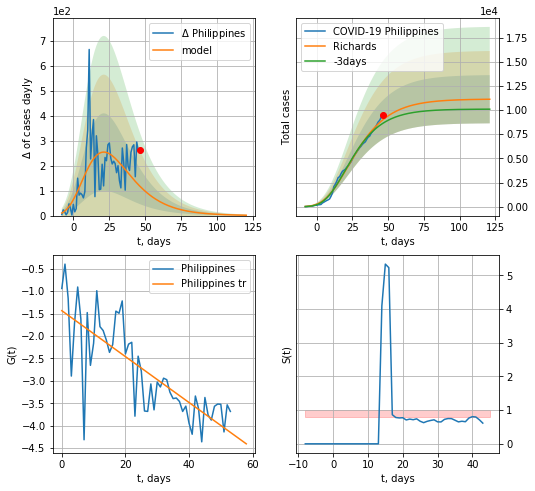

Philippines data at: 2020-05-04
+3 day model MAPE: 0.043843
model: Richards
coeffs: [ 1.11385555e+04  6.27259165e+00 -5.21591052e+01  9.96003788e-03]
rational stdev: 0.224446
forecast at the end of period: +75 days
	 deltaDaycases: 1
	 total cases: 11116 ± 2494
	 total death: 730 ± 491
trend coefficient of determination: 0.614932
 intercept: -1.434209
 slope: -0.051178


In [740]:
x = forecastRR("Philippines",dfPH[4:],d1,16*7-dT,addpred=False,xcoef=[0.25,1.,2.3])

/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


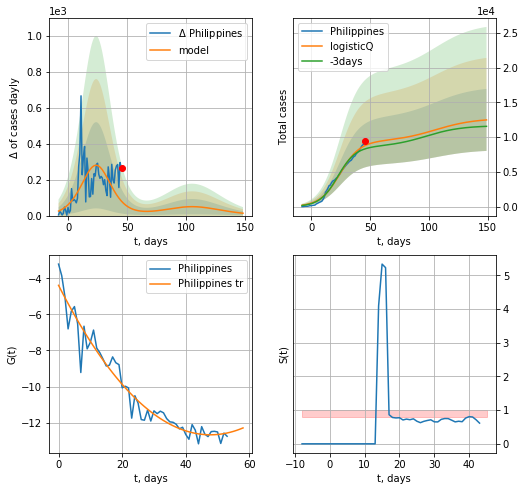

Philippines data at: 2020-05-04
+3 day model MAPE: 0.060888
model: logisticQ
coeffs: [ 9.39267985e+03  1.36020956e-06  2.42001048e+01 -8.71713341e+04]
S.Korea scenario coeffs: [0.35416971, 0.02606324, 4.35859408, 19.30413219]
rational stdev: 0.357440
forecast at the end of period: +103 days
	 deltaDaycases: 13
	 total cases: 12488 ± 4463
	 total death: 820 ± 879
trend coefficient of determination: 0.945514
 intercept_: -4.393786250943215
 coeffs_: [ 0.         -0.34645004  0.00362746]


In [741]:
x = forecastRRR("Philippines",dfPH[4:],d1,20*7-dT,addpred=True,xcoef=koreaCoeffs)

GC
          date  cases  active  death
61 2020-04-30   2591    1077  140.0
62 2020-05-01   2612    1098  140.0
63 2020-05-02   2620    1103  143.0
64 2020-05-03   2626    1108  144.0
65 2020-05-04   2632    1112  146.0


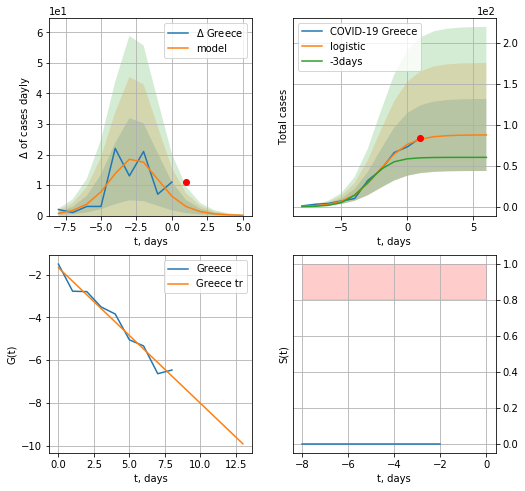

Greece data at: 2020-05-04
+3 day model MAPE: 0.42128754754463943
model: logistic
coeffs:  [87.54984336  0.87627722 -2.15069813]
rational stdev:  0.5018417290456435
forecast at the end of period: +5 days
	 deltaDaycases:  0
	 total cases:  87 ± 43
	 total death:  4 ± 6
trend coefficient of determination: 0.966991
 intercept: -1.674249
 slope: -0.634181


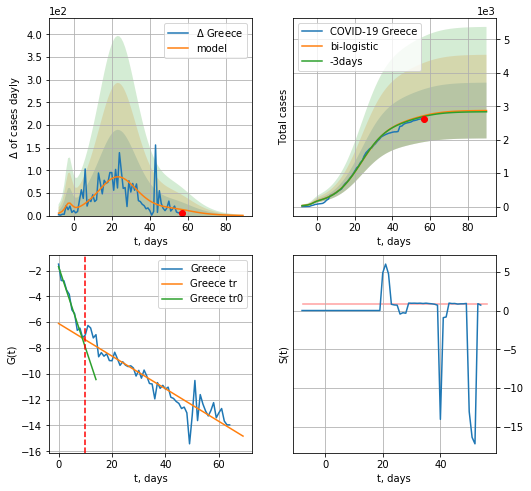

Greece data at: 2020-05-04
+3 day model MAPE: 0.009268287945279377
model: bi-logistic
coeffs:  [2.47726662e+03 1.37405014e-01 2.36026831e+01] [87.54984336  0.87627722 -2.15069813]
scenario coeffs:  [0.125, 1.0, 2.3]
rational stdev:  0.29015371790147043
forecast at the end of period: +33 days
	 deltaDaycases:  0
	 total cases:  2871 ± 833
	 total death:  159 ± 138
bi-logistic approximation splitting point: 10
trend0 coefficient of determination: 0.974467
 intercept: -1.699561
 slope: -0.624689
trend coefficient of determination: 0.876544
 intercept: -6.101460
 slope: -0.126464


In [742]:
dfGC = read_df(pd.DataFrame(),"GC")
x = forecast("Greece",dfGC[:10],d1,6*7-dT)
xx = forecast2("Greece",dfGC[:],d1,10*7-dT,x,addpred=True,xcoef=[.25/2,1.,2.3],vL=10)

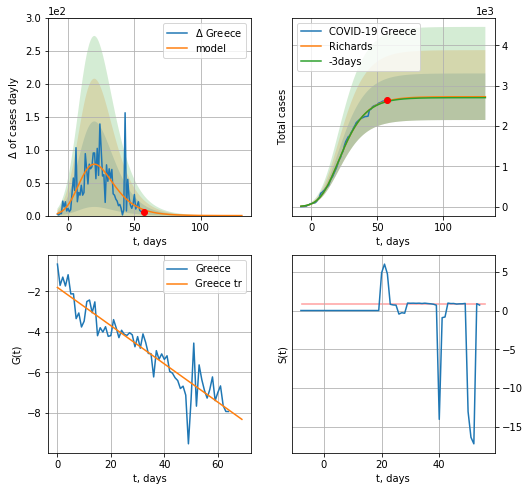

Greece data at: 2020-05-04
+3 day model MAPE: 0.005073
model: Richards
coeffs: [2.72475610e+03 3.71474431e-01 3.53347105e+00 2.33661971e-01]
rational stdev: 0.211757
forecast at the end of period: +75 days
	 deltaDaycases: 0
	 total cases: 2724 ± 576
	 total death: 151 ± 95
trend coefficient of determination: 0.861507
 intercept: -1.812265
 slope: -0.094165


In [744]:
x = forecastRR("Greece",dfGC[:],d1,16*7-dT,addpred=False,xcoef=[.35/4,.5,4,1])

/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


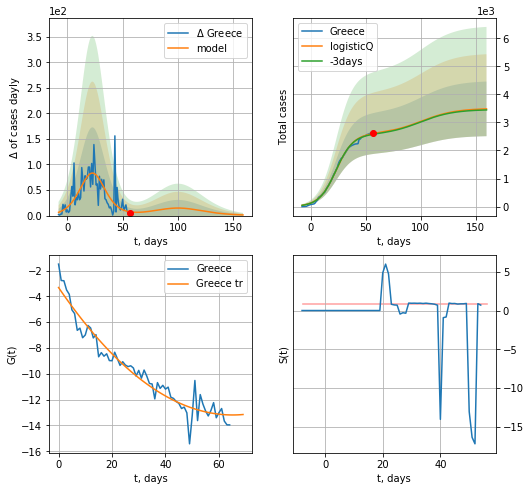

Greece data at: 2020-05-04
+3 day model MAPE: 0.010107
model: logisticQ
coeffs: [ 2.58641106e+03  1.35875784e-06  2.30901196e+01 -9.42879326e+04]
S.Korea scenario coeffs: [0.35416971, 0.02606324, 4.35859408, 19.30413219]
rational stdev: 0.279479
forecast at the end of period: +103 days
	 deltaDaycases: 1
	 total cases: 3482 ± 973
	 total death: 193 ± 161
trend coefficient of determination: 0.936226
 intercept_: -3.3179348125292556
 coeffs_: [ 0.         -0.30310674  0.00232656]


In [745]:
x = forecastRRR("Greece",dfGC[:],d1,20*7-dT,addpred=True,xcoef=koreaCoeffs)

HG
          date  cases  active  death
55 2020-04-30   2863    1931  323.0
56 2020-05-01   2942    1982  335.0
57 2020-05-02   2998    2029  340.0
58 2020-05-03   3035    2054  351.0
59 2020-05-04   3065    1993  363.0


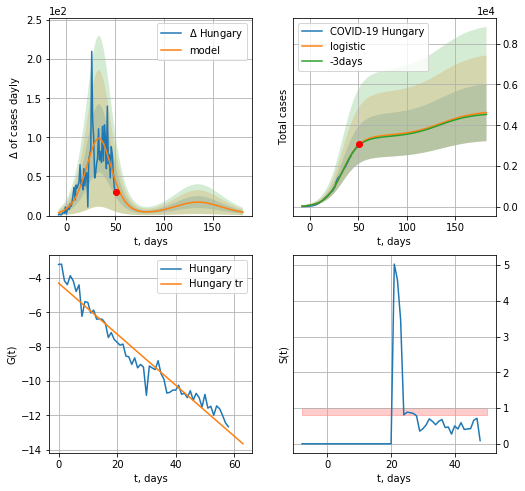

Hungary data at: 2020-05-04
+3 day model MAPE: 0.012581037569051101
model: logistic
coeffs:  [3.48278443e+03 1.13207113e-01 3.37832402e+01]
scenario coeffs:  [0.35, 0.5, 4, 1]
rational stdev:  0.30336956528038866
forecast at the end of period: +131 days
	 deltaDaycases:  4
	 total cases:  4621 ± 1402
	 total death:  547 ± 497
trend coefficient of determination: 0.943494
 intercept: -4.301699
 slope: -0.148356


In [746]:
dfHG = read_df(pd.DataFrame(),"HG")
x = forecast("Hungary",dfHG[:],d1,24*7-dT,addpred=True,xcoef=[.35,.5,4,1])
#xx = forecast2("Hungary",dfHG[:],d1,4*7-dT,x,vL=10)

/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:18: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:18: RuntimeWarning: divide by zero encountered in true_divide


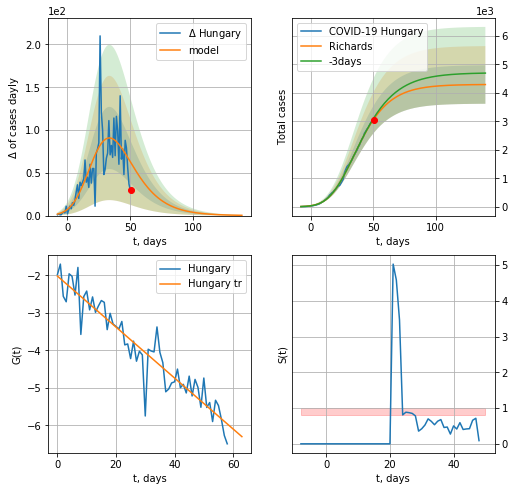

Hungary data at: 2020-05-04
+3 day model MAPE: 0.015740
model: Richards
coeffs: [4.29975394e+03 2.75602335e-01 1.10328085e+01 2.31916452e-01]
rational stdev: 0.157264
forecast at the end of period: +89 days
	 deltaDaycases: 0
	 total cases: 4294 ± 675
	 total death: 508 ± 239
trend coefficient of determination: 0.888218
 intercept: -2.022811
 slope: -0.067844


In [747]:
x = forecastRR("Hungary",dfHG[:],d1,18*7-dT)

/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


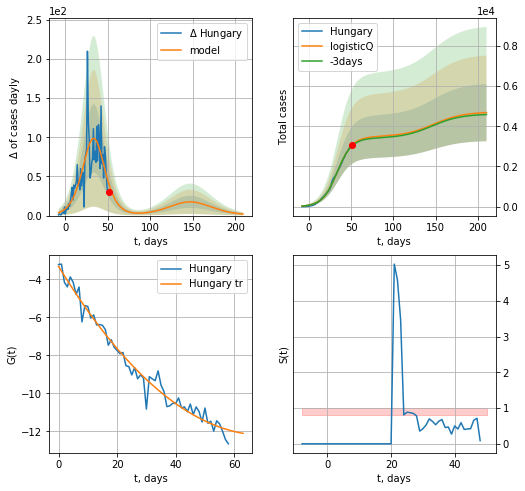

Hungary data at: 2020-05-04
+3 day model MAPE: 0.012668
model: logisticQ
coeffs: [ 3.48131058e+03  2.90084458e-06  3.37757501e+01 -3.90048331e+04]
S.Korea scenario coeffs: [0.35416971, 0.02606324, 4.35859408, 19.30413219]
rational stdev: 0.303602
forecast at the end of period: +159 days
	 deltaDaycases: 1
	 total cases: 4680 ± 1421
	 total death: 554 ± 504
trend coefficient of determination: 0.975213
 intercept_: -3.3197125872226554
 coeffs_: [ 0.         -0.25175368  0.00178296]


In [749]:
x = forecastRRR("Hungary",dfHG[:],d1,28*7-dT,addpred=True,xcoef=koreaCoeffs,cases='cases')

/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


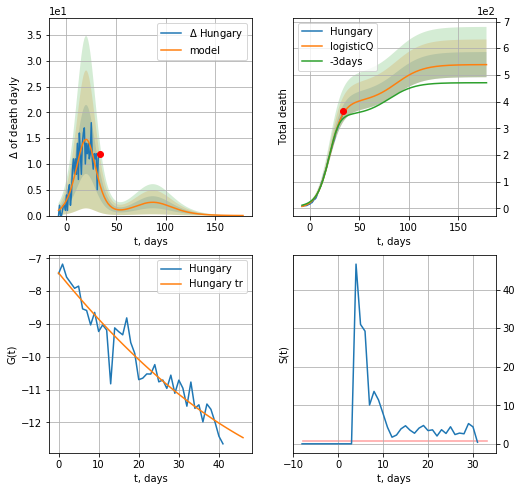

Hungary data at: 2020-05-04
+3 day model MAPE: 0.063212
model: logisticQ
coeffs: [ 3.97774027e+02  1.35519626e-04  2.00639392e+01 -1.07116738e+03]
S.Korea scenario coeffs: [0.35416971, 0.02606324, 4.35859408, 19.30413219]
rational stdev: 0.087520
forecast at the end of period: +145 days
	 total death: 538 ± 47
trend coefficient of determination: 0.921870
 intercept_: -7.4456741839155125
 coeffs_: [ 0.         -0.14977107  0.00088321]


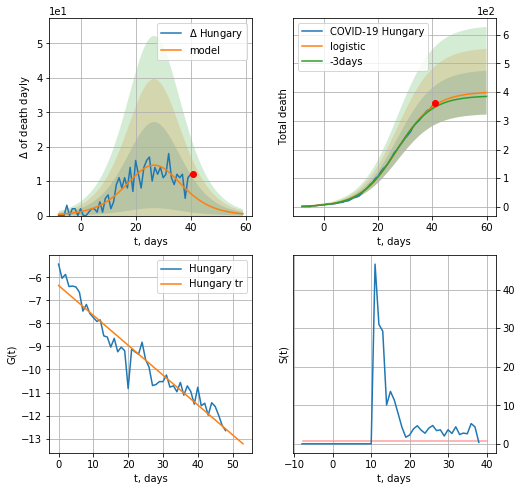

Hungary data at: 2020-05-04
+3 day model MAPE: 0.02132988320366198
model: logistic
coeffs:  [4.01582126e+02 1.46049040e-01 2.71873817e+01]
rational stdev:  0.1916320379978718
forecast at the end of period: +19 days
	 total death:  398 ± 76
trend coefficient of determination: 0.932751
 intercept: -6.353077
 slope: -0.129696


In [750]:
x = forecastRRR("Hungary",dfHG[17:],d1,26*7-dT,addpred=True,xcoef=koreaCoeffs,cases='death')
x = forecast("Hungary",dfHG[10:],d1,8*7-dT,cases='death')

MT
          date  cases  active  death
53 2020-04-30  465.0     110    4.0
54 2020-05-01  467.0      80    4.0
55 2020-05-02  468.0      85    4.0
56 2020-05-03  477.0      81    4.0
57 2020-05-04  480.0      77    4.0


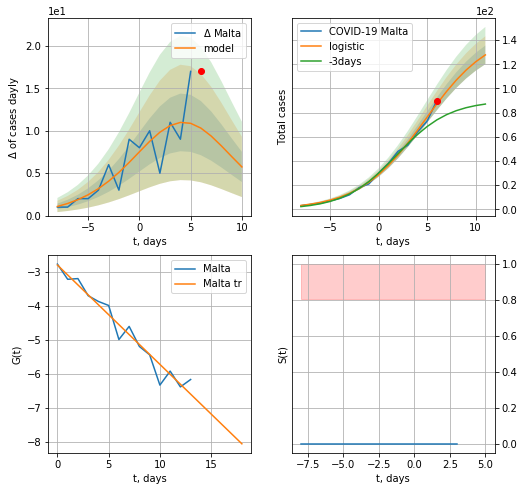

Malta data at: 2020-05-04
model: logistic
coeffs:  [147.79636191   0.29837112   4.7799048 ]
rational stdev:  0.06036954020755974
forecast at the end of period: +5 days
	 deltaDaycases:  5
	 total cases:  127 ± 7
	 total death:  1 ± 0
trend coefficient of determination: 0.952854
 intercept: -2.800130
 slope: -0.292111


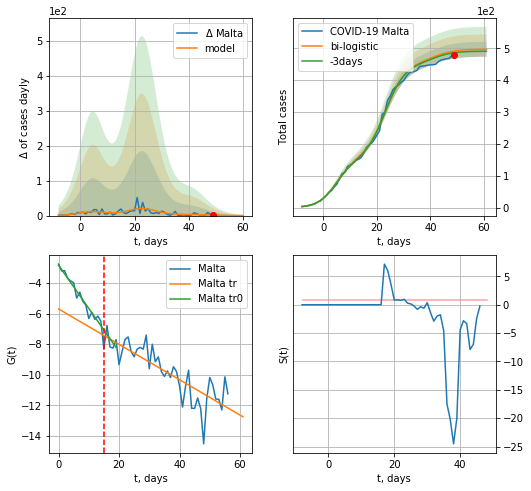

Malta data at: 2020-05-04
+3 day model MAPE: 0.011263305712258661
model: bi-logistic
coeffs:  [3.10543811e+02 2.57028813e-01 2.32877356e+01] [147.79636191   0.29837112   4.7799048 ]
scenario coeffs:  [0.125, 1.0, 1.8]
rational stdev:  0.04709917406769552
forecast at the end of period: +12 days
	 deltaDaycases:  0
	 total cases:  496 ± 23
	 total death:  4 ± 0
bi-logistic approximation splitting point: 15
trend0 coefficient of determination: 0.954424
 intercept: -2.840997
 slope: -0.282680
trend coefficient of determination: 0.681426
 intercept: -5.700177
 slope: -0.115590


In [751]:
dfMT = read_df(pd.DataFrame(),"MT")
x = forecast("Malta",dfMT[:15],d1,6*7-dT,pMAPE=False)
xx = forecast2("Malta",dfMT[:],d1,7*7-dT,x,vL=15,addpred=True,xcoef=[0.25/2,1.,1.8])

/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:18: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:18: RuntimeWarning: divide by zero encountered in true_divide


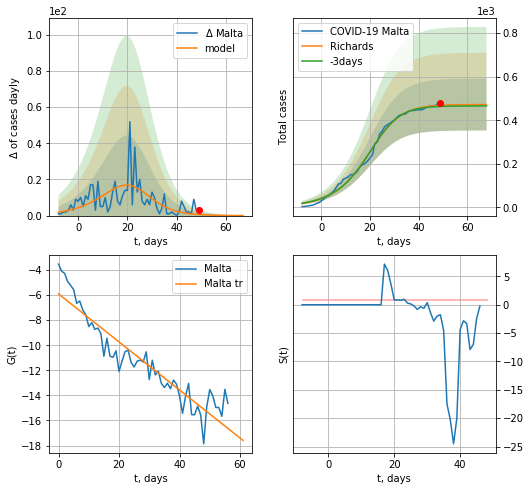

Malta data at: 2020-05-04
+3 day model MAPE: 0.011462
model: Richards
coeffs: [4.72165478e+02 1.07719050e-01 2.27883741e+01 1.54845686e+00]
rational stdev: 0.252099
forecast at the end of period: +19 days
	 deltaDaycases: 0
	 total cases: 472 ± 118
	 total death: 3 ± 2
trend coefficient of determination: 0.872490
 intercept: -5.907345
 slope: -0.191476


In [752]:
x = forecastRR("Malta",dfMT[:],d1,8*7-dT)

/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


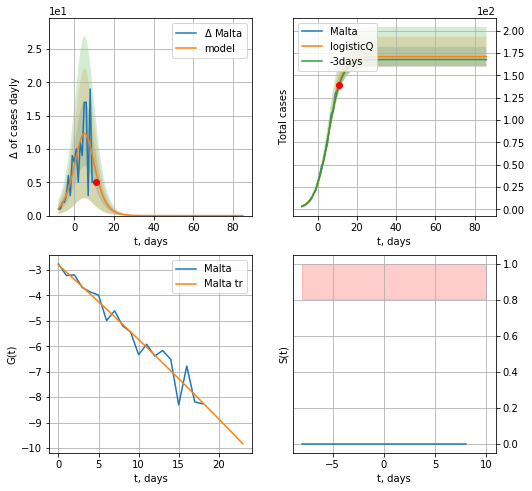

Malta data at: 2020-05-04
+3 day model MAPE: 0.017372
model: logisticQ
coeffs: [ 1.70905491e+02  1.60191203e-04  5.61725093e+00 -1.80321010e+03]
rational stdev: 0.064892
forecast at the end of period: +75 days
	 deltaDaycases: 0
	 total cases: 170 ± 11
	 total death: 1 ± 0
trend coefficient of determination: 0.945272
 intercept_: -2.8075452596601114
 coeffs_: [ 0.         -0.2833994  -0.00095541]


/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:288: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


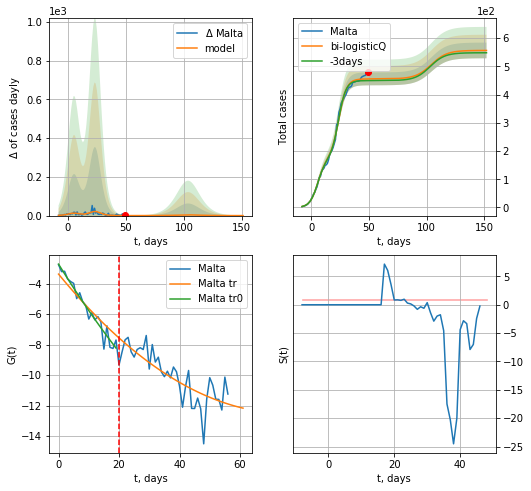

Malta data at: 2020-05-04
+3 day model MAPE: 0.013483
model: bi-logisticQ
coeffs: [ 2.84699909e+02  1.94794275e-06  2.38795557e+01 -1.50546863e+05]
S.Korea scenario coeffs: [0.35416971, 0.02606324, 4.35859408, 19.30413219]
rational stdev: 0.049970
forecast at the end of period: +103 days
	 deltaDaycases: 0
	 total cases: 556 ± 27
	 total death: 4 ± 0
bi-logisticQ approximation splitting point: 20
trend coefficient of determination: 0.942709
 intercept_: -2.7278514236597555
 coeffs_: [ 0.         -0.32197154  0.00170311]
trend coefficient of determination: 0.636072
 intercept_: -3.383943406559629
 coeffs_: [ 0.         -0.24111544  0.00159057]


In [753]:
x = forecastRRR("Malta",dfMT[:20],d1,16*7-dT,addpred=False,xcoef=[0.35/4,.5,3,1.])
xx = forecast2RRR("Malta",dfMT[:],d1,20*7-dT,x,addpred=True,xcoef=koreaCoeffs,vL=20)

SL
          date  cases  active  death
51 2020-04-30   1396   849.0   23.0
52 2020-05-01   1403   822.0   23.0
53 2020-05-02   1407   775.0   24.0
54 2020-05-03   1408   765.0   24.0
55 2020-05-04   1413   745.0   25.0


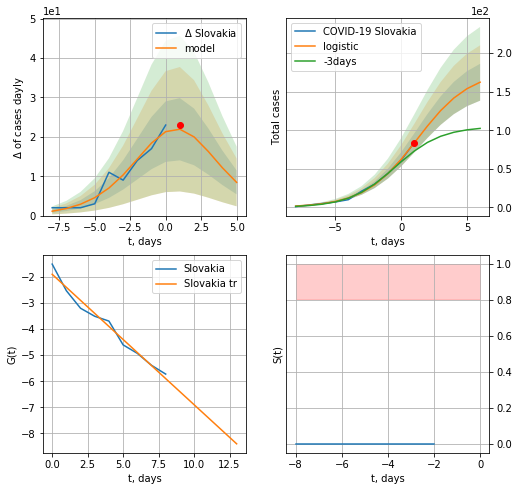

Slovakia data at: 2020-05-04
model: logistic
coeffs:  [177.28786794   0.4996723    1.23158092]
rational stdev:  0.14723856172050678
forecast at the end of period: +5 days
	 deltaDaycases:  8
	 total cases:  162 ± 23
	 total death:  2 ± 0
trend coefficient of determination: 0.974721
 intercept: -1.894823
 slope: -0.500610


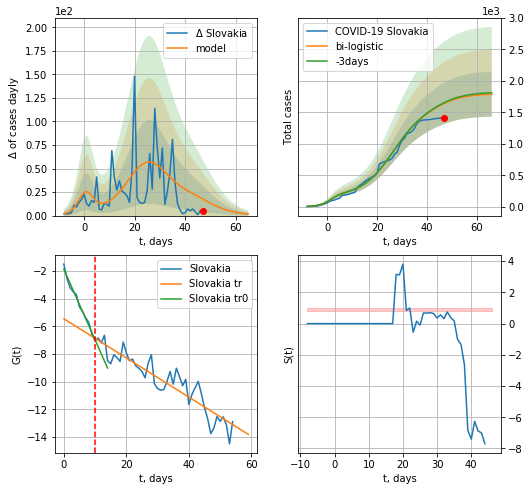

Slovakia data at: 2020-05-04
+3 day model MAPE: 0.007774062209630886
model: bi-logistic
coeffs:  [1.29595831e+03 1.68702107e-01 2.57463757e+01] [177.28786794   0.4996723    1.23158092]
scenario coeffs:  [0.25, 1.0, 1.7]
rational stdev:  0.19941781986824242
forecast at the end of period: +19 days
	 deltaDaycases:  1
	 total cases:  1788 ± 356
	 total death:  31 ± 18
bi-logistic approximation splitting point: 10
trend0 coefficient of determination: 0.981202
 intercept: -1.868036
 slope: -0.510655
trend coefficient of determination: 0.849750
 intercept: -5.455018
 slope: -0.141679


In [754]:
dfSL = read_df(pd.DataFrame(),"SL")
dfSL = dfSL.fillna(0)
x = forecast("Slovakia",dfSL[:10],d1,6*7-dT,pMAPE=False)
xx = forecast2("Slovakia",dfSL[:],d1,8*7-dT,x,addpred=True,xcoef=[0.25,1.,1.7],vL=10)

/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:18: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:18: RuntimeWarning: divide by zero encountered in true_divide


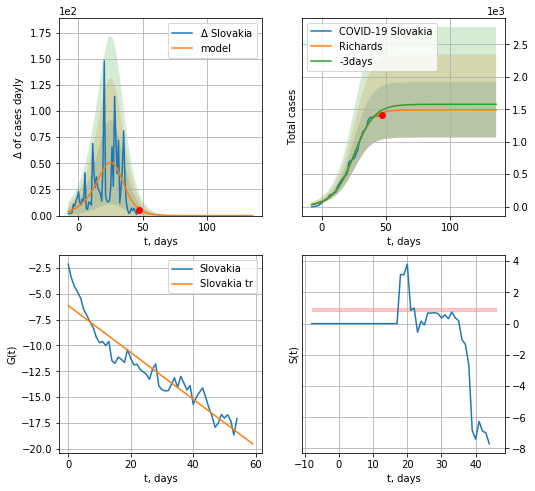

Slovakia data at: 2020-05-04
+3 day model MAPE: 0.030553
model: Richards
coeffs: [1.49133792e+03 1.02215711e-01 2.82463521e+01 1.57412044e+00]
rational stdev: 0.285608
forecast at the end of period: +89 days
	 deltaDaycases: 0
	 total cases: 1491 ± 425
	 total death: 26 ± 22
trend coefficient of determination: 0.891883
 intercept: -6.148089
 slope: -0.226599


In [755]:
x = forecastRR("Slovakia",dfSL[:],d1,18*7-dT)

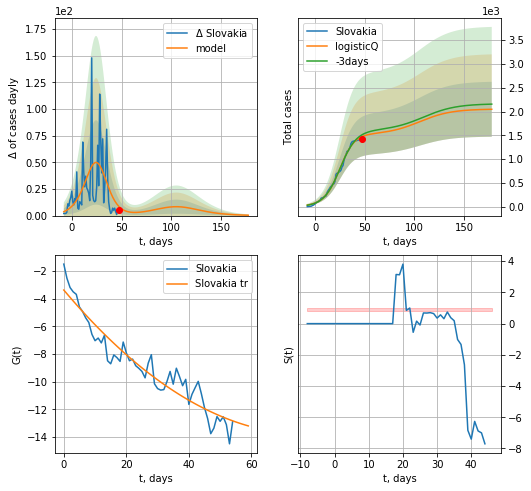

Slovakia data at: 2020-05-04
+3 day model MAPE: 0.026948
model: logisticQ
coeffs: [ 1.51523434e+03  3.85549630e-04  2.41085506e+01 -3.15309163e+02]
S.Korea scenario coeffs: [0.35416971, 0.02606324, 4.35859408, 19.30413219]
rational stdev: 0.282042
forecast at the end of period: +131 days
	 deltaDaycases: 0
	 total cases: 2046 ± 577
	 total death: 36 ± 30
trend coefficient of determination: 0.905794
 intercept_: -3.379766284410225
 coeffs_: [ 0.         -0.26815831  0.00172272]


In [756]:
x = forecastRRR("Slovakia",dfSL[:],d1,24*7-dT,addpred=True,xcoef=koreaCoeffs)

SV
          date   cases  active  death
56 2020-04-30  1429.0  1105.0   91.0
57 2020-05-01  1434.0  1109.0   92.0
58 2020-05-02  1439.0  1106.0   94.0
59 2020-05-03  1439.5  1102.0   96.0
60 2020-05-04  1439.8  1101.0   97.0


/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 800.
  warnings.warn(errors[info][0], RuntimeWarning)


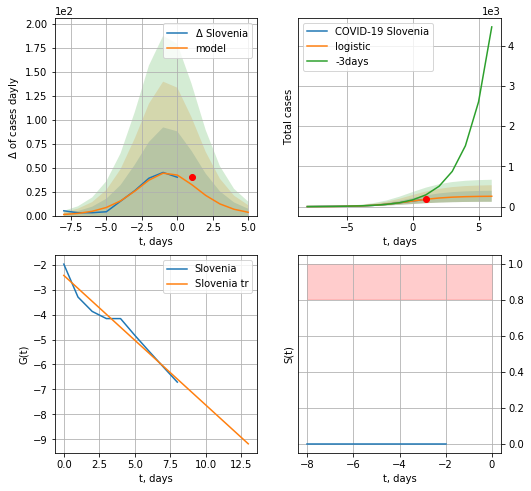

Slovenia data at: 2020-05-04
model: logistic
coeffs:  [ 2.61098711e+02  6.91755378e-01 -2.00021247e-01]
rational stdev:  0.5312441686508605
forecast at the end of period: +5 days
	 deltaDaycases:  3
	 total cases:  257 ± 136
	 total death:  17 ± 27
trend coefficient of determination: 0.958485
 intercept: -2.427236
 slope: -0.519636


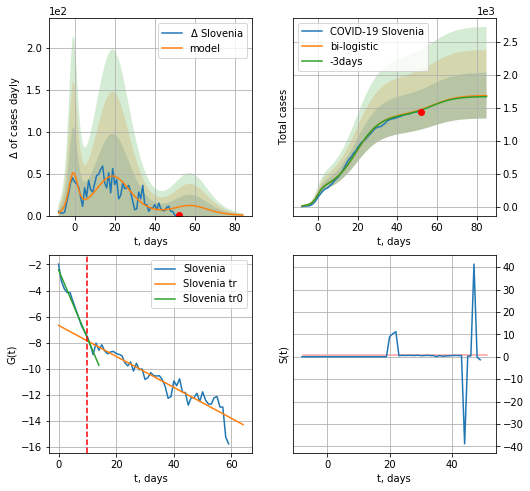

Slovenia data at: 2020-05-04
+3 day model MAPE: 0.00550218823787781
model: bi-logistic
coeffs:  [1.14264898e+03 1.64665941e-01 1.94139800e+01] [ 2.61098711e+02  6.91755378e-01 -2.00021247e-01]
scenario coeffs:  [0.25, 1.0, 3.0]
rational stdev:  0.20604580755588267
forecast at the end of period: +33 days
	 deltaDaycases:  0
	 total cases:  1685 ± 347
	 total death:  113 ± 69
bi-logistic approximation splitting point: 10
trend0 coefficient of determination: 0.969651
 intercept: -2.421914
 slope: -0.521632
trend coefficient of determination: 0.899004
 intercept: -6.671939
 slope: -0.118750


In [757]:
dfSV = read_df(pd.DataFrame(),"SV").fillna(0)
x = forecast("Slovenia",dfSV[:10],d1,6*7-dT,pMAPE=False)
xx = forecast2("Slovenia",dfSV[:],d1,10*7-dT,x,addpred=True,xcoef=[0.25,1.,3.],vL=10)

/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:18: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:18: RuntimeWarning: divide by zero encountered in true_divide


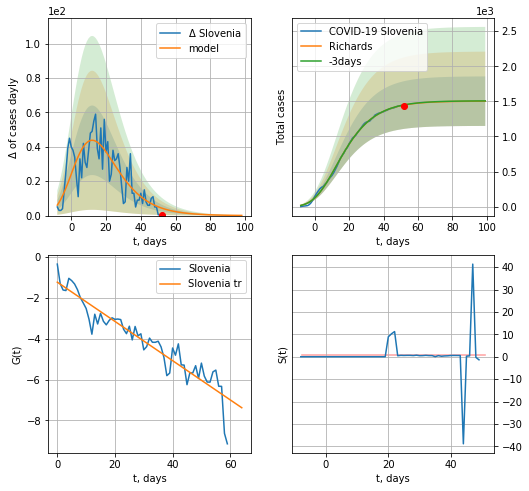

Slovenia data at: 2020-05-04
+3 day model MAPE: 0.001567
model: Richards
coeffs: [ 1.50399689e+03  8.97149785e-01 -1.62279529e+01  9.23669788e-02]
rational stdev: 0.234638
forecast at the end of period: +47 days
	 deltaDaycases: 0
	 total cases: 1502 ± 352
	 total death: 101 ± 71
trend coefficient of determination: 0.884874
 intercept: -1.231912
 slope: -0.096078


In [758]:
x = forecastRR("Slovenia",dfSV[:],d1,12*7-dT)

[0.35416971, 0.02606324, 4.35859408, 19.30413219]


/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:153: RuntimeWarning: overflow encountered in exp


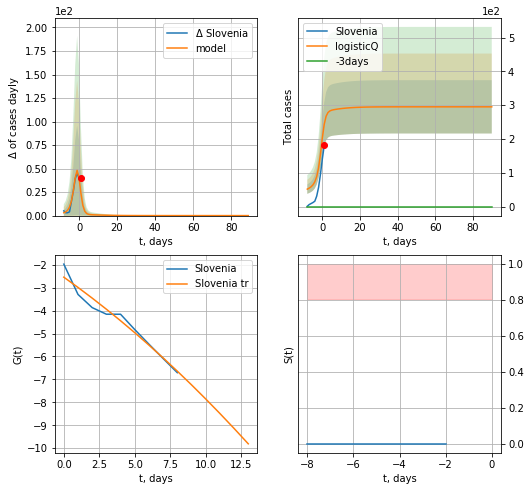

Slovenia data at: 2020-05-04
+3 day model MAPE: inf
model: logisticQ
coeffs: [ 2.17965799e+02  4.01733228e-02 -2.21208435e+01 -7.00287194e-01]
S.Korea scenario coeffs: [0.35416971, 0.02606324, 4.35859408, 19.30413219]
rational stdev: 0.266979
forecast at the end of period: +89 days
	 deltaDaycases: 0
	 total cases: 295 ± 78
	 total death: 19 ± 15
trend coefficient of determination: 0.956027
 intercept_: -2.543480478113449
 coeffs_: [ 0.         -0.43771568 -0.00932819]


/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:231: RuntimeWarning: divide by zero encountered in double_scalars
/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:288: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


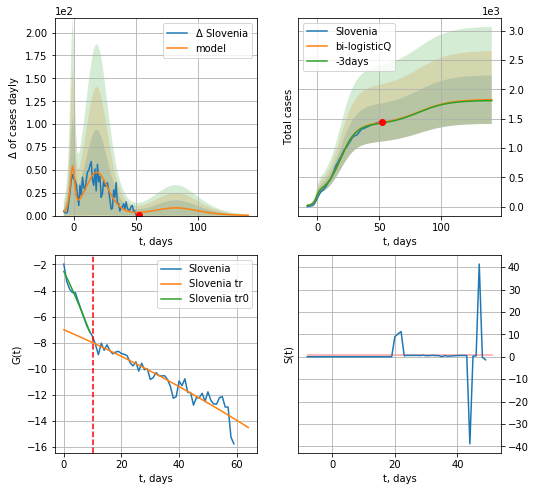

Slovenia data at: 2020-05-04
+3 day model MAPE: 0.008285
model: bi-logisticQ
coeffs: [ 1.18778157e+03  1.06136744e-06  1.88788433e+01 -1.49731936e+05]
S.Korea scenario coeffs: [0.35416971, 0.02606324, 4.35859408, 19.30413219]
rational stdev: 0.226557
forecast at the end of period: +89 days
	 deltaDaycases: 0
	 total cases: 1822 ± 412
	 total death: 122 ± 82
bi-logisticQ approximation splitting point: 10
trend coefficient of determination: 0.968209
 intercept_: -2.53431844604435
 coeffs_: [ 0.         -0.45029183 -0.00732028]
trend coefficient of determination: 0.900196
 intercept_: -7.0051142098251
 coeffs_: [ 0.         -0.09535274 -0.00033896]


In [759]:
koreaCoeffs = [  0.35416971,   0.02606324,   4.35859408,  19.30413219]
print(koreaCoeffs)
x = forecastRRR("Slovenia",dfSV[:10],d1,18*7-dT,addpred=True,xcoef=koreaCoeffs)
xx = forecast2RRR("Slovenia",dfSV[:],d1,18*7-dT,x,addpred=True,xcoef=koreaCoeffs,vL=10)

SB
          date  cases  active  death
51 2020-04-30   9009  7487.0  179.0
52 2020-05-01   9205  7641.0  185.0
53 2020-05-02   9362  7747.0  189.0
54 2020-05-03   9464  7720.0  193.0
55 2020-05-04   9557  7786.0  197.0


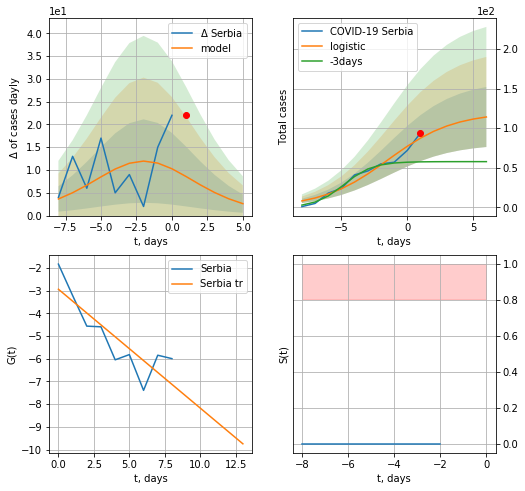

Serbia data at: 2020-05-04
model: logistic
coeffs:  [119.86809018   0.40041874  -1.48148467]
rational stdev:  0.3321032925412913
forecast at the end of period: +5 days
	 deltaDaycases:  2
	 total cases:  114 ± 37
	 total death:  2 ± 1
trend coefficient of determination: 0.723021
 intercept: -2.939233
 slope: -0.523684


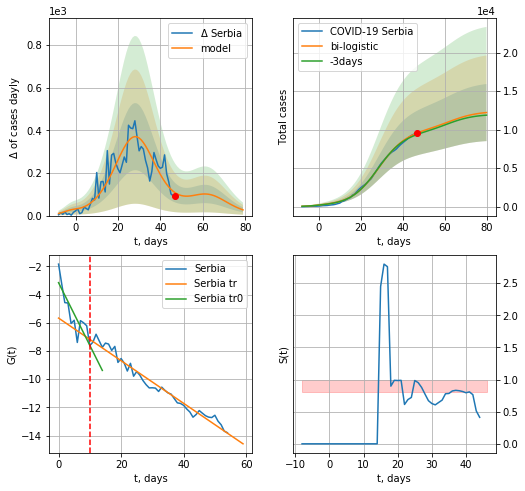

Serbia data at: 2020-05-04
+3 day model MAPE: 0.020781111215606198
model: bi-logistic
coeffs:  [9.82024671e+03 1.50238140e-01 2.86158109e+01] [119.86809018   0.40041874  -1.48148467]
scenario coeffs:  [0.25, 1.0, 2.2]
rational stdev:  0.3034391825907531
forecast at the end of period: +33 days
	 deltaDaycases:  26
	 total cases:  12214 ± 3706
	 total death:  251 ± 228
bi-logistic approximation splitting point: 10
trend0 coefficient of determination: 0.680312
 intercept: -3.149496
 slope: -0.444835
trend coefficient of determination: 0.970754
 intercept: -5.662789
 slope: -0.151253


In [760]:
dfSB = read_df(pd.DataFrame(),"SB")
dfSB = dfSB.fillna(0)
x = forecast("Serbia",dfSB[:10],d1,6*7-dT,pMAPE=False)
xx = forecast2("Serbia",dfSB[:],d1,10*7-dT,x,addpred=True,xcoef=[0.25,1.,2.2],vL=10)

/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:18: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:18: RuntimeWarning: divide by zero encountered in true_divide


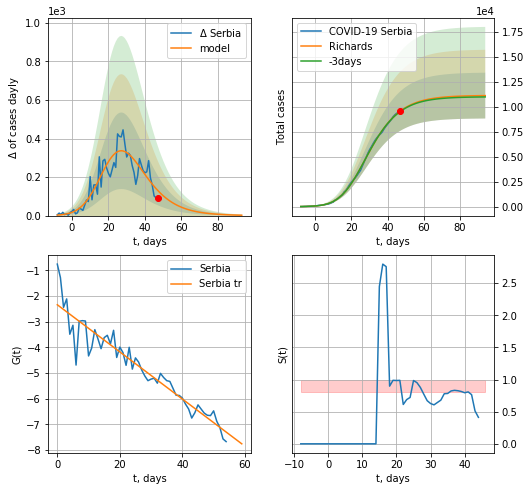

Serbia data at: 2020-05-04
+3 day model MAPE: 0.004534
model: Richards
coeffs: [1.11576928e+04 2.86967106e-01 1.59448979e+01 3.32017885e-01]
rational stdev: 0.206211
forecast at the end of period: +47 days
	 deltaDaycases: 1
	 total cases: 11137 ± 2296
	 total death: 229 ± 141
trend coefficient of determination: 0.902892
 intercept: -2.341522
 slope: -0.091858


In [761]:
x = forecastRR("Serbia",dfSB[:],d1,12*7-dT)


/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:153: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


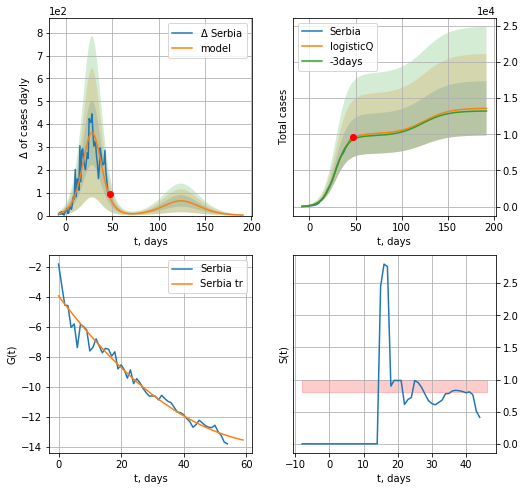

Serbia data at: 2020-05-04
+3 day model MAPE: 0.020071
model: logisticQ
coeffs: [ 1.00460873e+04  3.28098069e-06  2.85852478e+01 -4.39750010e+04]
S.Korea scenario coeffs: [0.35416971, 0.02606324, 4.35859408, 19.30413219]
rational stdev: 0.276265
forecast at the end of period: +145 days
	 deltaDaycases: 1
	 total cases: 13577 ± 3751
	 total death: 279 ± 231
trend coefficient of determination: 0.965952
 intercept_: -3.950531432989008
 coeffs_: [ 0.         -0.27719933  0.00194196]


In [762]:
x = forecastRRR("Serbia",dfSB[:],d1,26*7-dT,addpred=True,xcoef=koreaCoeffs)

CT
          date  cases  active  death
61 2020-04-30   2076   659.0   69.0
62 2020-05-01   2085   589.0   75.0
63 2020-05-02   2088   548.0   77.0
64 2020-05-03   2096   528.0   79.0
65 2020-05-04   2101   499.0   80.0


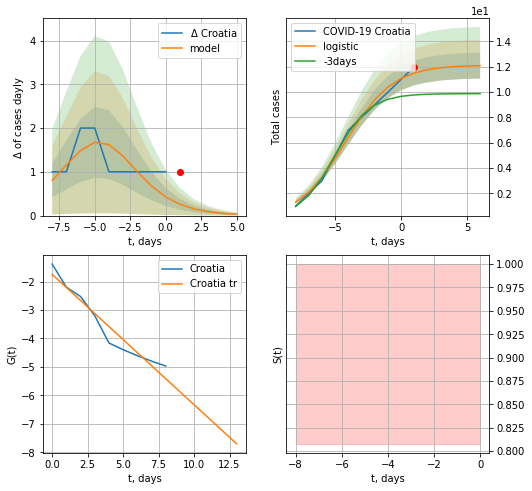

Croatia data at: 2020-05-04
model: logistic
coeffs:  [12.13023855  0.55939634 -4.20963748]
rational stdev:  0.08430442468045289
forecast at the end of period: +5 days
	 deltaDaycases:  0
	 total cases:  12 ± 1
	 total death:  0 ± 0
trend coefficient of determination: 0.936719
 intercept: -1.749041
 slope: -0.458074


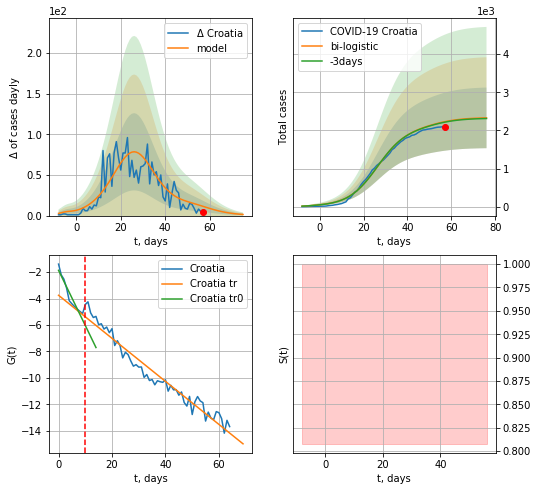

Croatia data at: 2020-05-04
+3 day model MAPE: 0.00572650053044552
model: bi-logistic
coeffs:  [2.06691029e+03 1.50606637e-01 2.63635407e+01] [12.13023855  0.55939634 -4.20963748]
scenario coeffs:  [0.125, 1.0, 2.0]
rational stdev:  0.34154884826937193
forecast at the end of period: +19 days
	 deltaDaycases:  1
	 total cases:  2328 ± 795
	 total death:  88 ± 90
bi-logistic approximation splitting point: 10
trend0 coefficient of determination: 0.922384
 intercept: -1.856940
 slope: -0.417612
trend coefficient of determination: 0.953458
 intercept: -3.746586
 slope: -0.163021


In [763]:
dfCT = read_df(pd.DataFrame(),"CT")
x = forecast("Croatia",dfCT[:10],d1,6*7-dT,pMAPE=False)
xx = forecast2("Croatia",dfCT[:],d1,8*7-dT,x,addpred=True,xcoef=[0.25/2,1.,2.],vL=10)

/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:18: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:18: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


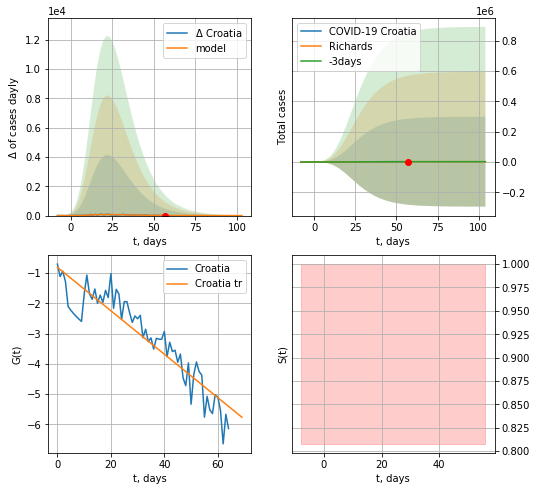

Croatia data at: 2020-05-04
+3 day model MAPE: 0.003012
model: Richards
coeffs: [ 2.21464396e+03  6.85644675e+00 -2.52047842e+01  1.31947600e-02]
rational stdev: 133.998454
forecast at the end of period: +47 days
	 deltaDaycases: 0
	 total cases: 2213 ± 296570
	 total death: 84 ± 33767
trend coefficient of determination: 0.846045
 intercept: -0.809098
 slope: -0.071843


In [764]:
x = forecastRR("Croatia",dfCT[:],d1,12*7-dT)

/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:153: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


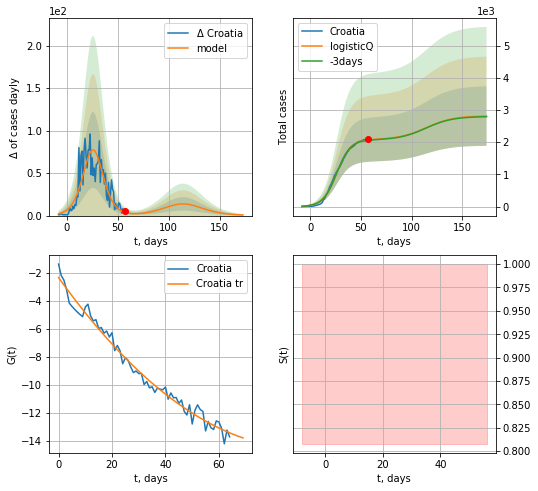

Croatia data at: 2020-05-04
+3 day model MAPE: 0.006792
model: logisticQ
coeffs: [ 2.08244855e+03  1.35177376e-06  2.62872908e+01 -1.09873738e+05]
S.Korea scenario coeffs: [0.35416971, 0.02606324, 4.35859408, 19.30413219]
rational stdev: 0.328218
forecast at the end of period: +117 days
	 deltaDaycases: 0
	 total cases: 2811 ± 922
	 total death: 107 ± 105
trend coefficient of determination: 0.981141
 intercept_: -2.3423694371268304
 coeffs_: [ 0.         -0.26568873  0.0014503 ]


In [765]:
x = forecastRRR("Croatia",dfCT[:],d1,22*7-dT,addpred=True,xcoef=koreaCoeffs)

EG
          date  cases  active  death
55 2020-04-30   5537    3764  392.0
56 2020-05-01   5895    4029  406.0
57 2020-05-02   6193    4256  415.0
58 2020-05-03   6465    4474  429.0
59 2020-05-04   6813    4745  436.0


/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 800.
  warnings.warn(errors[info][0], RuntimeWarning)


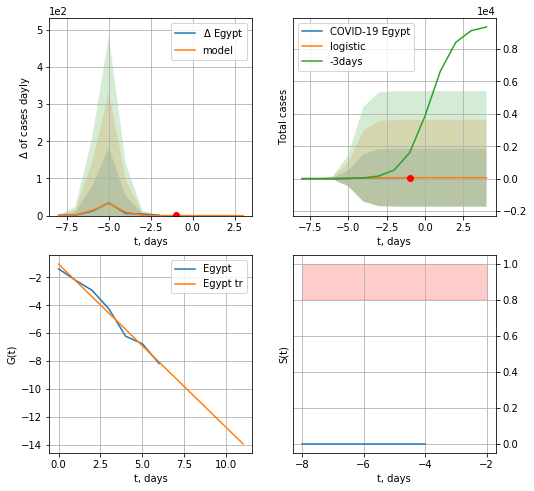

Egypt data at: 2020-05-04
+3 day model MAPE: 0.9848657964650105
model: logistic
coeffs:  [58.57021122  2.53530653 -4.60228222]
rational stdev:  30.428321363178444
forecast at the end of period: +5 days
	 deltaDaycases:  0
	 total cases:  58 ± 1782
	 total death:  3 ± 273
trend coefficient of determination: 0.982412
 intercept: -1.045837
 slope: -1.172929


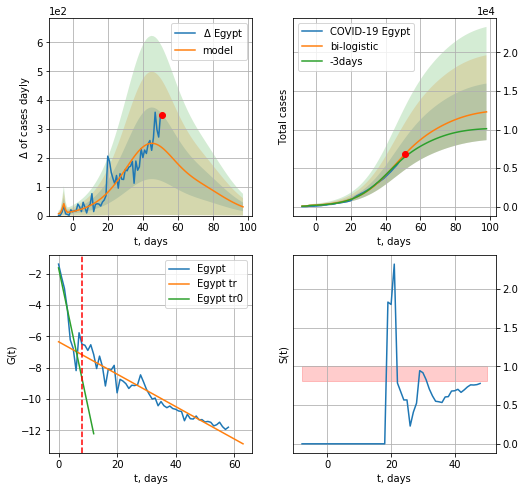

Egypt data at: 2020-05-04
+3 day model MAPE: 0.061984810257404536
model: bi-logistic
coeffs:  [1.00529491e+04 9.50922647e-02 4.46542174e+01] [58.57021122  2.53530653 -4.60228222]
scenario coeffs:  [0.25, 1.0, 1.7]
rational stdev:  0.29889509907625716
forecast at the end of period: +47 days
	 deltaDaycases:  30
	 total cases:  12288 ± 3672
	 total death:  786 ± 704
bi-logistic approximation splitting point: 8
trend0 coefficient of determination: 0.807637
 intercept: -1.627174
 slope: -0.882261
trend coefficient of determination: 0.925788
 intercept: -6.344489
 slope: -0.103453


In [766]:
dfEG = read_df(pd.DataFrame(),"EG")
x = forecast("Egypt",dfEG[:8],d1,6*7-dT)
xx = forecast2("Egypt",dfEG[:],d1,12*7-dT,x,addpred=True,xcoef=[0.25,1.,1.7],vL=8)

/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


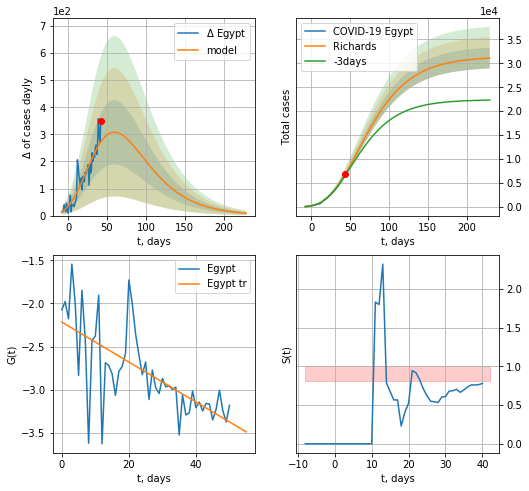

Egypt data at: 2020-05-04
+3 day model MAPE: 0.034489
model: Richards
coeffs: [ 3.14073408e+04  1.14466278e+00 -7.90706331e+01  2.35580131e-02]
rational stdev: 0.069720
forecast at the end of period: +187 days
	 deltaDaycases: 8
	 total cases: 31088 ± 2167
	 total death: 1989 ± 416
trend coefficient of determination: 0.459657
 intercept: -2.215834
 slope: -0.023159


In [767]:
x = forecastRR("Egypt",dfEG[8:],d1,32*7-dT)

/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


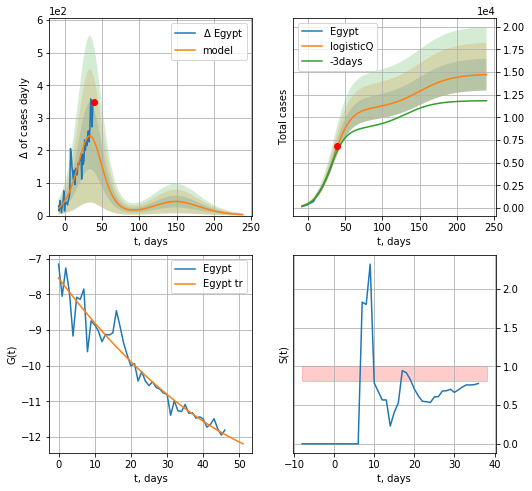

Egypt data at: 2020-05-04
+3 day model MAPE: 0.065573
model: logisticQ
coeffs: [ 1.09268082e+04  1.11707785e-05  3.42837490e+01 -7.95754288e+03]
S.Korea scenario coeffs: [0.35416971, 0.02606324, 4.35859408, 19.30413219]
rational stdev: 0.118973
forecast at the end of period: +201 days
	 deltaDaycases: 2
	 total cases: 14730 ± 1752
	 total death: 942 ± 336
trend coefficient of determination: 0.932534
 intercept_: -7.545539844829078
 coeffs_: [ 0.         -0.13385997  0.00084047]


In [768]:
x = forecastRRR("Egypt",dfEG[12:],d1,34*7-dT,addpred=True,xcoef=koreaCoeffs)

IQ
          date  cases  active  death
58 2020-04-30   2085   617.0   93.0
59 2020-05-01   2153   645.0   94.0
60 2020-05-02   2219   651.0   95.0
61 2020-05-03   2296   709.0   97.0
62 2020-05-04   2346   704.0   98.0


/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 800.
  warnings.warn(errors[info][0], RuntimeWarning)


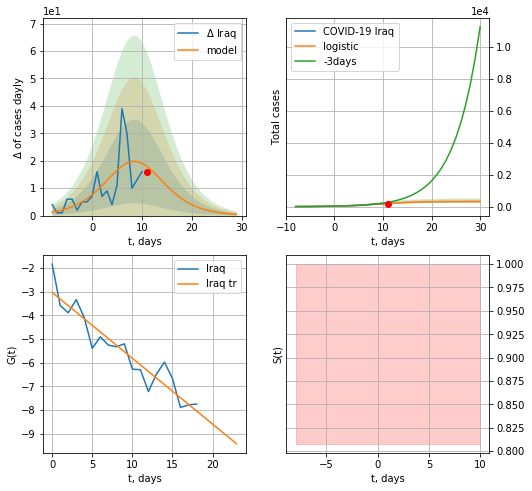

Iraq data at: 2020-05-04
+3 day model MAPE: 0.3447403684117319
model: logistic
coeffs:  [3.17081296e+02 2.50431387e-01 8.98163530e+00]
rational stdev:  0.20777406895257303
forecast at the end of period: +19 days
	 deltaDaycases:  0
	 total cases:  315 ± 65
	 total death:  13 ± 8
trend coefficient of determination: 0.889033
 intercept: -3.031672
 slope: -0.278416


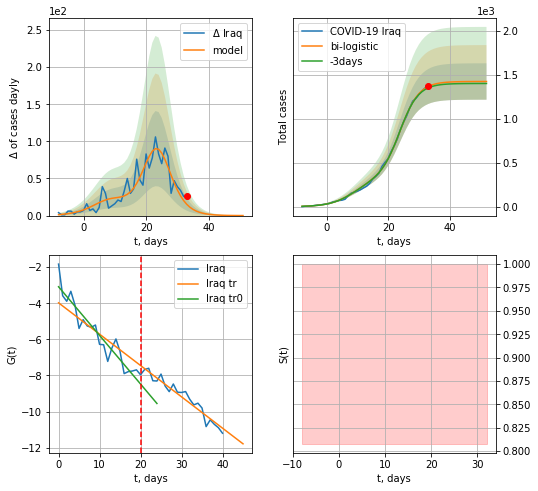

Iraq data at: 2020-05-04
+3 day model MAPE: 0.012548655608678476
model: bi-logistic
coeffs:  [1.10877596e+03 3.20225975e-01 2.39035989e+01] [3.17081296e+02 2.50431387e-01 8.98163530e+00]
rational stdev:  0.14537179336300032
forecast at the end of period: +19 days
	 deltaDaycases:  0
	 total cases:  1425 ± 207
	 total death:  59 ± 25
bi-logistic approximation splitting point: 20
trend0 coefficient of determination: 0.891989
 intercept: -3.086027
 slope: -0.269357
trend coefficient of determination: 0.928562
 intercept: -3.976586
 slope: -0.173518


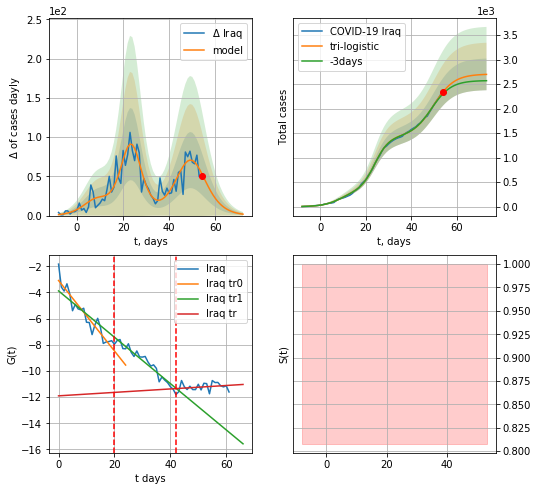

Iraq data at: 2020-05-04
+3 day model MAPE: 0.02091840793764004
model: tri-logistic
coeffs:  [1.27795039e+03 2.21432662e-01 4.97445334e+01] [3.17081296e+02 2.50431387e-01 8.98163530e+00 1.10877596e+03
 3.20225975e-01 2.39035989e+01]
forecast rational stdev:  0.11969099836002288
forecast at the end of period: +19 days
	 deltaDaycases:  1
	 total cases:  2696 ± 322
	 total death:  112 ± 40
tri-logistic approximation splitting points: 20,42
trend0 coefficient of determination: 0.891989
 intercept: -3.086027
 slope: -0.269357
trend1 coefficient of determination: 0.937217
 intercept: -3.879636
 slope: -0.177153
trend coefficient of determination: 0.058256
 intercept: -11.903907
 slope: 0.013184


In [769]:
vL=20
vL1=42
dfIQ = read_df(pd.DataFrame(),"IQ")
x = forecast("Iraq",dfIQ[:vL],d1,8*7-dT)
xx = forecast2("Iraq",dfIQ[:vL1],d1,8*7-dT,x,addpred=False,xcoef=[0.25,1.,2.],vL=vL)
xx = np.concatenate((x, xx), axis=0)
xxx = forecast3("Iraq",dfIQ[:],d1,8*7-dT, xx, shift=1.,addpred=False,xcoef=[.25,1.,2.0],vL=[vL,vL1])

/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


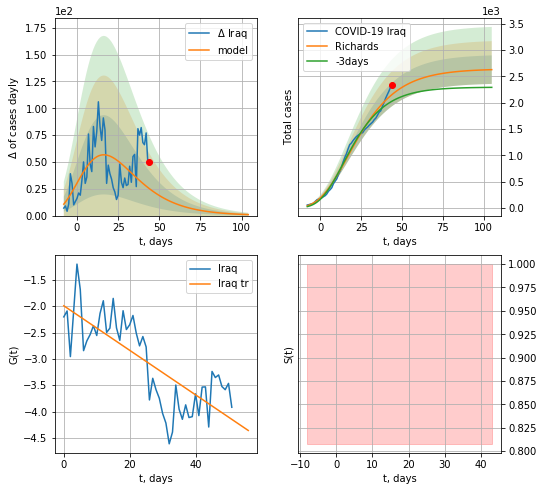

Iraq data at: 2020-05-04
+3 day model MAPE: 0.065940
model: Richards
coeffs: [ 2.64400932e+03  6.43023315e+00 -6.35732396e+01  9.09678449e-03]
rational stdev: 0.103126
forecast at the end of period: +61 days
	 deltaDaycases: 0
	 total cases: 2628 ± 271
	 total death: 109 ± 33
trend coefficient of determination: 0.592914
 intercept: -1.991767
 slope: -0.042278


In [770]:
x = forecastRR("Iraq",dfIQ[10:],d1,14*7-dT)


/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


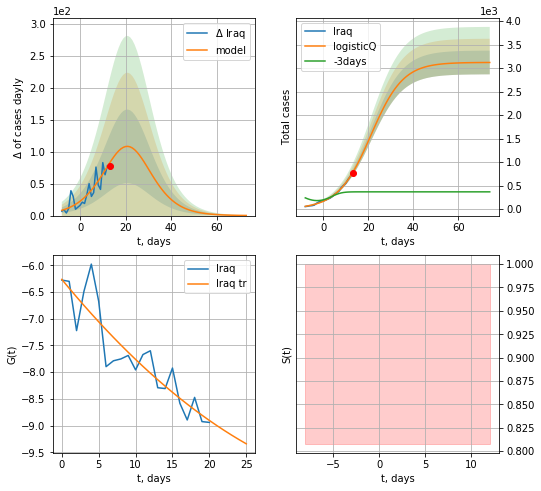

Iraq data at: 2020-05-04
+3 day model MAPE: 1.325310
model: logisticQ
coeffs: [ 3.12023575e+03  1.31776194e-04  2.10594687e+01 -1.03469115e+03]
rational stdev: 0.080850
forecast at the end of period: +61 days
	 deltaDaycases: 0
	 total cases: 3118 ± 252
	 total death: 130 ± 31
trend coefficient of determination: 0.824005
 intercept_: -6.262912434952875
 coeffs_: [ 0.         -0.16770647  0.00178172]


/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


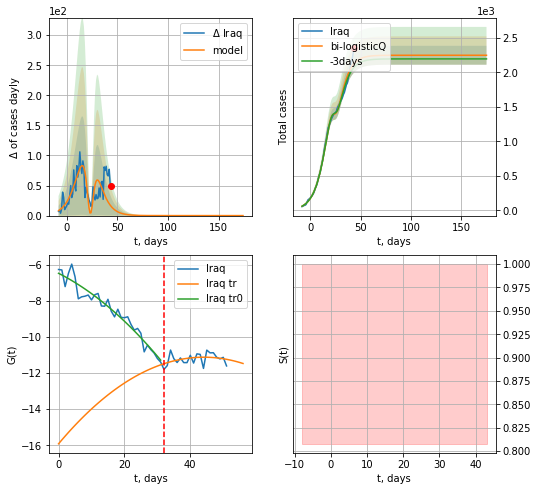

Iraq data at: 2020-05-04
+3 day model MAPE: 0.025178
model: bi-logisticQ
coeffs: [-8.72680884e+02  3.51502976e-03  2.35694809e+01 -1.09727244e+02]
rational stdev: 0.060921
forecast at the end of period: +131 days
	 deltaDaycases: 0
	 total cases: 2247 ± 136
	 total death: 93 ± 16
bi-logisticQ approximation splitting point: 32
trend coefficient of determination: 0.943011
 intercept_: -6.485709272215987
 coeffs_: [ 0.         -0.09183938 -0.00203399]
trend coefficient of determination: 0.156657
 intercept_: -15.918086697889173
 coeffs_: [ 0.          0.21726534 -0.00246275]


In [771]:
x = forecastRRR("Iraq",dfIQ[10:32],d1,14*7-dT,addpred=False,xcoef=[0.35,.5,4.,1])
xx = forecast2RRR("Iraq",dfIQ[10:],d1,24*7-dT,x,addpred=False,xcoef=koreaCoeffs,vL=32)

In [772]:
#len(dfAR)

AR
          date   cases  active  death
57 2020-04-30  4006.0  1777.0  450.0
58 2020-05-01  4154.0  1880.0  453.0
59 2020-05-02  4295.0  1964.0  459.0
60 2020-05-03  4474.0  2075.0  463.0
61 2020-05-04  4648.0  2185.0  465.0


/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 800.
  warnings.warn(errors[info][0], RuntimeWarning)


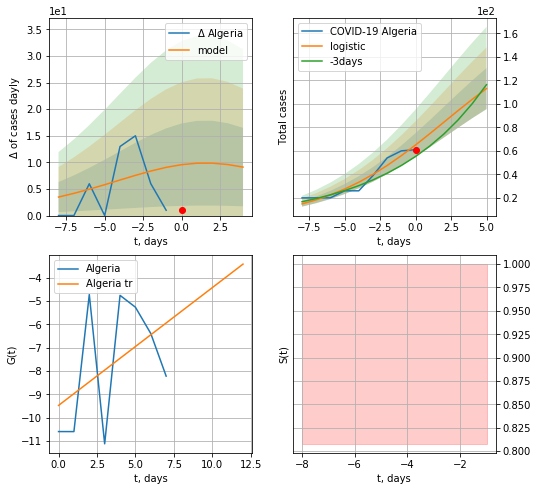

Algeria data at: 2020-05-04
+3 day model MAPE: 0.16392556519478307
model: logistic
coeffs:  [169.67177645   0.23328983   2.04237406]
rational stdev:  0.15467845008978148
forecast at the end of period: +5 days
	 deltaDaycases:  9
	 total cases:  112 ± 17
	 total death:  11 ± 5
trend coefficient of determination: 0.198482
 intercept: -9.477734
 slope: 0.504434


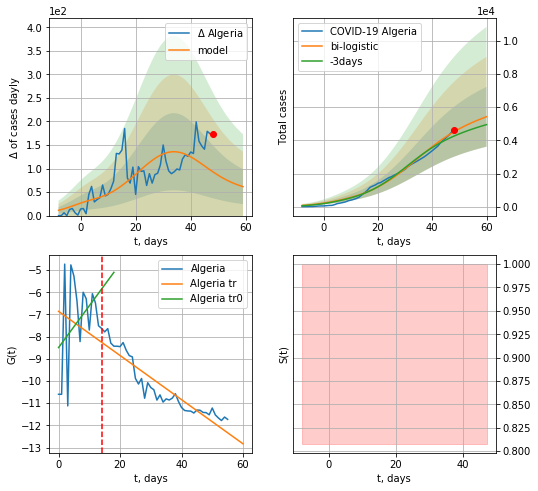

Algeria data at: 2020-05-04
+3 day model MAPE: 0.06496084705418284
model: bi-logistic
coeffs:  [5.18185549e+03 1.01566967e-01 3.37813020e+01] [169.67177645   0.23328983   2.04237406]
scenario coeffs:  [0.25, 1.0, 2.0]
rational stdev:  0.3320414814055837
forecast at the end of period: +12 days
	 deltaDaycases:  61
	 total cases:  5424 ± 1801
	 total death:  542 ± 539
bi-logistic approximation splitting point: 14
trend0 coefficient of determination: 0.134003
 intercept: -8.492024
 slope: 0.188486
trend coefficient of determination: 0.868171
 intercept: -6.857473
 slope: -0.099569


In [773]:
dfAR = read_df(pd.DataFrame(),"AR")
x = forecast("Algeria",dfAR[5:14],d1,6*7-dT)
xx = forecast2("Algeria",dfAR[5:],d1,7*7-dT,x,addpred=True,xcoef=[0.25,1.,2.],vL=14)

/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


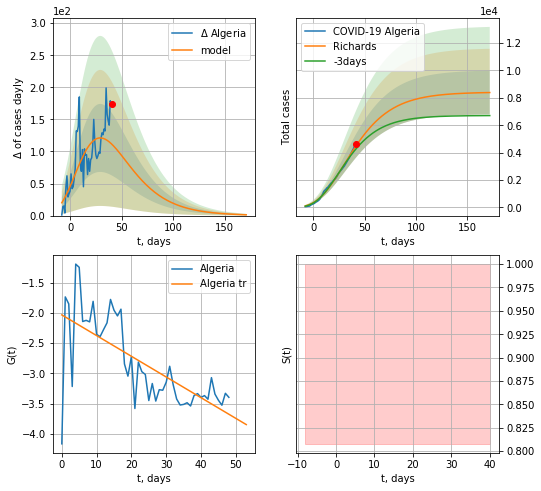

Algeria data at: 2020-05-04
+3 day model MAPE: 0.053012
model: Richards
coeffs: [ 8.41779463e+03  3.00054326e+00 -8.03140058e+01  1.31188817e-02]
rational stdev: 0.190438
forecast at the end of period: +131 days
	 deltaDaycases: 1
	 total cases: 8386 ± 1597
	 total death: 839 ± 479
trend coefficient of determination: 0.481146
 intercept: -2.032402
 slope: -0.034231


In [774]:
x = forecastRR("Algeria",dfAR[12:],d1,24*7-dT)

/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


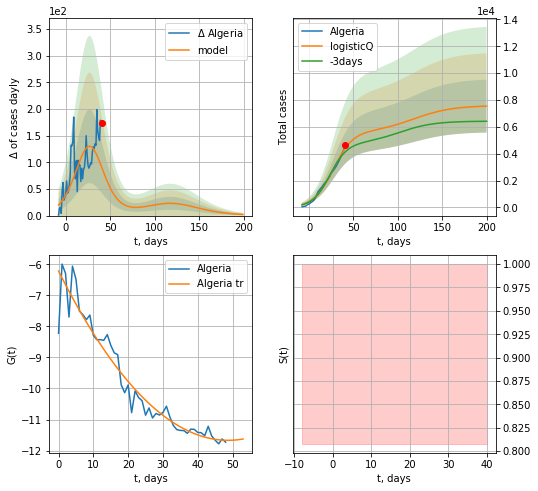

Algeria data at: 2020-05-04
+3 day model MAPE: 0.073316
model: logisticQ
coeffs: [ 5.60303653e+03  1.70919725e-06  2.71141865e+01 -5.37914830e+04]
S.Korea scenario coeffs: [0.35416971, 0.02606324, 4.35859408, 19.30413219]
rational stdev: 0.260757
forecast at the end of period: +159 days
	 deltaDaycases: 2
	 total cases: 7543 ± 1967
	 total death: 754 ± 589
trend coefficient of determination: 0.931010
 intercept_: -6.219885782287269
 coeffs_: [ 0.         -0.22369899  0.00229577]


In [775]:
x = forecastRRR("Algeria",dfAR[12:],d1,28*7-dT,addpred=True,xcoef=koreaCoeffs)

CP
          date  cases  active  death
49 2020-04-30  850.0   539.0   15.0
50 2020-05-01  857.0   546.0   15.0
51 2020-05-02  864.0   553.0   15.0
52 2020-05-03  872.0   561.0   15.0
53 2020-05-04  874.0   563.0   15.0


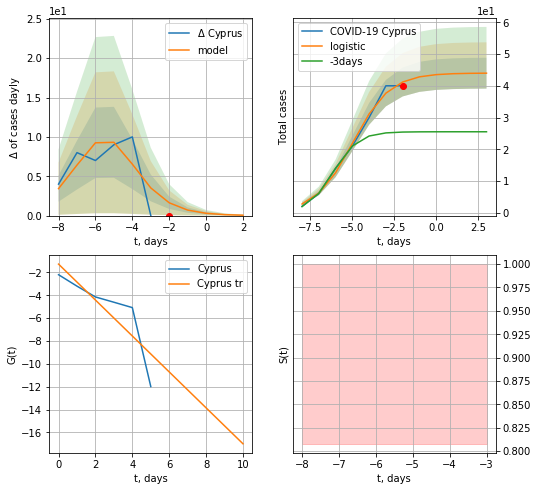

Cyprus data at: 2020-05-04
+3 day model MAPE: 0.6804910041763989
model: logistic
coeffs:  [44.00930084  0.89972657 -4.98223467]
rational stdev:  0.11057143078785021
forecast at the end of period: +5 days
	 deltaDaycases:  0
	 total cases:  43 ± 4
	 total death:  0 ± 0
trend coefficient of determination: 0.714597
 intercept: -1.270285
 slope: -1.572073


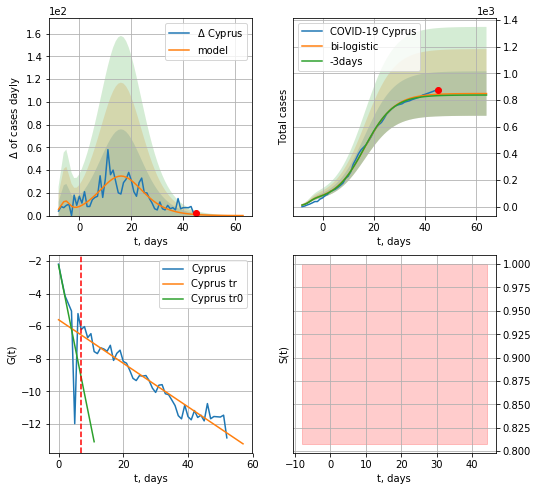

Cyprus data at: 2020-05-04
+3 day model MAPE: 0.012337903081551478
model: bi-logistic
coeffs:  [8.05080890e+02 1.73044897e-01 1.65196906e+01] [44.00930084  0.89972657 -4.98223467]
rational stdev:  0.19605593314809205
forecast at the end of period: +19 days
	 deltaDaycases:  0
	 total cases:  848 ± 166
	 total death:  14 ± 8
bi-logistic approximation splitting point: 7
trend0 coefficient of determination: 0.449603
 intercept: -2.247366
 slope: -0.985825
trend coefficient of determination: 0.938549
 intercept: -5.608992
 slope: -0.133514


In [776]:
dfCP = read_df(pd.DataFrame(),"CP")
x = forecast("Cyprus",dfCP[:7],d1,6*7-dT)
xx = forecast2("Cyprus",dfCP[:],d1,8*7-dT,x,addpred=False,xcoef=[0.25,1.,2.3],vL=7)

/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:18: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:18: RuntimeWarning: divide by zero encountered in true_divide


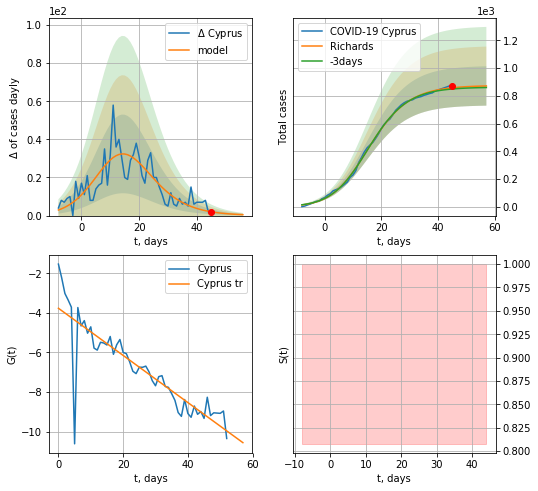

Cyprus data at: 2020-05-04
+3 day model MAPE: 0.010729
model: Richards
coeffs: [8.75022127e+02 2.07950438e-01 1.13381067e+01 6.30729000e-01]
rational stdev: 0.162761
forecast at the end of period: +12 days
	 deltaDaycases: 0
	 total cases: 871 ± 141
	 total death: 14 ± 6
trend coefficient of determination: 0.753026
 intercept: -3.767772
 slope: -0.119199


In [777]:
x = forecastRR("Cyprus",dfCP[:],d1,7*7-dT)

/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:153: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


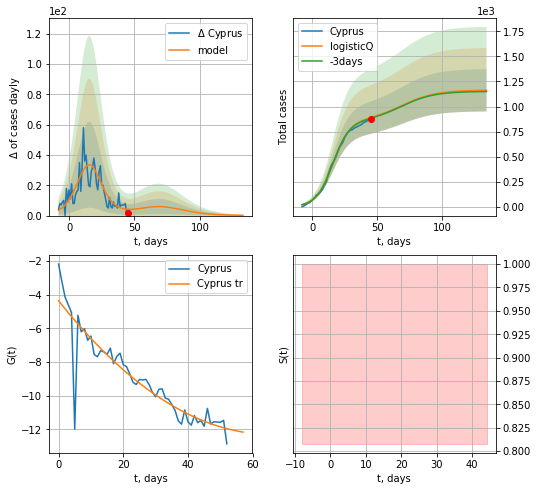

Cyprus data at: 2020-05-04
+3 day model MAPE: 0.008496
model: logisticQ
coeffs: [ 8.59514273e+02  3.42561705e-06  1.58591415e+01 -4.51761862e+04]
S.Korea scenario coeffs: [0.35416971, 0.02606324, 4.35859408, 19.30413219]
rational stdev: 0.181471
forecast at the end of period: +89 days
	 deltaDaycases: 0
	 total cases: 1161 ± 210
	 total death: 19 ± 10
trend coefficient of determination: 0.826064
 intercept_: -4.367699309168493
 coeffs_: [ 0.         -0.24161592  0.00184136]


In [778]:
vL=33
x = forecastRRR("Cyprus",dfCP[:],d1,18*7-dT,addpred=True,xcoef=koreaCoeffs)
#xx = forecast2RRR("Cyprus",dfCP[:],d1,20*7-dT,x,addpred=True,xcoef=[0.35,.5,4,1],vL=vL)

PU
          date  cases   active   death
54 2020-04-30  36976  25520.0  1051.0
55 2020-05-01  40459  28206.0  1124.0
56 2020-05-02  42534  28900.0  1200.0
57 2020-05-03  45928  31092.0  1286.0
58 2020-05-04  47372  31601.0  1344.0


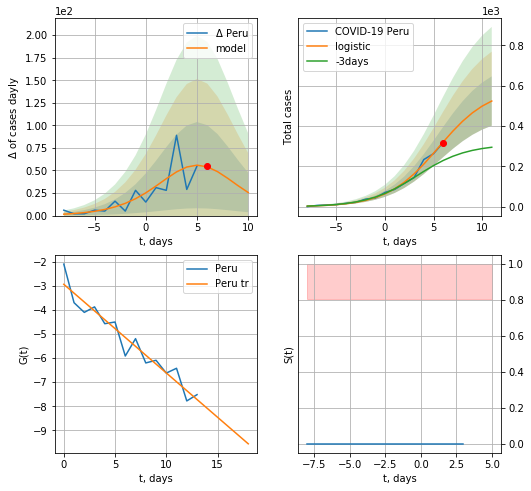

Peru data at: 2020-05-04
+3 day model MAPE: 0.4976759510371563
model: logistic
coeffs:  [5.88914141e+02 3.80777382e-01 5.52424877e+00]
rational stdev:  0.23355774891059702
forecast at the end of period: +5 days
	 deltaDaycases:  25
	 total cases:  523 ± 122
	 total death:  14 ± 9
trend coefficient of determination: 0.924015
 intercept: -2.937528
 slope: -0.367722


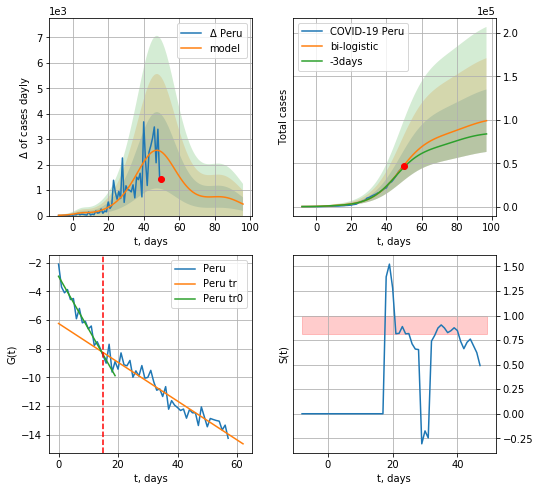

Peru data at: 2020-05-04
+3 day model MAPE: 0.057660657242821614
model: bi-logistic
coeffs:  [8.22649348e+04 1.23743006e-01 4.77710324e+01] [5.88914141e+02 3.80777382e-01 5.52424877e+00]
scenario coeffs:  [0.25, 1.0, 1.8]
rational stdev:  0.36392753944544265
forecast at the end of period: +47 days
	 deltaDaycases:  452
	 total cases:  99042 ± 36044
	 total death:  2809 ± 3066
bi-logistic approximation splitting point: 15
trend0 coefficient of determination: 0.936345
 intercept: -2.948740
 slope: -0.365135
trend coefficient of determination: 0.922127
 intercept: -6.243206
 slope: -0.135488


In [779]:
dfPU = read_df(pd.DataFrame(),"PU")
dfPU = dfPU.fillna(0)
x = forecast("Peru",dfPU[:15],d1,6*7-dT)
xx = forecast2("Peru",dfPU[:],d1,12*7-dT,x,addpred=True,xcoef=[0.25,1.,1.8],vL=15)

/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:18: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:18: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


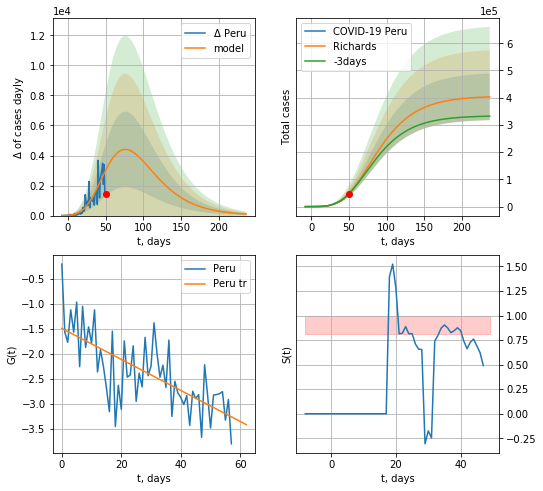

Peru data at: 2020-05-04
+3 day model MAPE: 0.017818
model: Richards
coeffs: [ 4.06502423e+05  1.02798007e+00 -4.18808634e+01  2.90760288e-02]
rational stdev: 0.212317
forecast at the end of period: +187 days
	 deltaDaycases: 100
	 total cases: 403163 ± 85598
	 total death: 11438 ± 7285
trend coefficient of determination: 0.488836
 intercept: -1.495067
 slope: -0.031038


In [781]:
x = forecastRR("Peru",dfPU[:],d1,32*7-dT)

/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:153: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


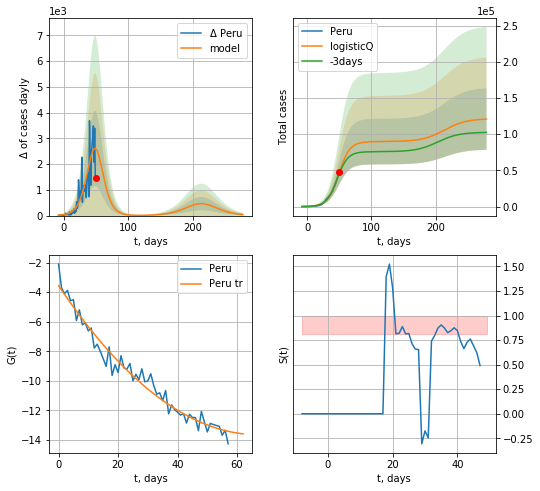

Peru data at: 2020-05-04
+3 day model MAPE: 0.047476
model: logisticQ
coeffs: [ 8.97572534e+04  5.92483748e-06  4.89920140e+01 -1.95825250e+04]
S.Korea scenario coeffs: [0.35416971, 0.02606324, 4.35859408, 19.30413219]
rational stdev: 0.351087
forecast at the end of period: +229 days
	 deltaDaycases: 39
	 total cases: 120867 ± 42434
	 total death: 3429 ± 3611
trend coefficient of determination: 0.965017
 intercept_: -3.5547949606872873
 coeffs_: [ 0.         -0.29996895  0.00222937]


In [782]:
x = forecastRRR("Peru",dfPU[:].fillna(0),d1,38*7-dT,addpred=True,xcoef=koreaCoeffs)

ID
          date  cases   active   death
61 2020-04-30  35043  24821.0  1154.0
62 2020-05-01  37336  26106.0  1223.0
63 2020-05-02  39980  27838.0  1323.0
64 2020-05-03  42533  29367.0  1391.0
65 2020-05-04  46437  32024.0  1566.0


/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 800.
  warnings.warn(errors[info][0], RuntimeWarning)


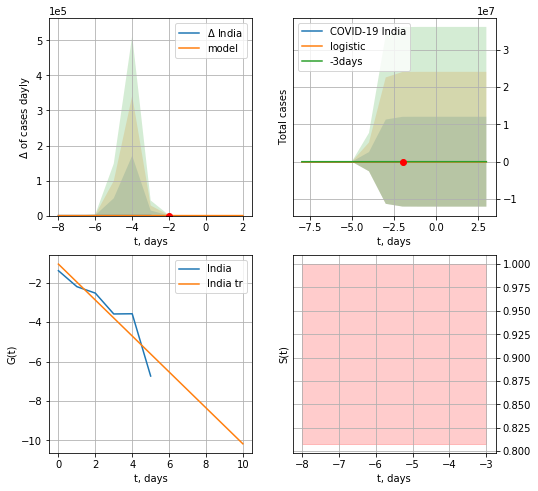

India data at: 2020-05-04
+3 day model MAPE: 0.19485949734745373
model: logistic
coeffs:  [29.40035511  4.01433678 -3.67575724]
rational stdev:  409363.3184161478
forecast at the end of period: +5 days
	 deltaDaycases:  0
	 total cases:  29 ± 12035426
	 total death:  0 ± 0
trend coefficient of determination: 0.835838
 intercept: -1.052904
 slope: -0.912220


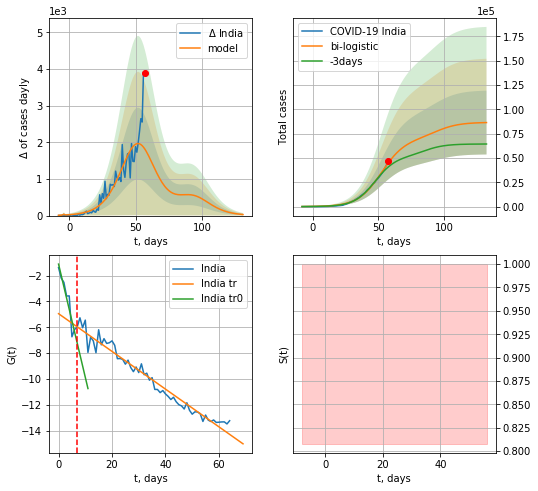

India data at: 2020-05-04
+3 day model MAPE: 0.10963477336422156
model: bi-logistic
coeffs:  [6.93237389e+04 1.12522918e-01 5.21840747e+01] [29.40035511  4.01433678 -3.67575724]
scenario coeffs:  [0.25, 1.0, 1.8]
rational stdev:  0.37942130088147374
forecast at the end of period: +75 days
	 deltaDaycases:  28
	 total cases:  86439 ± 32797
	 total death:  2915 ± 3318
bi-logistic approximation splitting point: 7
trend0 coefficient of determination: 0.879788
 intercept: -1.115653
 slope: -0.874570
trend coefficient of determination: 0.961710
 intercept: -4.947795
 slope: -0.145816


In [783]:
dfID = read_df(pd.DataFrame(),"ID")
x = forecast("India",dfID[:7],d1,6*7-dT)
xx = forecast2("India",dfID[:],d1,16*7-dT,x,addpred=True,xcoef=[0.25,1.,1.8],vL=7)

/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


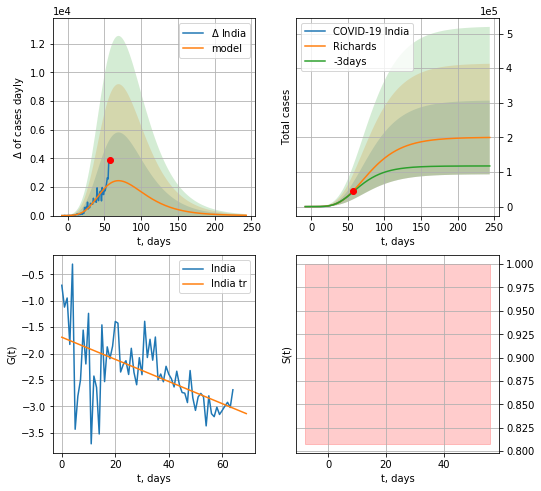

India data at: 2020-05-04
+3 day model MAPE: 0.062600
model: Richards
coeffs: [ 2.00279315e+05  1.72060333e+00 -4.82088337e+01  1.94304433e-02]
rational stdev: 0.533297
forecast at the end of period: +187 days
	 deltaDaycases: 19
	 total cases: 199690 ± 106494
	 total death: 6734 ± 10773
trend coefficient of determination: 0.330653
 intercept: -1.690387
 slope: -0.020951


In [784]:
x = forecastRR("India",dfID[:],d1,32*7-dT)

/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


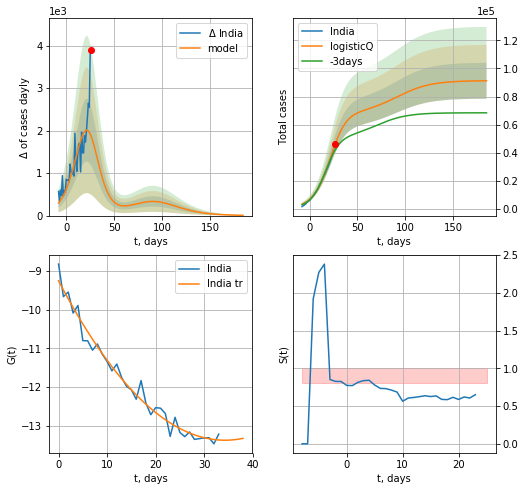

India data at: 2020-05-04
+3 day model MAPE: 0.100500
model: logisticQ
coeffs: [ 6.74729315e+04  3.91221667e-04  2.07371250e+01 -2.78819831e+02]
S.Korea scenario coeffs: [0.35416971, 0.02606324, 4.35859408, 19.30413219]
rational stdev: 0.140387
forecast at the end of period: +159 days
	 deltaDaycases: 6
	 total cases: 91259 ± 12811
	 total death: 3077 ± 1295
trend coefficient of determination: 0.975476
 intercept_: -9.256031887912254
 coeffs_: [ 0.         -0.2403772   0.00350419]


In [785]:
x = forecastRRR("India",dfID[31:].fillna(0),d1,28*7-dT,addpred=True,xcoef=koreaCoeffs)

AG
          date   cases  active  death
57 2020-04-30  4428.0  2954.0  218.0
58 2020-05-01  4532.0  3015.0  225.0
59 2020-05-02  4681.0  3124.0  237.0
60 2020-05-03  4783.0  3183.0  246.0
61 2020-05-04  4887.0  3185.0  260.0


/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 800.
  warnings.warn(errors[info][0], RuntimeWarning)


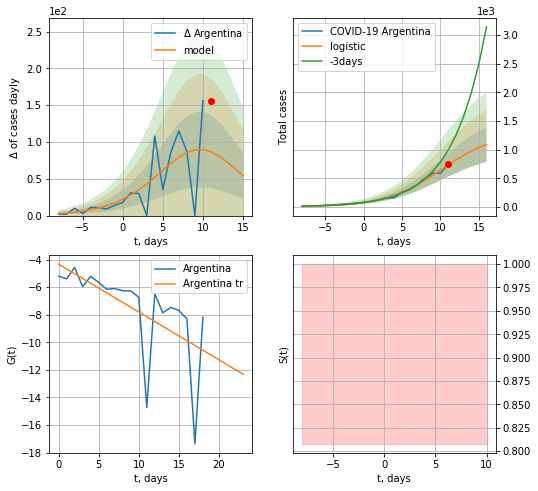

Argentina data at: 2020-05-04
+3 day model MAPE: 0.3427791439688051
model: logistic
coeffs:  [1.30607344e+03 2.75914265e-01 1.01155997e+01]
rational stdev:  0.2777261346981541
forecast at the end of period: +5 days
	 deltaDaycases:  54
	 total cases:  1090 ± 302
	 total death:  58 ± 48
trend coefficient of determination: 0.364190
 intercept: -4.325611
 slope: -0.347113


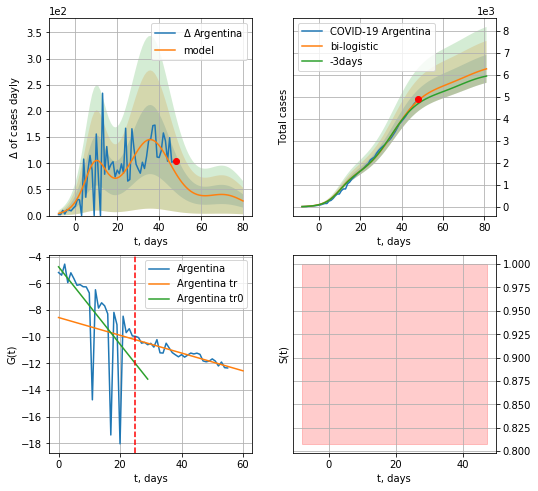

Argentina data at: 2020-05-04
+3 day model MAPE: 0.03263393113044464
model: bi-logistic
coeffs:  [4.18049568e+03 1.38016087e-01 3.61729122e+01] [1.30607344e+03 2.75914265e-01 1.01155997e+01]
scenario coeffs:  [0.25, 1.0, 2.0]
rational stdev:  0.10119183828819298
forecast at the end of period: +33 days
	 deltaDaycases:  27
	 total cases:  6280 ± 635
	 total death:  334 ± 101
bi-logistic approximation splitting point: 25
trend0 coefficient of determination: 0.360462
 intercept: -4.766843
 slope: -0.290012
trend coefficient of determination: 0.865317
 intercept: -8.564870
 slope: -0.066526


In [786]:
vL = 25
#vL1 = 40
dfAG = read_df(pd.DataFrame(),"AG")
x = forecast('Argentina',dfAG[5:vL],d1,6*7-dT,1.0)
xx = forecast2('Argentina',dfAG[5:],d1,10*7-dT,x,1.0,vL=vL,addpred=True,xcoef=[.25,1.,2.0])
#xx = np.concatenate((x, xx), axis=0)
#xxx = forecast3("Argentina",dfAG[5:],d1,8*7-dT, xx, shift=1.,addpred=False,xcoef=[.25,1.,2.0],vL=[vL,vL1])

/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


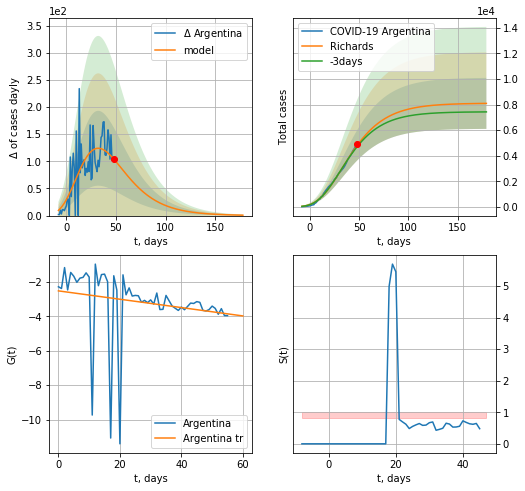

Argentina data at: 2020-05-04
+3 day model MAPE: 0.022322
model: Richards
coeffs: [ 8.10644581e+03  3.13079985e+00 -7.03580261e+01  1.33821513e-02]
rational stdev: 0.246489
forecast at the end of period: +131 days
	 deltaDaycases: 0
	 total cases: 8088 ± 1993
	 total death: 430 ± 317
trend coefficient of determination: 0.039475
 intercept: -2.529566
 slope: -0.024228


In [787]:
x = forecastRR('Argentina',dfAG[5:].fillna(0),d1,24*7-dT,1.0)


/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


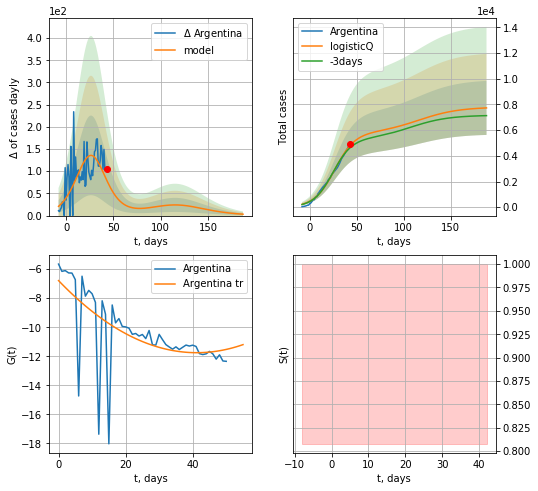

Argentina data at: 2020-05-04
+3 day model MAPE: 0.039504
model: logisticQ
coeffs: [ 5.76068141e+03  1.63255496e-06  2.66287417e+01 -5.70896763e+04]
S.Korea scenario coeffs: [0.35416971, 0.02606324, 4.35859408, 19.30413219]
rational stdev: 0.272019
forecast at the end of period: +145 days
	 deltaDaycases: 3
	 total cases: 7733 ± 2103
	 total death: 411 ± 335
trend coefficient of determination: 0.361466
 intercept_: -6.787062300579829
 coeffs_: [ 0.         -0.24094222  0.00292348]


In [788]:
x = forecastRRR('Argentina',dfAG[10:],d1,26*7-dT,1.0,addpred=True,xcoef=koreaCoeffs)

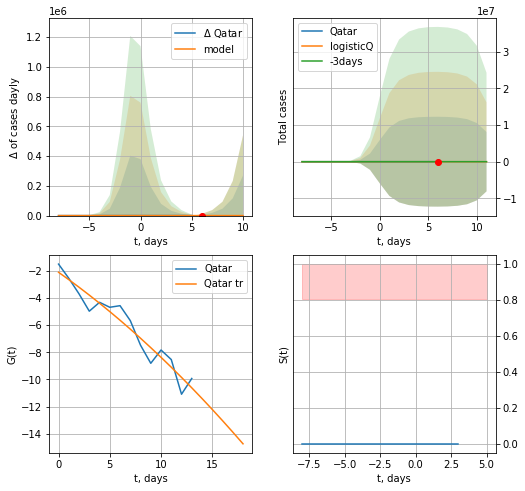

Qatar data at: 2020-05-04
+3 day model MAPE: 10.389766
model: logisticQ
coeffs: [ 4.40923501e+02 -1.12413074e-01  1.14811089e+01  1.00067900e-01]
rational stdev: 28560.888310
forecast at the end of period: +5 days
	 deltaDaycases: -86
	 total cases: 283 ± 8100560
	 total death: 0 ± 0
trend coefficient of determination: 0.925886
 intercept_: -2.1066548119132458
 coeffs_: [ 0.         -0.53152809 -0.00944941]


/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:288: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


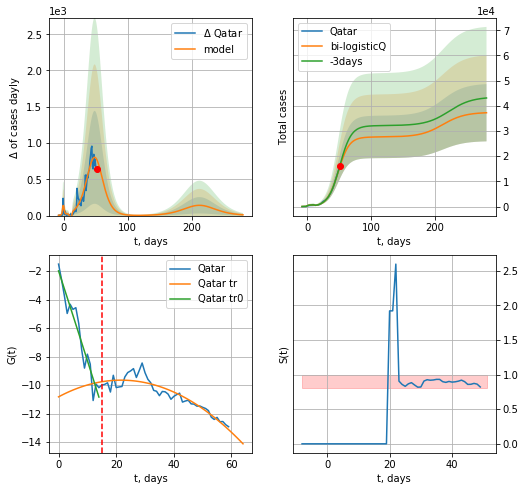

Qatar data at: 2020-05-04
+3 day model MAPE: 0.037167
model: bi-logisticQ
coeffs: [ 2.76411108e+04  3.03366663e-05  4.87167850e+01 -3.78519558e+03]
S.Korea scenario coeffs: [0.35416971, 0.02606324, 4.35859408, 19.30413219]
rational stdev: 0.304817
forecast at the end of period: +229 days
	 deltaDaycases: 10
	 total cases: 37251 ± 11354
	 total death: 27 ± 24
bi-logisticQ approximation splitting point: 15
trend coefficient of determination: 0.929567
 intercept_: -1.9786509648817043
 coeffs_: [ 0.         -0.62175364 -0.00080828]
trend coefficient of determination: 0.862444
 intercept_: -10.82677819115488
 coeffs_: [ 0.          0.10822831 -0.00249623]


In [789]:
vL=15
x = forecastRRR('Qatar',dfQR[:vL].fillna(0),d1,6*7-dT,1.0,addpred=False,xcoef=[.35,.5,4.0,1])
xx = forecast2RRR('Qatar',dfQR[:].fillna(0),d1,38*7-dT,x,1.0,addpred=True,xcoef=koreaCoeffs,vL=vL)

/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:79: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:118: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.5/dist-packages/numpy/core/_methods.py:193: RuntimeWarning: invalid value encountered in subtract
  x = asanyarray(arr - arrmean)


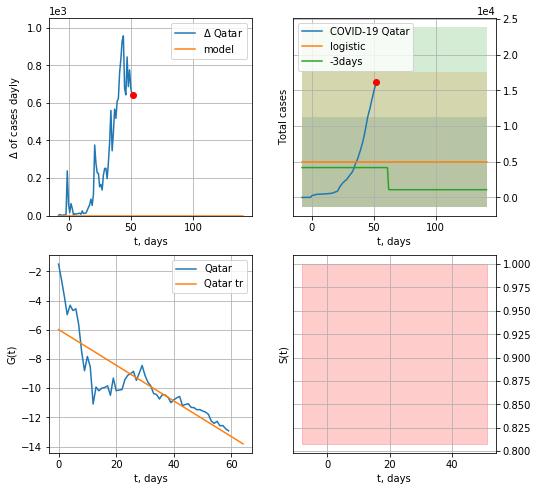

Qatar data at: 2020-05-04
+3 day model MAPE: 0.197215912557476
model: logistic
coeffs:  [3713.00001957   -4.46739801  303.31264303]
scenario coeffs:  [0.35, 0.5, 4.0, 1]
rational stdev:  1.255913740620067
forecast at the end of period: +89 days
	 deltaDaycases:  0
	 total cases:  5012 ± 6295
	 total death:  3 ± 11
trend coefficient of determination: 0.697422
 intercept: -5.983417
 slope: -0.122323


In [790]:
x = forecast('Qatar',dfQR[:],d1,18*7-dT,1.0,addpred=True,xcoef=[.35,.5,4.0,1])

UAE
          date    cases  active  death
75 2020-04-30  12481.0       0    0.0
76 2020-05-01  13038.0   10384  111.0
77 2020-05-02  13599.0   10816  119.0
78 2020-05-03  14163.0   11274  126.0
79 2020-05-04  14730.0   11627  137.0


/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:153: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


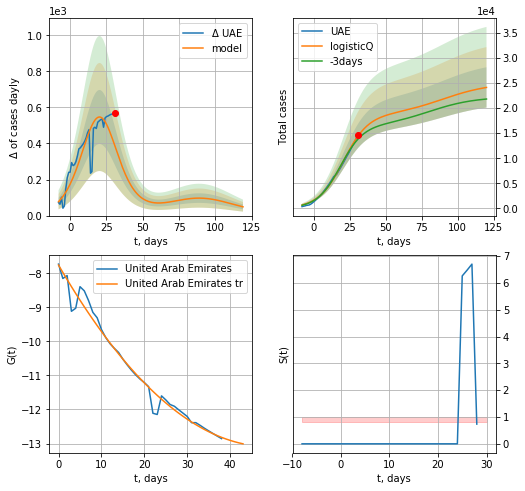

UAE data at: 2020-05-04
+3 day model MAPE: 0.050316
model: logisticQ
coeffs: [ 1.85318077e+04  3.58144032e-06  2.05715268e+01 -3.25688342e+04]
S.Korea scenario coeffs: [0.35416971, 0.02606324, 4.35859408, 19.30413219]
rational stdev: 0.167010
forecast at the end of period: +89 days
	 deltaDaycases: 48
	 total cases: 24148 ± 4033
	 total death: 224 ± 112
trend coefficient of determination: 0.976439
 intercept_: -7.75992116811617
 coeffs_: [ 0.         -0.21722334  0.00221352]


In [791]:
dfUAE = read_df(pd.DataFrame(),"UAE")
x = forecastRRR('UAE',dfUAE[40:],d1,18*7-dT,1.0,addpred=True,xcoef=koreaCoeffs)

/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:18: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:18: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


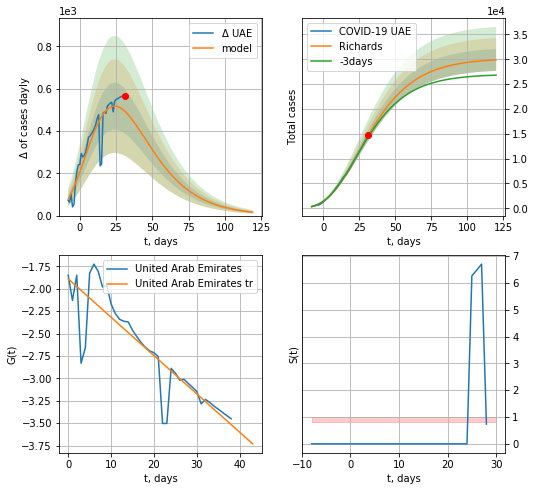

UAE data at: 2020-05-04
+3 day model MAPE: 0.022807
model: Richards
coeffs: [ 3.02157033e+04  2.32375449e+00 -5.83978580e+01  2.02401008e-02]
rational stdev: 0.073933
forecast at the end of period: +89 days
	 deltaDaycases: 16
	 total cases: 29878 ± 2209
	 total death: 277 ± 61
trend coefficient of determination: 0.778768
 intercept: -1.889613
 slope: -0.042819


/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:15: RuntimeWarning: overflow encountered in power
  from ipykernel import kernelapp as app
/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1200.
  warnings.warn(errors[info][0], RuntimeWarning)


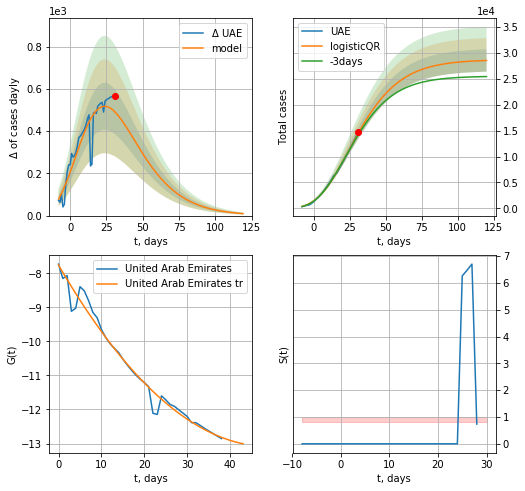

UAE data at: 2020-05-04
+3 day model MAPE: 0.023898458564778475
model: logisticQR
coeffs:  [ 2.87083222e+04  9.14447704e-03 -9.72703363e+01 -7.67573199e+02
  5.88886465e-03]
rational stdev:  0.07564203587145028
forecast at the end of period: +89 days
	 deltaDaycases:  9
	 total cases:  28558 ± 2160
	 total death:  265 ± 60
trend coefficient of determination: 0.976439
 intercept_: -7.75992116811617
 coeffs_: [ 0.         -0.21722334  0.00221352]


In [792]:
x = forecastRR('UAE',dfUAE[40:],d1,18*7-dT,1.0,addpred=False,xcoef=koreaCoeffs)
x = forecastQR('UAE',dfUAE[40:],d1,18*7-dT,1.0,addpred=False,xcoef=koreaCoeffs)

In [793]:
#plt.plot(range(len(dfUAE[45:])-1),np.log(np.log(np.log(np.diff(dfUAE[45:].cases)))))

SA
          date    cases  active  death
58 2020-04-30  22753.0       0    0.0
59 2020-05-01  24097.0   20373  169.0
60 2020-05-02  25459.0   21518  176.0
61 2020-05-03  27011.0   22693  184.0
62 2020-05-04  28656.0   23989  191.0


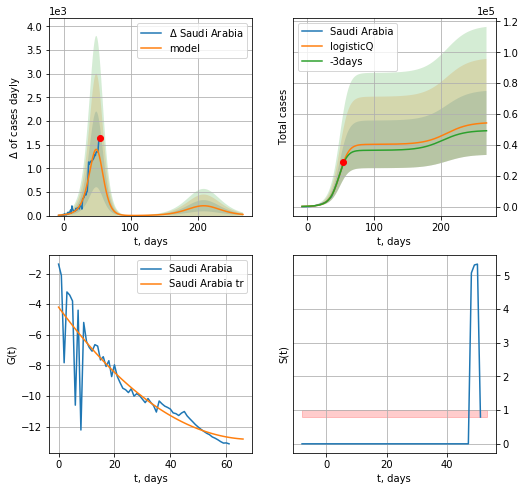

Saudi Arabia data at: 2020-05-04
+3 day model MAPE: 0.029501
model: logisticQ
coeffs: [ 4.03194720e+04  6.10226811e-04  4.79942199e+01 -1.78798421e+02]
S.Korea scenario coeffs: [0.35416971, 0.02606324, 4.35859408, 19.30413219]
rational stdev: 0.382599
forecast at the end of period: +215 days
	 deltaDaycases: 24
	 total cases: 54196 ± 20735
	 total death: 361 ± 414
trend coefficient of determination: 0.794888
 intercept_: -4.194835149946844
 coeffs_: [ 0.         -0.24849124  0.0017874 ]


In [794]:
dfSA = read_df(pd.DataFrame(),"SA")
x = forecastRRR('Saudi Arabia',dfSA[:],d1,36*7-dT,1.0,addpred=True,xcoef=koreaCoeffs)

/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:18: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:18: RuntimeWarning: divide by zero encountered in true_divide


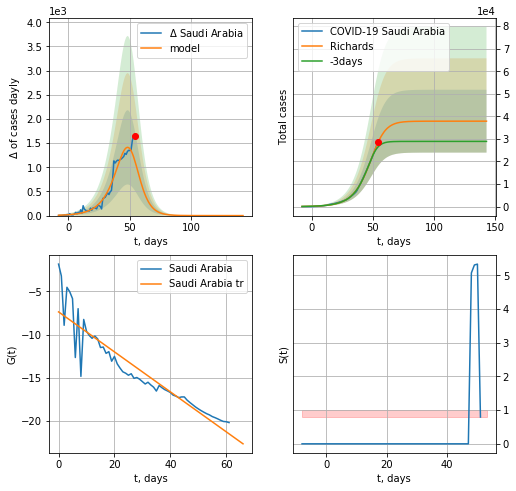

Saudi Arabia data at: 2020-05-04
+3 day model MAPE: 0.091651
model: Richards
coeffs: [3.78715642e+04 1.06770139e-01 5.15448514e+01 1.68781841e+00]
rational stdev: 0.367755
forecast at the end of period: +89 days
	 deltaDaycases: 0
	 total cases: 37871 ± 13927
	 total death: 252 ± 278
trend coefficient of determination: 0.863598
 intercept: -7.385348
 slope: -0.231041


/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:15: RuntimeWarning: overflow encountered in power
  from ipykernel import kernelapp as app
/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1200.
  warnings.warn(errors[info][0], RuntimeWarning)


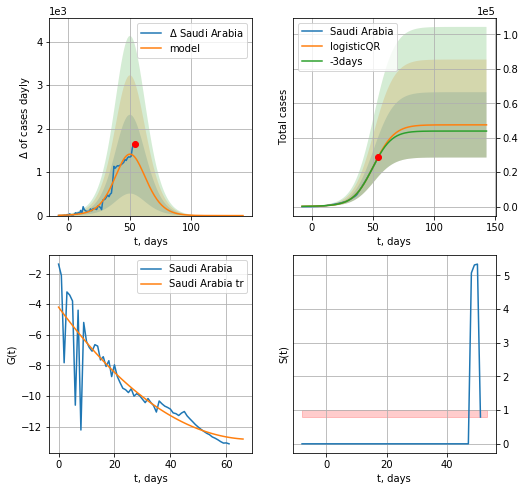

Saudi Arabia data at: 2020-05-04
+3 day model MAPE: 0.010025696822717737
model: logisticQR
coeffs:  [ 4.74801172e+04  1.72677956e-03  3.83731290e+01 -7.54943881e+01
  4.13258554e-01]
rational stdev:  0.3993878711716573
forecast at the end of period: +89 days
	 deltaDaycases:  0
	 total cases:  47480 ± 18962
	 total death:  316 ± 378
trend coefficient of determination: 0.794888
 intercept_: -4.194835149946844
 coeffs_: [ 0.         -0.24849124  0.0017874 ]


In [795]:
x = forecastRR('Saudi Arabia',dfSA[:],d1,18*7-dT,1.0,addpred=False,xcoef=koreaCoeffs)
x = forecastQR('Saudi Arabia',dfSA[:],d1,18*7-dT,1.0,addpred=False,xcoef=koreaCoeffs)

Sri
          date  cases  active  death
49 2020-04-28  619.0       0      0
50 2020-04-29  649.0       0      0
51 2020-04-30  663.0       0      0
52 2020-05-01  690.0       0      0
53 2020-05-02  702.0       0      0


/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


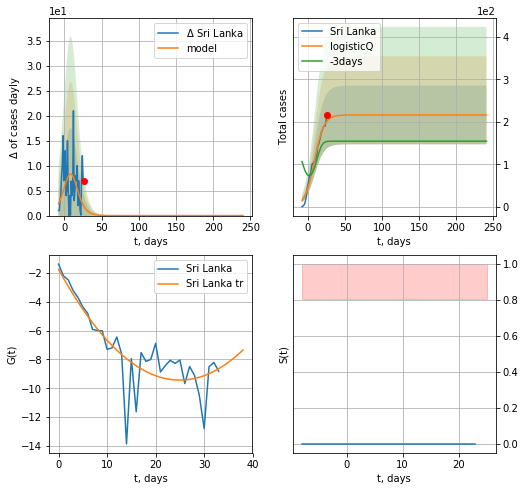

Sri Lanka data at: 2020-05-04
+3 day model MAPE: 0.324795
model: logisticQ
coeffs: [ 2.16378650e+02  6.51099157e-05  8.63891239e+00 -2.35705824e+03]
rational stdev: 0.318765
forecast at the end of period: +215 days
	 deltaDaycases: 0
	 total cases: 216 ± 68
	 total death: 2 ± 1
trend coefficient of determination: 0.700492
 intercept_: -1.7495743977322356
 coeffs_: [ 0.         -0.61543768  0.0123203 ]


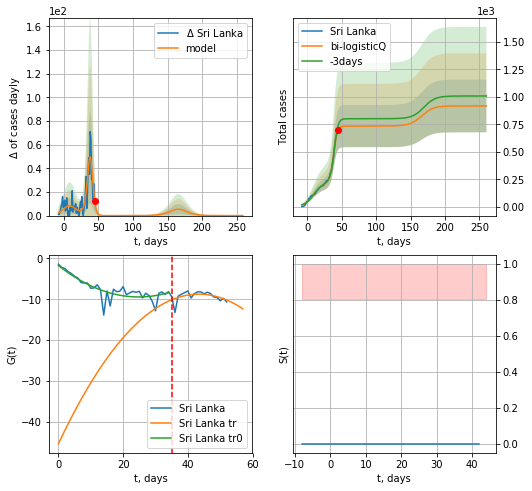

Sri Lanka data at: 2020-05-04
+3 day model MAPE: 0.062838
model: bi-logisticQ
coeffs: [ 5.18033887e+02  4.95277952e-03  3.80543331e+01 -3.87676409e+01]
S.Korea scenario coeffs: [0.35416971, 0.02606324, 4.35859408, 19.30413219]
rational stdev: 0.261390
forecast at the end of period: +215 days
	 deltaDaycases: 0
	 total cases: 917 ± 239
	 total death: 9 ± 7
bi-logisticQ approximation splitting point: 35
trend coefficient of determination: 0.700900
 intercept_: -1.7291427146735243
 coeffs_: [ 0.         -0.62059696  0.01251448]
trend coefficient of determination: 0.356970
 intercept_: -45.35102800084556
 coeffs_: [ 0.          1.68688112 -0.01943157]


In [796]:
dfSri = read_df(pd.DataFrame(),"Sri")
vL= 35
x = forecastRRR('Sri Lanka',dfSri[:vL],d1,36*7-dT,1.0,addpred=False,xcoef=koreaCoeffs)
xx = forecast2RRR('Sri Lanka',dfSri[:],d1,36*7-dT,x,1.0,addpred=True,xcoef=koreaCoeffs,vL=vL)

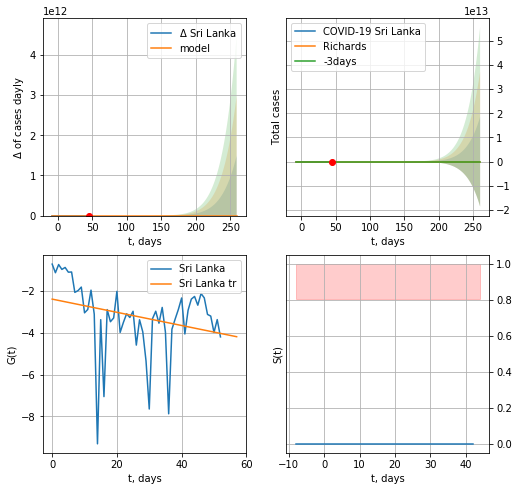

Sri Lanka data at: 2020-05-04
+3 day model MAPE: 1.000000
model: Richards
coeffs: [4.46105073e+02 3.48947501e-01 1.30751802e-01 1.91221241e-02]
rational stdev: 205193802976327.718750
forecast at the end of period: +215 days
	 deltaDaycases: 0
	 total cases: 0 ± 18557182532334
	 total death: 0 ± 0
trend coefficient of determination: 0.080211
 intercept: -2.384018
 slope: -0.031605


/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:15: RuntimeWarning: overflow encountered in power
  from ipykernel import kernelapp as app


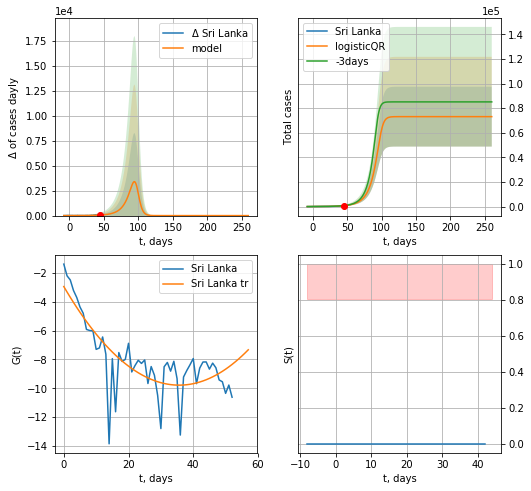

Sri Lanka data at: 2020-05-04
+3 day model MAPE: 0.05518169076740634
model: logisticQR
coeffs:  [ 7.31338913e+04  3.14273708e-04  9.79417920e+01 -2.30767672e+02
  2.83954838e+00]
rational stdev:  0.33242925378994026
forecast at the end of period: +215 days
	 deltaDaycases:  0
	 total cases:  73133 ± 24311
	 total death:  774 ± 771
trend coefficient of determination: 0.612466
 intercept_: -2.9436925942027994
 coeffs_: [ 0.         -0.38378893  0.00538271]


In [797]:
x = forecastRR('Sri Lanka',dfSri[:],d1,36*7-dT,1.0,addpred=False,xcoef=koreaCoeffs)
x = forecastQR('Sri Lanka',dfSri[:],d1,36*7-dT,1.0,addpred=False,xcoef=koreaCoeffs)

In [378]:
cD = {
    "Romania": ["RM",5,4*7],
    #"Finland":"FI",
    "India":["ID",5,6*7],
    "Ecuador":["ED",5,4*7],
    "Philippines":["PH",5,4*7],
    #"Pakistan":"PK",
#    "Luxembourg":"LX",
#    "Saudi Arabia":["SA",5,4*7],
    "Thailand":["TH",5,4*7],
    "Indonesia":["IE",5,16*7],
    "Mexico":["MX",5,8*7],
    "Panama":["PM",12,12*7],
    "Peru":["PU",5,4*7],
    "Serbia":["SB",5,4*7],
#    "South Africa":"AF",
#    "Dominican Republic":"DR",
#    "UAE":["UAE",5,8*7],
    "Argentina":["AG",5,8*7],
    "Iceland":["IC",5,4*7],
    "Colombia":["CB",10,16*7],
    "Qatar":["QR",5,6*7],
    "Algeria":["AR",5,16*7],
    "Croatia":["CT",0,12*7],
    "Egypt":["EG",5,4*7],
    "Slovenia":["SV",12,6*7],
    "Morocco":["MR",5,4*7],
    "Iraq":["IQ",2,8*7]
#    "Hong Kong":"HK"
}

dfArray = [dfRM,dfID,dfED,dfPH,dfTH,dfIE,dfMX,dfPM,dfPU,dfSB,dfAG,dfIC,dfCB,dfQR,dfAG,dfCT,dfEG,dfSV,dfMR,dfIQ]
for c,adf in zip(cD,dfArray):
    if c in ["Qatar","Peru","Argentina","Iraq","India","Philippines","Indonesia","Finland","Luxembourg","Ecuador","Thailand","Morocco","Romania","Iceland","Panama","Colombia","Mexico","Algeria", "Croatia","Slovenia","Egypt","Serbia"]:
        continue
    print (c)
    idS = cD[c][1]
    ipd = cD[c][2]
    x = forecast(c,adf[idS:],d1,ipd-dT)
    #xx = forecast2(c,adf[:],d1,ipd-dT,x)

In [4]:
import requests
import lxml.html as lh
#url='https://www.worldometers.info/coronavirus/#countries'#Create a handle, page, to handle the contents of the website
url='https://www.worldometers.info/coronavirus/#nav-today'
page = requests.get(url)#Store the contents of the website under doc
doc = lh.fromstring(page.content)#Parse data that are stored between <tr>..</tr> of HTML
tr_elements = doc.xpath('//tr')
#Check the length of the first 12 rows
print ([len(T) for T in tr_elements[:12]])
tr_elements = doc.xpath('//tr')#Create empty list
col=[]
i=0#For each row, store each first element (header) and an empty list
for t in tr_elements[0]:
    i+=1
    name=t.text_content()
    print ('%d:"%s"'%(i,name))
    col.append((name,[]))
    
#Since out first row is the header, data is stored on the second row onwards
for j in range(1,len(tr_elements)):
    #T is our j'th row
    T=tr_elements[j]
    #print (len(T))
    #If row is not of size 10, the //tr data is not from our table 
    if len(T)!=13:
        break
    
    #i is the index of our column
    i=0
    
    #Iterate through each element of the row
    for t in T.iterchildren():
        data=t.text_content() 
        #Check if row is empty
        if i>0:
        #Convert any numerical value to integers
            try:
                data=int(data)
            except:
                pass
        #Append the data to the empty list of the i'th column
        col[i][1].append(data)
        #Increment i for the next column
        i+=1
    
print ([len(C) for (title,C) in col])
Dict={title:column for (title,column) in col}
df=pd.DataFrame(Dict)

/usr/local/lib/python3.5/dist-packages/requests/__init__.py:83: RequestsDependencyWarning: Old version of cryptography ([1, 2, 3]) may cause slowdown.
  warnings.warn(warning, RequestsDependencyWarning)


[13, 13, 13, 13, 13, 13, 13, 13, 13, 13, 13, 13]
1:"Country,Other"
2:"TotalCases"
3:"NewCases"
4:"TotalDeaths"
5:"NewDeaths"
6:"TotalRecovered"
7:"ActiveCases"
8:"Serious,Critical"
9:"Tot Cases/1M pop"
10:"Deaths/1M pop"
11:"TotalTests"
12:"Tests/
1M pop
"
13:"Continent"
[461, 461, 461, 461, 461, 461, 461, 461, 461, 461, 461, 461, 461]


In [5]:
df.head(10)

,ActiveCases,Continent,"Country,Other",Deaths/1M pop,NewCases,NewDeaths,"Serious,Critical",Tests/ 1M pop,TotalCases,TotalDeaths,TotalRecovered,TotalTests,Tot Cases/1M pop
0,"1,009,038",North America,\nNorth America\n,,"+1,873",123,"17,297",,"1,320,910","76,897","234,975",,
1,"770,442",Europe,\nEurope\n,,30,12,"16,949",,"1,469,941","142,155","557,344",,
2,"247,938",Asia,\nAsia\n,,600,13,"5,290",,"573,439","20,091","305,410",,
3,"135,039",South America,\nSouth America\n,,460,30,"9,938",,"224,734","11,298","78,397",,
4,"30,002",Africa,\nAfrica\n,,6,,129,,"48,081","1,848","16,231",,
5,"1,039",Australia/Oceania,\nOceania\n,,21,1,30,,"8,435",116,"7,280",,
6,61,,\n\n,,,,4,,721,15,645,,
7,"2,193,559",All,World,32.4,"+2,990",179,"49,637",,"3,646,261","252,420","1,200,282",,468
8,"954,911",North America,USA,211,65,,"16,050","22,545","1,212,900","69,921","188,068","7,462,597","3,664"
9,"71,240",Europe,Spain,544,,,"2,254","41,332","248,301","25,428","151,633","1,932,455","5,311"


In [6]:
#df.rename(columns={"Country,Other":"Country",df.columns[9]:"TotDeathsper1Mpop"})
df=df.rename(columns={"Country,Other":"Country",df.columns[3]:"Deathsper1Mpop","Serious,Critical":"Serious_Critical",df.columns[7]:"Testsper1Mpop",df.columns[12]:"TotCasesper1Mpop"})
df.head()

,ActiveCases,Continent,Country,Deathsper1Mpop,NewCases,NewDeaths,Serious_Critical,Testsper1Mpop,TotalCases,TotalDeaths,TotalRecovered,TotalTests,TotCasesper1Mpop
0,"1,009,038",North America,\nNorth America\n,,"+1,873",123,"17,297",,"1,320,910","76,897","234,975",,
1,"770,442",Europe,\nEurope\n,,30,12,"16,949",,"1,469,941","142,155","557,344",,
2,"247,938",Asia,\nAsia\n,,600,13,"5,290",,"573,439","20,091","305,410",,
3,"135,039",South America,\nSouth America\n,,460,30,"9,938",,"224,734","11,298","78,397",,
4,"30,002",Africa,\nAfrica\n,,6,,129,,"48,081","1,848","16,231",,


In [7]:
df[df["Country"]=="Lithuania"]

,ActiveCases,Continent,Country,Deathsper1Mpop,NewCases,NewDeaths,Serious_Critical,Testsper1Mpop,TotalCases,TotalDeaths,TotalRecovered,TotalTests,TotCasesper1Mpop
90,735,Europe,Lithuania,17,,,17,"52,907","1,419",46,638,"144,029",521
322,735,Europe,Lithuania,17,9,,17,"52,907","1,419",46,638,"144,029",521


In [8]:
totIdx = np.where(df['ActiveCases']=='ActiveCases')[0][0]
print(totIdx)

230


In [9]:
df.head(24)

,ActiveCases,Continent,Country,Deathsper1Mpop,NewCases,NewDeaths,Serious_Critical,Testsper1Mpop,TotalCases,TotalDeaths,TotalRecovered,TotalTests,TotCasesper1Mpop
0,"1,009,038",North America,\nNorth America\n,,"+1,873",123,"17,297",,"1,320,910","76,897","234,975",,
1,"770,442",Europe,\nEurope\n,,30,12,"16,949",,"1,469,941","142,155","557,344",,
2,"247,938",Asia,\nAsia\n,,600,13,"5,290",,"573,439","20,091","305,410",,
3,"135,039",South America,\nSouth America\n,,460,30,"9,938",,"224,734","11,298","78,397",,
4,"30,002",Africa,\nAfrica\n,,6,,129,,"48,081","1,848","16,231",,
5,"1,039",Australia/Oceania,\nOceania\n,,21,1,30,,"8,435",116,"7,280",,
6,61,,\n\n,,,,4,,721,15,645,,
7,"2,193,559",All,World,32.4,"+2,990",179,"49,637",,"3,646,261","252,420","1,200,282",,468
8,"954,911",North America,USA,211,65,,"16,050","22,545","1,212,900","69,921","188,068","7,462,597","3,664"
9,"71,240",Europe,Spain,544,,,"2,254","41,332","248,301","25,428","151,633","1,932,455","5,311"


In [10]:
df.at[11, 'TotalRecovered'] = 0
df.at[22, 'TotalRecovered'] = 0
#df.at[12, 'TotalRecovered'] = 0


In [11]:
import lxml
def sanitize(data):
    #print (type(data))
    if type(data) == lxml.etree._ElementUnicodeResult:
        data=str(data).strip()
    if str(data).find(',') != -1:
        data = data.replace(',','')
    #print(str(data).find(',') != -1)
    return data
df=df[df.index<totIdx-1]
df["ActiveCases"] = pd.to_numeric(df["ActiveCases"].apply(sanitize))
df["Deathsper1Mpop"] = pd.to_numeric(df["Deathsper1Mpop"].apply(sanitize))
df["NewCases"] = pd.to_numeric(df["NewCases"].apply(sanitize))
df["NewDeaths"] = pd.to_numeric(df["NewDeaths"].apply(sanitize))
df["Serious_Critical"] = pd.to_numeric(df["Serious_Critical"].apply(sanitize))
df["TotalCases"] = pd.to_numeric(df["TotalCases"].apply(sanitize))
df["TotalDeaths"] = pd.to_numeric(df["TotalDeaths"].apply(sanitize))
df["TotalRecovered"] = pd.to_numeric(df["TotalRecovered"].apply(sanitize))
df["TotCasesper1Mpop"] = pd.to_numeric(df["TotCasesper1Mpop"].apply(sanitize))
df["TotalTests"] = pd.to_numeric(df["TotalTests"].apply(sanitize))
df["Testsper1Mpop"] = pd.to_numeric(df["Testsper1Mpop"].apply(sanitize))
df.head(15)

,ActiveCases,Continent,Country,Deathsper1Mpop,NewCases,NewDeaths,Serious_Critical,Testsper1Mpop,TotalCases,TotalDeaths,TotalRecovered,TotalTests,TotCasesper1Mpop
0,1009038,North America,\nNorth America\n,NaN,1873.0,123.0,17297.0,NaN,1320910,76897.0,234975.0,NaN,NaN
1,770442,Europe,\nEurope\n,NaN,30.0,12.0,16949.0,NaN,1469941,142155.0,557344.0,NaN,NaN
2,247938,Asia,\nAsia\n,NaN,600.0,13.0,5290.0,NaN,573439,20091.0,305410.0,NaN,NaN
3,135039,South America,\nSouth America\n,NaN,460.0,30.0,9938.0,NaN,224734,11298.0,78397.0,NaN,NaN
4,30002,Africa,\nAfrica\n,NaN,6.0,NaN,129.0,NaN,48081,1848.0,16231.0,NaN,NaN
5,1039,Australia/Oceania,\nOceania\n,NaN,21.0,1.0,30.0,NaN,8435,116.0,7280.0,NaN,NaN
6,61,,\n\n,NaN,NaN,NaN,4.0,NaN,721,15.0,645.0,NaN,NaN
7,2193559,All,World,32.4,2990.0,179.0,49637.0,NaN,3646261,252420.0,1200282.0,NaN,468.0
8,954911,North America,USA,211.0,65.0,NaN,16050.0,22545.0,1212900,69921.0,188068.0,7462597.0,3664.0
9,71240,Europe,Spain,544.0,NaN,NaN,2254.0,41332.0,248301,25428.0,151633.0,1932455.0,5311.0


In [12]:
cLst = countriesEU
ActiveCasesEU = sum([ w for w in df[df['Country'].isin(cLst)].ActiveCases if w>0])
CountryEU = "European Union" 
Deathsper1MpopEU = sum([w for w in df[df['Country'].isin(cLst)].TotalDeaths if w>0])/445.250514
NewCasesEU = sum([w for w in df[df['Country'].isin(cLst)].NewCases if w>0 ])
NewDeathsEU = sum([w for w in df[df['Country'].isin(cLst)].NewDeaths if w>0])
Serious_CriticalEU = sum([w for w in df[df['Country'].isin(cLst)].Serious_Critical if w>0])
Testsper1MpopEU = sum([ w for w in df[df['Country'].isin(cLst)].TotalTests if w>0])/445.250514
TotalCasesEu = sum([w for w in df[df['Country'].isin(cLst)].TotalCases if w>0])
TotalDeathsEU = sum([w for w in df[df['Country'].isin(cLst)].TotalDeaths if w>0])
TotalRecoveredEU = sum([w for w in df[df['Country'].isin(cLst)].TotalRecovered if w>0] )
TotalTestsEU = sum([w for w in df[df['Country'].isin(cLst)].TotalTests if w>0])
TotCasesper1MpopEU = TotalCasesEu/445.250514

rowEU = {"ActiveCases":ActiveCasesEU,"Continent":"Europe","Country": CountryEU,"Deathsper1Mpop": Deathsper1MpopEU,"NewCases": NewCasesEU,"NewDeaths": NewDeathsEU,"Serious_Critical": Serious_CriticalEU,"Testsper1Mpop": Testsper1MpopEU,"TotalCases": TotalCasesEu,"TotalDeaths": TotalDeathsEU,"TotalRecovered": TotalRecoveredEU,"TotalTests": TotalTestsEU,"TotCasesper1Mpop": TotCasesper1MpopEU }
df = df.append(rowEU, ignore_index=True)
df.tail()

,ActiveCases,Continent,Country,Deathsper1Mpop,NewCases,NewDeaths,Serious_Critical,Testsper1Mpop,TotalCases,TotalDeaths,TotalRecovered,TotalTests,TotCasesper1Mpop
225,135039,South America,Total:,NaN,460.0,30.0,9938.0,NaN,224734,11298.0,78397.0,NaN,NaN
226,30002,Africa,Total:,NaN,6.0,NaN,129.0,NaN,48081,1848.0,16231.0,NaN,NaN
227,1039,Australia/Oceania,Total:,NaN,21.0,1.0,30.0,NaN,8435,116.0,7280.0,NaN,NaN
228,61,,Total:,NaN,NaN,NaN,4.0,NaN,721,15.0,645.0,NaN,NaN
229,435371,Europe,European Union,244.761087,30.0,12.0,12318.0,25788.522728,1044364,108980.0,499763.0,11482353.0,2345.564951


In [13]:
#df['Reported1st case'] = df['Reported1st case'].map(lambda x: x.lstrip('\n'))
df["Country"] = df["Country"].str.strip('\n')
df.head()

,ActiveCases,Continent,Country,Deathsper1Mpop,NewCases,NewDeaths,Serious_Critical,Testsper1Mpop,TotalCases,TotalDeaths,TotalRecovered,TotalTests,TotCasesper1Mpop
0,1009038,North America,North America,NaN,1873.0,123.0,17297.0,NaN,1320910,76897.0,234975.0,NaN,NaN
1,770442,Europe,Europe,NaN,30.0,12.0,16949.0,NaN,1469941,142155.0,557344.0,NaN,NaN
2,247938,Asia,Asia,NaN,600.0,13.0,5290.0,NaN,573439,20091.0,305410.0,NaN,NaN
3,135039,South America,South America,NaN,460.0,30.0,9938.0,NaN,224734,11298.0,78397.0,NaN,NaN
4,30002,Africa,Africa,NaN,6.0,NaN,129.0,NaN,48081,1848.0,16231.0,NaN,NaN


In [14]:
#totIdx0 = np.where(df['Country']=='Total:')[0][0]
#df.at[totIdx0,'Country'] = 'World'

In [15]:
#df

In [16]:
#df[df['Country'].isnull()]
#df['Country']=df['Country'].dropna()
##for idx in df['Country'].isnull():
##    #print(idx)
##    if idx == True:
##        ind = df[df['Country'].isnull()].index[0]
##        df = df.drop(df.index[ind])
df = df.drop(df.index[6])
df.head(10)

,ActiveCases,Continent,Country,Deathsper1Mpop,NewCases,NewDeaths,Serious_Critical,Testsper1Mpop,TotalCases,TotalDeaths,TotalRecovered,TotalTests,TotCasesper1Mpop
0,1009038,North America,North America,NaN,1873.0,123.0,17297.0,NaN,1320910,76897.0,234975.0,NaN,NaN
1,770442,Europe,Europe,NaN,30.0,12.0,16949.0,NaN,1469941,142155.0,557344.0,NaN,NaN
2,247938,Asia,Asia,NaN,600.0,13.0,5290.0,NaN,573439,20091.0,305410.0,NaN,NaN
3,135039,South America,South America,NaN,460.0,30.0,9938.0,NaN,224734,11298.0,78397.0,NaN,NaN
4,30002,Africa,Africa,NaN,6.0,NaN,129.0,NaN,48081,1848.0,16231.0,NaN,NaN
5,1039,Australia/Oceania,Oceania,NaN,21.0,1.0,30.0,NaN,8435,116.0,7280.0,NaN,NaN
7,2193559,All,World,32.4,2990.0,179.0,49637.0,NaN,3646261,252420.0,1200282.0,NaN,468.0
8,954911,North America,USA,211.0,65.0,NaN,16050.0,22545.0,1212900,69921.0,188068.0,7462597.0,3664.0
9,71240,Europe,Spain,544.0,NaN,NaN,2254.0,41332.0,248301,25428.0,151633.0,1932455.0,5311.0
10,99980,Europe,Italy,481.0,NaN,NaN,1479.0,36244.0,211938,29079.0,82879.0,2191403.0,3505.0


In [17]:
df.to_csv('/home/algiz/Desktop/coronaAll_%s.csv'%(date.today()- timedelta(days=1)), index=False)

In [18]:
countryDic = {
  "USA": "US",
"Italy":"IT",
"Spain":"SP",
"Germany":"GR",
"France":"FR",
"Iran":"IN",
"UK":"GB",
"Switzerland":"SZ",
"S. Korea":"KR",
"Norway":"NG",
"Sweden":"SW",
"Israel":"IS",
"Denmark":"DK",
"Poland":"PL",
"Estonia":"ES",
"Ukraine":"Ukr",
"Latvia":"LV",
    "Lithuania":"LT",
    "China":"CN",
    "USA":"US",
    "Russia":"RS",
    "Japan":"JP",
    "Netherlands":"NL",
    "Belgium":"BG",
    "Singapore":"SG",
    "Austria":"AT",
    "Turkey":"TR",
    "Canada":"CA",
    "Portugal":"PT",
    "World":"World",
    "Australia":"AS",
    "Brazil":"BZ",
    "Malaysia":"ML",
    "New Zealand":"ZL",
    "Belarus":"BR",
    "Ireland":"IR",
    "Chile":"CL",
    "Czechia":"CH",
    "Romania": "RM",
    "Finland":"FI",
    "India":"ID",
    "Ecuador":"ED",
    "Philippines":"PH",
    "Pakistan":"PK",
    "Luxembourg":"LX",
    "Saudi Arabia":"SA",
    "Thailand":"TH",
    "Indonesia":"IE",
    "Mexico":"MX",
    "Panama":"PM",
    "Peru":"PU",
    "Serbia":"SB",
#    "South Africa":"AF",
#    "Dominican Republic":"DR",
    "UAE":"UAE",
    "Argentina":"AG",
    "Iceland":"IC",
    "Colombia":"CB",
    "Qatar":"QR",
    "Algeria":"AR",
    "Croatia":"CT",
    "Egypt":"EG",
    "Slovenia":"SV",
    "Morocco":"MR",
    "Iraq":"IQ",
    "European Union":"EU",
    "Bulgaria":"BL",
    "Hungary":"HG",
    "Malta":"MT",
    "Slovakia":"SL",
    "Cyprus":"CP",
    "Greece":"GC"
#    "Hong Kong":"HK"
}
df=df[df.TotalCases.astype(int)>0]
#df=df['TotalCases'].astype(int)

for c in countryDic:
    print (c,countryDic[c])

Lithuania LT
Ukraine Ukr
Latvia LV
Slovenia SV
Morocco MR
Croatia CT
New Zealand ZL
Chile CL
Spain SP
Austria AT
Finland FI
Canada CA
Malaysia ML
India ID
China CN
Colombia CB
S. Korea KR
Qatar QR
Thailand TH
Japan JP
Estonia ES
Philippines PH
Greece GC
Russia RS
Bulgaria BL
Slovakia SL
Turkey TR
Italy IT
Romania RM
Panama PM
Norway NG
Singapore SG
Germany GR
Argentina AG
Belgium BG
Mexico MX
Brazil BZ
Portugal PT
UK GB
Israel IS
Cyprus CP
Switzerland SZ
Netherlands NL
France FR
Hungary HG
Czechia CH
Iceland IC
Ecuador ED
Australia AS
Indonesia IE
Denmark DK
USA US
Poland PL
Ireland IR
Algeria AR
Malta MT
Egypt EG
Pakistan PK
World World
UAE UAE
European Union EU
Saudi Arabia SA
Serbia SB
Luxembourg LX
Belarus BR
Iran IN
Peru PU
Iraq IQ
Sweden SW


In [19]:
df = pd.read_csv('data/coronaAll_%s.csv'%(date.today()- timedelta(days=1)),',')
df=df[df.TotalCases.astype(int)>0]
#df=df['TotalCases'].astype(int)
from datetime import date, timedelta
for c in df.Country: 
    #if c!='European Union':
    #    continue
    f = open("data/tmp/corona%sOneRaw.csv"%(c),'w')
    #print ("corona%sOneRaw.csv"%(c),date.today()- timedelta(days=1),c,df[df.Country == c].TotalCases.values[0])
    print(c)
    if c!='World':
        f.write("%s,%s,%s,%s\n"%(date.today()- timedelta(days=1),df[df.Country == c].TotalCases.values[0],df[df.Country == c].ActiveCases.values[0],df[df.Country == c].TotalDeaths.values[0]))
        print(c,"%s,%s,%s,%s"%(date.today()- timedelta(days=1),df[df.Country == c].TotalCases.values[0],df[df.Country == c].ActiveCases.values[0],df[df.Country == c].TotalDeaths.values[0]))
    else:
        f.write("%s,%s,%s,%s\n"%(date.today()- timedelta(days=1),df[df.Country == c].TotalCases.values[0],df[df.Country == c].ActiveCases.values[0],df[df.Country == c].TotalDeaths.values[0]))
        print(c,"%s,%s,%s,%s"%(date.today()- timedelta(days=1),df[df.Country == c].TotalCases.values[0],df[df.Country == c].ActiveCases.values[0],df[df.Country == c].TotalDeaths.values[0]))
    f.close()

North America
North America 2020-05-04,1320910,1009038,76897.0
Europe
Europe 2020-05-04,1469941,770442,142155.0
Asia
Asia 2020-05-04,573439,247938,20091.0
South America
South America 2020-05-04,224734,135039,11298.0
Africa
Africa 2020-05-04,48081,30002,1848.0
Oceania
Oceania 2020-05-04,8435,1039,116.0
World
World 2020-05-04,3646261,2193559,252420.0
USA
USA 2020-05-04,1212900,954911,69921.0
Spain
Spain 2020-05-04,248301,71240,25428.0
Italy
Italy 2020-05-04,211938,99980,29079.0
UK
UK 2020-05-04,190584,161506,28734.0
France
France 2020-05-04,169462,92890,25201.0
Germany
Germany 2020-05-04,166152,24059,6993.0
Russia
Russia 2020-05-04,145268,125817,1356.0
Turkey
Turkey 2020-05-04,127659,56032,3461.0
Brazil
Brazil 2020-05-04,108620,55438,7367.0
Iran
Iran 2020-05-04,98647,12991,6277.0
Canada
Canada 2020-05-04,60772,30901,3854.0
Belgium
Belgium 2020-05-04,50267,29965,7924.0
Peru
Peru 2020-05-04,47372,31601,1344.0
India
India 2020-05-04,46437,32024,1566.0
Netherlands
Netherlands 2020-05-04,4077

Falkland Islands
Falkland Islands 2020-05-04,13,0,nan
Yemen
Yemen 2020-05-04,12,9,2.0
Turks and Caicos
Turks and Caicos 2020-05-04,12,5,1.0
Montserrat
Montserrat 2020-05-04,11,3,1.0
Greenland
Greenland 2020-05-04,11,0,nan
Vatican City
Vatican City 2020-05-04,11,9,nan
Seychelles
Seychelles 2020-05-04,11,5,nan
Suriname
Suriname 2020-05-04,10,0,1.0
MS Zaandam
MS Zaandam 2020-05-04,9,7,2.0
Mauritania
Mauritania 2020-05-04,8,1,1.0
Papua New Guinea
Papua New Guinea 2020-05-04,8,0,nan
Bhutan
Bhutan 2020-05-04,7,2,nan
British Virgin Islands
British Virgin Islands 2020-05-04,6,2,1.0
Caribbean Netherlands
Caribbean Netherlands 2020-05-04,6,6,nan
St. Barth
St. Barth 2020-05-04,6,0,nan
Western Sahara
Western Sahara 2020-05-04,6,1,nan
Anguilla
Anguilla 2020-05-04,3,0,nan
Comoros
Comoros 2020-05-04,3,3,nan
Saint Pierre Miquelon
Saint Pierre Miquelon 2020-05-04,1,1,nan
China
China 2020-05-04,82881,395,4633.0
Total:
Total: 2020-05-04,1320910,1009038,76897.0
Total:
Total: 2020-05-04,1320910,1009038,768

In [20]:
#c='World'
#print(c,"%s,%s,%s"%(date.today()- timedelta(days=1),df[df.Country == c].TotalCases.values[0],df[df.Country == c].ActiveCases.values[0]))

In [21]:
for c in countryDic: 
    #if c not in ['European Union']:
    #    continue
    ff = open("data/tmp/corona%sOneRaw.csv"%(c),'r')
    fff = open("data/corona%s.csv"%(countryDic[c]),'a')
    for l in ff:
        #print(c,l)
        print("append data/corona%s.csv"%(countryDic[c]),"%s"%(l))
        fff.write(l)
    ff.close()
    fff.close()

append /home/algiz/Desktop/coronaLT.csv 2020-05-04,1419,735,46.0

append /home/algiz/Desktop/coronaUkr.csv 2020-05-04,12331,10409,303.0

append /home/algiz/Desktop/coronaLV.csv 2020-05-04,896,532,16.0

append /home/algiz/Desktop/coronaSV.csv 2020-05-04,1439,1101,97.0

append /home/algiz/Desktop/coronaMR.csv 2020-05-04,5053,3221,179.0

append /home/algiz/Desktop/coronaCT.csv 2020-05-04,2101,499,80.0

append /home/algiz/Desktop/coronaZL.csv 2020-05-04,1486,164,20.0

append /home/algiz/Desktop/coronaCL.csv 2020-05-04,20643,9958,270.0

append /home/algiz/Desktop/coronaSP.csv 2020-05-04,248301,71240,25428.0

append /home/algiz/Desktop/coronaAT.csv 2020-05-04,15621,1705,600.0

append /home/algiz/Desktop/coronaFI.csv 2020-05-04,5327,1587,240.0

append /home/algiz/Desktop/coronaCA.csv 2020-05-04,60772,30901,3854.0

append /home/algiz/Desktop/coronaML.csv 2020-05-04,6353,1764,105.0

append /home/algiz/Desktop/coronaID.csv 2020-05-04,46437,32024,1566.0

append /home/algiz/Desktop/coronaCN.csv 20

In [283]:
import pandas as pd
import io
import requests
url="https://opendata.ecdc.europa.eu/covid19/casedistribution/csv"
s=requests.get(url).content
#print (s)
dfc=pd.read_csv(io.StringIO(s.decode(encoding='windows-1252')))
dfc.to_csv("data/europa_corona.csv", index=False)

In [285]:
countryDic1 = {
    "Romania": "RM",
    "Finland":"FI",
    "India":"ID",
    "Ecuador":"ED",
    "Philippines":"PH",
    "Pakistan":"PK",
    "Luxembourg":"LX",
#    "Saudi Arabia":"SA",
    "Thailand":"TH",
    "Indonesia":"IE",
    "Mexico":"MX",
    "Panama":"PM",
    "Peru":"PU",
    "Serbia":"SB",
#    "South Africa":"AF",
#    "Dominican Republic":"DR",
#    "UAE":"UAE",
    "Argentina":"AG",
    "Iceland":"IC",
    "Colombia":"CB",
    "Qatar":"QR",
    "Algeria":"AR",
    "Croatia":"CT",
    "Egypt":"EG",
    "Slovenia":"SV",
    "Morocco":"MR",
    "Iraq":"IQ",
    "Bulgaria":"BL"
#    "Hong Kong":"HK"
}
countryDic2 = {
    "Austria":"AT",
    "Italy":"IT",
    "Belgium":"BG",
    "Latvia":"LV",
    "Bulgaria":"BL",
    "Lithuania":"LT",
    "Croatia":"CT",
    "Luxembourg":"LX",
    "Cyprus":"CP",
    "Malta":"MT",
    "Czechia":"CH",
    "Netherlands":"NL",
    "Denmark":"DK",
    "Poland":"PL",
    "Estonia":"ES",
    "Portugal":"PT",
    "Finland":"FI",
    "Romania":"RM",
    "France":"FR",
    "Slovakia":"SL",
    "Germany":"GR",
    "Slovenia":"SV",
    "Greece":"GC",
    "Spain":"SP",
    "Hungary":"HG",
    "Sweden":"SW",
    "Ireland":"IR"      
}
cD3 = {"Malta":"MT","Slovakia":"SL","Greece":"GC","Hungary":"HG","Cyprus":"CP","South Africa":"SAF"}
    
for  c in cD3:#countryDic1:
    if c != "South Africa":
        continue
    dfc = pd.read_csv("europa_corona.csv",",")
    dfc = dfc[dfc['countriesAndTerritories']==c].sort_values(['year', 'month', 'day'], ascending=[True, True, True])
    print(c,sum(dfc["cases"].values))
    dfc=dfc.rename(columns={"dateRep":"date"})
    dfc = dfc[dfc["cases"]>0]
    dfc['date'] = pd.to_datetime(dfc[['year', 'month', 'day']])
    #dfc['date'] = dfc['date'].dt.strftime('%Y-%m-%d')
    dfc["cases"]=np.cumsum(dfc["cases"].values)
    dfc[['date', 'cases']].to_csv('data/corona%s.csv'%(cD3[c]), index=False)#countryDic1

South Africa 0


In [911]:
#dfRM = read_df(pd.DataFrame(),"RM")

RM
          date  cases  active
29 2020-04-01   2245     NaN
30 2020-04-02   2460     NaN
31 2020-04-03   2738     NaN
32 2020-04-04   3183     NaN
33 2020-04-05   3613     0.0


In [892]:
dfc.head()#[['date', 'cases']]

,date,day,month,year,cases,deaths,countriesAndTerritories,geoId,countryterritoryCode,popData2018
6873,2020-02-27,27,2,2020,1,0,Romania,RO,ROU,19473936.0
6871,2020-02-29,29,2,2020,3,0,Romania,RO,ROU,19473936.0
6868,2020-03-04,4,3,2020,4,0,Romania,RO,ROU,19473936.0
6867,2020-03-06,6,3,2020,6,0,Romania,RO,ROU,19473936.0
6866,2020-03-07,7,3,2020,7,0,Romania,RO,ROU,19473936.0


In [875]:
date(2012, 3, 16)

datetime.date(2012, 3, 16)

In [7]:
len(countriesEU)

27

In [309]:
dfc = pd.read_csv("europa_corona.csv",",")
cLst = ["Austria","Italy","Belgium","Latvia","Bulgaria","Lithuania","Croatia","Luxembourg","Cyprus","Malta","Czechia","Netherlands","Denmark","Poland","Estonia","Portugal","Finland","Romania","France","Slovakia","Germany","Slovenia","Greece","Spain","Hungary","Sweden","Ireland"]
dfc = dfc[dfc['countriesAndTerritories'].isin(cLst)].sort_values(['year', 'month', 'day'], ascending=[True, True, True])
print(c,sum(dfc["cases"].values))
dfc=dfc.rename(columns={"dateRep":"date"})
dfc = dfc[dfc["cases"]>0]
dfc['date'] = pd.to_datetime(dfc[['year', 'month', 'day']])
#dfc['date'] = dfc['date'].dt.strftime('%Y-%m-%d')
dfc["cases"]=np.cumsum(dfc["cases"].values)
dfc[['date', 'cases']].to_csv('/home/algiz/Desktop/corona%s.csv'%("EU"), index=False)

World 549497


In [328]:
#subsetDataFrame = dfObj[dfObj['Product'].isin(['Mangos', 'Grapes']) ]

#dfD = dfAll[dfAll['Country'].isin(cLst)].TotalTests


7185.14611304862

In [287]:
#dfD

In [339]:
#dfAll[dfAll['Country'].isin(cLst)]

In [364]:
TT = sum(dfAll[dfAll.TotalTests>0].TotalTests) - dfAll[dfAll['Country']=='European Union'].TotalTests.values[0]
print(TT,TT/7.7776e3)

39345941.0 5058.879474387986


In [365]:
TT/7.7776e3

5058.879474387986

In [366]:
sum(dfp.Population)/1e6

16014.157998

In [282]:
dfAll[dfAll.TotalTests>0]

,ActiveCases,Continent,Country,Deathsper1Mpop,NewCases,NewDeaths,Serious_Critical,Testsper1Mpop,TotalCases,TotalDeaths,TotalRecovered,TotalTests,TotCasesper1Mpop
7,456815,North America,USA,57.000000,0.0,0.0,10917.0,7670.000000,502876,18747.0,27314.0,2538888.0,1519.000000
8,86524,Europe,Spain,344.000000,0.0,0.0,7371.0,7593.000000,158273,16081.0,55668.0,355000.0,3385.000000
9,98273,Europe,Italy,312.000000,0.0,0.0,3497.0,14999.000000,147577,18849.0,30455.0,906864.0,2441.000000
10,86740,Europe,France,202.000000,0.0,0.0,7004.0,5114.000000,124869,13197.0,24932.0,333807.0,1913.000000
11,65522,Europe,Germany,33.000000,0.0,0.0,4895.0,15730.000000,122171,2736.0,53913.0,1317887.0,1458.000000
12,64456,Europe,UK,132.000000,0.0,0.0,1559.0,4667.000000,73758,8958.0,344.0,316836.0,1086.000000
13,28495,Asia,Iran,50.000000,0.0,0.0,3969.0,2888.000000,68192,4232.0,35465.0,242568.0,812.000000
14,43600,Asia,Turkey,12.000000,0.0,0.0,1667.0,3643.000000,47029,1006.0,2423.0,307210.0,558.000000
15,18080,Europe,Belgium,260.000000,0.0,0.0,1278.0,7269.000000,26667,3019.0,5568.0,84248.0,2301.000000
16,12449,Europe,Switzerland,116.000000,0.0,0.0,386.0,20625.000000,24551,1002.0,11100.0,178500.0,2837.000000


In [272]:
cDicEU = {
    "Austria":["AT",dfAT],
    "Italy":["IT",dfIT],
    "Belgium":["BG",dfBG],
    "Latvia":["LV",dfLV],
    "Bulgaria":["BL",dfBL],
    "Lithuania":["LT",dfLT],
    "Croatia":["CT",dfCT],
    "Luxembourg":["LX",dfLX],
    "Cyprus":["CP",dfCP],
    "Malta":["MT",dfMT],
    "Czechia":["CH",dfCH],
    "Netherlands":["NL",dfNL],
    "Denmark":["DK",dfDK],
    "Poland":["PL",dfPL],
    "Estonia":["ES",dfES],
    "Portugal":["PT",dfPT],
    "Finland":["FI",dfFI],
    "Romania":["RM",dfRM],
    "France":["FR",dfFR],
    "Slovakia":["SL",dfSL],
    "Germany":["GR",dfGR],
    "Slovenia":["SV",dfSV],
    "Greece":["GC",dfGC],
    "Spain":["SP",dfSP],
    "Hungary":["HG",dfHG],
    "Sweden":["SW",dfSW],
    "Ireland":["IR",dfIR],
}

In [300]:
def addDataFrames(f_arg, *argv):
    dfTotal = f_arg
    for arg in argv:
        dfTotal = dfTotal.set_index('date').add(arg.set_index('date'), fill_value = 0)
        dfTotal['date'] = dfTotal.index
    return dfTotal
dfTot = cDicEU["Austria"][1]
for cD in cDicEU:
    if cD == "Austria":
        continue
    dfTot = addDataFrames(dfTot, cDicEU[cD][1])
    
dfTot.to_csv("~/Documents/coronaEU1.csv")

In [301]:
#cDicEU["Ireland"][1]

In [367]:
dfAll[df["Country"]=="European Union"].TotalTests.values[0]/445.250514

25788.52272812873

In [468]:
dfAll[df["Country"]=="Total:"].TotalTests.values[0]/445

0.0

In [381]:
#dfAll

In [369]:
(sum(dfAll.TotalTests)-dfAll[df["Country"]=="European Union"].TotalTests.values[0])/(7.777e3-445.250514)

5366.514646351626

In [132]:
CList = ["USA",
"Spain", "Italy", "UK", "France", "Germany", "Turkey", "Russia", "Iran", "Brazil", "Canada", "Belgium",
"Peru", "Netherlands", "India", "Switzerland", "Ecuador", "Portugal", "Saudi Arabia", "Sweden", "Ireland",
"Mexico", "Pakistan", "Singapore", "Chile", "Israel", "Austria", "Belarus", "Japan", "Qatar", "Poland",
"UAE", "Romania", "Ukraine", "South_Korea", "Indonesia", "Denmark", "Serbia", "Philippines", "Norway", "Czechia",
"Colombia", "Australia", "Malaysia", "Egypt", "Finland", "Morocco", "Argentina", "Algeria", "Moldova", 
"Luxembourg", "Thailand", "Hungary", "Greece", "Iraq", "Croatia", "Iceland", "Estonia", "Bulgaria",
"New_Zealand", "Slovenia", "Slovakia", "Lithuania", "Latvia", "Cyprus", "Malta"
]

In [ ]:
for CItem in CList:
    a = """
    %s
    <br />
    <img src="pictures/covidcases%s35_Q.png" alt="hi" class="inline"/><br /> 

      {%% include_relative _includes/covidcases%s35_Q.txt %%}
          <br /> 
    """%(CItem,CItem,CItem)
    print (a)

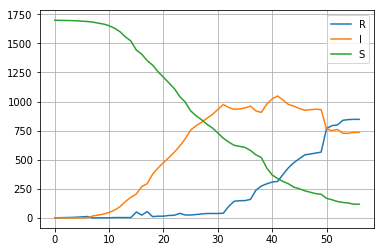

In [377]:
R = (dfLT[:].cases.values/0.9240855762594893).astype(int)+1 -dfLT[:].active.values+dfLT[:].death.values
I = dfLT[:].active.values
S = 1700-R[:]-I
plt.plot(range(len(dfLT)),R,label="R")
plt.plot(range(len(dfLT)),I,label="I")
plt.plot(range(len(dfLT)),S,label="S")
plt.legend()
plt.grid()

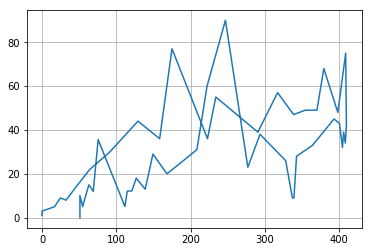

In [378]:
plt.plot(np.multiply(I,S)[1:]/1700,-np.diff(S[:]))
plt.grid()

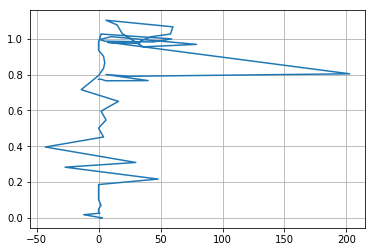

In [379]:
plt.plot(np.diff(R[:]),I[1:]/950)
plt.grid()

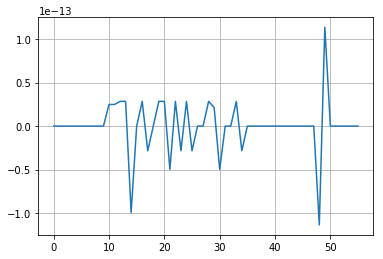

In [380]:
plt.plot(np.diff(R[:])+np.diff(I)+np.diff(S))
plt.grid()

In [381]:
def fS(x0,u):
    return x0*u
def fI(gamma,beta,x0,C1,u):
    return gamma*np.log(u)/beta-x0*u-C1/beta
def fR(gamma,beta,u):
    return -gamma*np.log(u)/beta
def fT(C1,gamma,x0,beta,u,u0):
    from scipy.integrate import quad
    def integrand(x, C1,gamma,x0,beta):
        return 1/(x*(C1-gamma*np.log(x)+x0*beta*x)) 
    return quad(integrand, u0, u, args=(C1,gamma,x0,beta))
vfS = np.vectorize(fS)
vfI = np.vectorize(fI)
vfR = np.vectorize(fR)
vfT = np.vectorize(fT)

In [445]:
import scipy.optimize as optimize

T = np.linspace(.0, 55., num=len(dfLT))
#U = np.linspace(1.0, 10*len(dfLT), num=len(dfLT))

def f(params):
    # print(params)  # <-- you'll see that params is a NumPy array
    gamma, norm = params # <-- for readability you may wish to assign names to the component variables
    C1 = -N*beta
    minT = np.min(vfT(C1,gamma,x0,beta,U[:],u0)[0])
    sumT = np.sum((T[:]/norm-(vfT(C1,gamma,x0,beta,U[:],u0)[0]-minT))**2)
    sumS = np.sum((S[:]-vfS(x0,U[:]))**2)
    sumI = np.sum((I[:]-vfI(gamma,beta,x0,C1,U[:]))**2)
    sumR = np.sum((R[:]-vfR(gamma,beta,U[:]))**2)
    return sumR+sumI+sumS+sumT
N = 1700
x0 = N*0.995
gamma = 4.18201705e+01
beta = 0.135
C1 = -N*beta
u0 = 4.00000000e-02
U = np.linspace(u0, .995, num=len(dfLT))
norma = 55*20
initial_guess = [gamma, norma]
result = optimize.minimize(f, initial_guess)
if result.success:
    fitted_params = result.x
    print(fitted_params)
else:
    fitted_params = result.x
    print(fitted_params)
    raise ValueError(result.message)

[  41.82422904 1100.        ]


In [446]:
55*19

1045

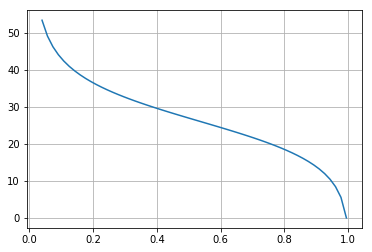

In [448]:
N = 1700
x0 = N*0.995
gamma =  41.81990453
#beta = 0.135
C1 = -N*beta
u0 = 4.00000000e-02
norm = 1100.
U = np.linspace(u0, .995, num=len(dfLT))
minT = min(vfT(C1,gamma,x0,beta,U[:],u0)[0])
plt.plot(U,(vfT(C1,gamma,x0,beta,U[:],u0)[0]-minT)*norm)
plt.grid()

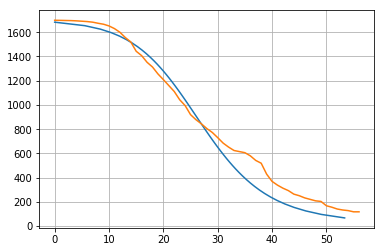

In [449]:
plt.plot((vfT(C1,gamma,x0,beta,U[:],u0)[0]-minT)*norm,vfS(x0,U[:]))
plt.plot(range(len(dfLT)),S,label="S")
plt.grid()

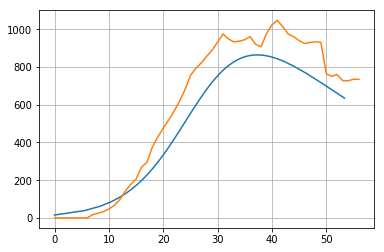

In [450]:
plt.plot((vfT(C1,gamma,x0,beta,U[:],u0)[0]-minT)*norm,vfI(gamma,beta,x0,C1,U[:]))
plt.plot(range(len(dfLT)),I,label="I")
plt.grid()

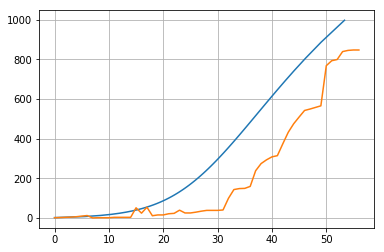

In [451]:
plt.plot((vfT(C1,gamma,x0,beta,U[:],u0)[0]-minT)*norm,vfR(gamma,beta,U[:]))
plt.plot(range(len(dfLT)),R,label="R")
plt.grid()

In [743]:
#T = np.linspace(1.0, len(dfLT), num=len(dfLT))

In [824]:
#u0 = [1,0.01]
#vfS(x0,u0),vfI(gamma,beta,x0,C1,u0),vfR(gamma,beta,u0)

In [995]:
gamma/(beta*x0)*55*4

45.5529411764706

In [1122]:
gamma/(beta)

0.8888888888888888

In [1021]:
minT

-0.34380956604705715

In [1058]:
np.multiply(I,S)[1:].shape

(54,)

In [1056]:
np.diff(S).shape

(54,)

In [1063]:
50./400

0.125